In [1]:
import numpy as np
import math
import sys
import matplotlib.pyplot as plt
import yt
import glob
import shutil
import pandas as pd
from matplotlib import colors
from scipy import stats
CMAP = plt.cm.coolwarm
from scipy.optimize import curve_fit
from matplotlib import colors
import matplotlib
from scipy import stats
from scipy import interpolate

from scipy.interpolate import UnivariateSpline
from scipy.interpolate import InterpolatedUnivariateSpline

#nbodykit-env imports

#import nbodykit
# from nbodykit.lab import *
# from nbodykit import setup_logging, style
# from nbodykit.source.catalog import ArrayCatalog
# import bigfile
#from nbodykit.source.catalog import BigFileCatalog
# from pathlib import Path
# from summarizer.data import Catalogue
# from summarizer.two_point import TwoPCF 
# from summarizer.two_point import Pk 
# from summarizer.vpf import VPF 
# from summarizer.cic import CiC 
# from summarizer import WST
# from summarizer import Bk"

# import nbodykit.lab as nblab
# from nbodykit.hod import Zheng07Model
# from nbodykit import cosmology

In [2]:
plt.style.use("style.mcstyle")
CMAP = plt.cm.jet

In [10]:
# import os
# import shutil
# files = list(glob.iglob("data/Pk_*halos*"))
# print(files)
# for file in files:
#     #print(file.replace("_HIGHRES", "_1m"))
#     shutil.copy(file, file.replace("_HIGHRES", "_1m"))

['data\\Pk_emu_halos_0_HIGHRES', 'data\\Pk_emu_halos_1_HIGHRES', 'data\\Pk_emu_halos_2_HIGHRES', 'data\\Pk_emu_halos_3_HIGHRES', 'data\\Pk_emu_halos_4_HIGHRES', 'data\\Pk_emu_halos_5_HIGHRES', 'data\\Pk_emu_halos_6_HIGHRES', 'data\\Pk_emu_halos_7_HIGHRES', 'data\\Pk_nbod_halos_0_HIGHRES', 'data\\Pk_nbod_halos_1_HIGHRES', 'data\\Pk_nbod_halos_2_HIGHRES', 'data\\Pk_nbod_halos_3_HIGHRES', 'data\\Pk_nbod_halos_4_HIGHRES', 'data\\Pk_nbod_halos_5_HIGHRES', 'data\\Pk_nbod_halos_6_HIGHRES', 'data\\Pk_nbod_halos_7_HIGHRES']


# Fig 1, P(k)

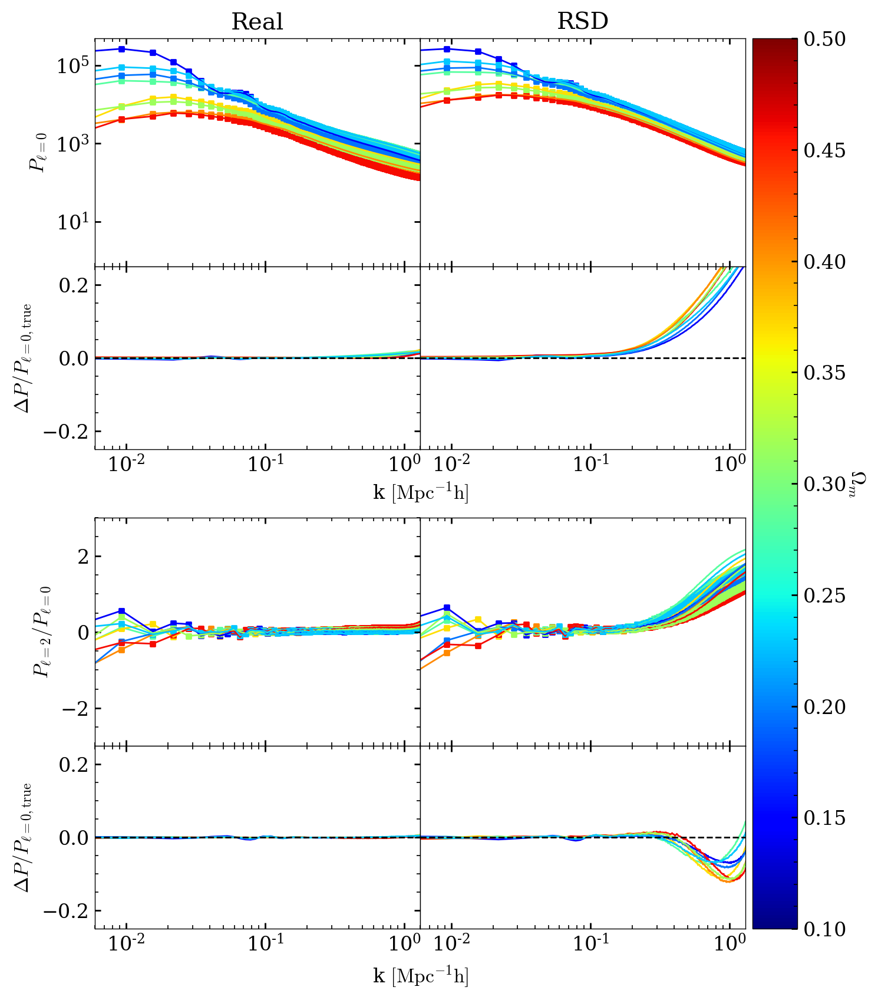

In [19]:

files = list(glob.iglob("data/Pk*_HIGHRES"))

def get_dat(f):
    df = pd.read_csv(f)
    k,pk0, pk2 = np.array(df["k"]), np.array(df["Pk0"]), np.array(df["Pk2"])  
    return k,pk0, pk2




ROW=5
fig,axs = plt.subplots(ROW,2, gridspec_kw={"height_ratios": [1,0.8,0.3,1,0.8]},figsize=(8,10))

xmin,xmax=6e-3,1.3
# axs[0][0].set_yscale("log")
# axs[0][0].set_yscale("log")
axs[0][1].set_yscale("log")
axs[0][0].set_yscale("log")
axs[1][0].set_ylim(-0.25,0.25)
axs[4][0].set_ylim(-0.25,0.25)
axs[1][1].set_ylim(-0.25,0.25)
axs[4][1].set_ylim(-0.25,0.25)

m=3
axs[3][0].set_ylim(-m,m)
axs[3][1].set_ylim(-m,m)

for x in range(ROW):
    axs[x][0].set_xscale("log")
    axs[x][1].set_xscale("log")
    axs[x][0].set_xlim(xmin,xmax)
    axs[x][1].set_xlim(xmin,xmax)
    #axs[0][x].set_ylim(1,5e5)
    #axs[1][x].set_xlabel(r"k $[\rm{Mpc}^{-1} h]$")#,fontsize=16)

axs[0][1].set_yticks([])
axs[1][1].set_yticks([])
axs[1][1].set_yticks([])
axs[2][1].set_yticks([])
axs[3][1].set_yticks([])
axs[4][1].set_yticks([])

axs[1][1].set_xticks([0.01, 0.1, 1.0])

# if(pole == 0): 
axs[0][0].set_ylabel(r"$P_{\ell=0}$")#,fontsize=20)
axs[3][0].set_ylabel(r"$P_{\ell=2}/P_{\ell=0}$")#,fontsize=20)
axs[1][0].set_ylabel(r"$\Delta P/P_{\ell=0, \rm{true}}$")#,fontsize=16)
axs[4][0].set_ylabel(r"$\Delta P/P_{\ell=0, \rm{true}}$")#,fontsize=16)
fig.text(0.47, 0.49, r"k $[\rm{Mpc}^{-1} h]$", ha='center')
fig.text(0.47, 0.08, r"k $[\rm{Mpc}^{-1} h]$", ha='center')

axs[2][0].axis('off')
axs[2][1].axis('off')


axs[0][0].set_title(r"Real")
axs[0][1].set_title(r"RSD")


omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])
for type_ in ["real", "rsd"]:
    c = 0
    if(type_=="rsd"): c=1
    for pole in [0,1]:
        
        for count in range(8):
            for f in files: 

                if(type_ in f  and str(count) in f):
                    if("nbod" in f): fnbod = f
                    elif("emu" in f): femu = f
            k,pk0nbod, pk2nbod = get_dat(fnbod)
            k,pk0emu, pk2emu = get_dat(femu)
            pknbod = [pk0nbod, pk2nbod][pole]
            pkemu = [pk0emu, pk2emu][pole]
            p0true = pk0nbod

            om = omlist[np.where(nlist==count)][0]
            col = CMAP((om-0.1)/0.4)

            ind=3
            fac1,fac2=1,1
            a = 0
            if(pole==1):
                fac1 = pk0nbod[::ind]
                fac2 = pk0emu[::ind]
                a = 3 
            axs[a][c].plot(k[::ind],pknbod[::ind]/fac1,color = col)
            axs[a][c].scatter(k[::ind], pkemu[::ind]/fac2, color=col, marker="s", s=10)
            

            axs[a+1][c].plot(k[::ind], (pkemu[::ind]-pknbod[::ind])/p0true[::ind], color=col)   
            #axs[1].plot(k[filt], (pkemu[filt])/pknbod[filt], color=col)   

        
for x in range(2):
    axs[1][x].plot([xmin,xmax], [0,0], color="black",ls="dashed")
    axs[4][x].plot([xmin,xmax], [0,0], color="black",ls="dashed")
    
plt.subplots_adjust(hspace=0,wspace=0)          
c=axs[a][c].scatter([k[0], k[1]], [pknbod[0], pknbod[1]], c=[0.1,0.5], cmap=CMAP, s=0)

cbar = plt.colorbar(c,ax=axs,pad=0.01,fraction=0.1)
cbar.set_label(r"$\Omega_m$", rotation=270,labelpad=12.0)

savename = "Pk_particles_"#+str(type_)+"pole"+str(pole*2)
plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



# Fig 2, Q and B. Including the theta, equi, and squeeze *Show abs?

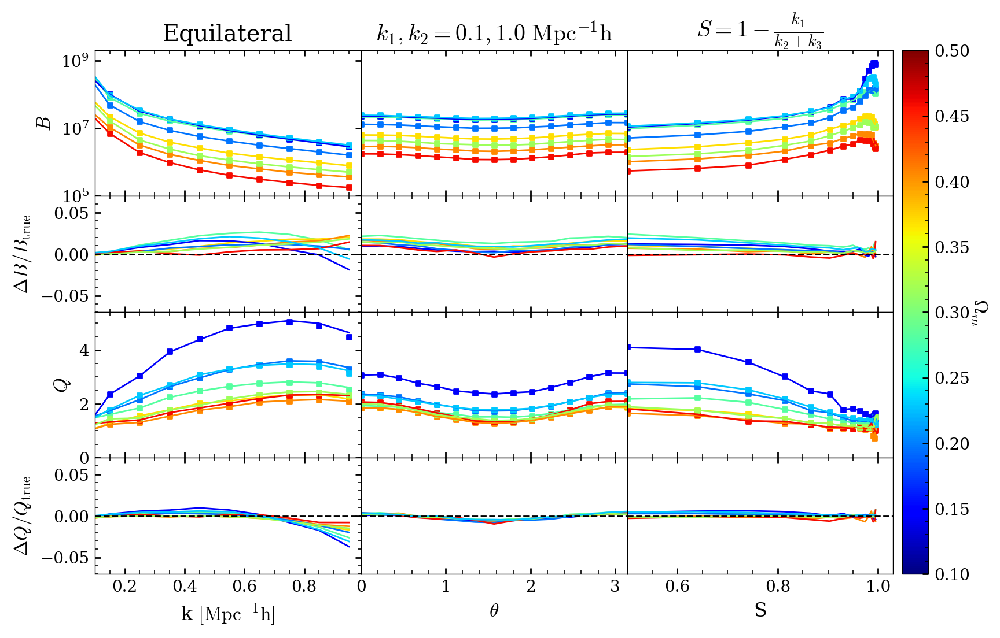

In [178]:


def get_bk_theta(f):
    df = pd.read_csv(f)
    t,q,b = np.array(df["theta"]), np.array(df["Qk"]), np.array(df["Bk"])  
    return t,q,b


def get_bk_squeeze(f):
    df = pd.read_csv(f)
    t,k1,k2,q,b = np.array(df["thetas"]), np.array(df["k1"]), np.array(df["k2"]), np.array(df["Qk"]), np.array(df["Bk"])  
    return t,k1,k2,q,b

def get_bk_k(f):
    df = pd.read_csv(f)
    k,q,b = np.array(df["k"]), np.array(df["Qk"]), np.array(df["Bk"])
    return k,q,b


COL=3
fig,axs = plt.subplots(4,COL, gridspec_kw={"height_ratios": [1,0.8,1,0.8]})#,sharey=True)#,figsize=(8,10)

for x in range(COL):
    axs[0][x].set_ylim(1e5,2e9)
    axs[1][x].set_ylim(-0.07,0.07)
    axs[2][x].set_ylim(0,5.4)
    axs[3][x].set_ylim(-0.07,0.07)

axs[2][0].set_ylabel(r"$Q$")
axs[3][0].set_ylabel(r"$\Delta Q / Q_{\rm true}$")
axs[0][0].set_ylabel(r"$ B $")
axs[1][0].set_ylabel(r"$\Delta B / B_{\rm true}$")

axs[3][0].set_xlabel(r"k $[\rm{Mpc}^{-1} h]$")
axs[3][1].set_xlabel(r"$\theta$")
axs[3][2].set_xlabel(r"S")

axs[0][0].set_yscale("log")
axs[0][1].set_yscale("log")
axs[0][2].set_yscale("log")


for x in range(4):
    axs[x][1].set_yticks([])
    axs[x][2].set_yticks([])
# for y in range(3):
#     axs[0][y].set_xticks([])
#     axs[1][y].set_xticks([])
#     axs[2][y].set_xticks([])

omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])
a=0

files = list(glob.iglob("data/Bk*_k_*"))
for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    k,qn,bn = get_bk_k(fnbod)
    k,qe,be = get_bk_k(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)    

    
    axs[0][0].scatter(k,be, color=col, marker="s", s=10)
    axs[0][0].plot(k, bn, color=col) 
    axs[1][0].plot(k, (be-bn)/bn, color=col) 
    
    axs[2][0].scatter(k, qe, color=col, marker="s", s=10)
    axs[2][0].plot(k, qn, color=col) 
    axs[3][0].plot(k, (qe-qn)/qn, color=col)
    
files = list(glob.iglob("data/Bk*theta*"))
for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    #print(fnbod, femu)
    t,qn,bn = get_bk_theta(fnbod)
    t,qe,be = get_bk_theta(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    
    
    axs[0][1].scatter(t,be, color=col, marker="s", s=10)
    axs[0][1].plot(t, bn, color=col) 
    axs[1][1].plot(t, (be-bn)/bn, color=col)
    axs[2][1].scatter(t, qe, color=col, marker="s", s=10)
    axs[2][1].plot(t, qn, color=col) 
    axs[3][1].plot(t, (qe-qn)/qn, color=col)   

    
files = list(glob.iglob("data/Bk*squeeze*"))
for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    t,k1n,k2n,qn,bn = get_bk_squeeze(fnbod)
    t,k1e,k2e,qe,be = get_bk_squeeze(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    s = 1-k1e/(2*k2e)
    

  
    axs[0][2].scatter(s,be, color=col, marker="s", s=10)
    axs[0][2].plot(s, bn, color=col) 
    axs[1][2].plot(s, (be-bn)/bn, color=col)   
    axs[2][2].scatter(s, qe, color=col, marker="s", s=10)
    axs[2][2].plot(s, qn, color=col) 
    axs[3][2].plot(s, (qe-qn)/qn, color=col)   


xmin,xmax=0.1,0.99
for x in range(4):
    axs[x][0].set_xlim(xmin,xmax)
axs[1][0].plot([xmin,xmax], [0,0], color="black",ls="dashed")
axs[3][0].plot([xmin,xmax], [0,0], color="black",ls="dashed")
xmin,xmax=0,3.14
for x in range(4):
    axs[x][1].set_xlim(xmin,xmax)
axs[1][1].plot([xmin,xmax], [0,0], color="black",ls="dashed")
axs[3][1].plot([xmin,xmax], [0,0], color="black",ls="dashed")
xmin,xmax=0.5,1.03
for x in range(4):
    axs[x][2].set_xlim(xmin,xmax)
axs[1][2].plot([xmin,xmax], [0,0], color="black",ls="dashed")
axs[3][2].plot([xmin,xmax], [0,0], color="black",ls="dashed")



axs[0][0].set_title(r"Equilateral")
axs[0][1].set_title(r"$k_1,k_2 = 0.1,1.0 \ \rm{Mpc}^{-1} h$")
axs[0][2].set_title(r"$S = 1 - \frac{k_1}{k_2+k_3}$")
        
plt.subplots_adjust(hspace=0,wspace=0)
            
c=axs[1][2].scatter(s[0:2], ((be-bn)/bn)[0:2], c=[0.1,0.5], cmap=CMAP, s=0)

cbar=plt.colorbar(c,ax=axs,pad=0.01,fraction=0.1)
cbar.set_label(r"$\Omega_m$", rotation=270,labelpad=12.0)
savename = "Bk_particles_"#+str(type_)+"pole"+str(pole*2)


plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



#  Fig 3 (Wavelet stats)

# Fig 4 (Stacked profiles)

In [33]:
N=500
# xsteps = 50
# ysteps = xsteps
def get_delta(target_num, target_mass,type_):
    files = list(glob.iglob("data/stacked_"+str(type_)+"_"+str(target_num)+"_mass_"+str(target_mass)+"_batch_*.npy"))

    a = [np.load(f) for f in files]
    d=np.concatenate((a[0], a[1],a[2],a[3],a[4]), axis=0)
    R = np.max(np.abs(d))*1.01
    
    
    res = RES
    xsteps = int(R/res)
    ysteps = xsteps
    cl = 2.0*R/xsteps
    x,y,z = d.T[0], d.T[1], d.T[2]

    #taking a smaller slice in z, 30% the width of x and y dims
    z_width = 0.3*R
    args = np.where(np.abs(z) <= z_width)
    x = x[args]
    y = y[args]

    xlist,ylist, nTarget = [],[],[]
    x0 = -R + cl/2.0
    
    
    
    for xstep in range(xsteps-1):
        y0 = -R + cl/2.0
        #print(xstep)
        for ystep in range(ysteps-1):
            dx = np.abs(x0 - x)/cl
            dy = np.abs(y0 - y)/cl
            args =np.where((dx <=1.0) & (dy <=1.0))
            weight = (1-dx[args])*(1-dy[args])
            nTarget.append(np.sum(weight))
            xlist.append(x0)
            ylist.append(y0)
            y0 += cl
        x0 +=cl

    xlist = np.array(xlist)
    ylist = np.array(ylist)

    slice_factor = cl/z_width
    nTarget = np.array(nTarget)*slice_factor/N

    n_ave = (1536*cl/3000.0)**3
    delta = nTarget/n_ave +0 ### THIS SHOULD REALLY BE +0 but some cells have 0 particles and the log breaks
    return delta,R,xsteps,ysteps

In [51]:
om_list = np.linspace(0.2,0.5,10)
print(r_vir(np.power(10,14.5),0,0.5,om_list))

[1.15833967 1.13793327 1.11922757 1.10200875 1.08609972 1.07135234
 1.05764156 1.044861   1.03291946 1.02173826]


In [58]:
# def r_vir(m_h,z,h,om):
#     #return mpc/h
#     OMEGA_M = om
#     OMEGA_L = 1-om
#     OMEGA_M_Z=OMEGA_M*np.float_power(1+z,3)/ (OMEGA_M*np.float_power(1+z,3) + OMEGA_L)
#     d = OMEGA_M_Z-1
#     delta_c = 18*np.pi*np.pi + 82*d -39*d*d

#     return 1e-3*0.784* np.float_power(m_h*h/1e8, 1.0/3)*np.float_power(OMEGA_M/OMEGA_M_Z * (delta_c/(18*np.pi*np.pi)), -1.0/3) * (10/(1+z))
# r_vir(np.power(10,14.5),0,0.5,0.14)

1.2002292192844255

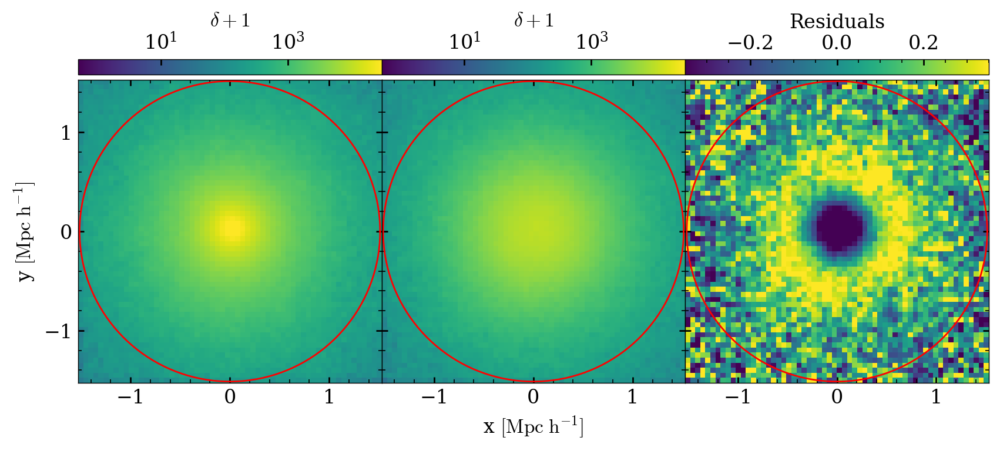

In [62]:
fig,axs = plt.subplots(1,3,sharex=True, sharey=True)#, gridspec_kw={"height_ratios": [1,1]},sharey=True)#,figsize=(8,10)
axs[0].set_ylabel(r"y $[\rm{Mpc} \ h^{-1}]$")#,fontsize=16)
axs[1].set_xlabel(r"x $[\rm{Mpc} \ h^{-1}]$")#,fontsize=16)
axs[0].set_yticks([-1, 0,1])
RES = 0.025


target_num = 3#count_targets[col]
target_mass = 14.5#mass_targets[row]
target_om_list = [0.14290558]
target_h_list = [0.5049]
h,om = target_h_list[0],target_om_list[0]


deltan,R,xsteps,ysteps = get_delta(target_num, target_mass,"nbod")
deltae,R,xsteps,ysteps = get_delta(target_num, target_mass,"emu")

res = (deltae-deltan)/deltan
c1=axs[0].imshow(np.reshape(deltan, (xsteps-1,ysteps-1)),extent = [-R,R,-R,R],norm=matplotlib.colors.LogNorm(vmin=0.5,vmax=3e4))
c2=axs[1].imshow(np.reshape(deltae, (xsteps-1,ysteps-1)),extent = [-R,R,-R,R],norm=matplotlib.colors.LogNorm(vmin=0.5,vmax=3e4))


c3=axs[2].imshow(np.reshape(res, (xsteps-1,ysteps-1)),extent = [-R,R,-R,R],vmin=-0.35,vmax=0.35)
plt.subplots_adjust(hspace=0.0,wspace=0)


plt.colorbar(c1,ax=axs[0], label=r"$\delta + 1$",location="top",pad=0.01)
plt.colorbar(c2,ax=axs[1], label=r"$\delta + 1$",location="top",pad=0.01)
plt.colorbar(c3,ax=axs[2], label=r"Residuals",location="top",pad=0.01)

theta = np.linspace( 0 , 2 * np.pi , 150 )
radius = R/1.01
a = radius * np.cos( theta )
b = radius * np.sin( theta )
for x in range(3):
    axs[x].plot(a,b,color="red") 


plt.savefig("figures/stacked1.pdf", bbox_inches="tight")    



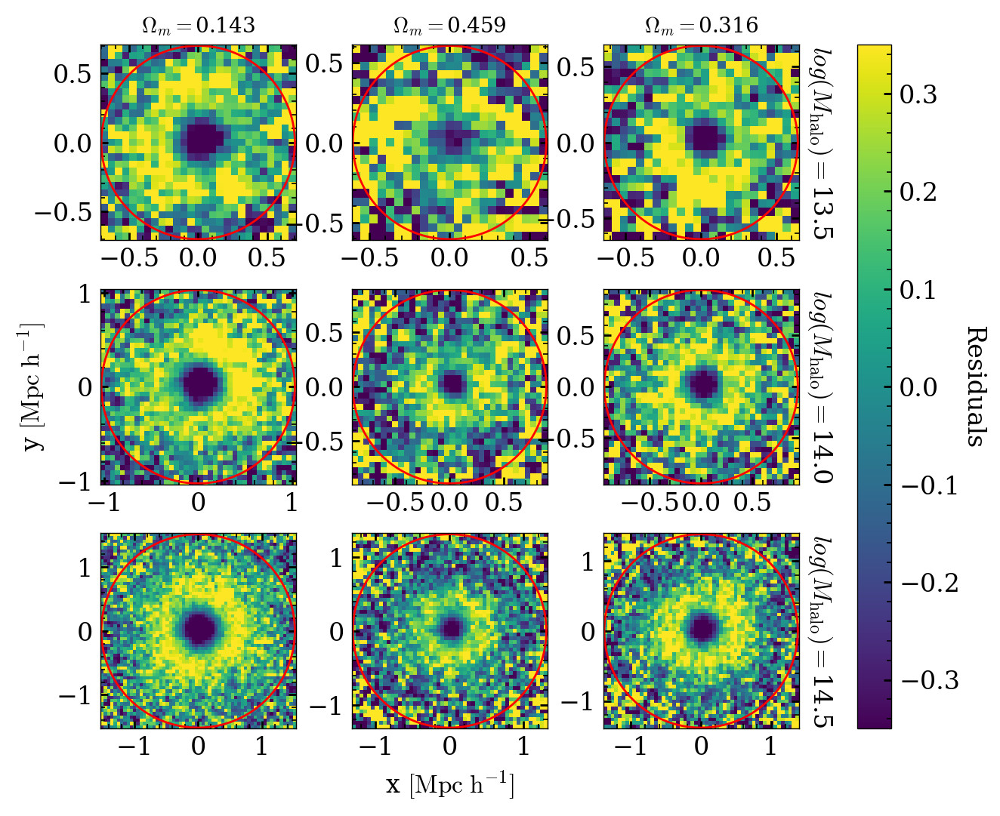

In [61]:
count_targets = [3,5,6]
mass_targets = [13.5,14.0,14.5]
target_om_list = [0.14290558, 0.45916243, 0.31571019]
target_h_list = [0.5049, 0.7902, 0.5755]
NC = len(count_targets)
NR = len(mass_targets)

N=500
RES = 0.025
# xsteps = 50
# ysteps = xsteps

fig,axs = plt.subplots(3,3)#,sharex="row", sharey="row")#, gridspec_kw={"height_ratios": [1,1]},sharey=True)#,figsize=(8,10)
axs[1][0].set_ylabel(r"y $[\rm{Mpc} \ h^{-1}]$")#,fontsize=16)
axs[2][1].set_xlabel(r"x $[\rm{Mpc} \ h^{-1}]$")#,fontsize=16)
#axs[0].set_yticks([-1, 0,1])
theta = np.linspace( 0 , 2 * np.pi , 150 )


for col in range(NC):
    for row in range(NR):
        target_num = count_targets[col]
        target_mass = mass_targets[row]
#         print(target_num, target_mass)
        
        deltan,R,xsteps,ysteps = get_delta(target_num, target_mass,"nbod")
        deltae,R,xsteps,ysteps = get_delta(target_num, target_mass,"emu")
#         print(R)
#         print()
        res = (deltae-deltan)/deltan
        res[np.where(deltan==0)] = 0
        
        om, h = target_om_list[col], target_h_list[col]
        r =  R/1.01#r_vir(np.power(10,target_mass),0,h,om)
        axs[row][col].plot(r*np.cos( theta ), r*np.sin(theta),color="red")
        c=axs[row][col].imshow(np.reshape(res, (xsteps-1,ysteps-1)),extent = [-R,R,-R,R],vmin=-0.35,vmax=0.35)
# c2=axs[1].imshow(np.reshape(deltae, (xsteps-1,ysteps-1)),extent = [-R,R,-R,R],norm=matplotlib.colors.LogNorm(vmin=0.5,vmax=3e4))


# c3=axs[2].imshow(np.reshape(res, (xsteps-1,ysteps-1)),extent = [-R,R,-R,R],vmin=-0.35,vmax=0.35)




for i in range(3):
    axs[i][2].set_ylabel(r"$log(M_{\rm{halo}})=$"+str(mass_targets[i]),rotation=270,labelpad=17.0)
    axs[i][2].yaxis.set_label_position("right")
    axs[0][i].set_title(r"$\Omega_m=$"+str(round(target_om_list[i],3)),fontsize=10)


    
plt.subplots_adjust(hspace=0.25,wspace=-0.42)
cbar=plt.colorbar(c,ax=axs, label=r"Residuals",pad=0.05)
cbar.set_label(label=r"Residuals", rotation=270,labelpad=12.0)
plt.savefig("figures/stacked2.pdf", bbox_inches="tight")    



# Fig 5 (HMF)

3.1945979999999827
6.53943839999996
5.54416499999997
2.1370535999999887
2.9430455999999885
5.1330443999999735
5.461816799999979
3.8848457999999866


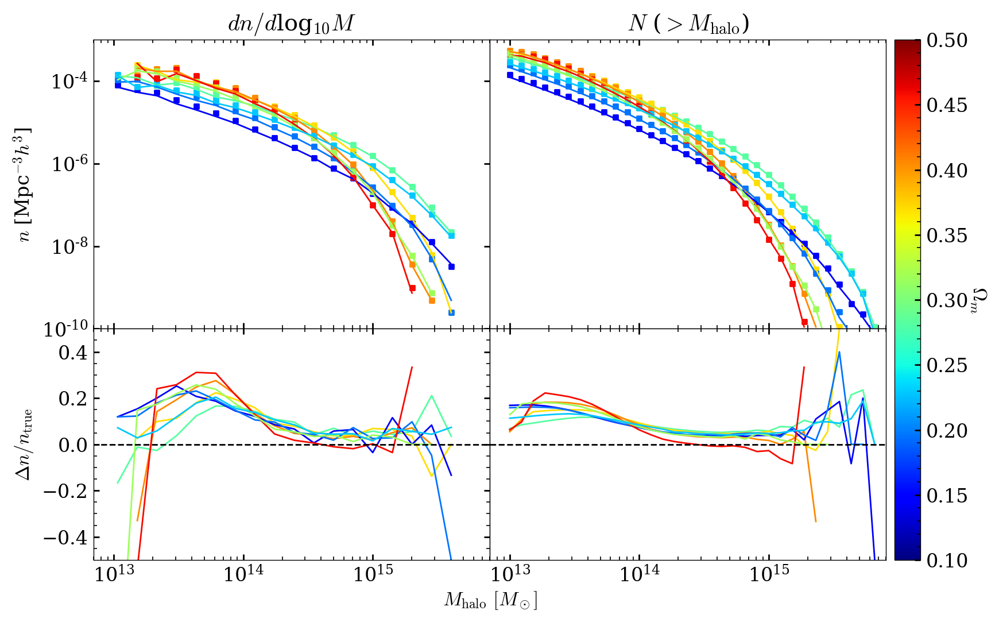

In [17]:
def read_cmf_data(f):
    df = pd.read_csv(f)
    binsE,binsN,numN,numE = np.array(df["binsE"]), np.array(df["binsN"]), np.array(df["numN"])  , np.array(df["numE"])
    return binsE,binsN,numN/(1e9*27),numE/(1e9*27)

def cmf_to_hmf(bins,N):
    squish = 5
    dlogm = np.log10(bins[squish]) - np.log10(bins[0])
    N1 = N[0:-squish:squish]- (N[squish::squish])
#     x=0
#     size = int(np.size(N1)/3.0)
#     N2 = np.zeros(size)
#     while(x<squish):
#         N2 += N1[x::squish]
#         x+=1
        
    
    dn = -1*(N1[1:]-N1[:-1])
    dndlnm = dn/(dlogm)
    return (bins[1:-1])[::squish], dndlnm

files = np.sort(list(glob.iglob("data/hmf*")))
omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])

fig,axs = plt.subplots(2,2, gridspec_kw={"height_ratios": [1,0.8]})#,sharex=True)#,sharey=True)#,figsize=(8,10)
for a in range(2):
    for b in range(2):
        axs[a][b].set_xscale("log")
        axs[a][b].set_xlim(7e12,8e15)

axs[1][1].set_ylim(-0.5,0.5)
axs[1][0].set_ylim(-0.5,0.5)
axs[0][1].set_ylim(1e-10, 1e-3)
axs[0][0].set_ylim(1e-10, 1e-3)
axs[0][0].set_yscale("log")
axs[0][1].set_yscale("log")
axs[0][1].set_yticks([])
axs[1][1].set_yticks([])

for count in range(8):
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    
    binsE,binsN,numN,numE = read_cmf_data(files[count])

    filt1 = np.where(numN > 0)[0][::3]
    filt2 = np.where(numE > 0)[0][::3]
    axs[0][1].plot(binsN[filt1], numN[filt1], color=col) 
    axs[0][1].scatter(binsE[filt2], numE[filt2], color=col, marker="s", s=10)
    axs[1][1].plot(binsN[filt1], (numE[filt1]-numN[filt1])/numN[filt1], color=col) 
    
    binsE, hmfE = cmf_to_hmf(binsE,numE)
    binsN, hmfN = cmf_to_hmf(binsN,numN)
    filt1 = np.where(hmfN > 0)[0]
    filt2 = np.where(hmfE > 0)[0]

    axs[0][0].plot(binsN[filt1], hmfN[filt1], color=col) 
    axs[0][0].scatter(binsE[filt2], hmfE[filt2], color=col, marker="s", s=10)
    print(np.max(hmfE)*1e9*27/1e6)
    axs[1][0].plot(binsN[filt1], (hmfE[filt1]-hmfN[filt1])/hmfN[filt1], color=col)    
    
axs[1][0].plot([1e12,1e16], [0,0], color="black",ls="dashed")
axs[1][1].plot([1e12,1e16], [0,0], color="black",ls="dashed")




axs[0][0].set_ylabel(r"$n$ [Mpc$^{-3} h^3$]")
axs[0][0].set_ylabel(r"$n$ [Mpc$^{-3} h^3$]")
axs[0][1].set_title(r"$N$ ($>M_{\rm halo}$)")
axs[1][0].set_ylabel(r"$\Delta n/n_{\rm true}$")
axs[0][0].set_title(r"$dn/d$log$_{10}M$")
fig.text(0.47, 0.06, r"$M_{\rm halo}$ $[M_\odot]$", ha='center')


plt.subplots_adjust(hspace=0,wspace=0)

c=axs[0][0].scatter(binsE[0:2], hmfE[0:2], c=[0.1,0.5], cmap=CMAP, s=0)
cbar=plt.colorbar(c,ax=axs,pad=0.01,fraction=0.1)
cbar.set_label(r"$\Omega_m$", rotation=270,labelpad=12.0)

plt.savefig("figures/hmf_full.pdf", bbox_inches="tight")    



# Fig 6 Pk haloes

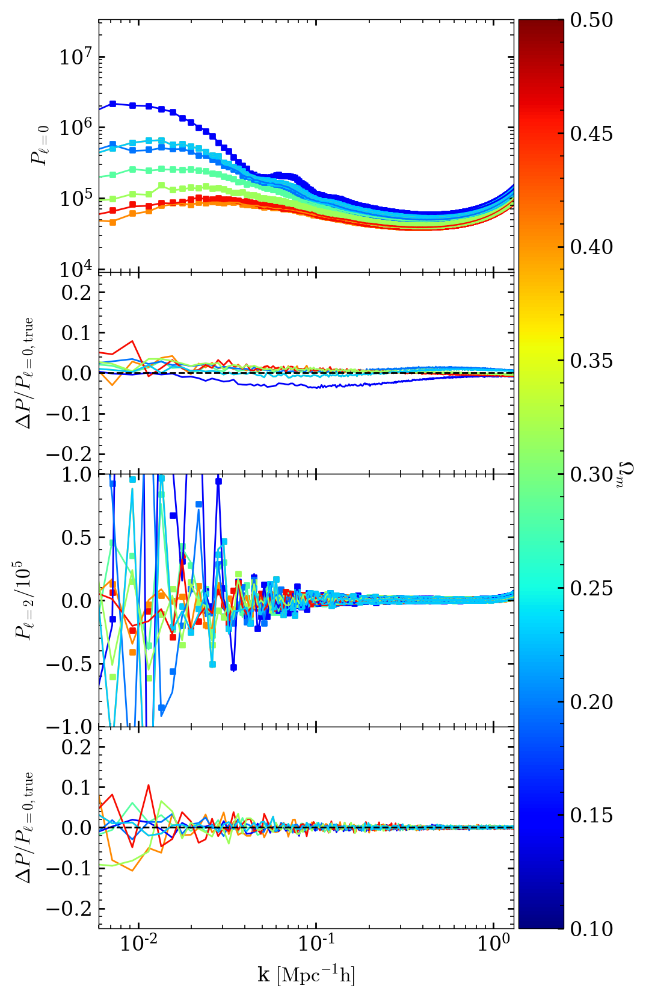

In [31]:

files = list(glob.iglob("data/Pk*_halo*"))

def get_dat(f):
    df = pd.read_csv(f)
    k,pk0, pk2 = np.array(df["k"]), np.array(df["Pk0"]), np.array(df["Pk2"])  
    return k,pk0, pk2




ROW=4
fig,axs = plt.subplots(ROW,1, gridspec_kw={"height_ratios": [1,0.8,1,0.8]},sharex=True,figsize=(5,10))

xmin,xmax=6e-3,1.3

axs[0].set_yscale("log")
axs[1].set_ylim(-0.25,0.25)
axs[3].set_ylim(-0.25,0.25)

m=1e5/1e5
axs[2].set_ylim(-m,m)
for x in range(ROW):
    axs[x].set_xscale("log")
    axs[x].set_xlim(xmin,xmax)

# if(pole == 0): 
axs[0].set_ylabel(r"$P_{\ell=0}$")#,fontsize=20)
axs[2].set_ylabel(r"$P_{\ell=2}/10^5$")#,fontsize=20)
axs[1].set_ylabel(r"$\Delta P/P_{\ell=0, \rm{true}}$")#,fontsize=16)
axs[3].set_ylabel(r"$\Delta P/P_{\ell=0, \rm{true}}$")#,fontsize=16)
axs[3].set_xlabel(r"k $[\rm{Mpc}^{-1} h]$")#,fontsize=16)



omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])
a=0
#print(files)
for pole in [0,1]:
    for count in range(8):
        for f in files: 

            if(str(count) in f):
                if("nbod" in f): fnbod = f
                elif("emu" in f): femu = f
        #print(fnbod, femu)
        k,pk0nbod, pk2nbod = get_dat(fnbod)
        k,pk0emu, pk2emu = get_dat(femu)
        pknbod = [pk0nbod, pk2nbod][pole]
        pkemu = [pk0emu, pk2emu][pole]
        p0true = pk0nbod

        om = omlist[np.where(nlist==count)][0]
        col = CMAP((om-0.1)/0.4)

        ind=1
        fac=1
        if(pole==1):
            fac = 1e5
        axs[pole*2].plot(k[::ind],pknbod[::ind]/fac,color = col)
        axs[pole*2].scatter(k[::ind], pkemu[::ind]/fac, color=col, marker="s", s=10)
        axs[pole*2+1].plot(k[::ind], (pkemu[::ind]-pknbod[::ind])/p0true[::ind], color=col)   
        #axs[1].plot(k[filt], (pkemu[filt])/pknbod[filt], color=col)   
    a+=1
        
axs[1].plot([xmin,xmax], [0,0], color="black",ls="dashed")
axs[3].plot([xmin,xmax], [0,0], color="black",ls="dashed")
plt.subplots_adjust(hspace=0,wspace=0)
            
c=axs[pole*2].scatter([k[0], k[1]], [pknbod[0], pknbod[1]], c=[0.1,0.5], cmap=CMAP, s=0)

cbar = plt.colorbar(c,ax=axs,pad=0.01,fraction=0.1)
cbar.set_label(r"$\Omega_m$", rotation=270,labelpad=12.0)
savename = "Pk_haloes_"#+str(type_)+"pole"+str(pole*2)


plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



# Fig 7 Bk haloes

['data\\Bk_emu_halos_0', 'data\\Bk_emu_halos_1', 'data\\Bk_emu_halos_2', 'data\\Bk_emu_halos_3', 'data\\Bk_emu_halos_4', 'data\\Bk_emu_halos_5', 'data\\Bk_emu_halos_6', 'data\\Bk_emu_halos_7', 'data\\Bk_nbod_halos_0', 'data\\Bk_nbod_halos_1', 'data\\Bk_nbod_halos_2', 'data\\Bk_nbod_halos_3', 'data\\Bk_nbod_halos_4', 'data\\Bk_nbod_halos_5', 'data\\Bk_nbod_halos_6', 'data\\Bk_nbod_halos_7']


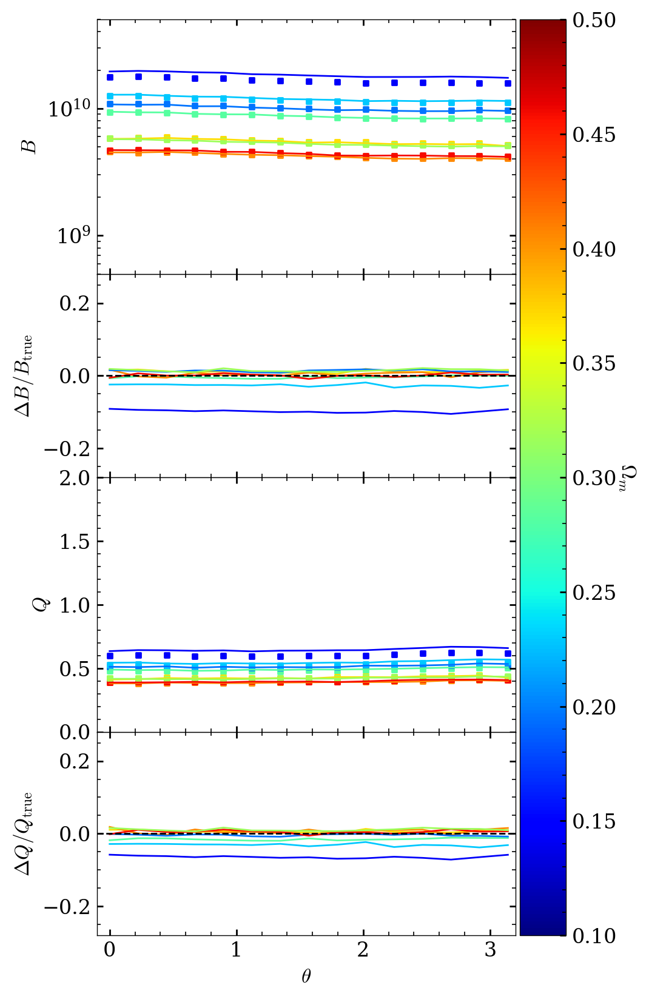

In [32]:

files = list(glob.iglob("data/Bk*_halos_?"))
new_files = []
for f in files:
    if("HIGH" not in f): new_files.append(f)
files = new_files
print(files)



def get_bk_theta(f):
    df = pd.read_csv(f)
    t,q,b = np.array(df["theta"]), np.array(df["Qk"]), np.array(df["Bk"])  
    return t,q,b




COL=1
fig,axs = plt.subplots(4,COL, gridspec_kw={"height_ratios": [1,0.8,1,0.8]},figsize=(5,10))
xmin,xmax = -0.1,3.2
for x in range(4):
    axs[x].set_xlim(xmin,xmax)
axs[0].set_ylim(5e8,5e10)
axs[1].set_ylim(-0.28,0.28)
axs[2].set_ylim(0,2)
axs[3].set_ylim(-0.28,0.28)

axs[0].set_ylabel(r"$ B $")
axs[1].set_ylabel(r"$\Delta B / B_{\rm true}$")
axs[2].set_ylabel(r"$Q$")
axs[3].set_ylabel(r"$\Delta Q / Q_{\rm true}$")

#axs[3][0].set_xlabel(r"k $[\rm{Mpc}^{-1} h]$")
axs[3].set_xlabel(r"$\theta$")
#as[3][2].set_xlabel(r"S")

axs[0].set_yscale("log")
#axs[0][1].set_yscale("log")
#axs[0][2].set_yscale("log")
    
for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    t,qn,bn = get_bk_theta(fnbod)
    t,qe,be = get_bk_theta(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    
    
    axs[0].scatter(t,be, color=col, marker="s", s=10)
    axs[0].plot(t, bn, color=col) 
    axs[1].plot(t, (be-bn)/bn, color=col)
    axs[2].scatter(t, qe, color=col, marker="s", s=10)
    axs[2].plot(t, qn, color=col) 
    axs[3].plot(t, (qe-qn)/qn, color=col)  
    
axs[1].plot([xmin,xmax], [0,0], color="black",ls="dashed")
axs[3].plot([xmin,xmax], [0,0], color="black",ls="dashed")
plt.subplots_adjust(hspace=0,wspace=0)
            
c=axs[0].scatter(t[0:2], bn[0:2], c=[0.1,0.5], cmap=CMAP, s=0)

cbar = plt.colorbar(c,ax=axs,pad=0.01,fraction=0.1)
cbar.set_label(r"$\Omega_m$", rotation=270,labelpad=12.0)
savename = "Bk_haloes_"#+str(type_)+"pole"+str(pole*2)


plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



# Figure 9 WST 

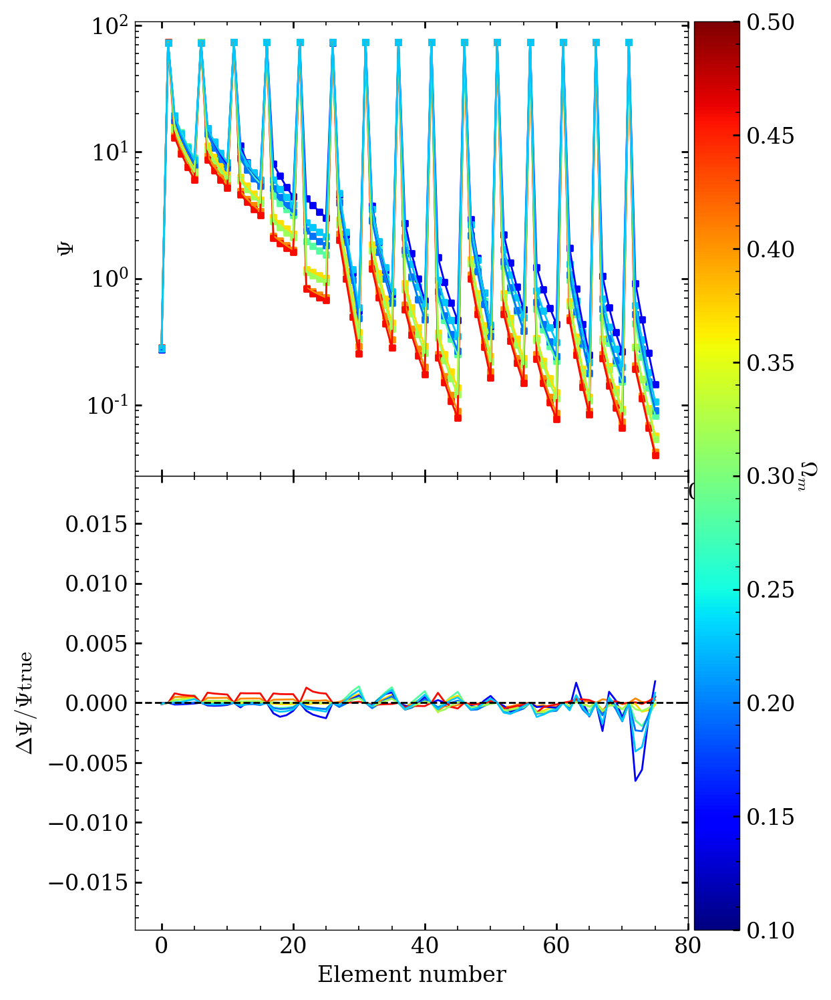

In [60]:

files = list(glob.iglob("data/wst*"))


def get_wst(f):
    df = pd.read_csv(f)
    n,wst = np.array(df["n"]), np.array(df["wst_coefficients"])
    return n,wst




COL=1
fig,axs = plt.subplots(2,1,figsize=(6,9))#gridspec_kw={"height_ratios": [1,0.8,1,0.8]},figsize=(6,12))

xmin=-4
xmax = 80
axs[0].set_xlim(xmin,xmax)
axs[1].set_xlim(xmin,xmax)

#axs[0].set_ylim(1e6,2e9)
axs[1].set_ylim(-0.019,0.019)

axs[0].set_ylabel(r"$\Psi $")
axs[1].set_ylabel(r"$\Delta \Psi/\Psi{\rm{true}} $")
axs[1].set_xlabel(r"Element number")
axs[0].set_yscale("log")

for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    nn,wstn = get_wst(fnbod)
    ne,wste = get_wst(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    
    
    axs[0].scatter(ne,wste, color=col, marker="s", s=10)
    axs[0].plot(nn, wstn, color=col) 
    axs[1].plot(nn, (wste-wstn)/wstn, color=col)

    
axs[1].plot([xmin,xmax], [0,0], color="black",ls="dashed")
plt.subplots_adjust(hspace=0,wspace=0)
            
c=axs[0].scatter(nn[0:2], wstn[0:2], c=[0.1,0.5], cmap=CMAP, s=0)

cbar = plt.colorbar(c,ax=axs,pad=0.01,fraction=0.1)
cbar.set_label(r"$\Omega_m$", rotation=270,labelpad=12.0)
savename = "wst_"#+str(type_)+"pole"+str(pole*2)


plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



# testing HMF

In [4]:
a = np.array([1,2,3,4,5,6])
a.data.c_contiguous

True

In [45]:

dsemu = yt.load("particle_test_emu/halos_0.0.bin")
dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
mass_emu  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))
vel_nbod  = np.array(dsnbody.all_data()["particle_velocity"]) 
vel_emu  = np.array(dsemu.all_data()["particle_velocity"])            
pos_nbod  = np.array(dsnbody.all_data()["particle_position"])
pos_emu  = np.array(dsemu.all_data()["particle_position"]) 



yt : [INFO     ] 2024-12-18 21:36:29,461 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2024-12-18 21:36:29,463 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2024-12-18 21:36:29,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2024-12-18 21:36:29,466 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2024-12-18 21:36:29,467 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2024-12-18 21:36:29,467 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2024-12-18 21:36:29,467 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2024-12-18 21:36:29,468 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2024-12-18 21:36:29,468 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2024-12-18 21:36:29,468 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2024-12-18 21:36:29,527 Parameters: curren

ERROR IN get_hmf(mass), mass isn't filtered.


In [81]:
# f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
# f0emu = BigFileCatalog('fof_halos/lh0000_emu')
# mass_nbod  = np.array(f0nbody["Mass"])
# mass_emu  = np.array(f0emu["Mass"])
# vel_nbod  = np.array(f0nbody["Velocity"])
# vel_emu  = np.array(f0emu["Velocity"])            
# pos_nbod  = np.array(f0nbody["Position"])
# pos_emu  = np.array(f0emu["Position"])   

In [87]:
id_ = np.linspace(1,1536**3, 1536**3).astype(int)

In [88]:
id_[-10:]

array([-2147483648, -2147483648, -2147483648, -2147483648, -2147483648,
       -2147483648, -2147483648, -2147483648, -2147483648, -2147483648])

In [85]:
def get_hmf(mass, log_low_m = 13, bins = []): #dn/dlnM
    log_mass = np.log10(mass)
    if(np.min(log_mass)< log_low_m): 
        print("ERROR IN get_hmf(mass), mass isn't filtered.")
    if(bins == []): mass_range = np.logspace(log_low_m,16,10)
    else: mass_range = bins
    #dlogm = 1
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass >= lo) & (mass < up))[0]))
    N=np.array(N)
    dn = -1*(N[1:]-N[:-1])
    print(np.size(dn))
    print(np.size(mass_range))
    dndlnm = dn/dlogm
    
    return mass_range[1:-1], dndlnm


def get_cmf(mass, log_low_m = 13, bins = []):
    log_mass = np.log10(mass)
    if(np.min(log_mass)< log_low_m): 
        print("ERROR IN get_hmf(mass), mass isn't filtered.")
    if(bins == []): mass_range = np.logspace(log_low_m,16,20)
    else: mass_range = bins
    dlogm = 1#np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass >= lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range[:-1], hmf

#mass_nbod = mass_nbod[np.where(mass_nbod>1e13)]
#mass_emu = mass_emu[np.where(mass_emu>1e13)]

8
10
8
10


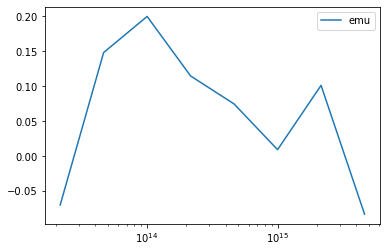

In [84]:


mass_range, hmfn = get_hmf(mass_nbod)
mass_range, hmfe = get_hmf(mass_emu)
plt.plot(mass_range,(hmfe-hmfn)/hmfn,label="emu")
# plt.plot(mass_range,hmfe/1e9,label="emu")
# plt.plot(mass_range,hmfn/1e9, label="nbody")
#plt.yscale("log")
plt.xscale("log")
plt.legend()

C:\Users\Matthew\AppData\Local\Temp/ipykernel_7236/4242825637.py:3: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range,(cmfe-cmfn)/cmfn,label="emu")


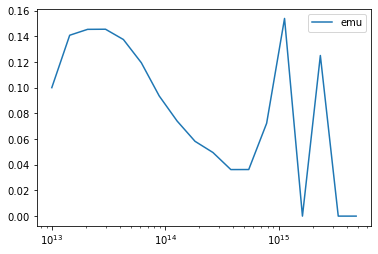

In [86]:
mass_range, cmfn = get_cmf(mass_nbod)
mass_range, cmfe = get_cmf(mass_emu)
plt.plot(mass_range,(cmfe-cmfn)/cmfn,label="emu")
# plt.plot(mass_range,hmfe/1e9,label="emu")
# plt.plot(mass_range,hmfn/1e9, label="nbody")
#plt.yscale("log")
plt.xscale("log")
plt.legend()

# testing stacks

In [102]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib

#df = pd.read_csv("stacked.txt")
files = list(glob.iglob("data/stacked_emu_3_mass_14.5_batch_*.npy"))

a = [np.load(f) for f in files]
d=np.concatenate((a[0], a[1],a[2],a[3],a[4]), axis=0)

R = np.max(np.abs(d))*1.01
N=500
xsteps = 50
ysteps = xsteps
cl = 2.0*R/xsteps
x,y,z = d.T[0], d.T[1], d.T[2]

#taking a smaller slice in z, 30% the width of x and y dims
z_width = 0.3*R
args = np.where(np.abs(z) <= z_width)
x = x[args]
y = y[args]

xlist,ylist, nTarget = [],[],[]
x0 = -R + cl/2.0
for xstep in range(xsteps-1):
    y0 = -R + cl/2.0
    #print(xstep)
    for ystep in range(ysteps-1):
        dx = np.abs(x0 - x)/cl
        dy = np.abs(y0 - y)/cl
        args =np.where((dx <=1.0) & (dy <=1.0))
        weight = (1-dx[args])*(1-dy[args])
        nTarget.append(np.sum(weight))
        xlist.append(x0)
        ylist.append(y0)
        y0 += cl
    x0 +=cl

xlist = np.array(xlist)
ylist = np.array(ylist)

slice_factor = cl/z_width
nTarget = np.array(nTarget)*slice_factor/N

n_ave = (1536*cl/3000.0)**3
delta = nTarget/n_ave +0 ### THIS SHOULD REALLY BE +0 but some cells have 0 particles and the log breaks
delta

array([ 37.946194,  61.031845,  61.02652 , ..., 152.08043 , 163.30899 ,
       109.165215], dtype=float32)

In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import glob

#df = pd.read_csv("stacked.txt")
files = list(glob.iglob("data/stacked_nbod_3_mass_13.5_batch_*.npy"))

a = [np.load(f) for f in files]
d=np.concatenate((a[0], a[1],a[2],a[3],a[4]), axis=0)

R = np.max(np.abs(d))*1.01
N=500
xsteps = 50
ysteps = xsteps
cl = 2.0*R/xsteps
x,y,z = d.T[0], d.T[1], d.T[2]

#taking a smaller slice in z, 30% the width of x and y dims
z_width = 0.3*R
args = np.where(np.abs(z) <= z_width)
x = x[args]
y = y[args]

xlist,ylist, nTarget = [],[],[]
x0 = -R + cl/2.0
for xstep in range(xsteps-1):
    y0 = -R + cl/2.0
    #print(xstep)
    for ystep in range(ysteps-1):
        dx = np.abs(x0 - x)/cl
        dy = np.abs(y0 - y)/cl
        args =np.where((dx <=1.0) & (dy <=1.0))
        weight = (1-dx[args])*(1-dy[args])
        nTarget.append(np.sum(weight))
        xlist.append(x0)
        ylist.append(y0)
        y0 += cl
    x0 +=cl

xlist = np.array(xlist)
ylist = np.array(ylist)

slice_factor = cl/z_width
nTarget = np.array(nTarget)*slice_factor/N

n_ave = (1536*cl/3000.0)**3
delta = nTarget/n_ave +0 ### THIS SHOULD REALLY BE +0 but some cells have 0 particles and the log breaks
delta

array([ 12.090406 , 149.01314  ,  90.78144  , ..., 114.27075  ,
         3.1321418,  75.56993  ], dtype=float32)

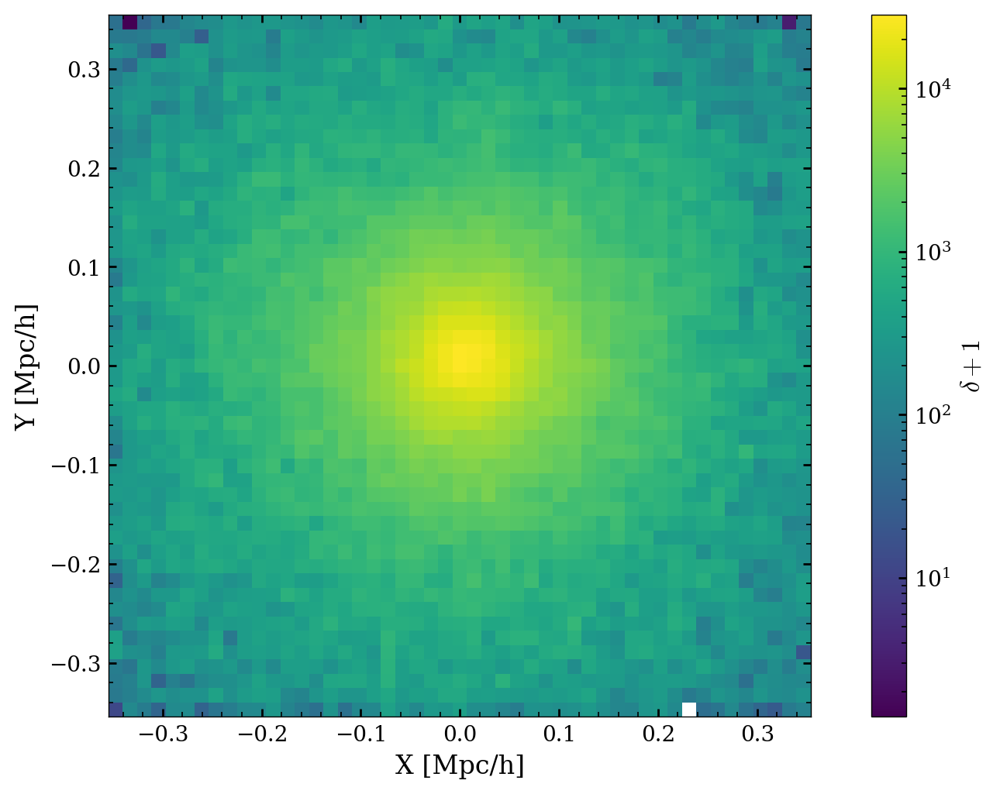

In [27]:
plt.figure()
plt.imshow(np.reshape(delta, (xsteps-1,ysteps-1)),extent = [-R/2.0,R/2.0,-R/2.0,R/2.0],norm=matplotlib.colors.LogNorm())
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
plt.colorbar(label=r"$\delta + 1$")
plt.show()

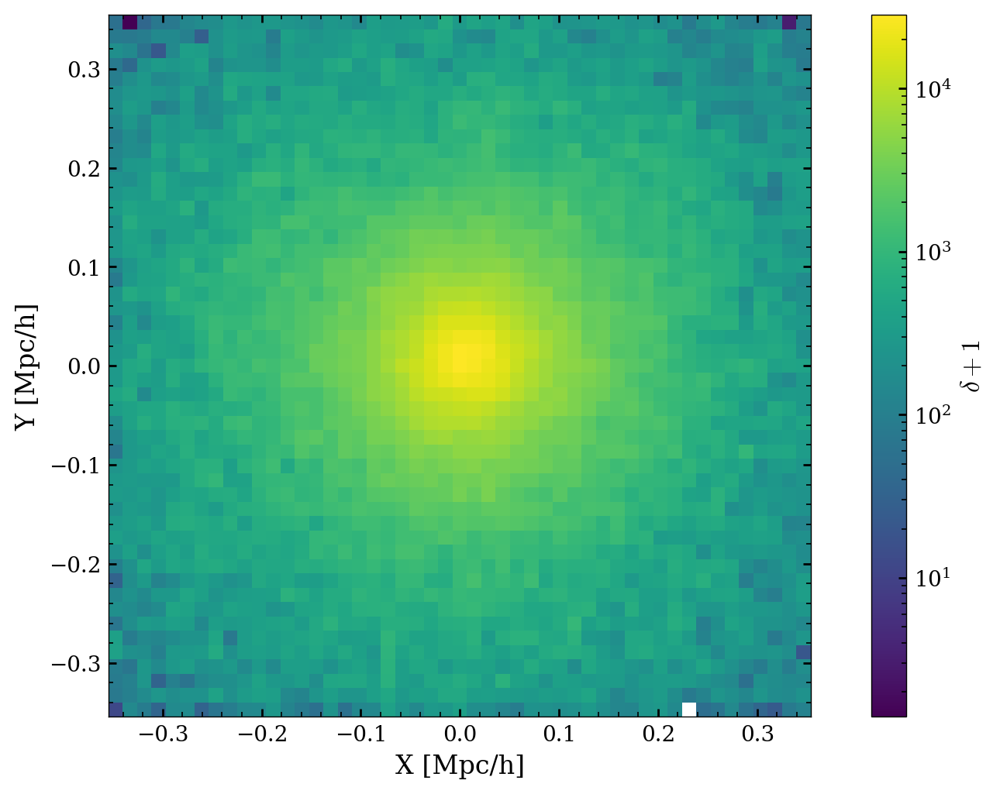

In [28]:
plt.figure()
plt.imshow(np.reshape(delta, (xsteps-1,ysteps-1)),extent = [-R/2.0,R/2.0,-R/2.0,R/2.0],norm=matplotlib.colors.LogNorm())
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
plt.colorbar(label=r"$\delta + 1$")
plt.show()

In [28]:
a = np.linspace(0,100,100)
np.save("test", a)

C:\Users\Matthew\AppData\Local\Temp/ipykernel_7236/1996240631.py:19: RuntimeWarning: divide by zero encountered in true_divide
  nResidual = (np.array(nNbod)-np.array(nEmu))/np.array(nNbod)
C:\Users\Matthew\AppData\Local\Temp/ipykernel_7236/1996240631.py:19: RuntimeWarning: invalid value encountered in true_divide
  nResidual = (np.array(nNbod)-np.array(nEmu))/np.array(nNbod)


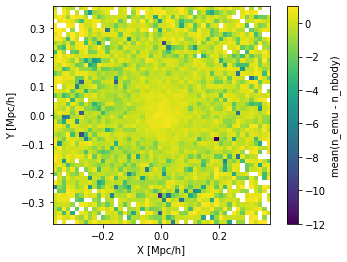

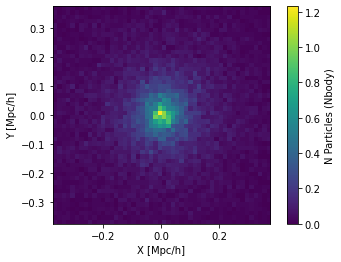

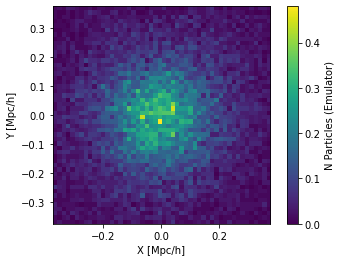

In [35]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt




#df = pd.read_csv("stacked.txt")
files = list(glob.iglob("data/stacked_3_mass_14.0_batch_*.txt"))
for f in files: print(f)
df = pd.read_csv("data/stacked_3_mass_14.0_batch_*.txt")


x,y,nNbod, nEmu = df["x"], df["y"], df["nNbod"], df["nEmu"]
mr = np.max(np.abs(x))
N=500
xsteps = 50
ysteps = xsteps
dx = 2.0*mr/xsteps
dy = dx
plt.figure()
nResidual = (np.array(nNbod)-np.array(nEmu))/np.array(nNbod)
plt.imshow(np.reshape(nResidual, (xsteps,ysteps)),extent = [-mr/2.0,mr/2.0,-mr/2.0,mr/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
plt.colorbar(label="mean(n_emu - n_nbody)")
plt.show()
plt.figure()
nResidual = (np.array(nNbod))
plt.imshow(np.reshape(nResidual/N, (xsteps,ysteps)),extent = [-mr/2.0,mr/2.0,-mr/2.0,mr/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
plt.colorbar(label="N Particles (Nbody)")
plt.savefig("figures/nbody_stack.pdf", bbox_inches="tight")
plt.figure()
nResidual = (np.array(nEmu))
plt.imshow(np.reshape(nResidual/N, (xsteps,ysteps)),extent = [-mr/2.0,mr/2.0,-mr/2.0,mr/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
plt.colorbar(label="N Particles (Emulator)")
#plt.savefig("figures/emu_stack.pdf", bbox_inches="tight")


# Bk plots 

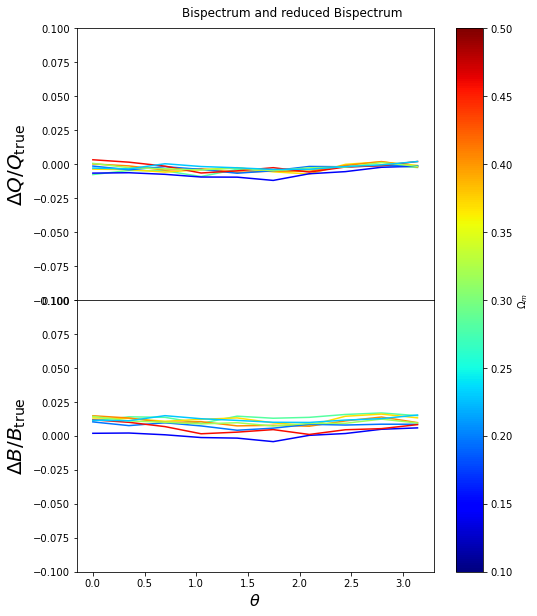

In [161]:
import pandas as pd
import glob
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 10})

files = list(glob.iglob("data/Bk*"))
#print(files)
CMAP = plt.cm.jet

def get_bk_theta(f):
    df = pd.read_csv(f)
    t,q,b = np.array(df["theta"]), np.array(df["Qk"]), np.array(df["Bk"])  
    return t,q,b




fig,axs = plt.subplots(2, gridspec_kw={"height_ratios": [1,1]},figsize=(8,10), sharex=True)
#axs[0].set_yscale("log")
# axs[0].set_xscale("log")
# axs[1].set_xscale("log")
axs[1].set_xlabel(r"$\theta$",fontsize=16)

axs[0].set_ylabel(r"$\Delta Q / Q_{\rm true}$",fontsize=20)
axs[1].set_ylabel(r"$\Delta B / B_{\rm true}$",fontsize=20)


axs[0].set_ylim(-0.1,0.1)
axs[1].set_ylim(-0.1,0.1)

title = "Bispectrum and reduced Bispectrum"
fig.suptitle(title,y=0.91)

omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])
#print(nlist,omlist)


for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    #print(fnbod, femu)
    t,qn,bn = get_bk_theta(fnbod)
    t,qe,be = get_bk_theta(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    

    axs[0].plot(t, (qe-qn)/qn, color=col)   
    axs[1].plot(t, (be-bn)/bn, color=col)   
    #axs[1].plot(k[filt][::ind], (pkemu[filt][::ind]-pknbod[filt][::ind])/p0true[filt][::ind], color=col)   
    #axs[1].plot(k[filt], (pkemu[filt])/pknbod[filt], color=col)   

plt.subplots_adjust(hspace=0)
    
c=axs[1].scatter([t[0], t[1]], [be[0], be[1]], c=[0.1,0.5], cmap=CMAP, s=0)

plt.colorbar(c,ax=axs.ravel().tolist(), label=r"$\Omega_m$")
savename = "Bk_"+str(count)
plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



# Bk squeeze

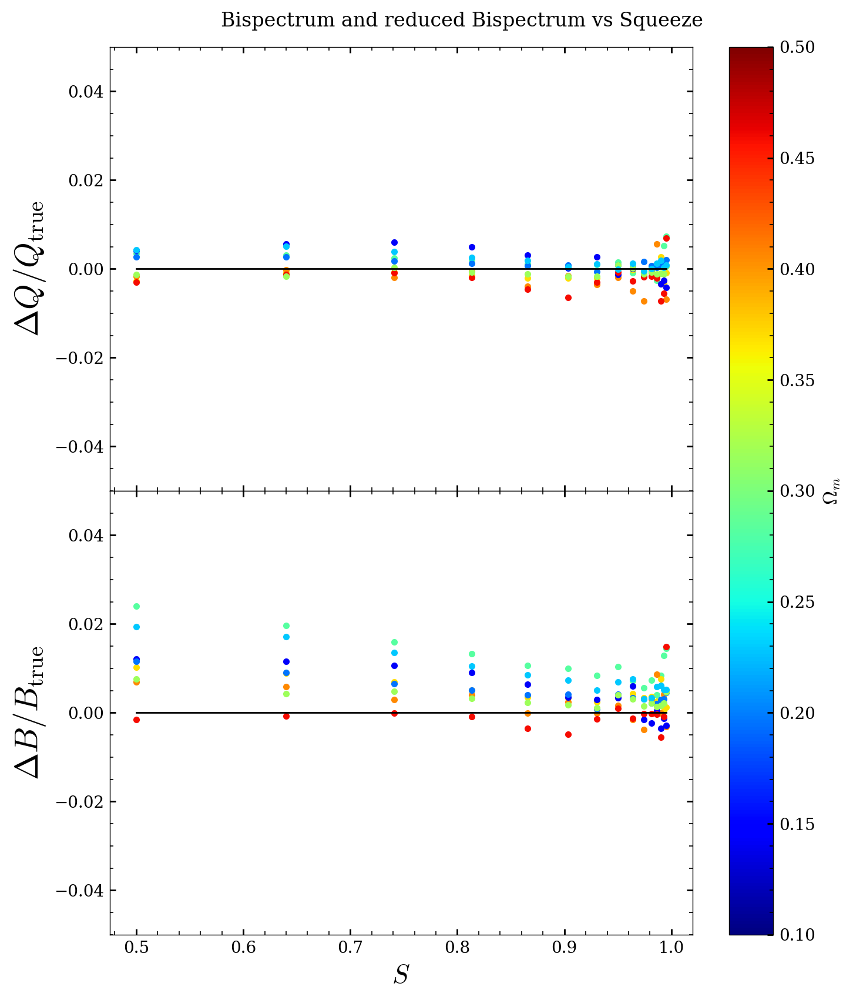

In [12]:
import pandas as pd
import glob
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 10})

files = list(glob.iglob("data/Bk*squeeze*"))
#print(files)
CMAP = plt.cm.jet

def get_bk_squeeze(f):
    df = pd.read_csv(f)
    t,k1,k2,q,b = np.array(df["thetas"]), np.array(df["k1"]), np.array(df["k2"]), np.array(df["Qk"]), np.array(df["Bk"])  
    return t,k1,k2,q,b




fig,axs = plt.subplots(2, gridspec_kw={"height_ratios": [1,1]},figsize=(8,10), sharex=True)
#axs[0].set_yscale("log")
# axs[0].set_xscale("log")
# axs[1].set_xscale("log")
axs[1].set_xlabel(r"$S$",fontsize=16)

axs[0].set_ylabel(r"$\Delta Q / Q_{\rm true}$",fontsize=20)
axs[1].set_ylabel(r"$\Delta B / B_{\rm true}$",fontsize=20)


axs[0].set_ylim(-0.05,0.05)
axs[1].set_ylim(-0.05,0.05)

title = "Bispectrum and reduced Bispectrum vs Squeeze"
fig.suptitle(title,y=0.91)

omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])
#print(nlist,omlist)


for count in range(8):
    for f in files: 
        if(str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    #print(fnbod, femu)
    t,k1n,k2n,qn,bn = get_bk_squeeze(fnbod)
    t,k1e,k2e,qe,be = get_bk_squeeze(femu)
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
#     print(t,k1n,k2n)
#     print(t,k1e,k2e)
    s = 1-k1e/(2*k2e)
    

    axs[0].scatter(s, (qe-qn)/qn, color=col)   
    axs[1].scatter(s, (be-bn)/bn, color=col)   
    #axs[1].plot(k[filt][::ind], (pkemu[filt][::ind]-pknbod[filt][::ind])/p0true[filt][::ind], color=col)   
    #axs[1].plot(k[filt], (pkemu[filt])/pknbod[filt], color=col)   

plt.subplots_adjust(hspace=0)
    
c=axs[1].scatter([s[0], s[1]], [be[0], be[1]], c=[0.1,0.5], cmap=CMAP, s=0)
axs[0].plot([np.min(s), np.max(s)], [0,0], color="black")
axs[1].plot([np.min(s), np.max(s)], [0,0], color="black")
plt.colorbar(c,ax=axs.ravel().tolist(), label=r"$\Omega_m$")
savename = "Bk_squeeze_"+str(count)
plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



# test Pk plots

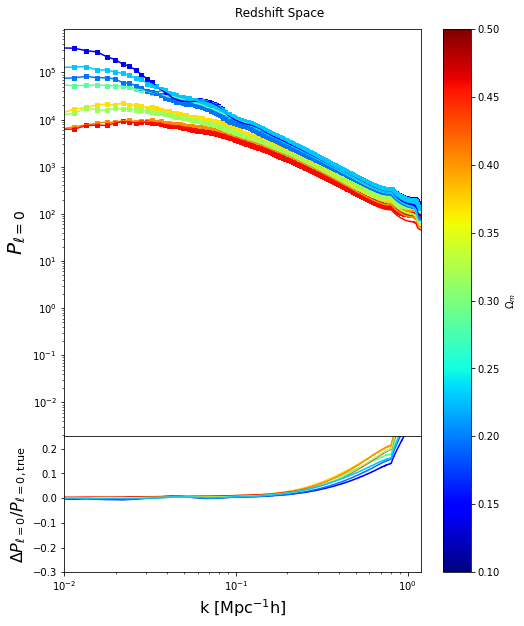

In [14]:
import pandas as pd
import glob
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 10})

files = list(glob.iglob("data/Pk*"))
#print(files)
CMAP = plt.cm.jet

def get_dat(f):
    df = pd.read_csv(f)
    k,pk0, pk2 = np.array(df["k"]), np.array(df["Pk0"]), np.array(df["Pk2"])  
    return k,pk0, pk2



type_ = "rsd" # real or rsd
pole = 0 # 0 for mono, 1 for quad



fig,axs = plt.subplots(2, gridspec_kw={"height_ratios": [3,1]},figsize=(8,10), sharex=True)
axs[0].set_yscale("log")
axs[0].set_xscale("log")
axs[1].set_xscale("log")
axs[1].set_xlabel(r"k $[\rm{Mpc}^{-1} h]$",fontsize=16)
if(pole == 0): 
    axs[0].set_ylabel(r"$P_{\ell=0}$",fontsize=20)
    axs[1].set_ylabel(r"$\Delta P_{\ell=0}/P_{\ell=0, \rm{true}}$",fontsize=16)
if(pole == 1): 
    axs[0].set_ylabel(r"$P_{\ell=2}$",fontsize=20)
    axs[1].set_ylabel(r"$\Delta P_{\ell=2}/P_{\ell=0, \rm{true}}$",fontsize=16)
    
axs[1].set_ylim(-0.3,0.25)
#axs[1].set_ylim(0,2)
axs[0].set_xlim(1e-2,1.2)
axs[1].set_xlim(1e-2,1.2)
title = "Real Space"
if(type_ == "rsd"): title = "Redshift Space"
fig.suptitle(title,y=0.91)

omdf = pd.read_csv("data/om_list")
nlist, omlist = np.array(omdf["n"]), np.array(omdf["Om"])
#print(nlist,omlist)


for count in range(8):
    for f in files: 
        if(type_ in f  and str(count) in f):
            if("nbod" in f): fnbod = f
            elif("emu" in f): femu = f
    #print(fnbod, femu)
    k,pk0nbod, pk2nbod = get_dat(fnbod)
    k,pk0emu, pk2emu = get_dat(femu)
    pknbod = [pk0nbod, pk2nbod][pole]
    pkemu = [pk0emu, pk2emu][pole]
    p0true = pk0nbod
    
    om = omlist[np.where(nlist==count)][0]
    col = CMAP((om-0.1)/0.4)
    
    ind=1
    axs[0].plot(k[::ind],pknbod[::ind],color = col)
    axs[0].scatter(k[::ind], pkemu[::ind], color=col, marker="s", s=10)
    filt = np.where(pknbod > 0)
    axs[1].plot(k[filt][::ind], (pkemu[filt][::ind]-pknbod[filt][::ind])/p0true[filt][::ind], color=col)   
    #axs[1].plot(k[filt], (pkemu[filt])/pknbod[filt], color=col)   

plt.subplots_adjust(hspace=0)
    
c=axs[1].scatter([k[0], k[1]], [pknbod[0], pknbod[1]], c=[0.1,0.5], cmap=CMAP, s=0)

plt.colorbar(c,ax=axs.ravel().tolist(), label=r"$\Omega_m$")
savename = "Pk_"+str(type_)+"pole"+str(pole*2)
plt.savefig("figures/"+savename+".pdf", bbox_inches="tight")    



In [162]:
np.linspace(0.85,0.95,2)

array([0.85, 0.95])

# Testing .where speed

In [26]:
import time

N = int(1e7)
a = np.random.rand(N)
b = np.random.rand(N)
c = np.array([a,b])
c
d=0.1
t0 = time.time()
args = np.where((c[0] < d) & (c[1] < d))

t1 = time.time()
args = np.where(c[0] < d)

args = np.where(c[1][args] < d)



t2 = time.time()
print(t1-t0)
print(t2-t1)



0.017503023147583008
0.029505252838134766


# slices of overdensity

In [8]:
pos = np.load("LtU-selected/pos_emu.npy")
vel = np.load("LtU-selected/vel_emu.npy")

In [11]:
np.shape(pos)
pos = pos.reshape(3,512**3).T

In [12]:
pos.data.c_contiguous
#vel.data.c_contiguous


False

C:\Users\Matthew\AppData\Local\Temp/ipykernel_8552/513717724.py:9: RuntimeWarning: divide by zero encountered in log10
  d3=np.log10(d2/np.mean(d2))
C:\Users\Matthew\AppData\Local\Temp/ipykernel_8552/513717724.py:9: RuntimeWarning: invalid value encountered in log10
  d3=np.log10(d2/np.mean(d2))


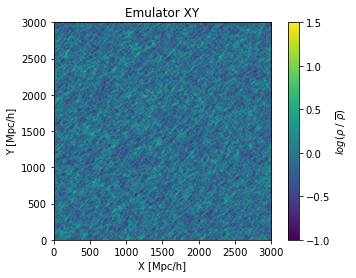

<Figure size 432x288 with 0 Axes>

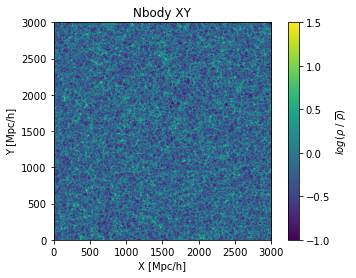

<Figure size 432x288 with 0 Axes>

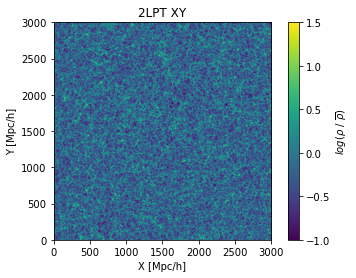

<Figure size 432x288 with 0 Axes>

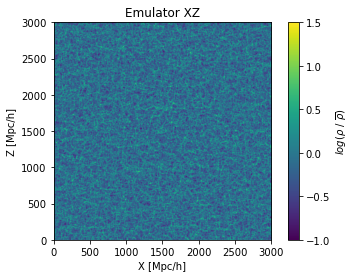

<Figure size 432x288 with 0 Axes>

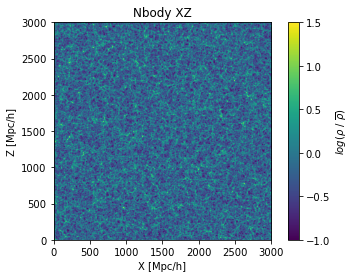

<Figure size 432x288 with 0 Axes>

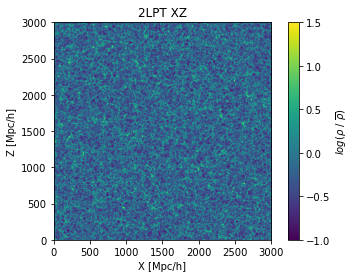

<Figure size 432x288 with 0 Axes>

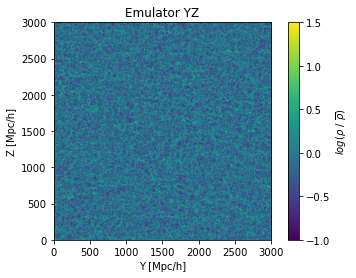

<Figure size 432x288 with 0 Axes>

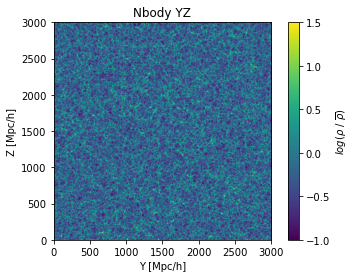

<Figure size 432x288 with 0 Axes>

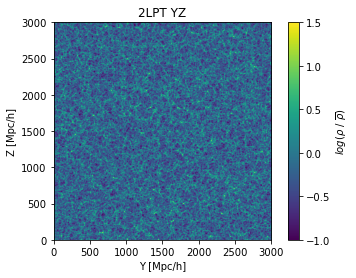

<Figure size 432x288 with 0 Axes>

In [6]:
import matplotlib.pyplot as plt
import numpy as np
dir_ = "delta_files/"
d1 = np.load(dir_+"emu_delta.npy")
d1=np.log10(d1/np.mean(d1))
d2 = np.load(dir_+"nbod_delta.npy")
d2=np.log10(d2/np.mean(d2))
d3 = np.load(dir_+"2lpt_delta.npy")
d3=np.log10(d2/np.mean(d2))
ind = 10

xlab = ["X","X", "Y"]
ylab = ["Y", "Z", "Z"]

for x in range(3):
    
    
    plt.figure()
    plt.title("Emulator "+xlab[x]+ylab[x])
    if(x==0): data = d1[:,:,ind]
    elif(x==1): data= d1[:,ind,:]
    else: data= d1[ind,:,:]
    ax = plt.imshow(data,extent=[0,3000,0,3000],vmin=-1,vmax=1.5)
    plt.xlabel(xlab[x]+" [Mpc/h]")
    plt.ylabel(ylab[x]+" [Mpc/h]")
    plt.colorbar(label=r"$log(\rho\ /\ \overline{\rho})$")
    plt.show()
    plt.savefig('figures/emu_slice'+xlab[x]+ylab[x]+'.pdf')
    
    plt.figure()
    plt.title("Nbody "+xlab[x]+ylab[x])
    if(x==0): data = d2[:,:,ind]
    elif(x==1): data= d2[:,ind,:]
    else: data= d2[ind,:,:]
    ax = plt.imshow(data,extent=[0,3000,0,3000],vmin=-1,vmax=1.5)
    plt.xlabel(xlab[x]+" [Mpc/h]")
    plt.ylabel(ylab[x]+" [Mpc/h]")
    plt.colorbar(label=r"$log(\rho\ /\ \overline{\rho})$")
    plt.show()
    plt.savefig('figures/nbod_slice'+xlab[x]+ylab[x]+'.pdf')

    
    plt.figure()
    plt.title("2LPT "+xlab[x]+ylab[x])
    if(x==0): data = d2[:,:,ind]
    elif(x==1): data= d2[:,ind,:]
    else: data= d2[ind,:,:]
    ax = plt.imshow(data,extent=[0,3000,0,3000],vmin=-1,vmax=1.5)
    plt.xlabel(xlab[x]+" [Mpc/h]")
    plt.ylabel(ylab[x]+" [Mpc/h]")
    plt.colorbar(label=r"$log(\rho\ /\ \overline{\rho})$")
    plt.show()
    plt.savefig('figures/2lpt_slice'+xlab[x]+ylab[x]+'.pdf')





# P(k) script for 3gpc

In [ ]:
def calc_pk(mass, vel, pos):
    cosmo = cosmology.Planck15
    cat = Catalogue(pos, vel, 0,1000,cosmo,"name", mass=mass)
    mesh = cat.to_mesh(n_mesh=256)
    Pk = FFTPower(mesh, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    
    hod = get_hod(pos, vel, mass, cosmo=cosmo)
        
    Pk_gal = FFTPower(hod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    return Pk['k'], Pk['power'].real,Pk_gal['k'], Pk_gal['power'].real
    


In [40]:
import numpy as np
import math
import sys
import matplotlib.pyplot as plt
import yt
import glob
import shutil
import pandas as pd
from matplotlib import colors
from scipy import stats
CMAP = plt.cm.coolwarm
from scipy.optimize import curve_fit
from matplotlib import colors
from scipy import stats
from scipy.interpolate import UnivariateSpline
from scipy.interpolate import InterpolatedUnivariateSpline

# Script for calc pk on 3Gpc box

In [26]:
import numpy as np
g = np.linspace(0,30,512,dtype=np.float32)
g.dtype
g = np.vstack(list(map(np.ravel, np.meshgrid(g,g,g))))
g.shape


(3, 134217728)

In [18]:
g = 1536**3
pos_grid = np.array([100,1000,1535]).astype(np.int32)
indices = np.array(pos_grid**3, dtype=np.int64)
indices

array([   1000000, 1000000000, -678161921], dtype=int64)

In [19]:
del indices

In [20]:
indices

NameError: name 'indices' is not defined

In [27]:
d= [1,2,3,4]
data = dict(a=d[0], b=d[2])

In [30]:
del d
d

NameError: name 'd' is not defined

In [ ]:
    
    
     def read_halos(lh_num):
    
        dsemu = yt.load("particle_test_emu/halos_0.0.bin")
        dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
        mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
        mass_emu  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))
        vel_nbod  = np.array(dsnbody.all_data()["particle_velocity"]) 
        vel_emu  = np.array(dsemu.all_data()["particle_velocity"])            
        pos_nbod  = np.array(dsnbody.all_data()["particle_position"])
        pos_emu  = np.array(dsemu.all_data()["particle_position"]) 
        

def plot_power_spectra(pair_file,savename = -1,title=-1,corr=-1):

    
    
    #pair_file = "pair_files/fof_pairs_by_particle"
    mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
    cosmo = cosmology.Planck15
    
    max_halos1 = np.size(mass_combos[0])
    max_halos2 = np.size(mass_combos[0])
    
    
    f, axs = plt.subplots(2,4, gridspec_kw={'height_ratios': [3, 1]},figsize=(20,8))
    
    titles = ["Total", "Paired", "Pairless", "Failed Pairs"]
    for x in range(4):
        
        m1,v1,p1 = mass_combos[x*2], vel_combos[x*2], pos_combos[x*2]
        m2,v2,p2 = mass_combos[x*2+1], vel_combos[x*2+1], pos_combos[x*2+1]
        norm = 1
        k1, pk1, k1_gal, pk1_gal = calc_pk(m1,v1,p1)
        k2, pk2, k2_gal, pk2_gal = calc_pk(m2,v2,p2)
        
        
        
        norm1 = (np.size(m1)/max_halos1)
        norm2 = (np.size(m2)/max_halos2)
        
        pk1, pk1_gal = pk1*norm1, pk1_gal*norm1
        pk2, pk2_gal = pk2*norm2, pk2_gal*norm2
        
        axs[0][x].plot(k1, pk1,label=r"$P(k)_{\rm Nbody DM}$",c="orange")
        axs[0][x].plot(k2, pk2,label=r"$P(k)_{\rm Emulator DM}$", c="orange",ls=":")
        axs[0][x].plot(k1_gal, pk1_gal,label=r"$P(k)_{\rm Nbody HOD}$",c="blue")
        axs[0][x].plot(k2_gal, pk2_gal,label=r"$P(k)_{\rm Emulator HOD}$",c="blue", ls=":")
        
        res1 = stats.pearsonr(pk1, pk2)
        res2 = stats.pearsonr(pk1_gal, pk2_gal)

        
        axs[1][x].plot(k1, pk1/pk2, label="DM Nbody/Em, cor="+str(round(10000*res1[0])/10000),c="orange")
        axs[1][x].plot(k1_gal, pk1_gal/pk2_gal, label="HOD Nbody/Em, cor="+str(round(10000*res2[0])/10000),c="blue")

        axs[1][x].plot(k1, np.linspace(1,1,len(k1)), label="1:1",lw=1)
        
    
        axs[0][x].set_title(titles[x])
        axs[0][x].set_yscale("log")
        axs[0][x].set_xscale("log")
        axs[1][x].set_xscale("log")
        axs[1][x].set_xlabel("k")
        axs[0][x].set_ylabel(r"$P(k)*N_{\rm halos}/N_{\rm emulator halos}$")
        axs[1][x].set_ylabel("Nbody/Emulator")
        axs[0][x].legend()
        axs[1][x].legend(fontsize=8)
        axs[1][x].set_ylim(0.85,1.15)
    
    
    if(title != -1): plt.suptitle(title,y=0.92)
    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
    


    return mn,me,vn,ve,pn,pe

        m1,v1,p1 = mass_combos[x*2], vel_combos[x*2], pos_combos[x*2]
        m2,v2,p2 = mass_combos[x*2+1], vel_combos[x*2+1], pos_combos[x*2+1]
        norm = 1
        k1, pk1, k1_gal, pk1_gal = calc_pk(m1,v1,p1)
        k2, pk2, k2_gal, pk2_gal = calc_pk(m2,v2,p2)
        
        def calc_pk(mass, vel, pos):
    cosmo = cosmology.Planck15
    cat = Catalogue(pos, vel, 0,1000,cosmo,"name", mass=mass)
    mesh = cat.to_mesh(n_mesh=256)
    Pk = FFTPower(mesh, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    
    hod = get_hod(pos, vel, mass, cosmo=cosmo)
        
    Pk_gal = FFTPower(hod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    return Pk['k'], Pk['power'].real,Pk_gal['k'], Pk_gal['power'].real
        


# Script for reading and converting the 2lpt files to an npy file

In [27]:
temp = np.random.random(128**3 * 3)
temp = temp.reshape(3,128**3)
temp

array([[0.78268378, 0.58538391, 0.20510337, ..., 0.09003635, 0.53363972,
        0.27972187],
       [0.3535279 , 0.81880313, 0.2880041 , ..., 0.66763037, 0.70630975,
        0.38732093],
       [0.26223774, 0.27320759, 0.51102916, ..., 0.06379636, 0.13939304,
        0.50252071]])

In [28]:
print(temp.reshape(3,128,128,128))

[[[[7.82683777e-01 5.85383915e-01 2.05103368e-01 ... 6.29058603e-01
    8.63739703e-01 9.93269871e-01]
   [8.05962970e-01 8.39193403e-01 9.27849168e-01 ... 8.98473121e-01
    3.50382140e-01 1.47945946e-01]
   [9.64978695e-02 4.82015934e-01 8.15035434e-01 ... 7.39913323e-01
    5.44342830e-01 5.29740468e-01]
   ...
   [6.37932874e-01 2.04538567e-01 6.80228649e-01 ... 9.04419854e-01
    4.82829110e-01 3.35941990e-01]
   [8.03822409e-01 1.94600805e-01 4.09266349e-01 ... 8.26284445e-01
    4.74921410e-01 2.08420989e-01]
   [3.91924240e-01 4.34113974e-01 6.17044568e-01 ... 2.10210254e-01
    6.14166094e-01 6.77145364e-02]]

  [[1.28339465e-01 9.57279247e-01 9.04340372e-01 ... 2.01712714e-03
    4.49630238e-01 2.99368172e-04]
   [6.74796112e-01 1.11848850e-01 6.87677487e-01 ... 1.50961269e-01
    3.88951666e-01 1.29267022e-01]
   [4.02648565e-01 7.56822256e-01 6.65329837e-01 ... 5.83363654e-02
    5.46360134e-02 2.03207671e-01]
   ...
   [8.31670518e-01 5.29528280e-02 5.01744299e-01 ... 1.46

In [ ]:
impor

In [24]:
import numpy as np
p = np.load("LH0001-selected/pos_borg_emu.npy")
dx = 1000/512.0
dxh = dx/2.0
a = 512
g = np.linspace(0,1000-dx,512)
g = np.vstack(list(map(np.ravel,np.meshgrid( g,g,g ))))
#grid_array = np.array([g[1], g[0], g[2]])
#grid_array = np.array([g[1], g[0], g[2]])
g = g.reshape(3,512,512,512)


d = p-g
d[np.where(d>500)] -= 1000
d[np.where(d<-500)] += 1000


In [23]:
np.mean(np.abs(d))

5.5994213722401645

In [25]:
np.mean(np.abs(d))

168.27315280593754

In [1]:
from pygadgetreader import *
#readsnap("ics.0.bin", "pos")

In [12]:
readheader("ics", "npartThisFile")

array([      0, 7077888,       0,       0,       0,       0], dtype=uint32)

In [8]:
readsnap("ics", "pos", "dm", debug=1)

detected file type gadget
returning for key pos
Returning DM    Positions
Could not determine file type by extension!


SystemExit: 

In [3]:
import os
filename = "ics.0"
file = open(filename, "r", encoding="utf-8")
for line in file:
    print(line)

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xa2 in position 36: invalid start byte

In [4]:
import os
filename = "ics.0"
with open(filename, mode='rb') as file: # b is important -> binary
    filecontent = file.read()
filecontent

In [6]:
filecontent[0:32]

b'\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00l\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00'

In [2]:
import struct

# Figures for the research report

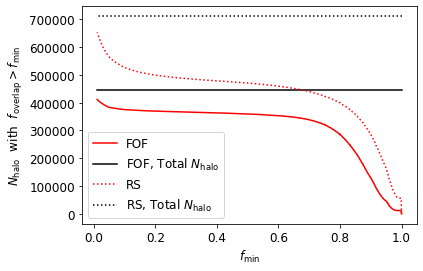

In [19]:
plt.rcParams.update({'font.size': 12})

for hf_type,ls in zip(["fof", "rs"],["-", ":"]):
    name = "RS"
    if(hf_type == "fof"): name="FOF"
    df = pd.read_csv("pair_files/"+hf_type+"_pair_candidates_nbod")
    frac = (np.array(df["frac1"]))
    f_range = np.arange(1.0,0.01,-0.001)
    N_total = np.linspace(np.size(frac),np.size(frac),np.size(f_range))
    N_min = []
    for fmin in f_range:
        N_min.append(np.size(np.where(frac > fmin)[0]))
    N_min  = np.array(N_min)

    plt.plot(f_range, N_min, c="red",ls=ls, label=name)
    plt.plot(f_range, N_total, c="black",ls=ls,label=name+r", Total $N_{\rm halo}$")
plt.legend()
plt.xlabel(r"$f_{\rm min}$")
plt.ylabel(r"$N_{\rm halo}$  with  $f_{\rm overlap} > f_{\rm min}$")
plt.savefig("figures/f_vs_fmin.pdf", bbox_inches="tight")

(array([ 24594.,      0.,      0.,      0.,      0., 187976.,  20436.,
         19189.,  58990., 400284.]),
 array([-1. , -0.8, -0.6, -0.4, -0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ]),
 <BarContainer object of 10 artists>)

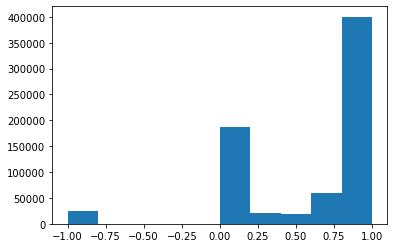

In [4]:
plt.hist(frac_rs)

# Constants

In [45]:
 OMEGA_B = 0.0486 
OMEGA_M = 0.307
OMEGA_L = 1-OMEGA_M
SIGMA_8 = 0.8159
delta_c = 1.686
h=0.677
rho_crit = 1.5*1e11 #Msol/mpc^3
T_HUBBLE = 4.55e17 #s
MPC_TO_CM = 3.086e+24

K = 1.380649e-16 #ergs/K
SEC_PER_MYR = 3.15576e+13
m_p = 1.6e-27
msol = 2e30
mpc = 3.086e+24
n = rho_crit*msol/mpc**3*OMEGA_B/m_p #cm^-3  

mass_per_particle = 6.565293600596489e11 #for the fiducial cosmo

LH_NUMS = [ '324','1702','1026', '1951','1122', '944', '485', '1582', '592', '1323', '401', '406', '1608','391', '1710', '444', '1696', '926','694', '1515', '502'] 
def r_vir(m_h,z):
    #returns mpc
    h=0.7
    
    OMEGA_K = 1-OMEGA_M-OMEGA_L
    OMEGA_M_Z=OMEGA_M*np.float_power(1+z,3)/ (OMEGA_M*np.float_power(1+z,3) + OMEGA_L + OMEGA_K*np.float_power(1+z,2))
    d = OMEGA_M_Z-1
    delta_c = 18*np.pi*np.pi + 82*d -39*d*d

    return 1e-3*0.784/h* np.float_power(m_h*h/1e8, 1.0/3)*np.float_power(OMEGA_M/OMEGA_M_Z * (delta_c/(18*np.pi*np.pi)), -1.0/3) * (10/(1+z))
r_vir(np.power(10,14.5),0)

In [46]:
def r_vir(m_h,z):
    #returns mpc
    h=0.7
    
    OMEGA_K = 1-OMEGA_M-OMEGA_L
    OMEGA_M_Z=OMEGA_M*np.float_power(1+z,3)/ (OMEGA_M*np.float_power(1+z,3) + OMEGA_L + OMEGA_K*np.float_power(1+z,2))
    d = OMEGA_M_Z-1
    delta_c = 18*np.pi*np.pi + 82*d -39*d*d

    return 1e-3*0.784/h* np.float_power(m_h*h/1e8, 1.0/3)*np.float_power(OMEGA_M/OMEGA_M_Z * (delta_c/(18*np.pi*np.pi)), -1.0/3) * (10/(1+z))
r_vir(np.power(10,14.5),0)

1.755645741088259

In [57]:
r_vir(5e14,0)

2.045315087947907

# Functions

In [38]:
def r_vir(m_h,z):
    #returns mpc
    h=0.7
    
    OMEGA_K = 1-OMEGA_M-OMEGA_L
    OMEGA_M_Z=OMEGA_M*np.float_power(1+z,3)/ (OMEGA_M*np.float_power(1+z,3) + OMEGA_L + OMEGA_K*np.float_power(1+z,2))
    d = OMEGA_M_Z-1
    delta_c = 18*np.pi*np.pi + 82*d -39*d*d

    return 1e-3*0.784/h* np.float_power(m_h*h/1e8, 1.0/3)*np.float_power(OMEGA_M/OMEGA_M_Z * (delta_c/(18*np.pi*np.pi)), -1.0/3) * (10/(1+z))


def get_hmf(mass, log_low_m = 13, bins = []):
    log_mass = np.log10(mass)
    if(np.min(log_mass)< log_low_m): 
        print("ERROR IN get_hmf(mass), mass isn't filtered.")
    if(bins == []): mass_range = np.logspace(log_low_m,16,20)
    else: mass_range = bins
    dlogm = 1#np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass >= lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf


def run_FOF(pos_file, vel_file, savename, LL=0.2, COSMO = "0000"):

    pos_particle_nbody = np.load(pos_file)
    vel_particle_nbody = np.load(vel_file)
    vel_particle_nbody = np.reshape(vel_particle_nbody,(3,512**3)).T
    pos_particle_nbody = np.reshape(pos_particle_nbody,(3,512**3)).T
    cosmo = cosmology.Planck15

    if("0000" in COSMO): 
        mass_per_particle = 6.565293600596489e11 #msun/h
    elif("0001" in COSMO): 
        mass_per_particle = 4.423043468244375e11
        cosmo = cosmo.clone(h=0.8599, Omega0_b = 0.05557, Omega0_cdm =0.15833)  
    else: print("COSMO ERROR")


    mass = np.linspace(mass_per_particle, mass_per_particle, len(pos_particle_nbody))

    f = ArrayCatalog({'Position' : pos_particle_nbody,'Velocity' : vel_particle_nbody, 'Mass' : mass }, BoxSize=[1000,1000,1000])
    fof_output = nbodykit.algorithms.fof.FOF(f, LL, 20, )
    z = 0
    halos=fof_output.to_halos(particle_mass=mass_per_particle, cosmo=cosmo, redshift=z)
    halos.save(savename)
    



def find_pairs(unique_base, unique_target,N_base, N_target, base_argsort, target_argsort, base_l, target_l):
    base_ids,target_ids,frac = [],[],[]

    total=len(unique_base)
    
    for i,unique_id in enumerate(unique_base):
        if(i%10000 == 0): print("progress: ", i*100.0/total,"%")
        base_args = base_argsort[N_base[i]: N_base[i+1]]
        pair_cands = target_l[base_args]
        pair_cands = pair_cands[pair_cands!=0]
        if(np.size(pair_cands) == 0): 
            base_ids.append(unique_id)
            target_ids.append(-1)
            frac.append(-1)
            continue
            
        bincount = np.bincount(pair_cands)
        bincount_argsorts = np.argsort(bincount)[::-1]
        size = min(5,np.size(np.where(bincount > 0)))

        best_pairs = bincount_argsorts[:size]
        nums = bincount[best_pairs] #the number of target particles in the halo which occupies the most of the base
        denoms = N_target[best_pairs]-N_target[best_pairs-1] #the total number of particles in the candidate target
        fs = nums/denoms
        frac.extend(fs)
        base_ids.extend(np.linspace(unique_id,unique_id,size))
        target_ids.extend(best_pairs)

    return np.array(base_ids), np.array(target_ids), np.array(frac)



    
def find_all_pairs(plEmu, plNbody,savename):
    plEmu, plNbody = plEmu.astype(int), plNbody.astype(int)
    unique_nbody = np.sort(np.unique(plNbody))[1:]
    unique_nbody = np.sort(np.unique(plNbody))[1:]
    plNbody_sort = np.sort(plNbody)
    plNbody_argsort = np.argsort(plNbody)
    plNbody_bincount = np.bincount(plNbody_sort)
    N_nbody = plNbody_bincount
    N_nbody_cum = np.cumsum(N_nbody)

    unique_emu = np.sort(np.unique(plEmu))[1:]
    plEmu_sort = np.sort(plEmu)
    plEmu_argsort = np.argsort(plEmu)
    plEmu_bincount = np.bincount(plEmu_sort)
    N_emu = plEmu_bincount
    N_emu_cum = np.cumsum(N_emu)
    
    print("Working on Nbody pairs")
    base_ids1,target_ids1,frac1 = find_pairs(unique_nbody, unique_emu,N_nbody_cum, N_emu_cum, plNbody_argsort, plEmu_argsort, plNbody,plEmu)
    data = np.array([base_ids1,target_ids1,frac1]).T
    df = pd.DataFrame(data, columns=["base_ids1","target_ids1","frac1"])
    df.to_csv(savename+"_nbod")
    
    print("Working on Emu pairs")
    base_ids2,target_ids2,frac2 = find_pairs(unique_emu, unique_nbody,N_emu_cum , N_nbody_cum, plEmu_argsort, plNbody_argsort,plEmu, plNbody)
    data = np.array([base_ids2,target_ids2,frac2]).T
    df = pd.DataFrame(data, columns=["base_ids2","target_ids2","frac2"])
    df.to_csv(savename+"_emu")

    
      
    
    
    
    


def gen_fof_pair_cands(savename, LL=0.2, COSMO = "0000"):
    pos_particle_emu = np.reshape(np.load("LtU-selected/pos_emu.npy"),(3,512**3)).T
    vel_particle_emu = np.reshape(np.load("LtU-selected/vel_emu.npy"),(3,512**3)).T

    pos_particle_nbody = np.reshape(np.load("LtU-selected/pos_nbody.npy"),(3,512**3)).T
    vel_particle_nbody = np.reshape(np.load("LtU-selected/vel_nbody.npy"),(3,512**3)).T


    if("0000" in COSMO): 
        mass_per_particle = 6.565293600596489e11 #msun/h
    elif("0001" in COSMO): 
        mass_per_particle = 4.423043468244375e11
        cosmo = cosmo.clone(h=0.8599, Omega0_b = 0.05557, Omega0_cdm =0.15833)  
    else: print("COSMO ERROR")

    mass = np.linspace(mass_per_particle, mass_per_particle, len(pos_particle_nbody))

    f_nbody = ArrayCatalog({'Position' : pos_particle_nbody,'Velocity' : vel_particle_nbody, 'Mass' : mass }, BoxSize=[1000,1000,1000])
    fof_output_nbody = nbodykit.algorithms.fof.FOF(f_nbody, LL, 20, )

    f_emu = ArrayCatalog({'Position' : pos_particle_emu,'Velocity' : vel_particle_emu, 'Mass' : mass }, BoxSize=[1000,1000,1000])
    fof_output_emu = nbodykit.algorithms.fof.FOF(f_emu, LL, 20, )
    

    ehd_emu_full, ehd_nbody_full = fof_output_emu.labels, fof_output_nbody.labels
    ehd_emu_full=ehd_emu_full.astype(int)
    ehd_nbody_full=ehd_nbody_full.astype(int)
    find_all_pairs(ehd_emu_full, ehd_nbody_full,savename)
    
    
    
    
    
        
    

def gen_rs_pair_cands(fname_emu, fname_nbody,savename):
    names = ["x","y","z", "vx", "vy", "vz", "mass", "specific_energy","particle_id", "type", "assigned_internal_haloid", "internal_haloid","external_haloid"]
    f_emu = pd.read_csv(fname_emu,delim_whitespace=True, comment="#", names=names, usecols = ["external_haloid", "particle_id","assigned_internal_haloid","internal_haloid", "x", "y", "z"])
    f_nbody = pd.read_csv(fname_nbody,delim_whitespace=True, comment="#", names=names, usecols = ["external_haloid", "particle_id","assigned_internal_haloid","internal_haloid", "x", "y", "z"])  

    aihd = np.array(f_emu["assigned_internal_haloid"])
    ihd = np.array(f_emu["internal_haloid"])
    remove_subs = np.where(aihd == ihd)

    ehd_emu = np.array(f_emu["external_haloid"])
    pid_emu = np.array(f_emu["particle_id"])
    ehd_emu = ehd_emu[remove_subs]
    pid_emu = pid_emu[remove_subs]
    pid_emu_argsort = np.argsort(pid_emu)
    pid_emu = np.array(pid_emu[pid_emu_argsort])
    ehd_emu = np.array(ehd_emu[pid_emu_argsort])
    ehd_emu = ehd_emu+1
    
    
    aihd = np.array(f_nbody["assigned_internal_haloid"])
    ihd = np.array(f_nbody["internal_haloid"])
    ehd_nbody = np.array(f_nbody["external_haloid"])
    pid_nbody = np.array(f_nbody["particle_id"])
    remove_subs = np.where(aihd == ihd)
    ehd_nbody = ehd_nbody[remove_subs]
    pid_nbody = pid_nbody[remove_subs]
    pid_nbody_argsort = np.argsort(pid_nbody)
    pid_nbody = np.array(pid_nbody[pid_nbody_argsort])
    ehd_nbody = np.array(ehd_nbody[pid_nbody_argsort])
    ehd_nbody = ehd_nbody+1
    ehd_nbody_full, ehd_emu_full = np.linspace(0,0,512**3), np.linspace(0,0,512**3)
    ehd_nbody_full[pid_nbody-1] = ehd_nbody
    ehd_emu_full[pid_emu-1] = ehd_emu

    ehd_emu_full=ehd_emu_full.astype(int)
    ehd_nbody_full=ehd_nbody_full.astype(int)
    find_all_pairs(ehd_emu_full, ehd_nbody_full,savename)
    
    
    
    
def cross_check_pairs_by_mass(savename, cand_file, fof=True):

    if(fof):
        f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
        f0emu = BigFileCatalog('fof_halos/lh0000_emu')
        mass_nbod  = np.array(f0nbody["Mass"])
        mass_emu  = np.array(f0emu["Mass"])
       
    else:
        dsemu = yt.load("particle_test_emu/halos_0.0.bin")
        dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
        mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
        mass_emu  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))


    df1 = pd.read_csv(cand_file+"_nbod")
    df2 = pd.read_csv(cand_file+"_emu")
    base_ids1,target_ids1,frac1, base_ids2,target_ids2,frac2 = np.array(df1["base_ids1"]).astype(int),np.array(df1["target_ids1"]).astype(int),np.array(df1["frac1"]), np.array(df2["base_ids2"]).astype(int),np.array(df2["target_ids2"]).astype(int),np.array(df2["frac2"])

    lonely_baseids1 = base_ids1[np.where(frac1 == -1)[0]]
    lonely_baseids1 = lonely_baseids1[~np.isin(lonely_baseids1, target_ids2)]
    lonely_baseids2 = base_ids2[np.where(frac2 == -1)[0]]
    lonely_baseids2 = lonely_baseids2[~np.isin(lonely_baseids2, target_ids1)]

    filt1 = ~np.isin(base_ids1, lonely_baseids1)
    filt2 = ~np.isin(base_ids2, lonely_baseids2)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]

    #sort by mass

    unique_base = np.unique(base_ids1)
    mass_base = mass_nbod[unique_base-1]
    descending = np.argsort(mass_base)[::-1]
    mass_sort = np.sort(mass_base)[::-1]
    unique_base = unique_base[descending]
    total = len(unique_base)
    n_agree_temp, e_agree_temp = [],[]
    n_agree, e_agree = [],[]
    for x in range(total):
        b = unique_base[x]
        cand_args1 = np.where(base_ids1 == b)
        cand_args2 = np.where(target_ids2 == b)

        cand1 = target_ids1[cand_args1]
        cand2 = base_ids2[cand_args2]
        all_cands = np.unique(np.append(cand1, cand2))
        all_cands = all_cands[~np.isin(all_cands, np.array(e_agree_temp))]

        if(len(all_cands) == 0): continue

        cand_masses = mass_emu[all_cands-1]
        arg_best = np.argmin(np.abs(mass_sort[x]-cand_masses))
        t = all_cands[arg_best]
        n_agree_temp.append(b)
        e_agree_temp.append(t)

        if(x%10000==0): 
            print("progress: ", x*100.0/total,"%")

            n_agree.extend(n_agree_temp)
            e_agree.extend(e_agree_temp)
            n_agree_temp, e_agree_temp = [],[]
            remove_1 = np.where(~np.isin(base_ids1, np.array(n_agree)) & ~np.isin(target_ids1,np.array(e_agree)))
            remove_2 = np.where(~np.isin(base_ids2, np.array(e_agree)) & ~np.isin(target_ids2,np.array(n_agree)))

            base_ids1 = base_ids1[remove_1]
            target_ids1 = target_ids1[remove_1]
            base_ids2 = base_ids2[remove_2]
            target_ids2 = target_ids2[remove_2]  

    n_agree.extend(n_agree_temp)
    e_agree.extend(e_agree_temp)
    n_agree_temp, e_agree_temp = [],[]
    remove_1 = np.where(~np.isin(base_ids1, np.array(n_agree)) & ~np.isin(target_ids1,np.array(e_agree)))
    remove_2 = np.where(~np.isin(base_ids2, np.array(e_agree)) & ~np.isin(target_ids2,np.array(n_agree)))

    base_ids1 = base_ids1[remove_1]
    target_ids1 = target_ids1[remove_1]
    base_ids2 = base_ids2[remove_2]
    target_ids2 = target_ids2[remove_2]       

    n_agree, e_agree = np.array(n_agree), np.array(e_agree)


    n,e = n_agree-1, e_agree-1
    mask_pairless_nbod = np.ones(len(mass_nbod), bool)
    mask_pairless_emu = np.ones(len(mass_emu), bool)

    mask_pairless_nbod[n] = 0
    mask_pairless_emu[e] = 0

    mask_pairless_nbod[lonely_baseids1-1] = 0
    mask_pairless_emu[lonely_baseids2-1] = 0
    a,b,c,d = lonely_baseids1, lonely_baseids2, np.where(mask_pairless_nbod == True)[0]+1, np.where(mask_pairless_emu == True)[0]+1
    total = np.size(n_agree)
    a = np.append(a, np.linspace(-1,-1, total-np.size(a)))
    b = np.append(b, np.linspace(-1,-1, total-np.size(b)))
    c = np.append(c, np.linspace(-1,-1, total-np.size(c)))
    d = np.append(d, np.linspace(-1,-1, total-np.size(d)))
    data = np.array([n_agree, e_agree, a,b,c,d]).T


    columns=["nbody_id", "emu_id", "nbody_pairless_id", "emu_pairless_id", "nbody_stolen_id", "emu_stolen_id"]
    df = pd.DataFrame(data, columns=columns)
    df.to_csv(savename)

   



def cross_check_pairs_by_particle(savename, cand_file, fof=True):

    if(fof):
        f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
        f0emu = BigFileCatalog('fof_halos/lh0000_emu')
        mass_nbod  = np.array(f0nbody["Mass"])
        mass_emu  = np.array(f0emu["Mass"])

    else:
        dsemu = yt.load("particle_test_emu/halos_0.0.bin")
        dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
        mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
        mass_emu  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))


    df1 = pd.read_csv(cand_file+"_nbod")
    df2 = pd.read_csv(cand_file+"_emu")
    base_ids1,target_ids1,frac1, base_ids2,target_ids2,frac2 = np.array(df1["base_ids1"]).astype(int),np.array(df1["target_ids1"]).astype(int),np.array(df1["frac1"]), np.array(df2["base_ids2"]).astype(int),np.array(df2["target_ids2"]).astype(int),np.array(df2["frac2"])

    lonely_baseids1 = base_ids1[np.where(frac1 == -1)[0]]
    lonely_baseids1 = lonely_baseids1[~np.isin(lonely_baseids1, target_ids2)]
    lonely_baseids2 = base_ids2[np.where(frac2 == -1)[0]]
    lonely_baseids2 = lonely_baseids2[~np.isin(lonely_baseids2, target_ids1)]

    filt1 = ~np.isin(base_ids1, lonely_baseids1)
    filt2 = ~np.isin(base_ids2, lonely_baseids2)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]

    unique_base1, indices1 = np.unique(base_ids1, return_index=True)
    unique_base2, indices2 = np.unique(base_ids2, return_index=True)

    base_ids1, target_ids1 = base_ids1[indices1], target_ids1[indices1]
    base_ids2, target_ids2 = base_ids2[indices2], target_ids2[indices2]
    frac1, frac2   = frac1[indices1], frac2[indices2]


    total = len(base_ids1)
    b_best, t_best = [],[]
    print("working on mutual pairs")
    for x in range(total):
        b,t = base_ids1[x], target_ids1[x]
        cand = target_ids2[np.where(base_ids2 == t)]
        if(cand == b ):
            b_best.append(b)
            t_best.append(t)
        #print("progress: ", x*100.0/total,"%")
    n_agree, e_agree = np.array(b_best), np.array(t_best)



    df1 = pd.read_csv(cand_file+"_nbod")
    df2 = pd.read_csv(cand_file+"_emu")

    base_ids1,target_ids1,frac1, base_ids2,target_ids2,frac2 = np.array(df1["base_ids1"]).astype(int),np.array(df1["target_ids1"]).astype(int),np.array(df1["frac1"]), np.array(df2["base_ids2"]).astype(int),np.array(df2["target_ids2"]).astype(int),np.array(df2["frac2"])

    filt1 = ~np.isin(base_ids1, lonely_baseids1)
    filt2 = ~np.isin(base_ids2, lonely_baseids2)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]


#     frac_filter = np.where((fn > MIN_FRAC) & (fe > MIN_FRAC))[0]
#     n_agree = n_agree[frac_filter]
#     e_agree = e_agree[frac_filter]

    filt1 = ~np.isin(base_ids1, n_agree) & ~np.isin(target_ids1, e_agree)
    filt2 = ~np.isin(base_ids2, e_agree) & ~np.isin(target_ids2, n_agree)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]

    append_base,append_target = [],[]
    unique_t1 = np.unique(target_ids1)
    print("working on other pairs")
    for x in range(len(unique_t1)):
        t = unique_t1[x]
        args = np.where(target_ids1 == t)[0]
        cand_bases = base_ids1[args]
        cand_bases = cand_bases[~np.isin(cand_bases, np.array(append_base))]
        if(len(cand_bases) == 0):continue
        append_target.append(t)

        if(len(cand_bases) == 1): 
            append_base.append(cand_bases[0])
        else:
            mass_t = mass_emu[t]
            cand_masses = mass_nbod[cand_bases-1]
            append_base.append(cand_bases[np.argmin(np.abs(cand_masses-mass_t))])

    filt = ~np.isin(base_ids2, np.array(append_target)) & ~np.isin(target_ids2, np.array(append_base))
    base_ids2 = base_ids2[filt]
    target_ids2 = target_ids2[filt]

    unique_t2 = np.unique(target_ids2)

    for x in range(len(unique_t2)):
        t = unique_t2[x]
        append_base.append(t)

        args = np.where(target_ids2 == t)[0]
        cand_bases = base_ids2[args]
        if(len(cand_bases) == 1): 
            append_target.append(cand_bases[0])
        else:
            mass_t = mass_nbod[t]
            cand_masses = mass_emu[cand_bases-1]
            append_target.append(cand_bases[np.argmin(np.abs(cand_masses-mass_t))])

    append_base,append_target = np.array(append_base),np.array(append_target)



    n_agree = np.append(n_agree, append_base)
    e_agree = np.append(e_agree, append_target)
    sort = np.argsort(n_agree)
    n_agree = n_agree[sort]
    e_agree = e_agree[sort]


    n,e = n_agree-1, e_agree-1
    mask_pairless_nbod = np.ones(len(mass_nbod), bool)
    mask_pairless_emu = np.ones(len(mass_emu), bool)

    mask_pairless_nbod[n] = 0
    mask_pairless_emu[e] = 0

    mask_pairless_nbod[lonely_baseids1-1] = 0
    mask_pairless_emu[lonely_baseids2-1] = 0

    a,b,c,d = lonely_baseids1, lonely_baseids2, np.where(mask_pairless_nbod == True)[0]+1, np.where(mask_pairless_emu == True)[0]+1
    total = np.size(n_agree)
    a = np.append(a, np.linspace(-1,-1, total-np.size(a)))
    b = np.append(b, np.linspace(-1,-1, total-np.size(b)))
    c = np.append(c, np.linspace(-1,-1, total-np.size(c)))
    d = np.append(d, np.linspace(-1,-1, total-np.size(d)))
    data = np.array([n_agree, e_agree, a,b,c,d]).T


    columns=["nbody_id", "emu_id", "nbody_pairless_id", "emu_pairless_id", "nbody_stolen_id", "emu_stolen_id"]
    df = pd.DataFrame(data, columns=columns)
    df.to_csv(savename)













    
    
    
def calc_binned_mean(mass_paired_emu, mass_paired_nbod):

    mass_list = np.linspace(13,16,50)
    emu_mean, nbod_mean = [],[]
    emu_std, nbod_std = [],[]
    db=mass_list[1]-mass_list[0]
    for x in range(len(mass_list)-1):
        filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
        emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
        nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
        emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
        nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    return emu_mean, nbod_mean, emu_std, nbod_std,db






def plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename, title,bins=[]):

    mass_range, hmf_nbody = get_hmf(mass_paired_nbod,bins=bins)
    mass_range, hmf_emu = get_hmf(mass_paired_emu, bins=bins)
    res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
    emu_mean, nbod_mean, emu_std, nbod_std,db = calc_binned_mean(mass_paired_emu, mass_paired_nbod)  

    fig, axs = plt.subplots(2,2,figsize=(10,10))
    fig.suptitle(title,y=0.92)

    axs[0][0].hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 60, norm = colors.LogNorm(), cmap ="cividis")
    axs[0][0].plot([12,16],[12,16],label="1:1",color="black")
    axs[0][0].set_xlabel(r"$M_{\rm Emulator} \ [M_\odot]$")
    axs[0][0].set_ylabel(r"$M_{\rm N{-}body} \ [M_\odot]$")
    axs[0][0].errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="Binned Mean\nEmulator binsize="+str(round(db*100)/100)+"\nPearson Coef="+str(round(1000*res[0])/1000), color="green")
    axs[0][0].legend(loc = "upper left")



    axs[1][0].plot(mass_range[:-1], hmf_nbody,label=r"N${-}$body")
    axs[1][0].plot(mass_range[:-1], hmf_emu, label="Emulator")
    axs[1][0].set_yscale("log")
    axs[1][0].set_xscale("log")
    axs[1][0].legend(loc = "upper right")
    axs[1][0].set_xlabel(r"$M \ [M_\odot]$")
    axs[1][0].set_ylabel("n(m>M)")



    axs[1][1].plot(mass_range[:-1], hmf_nbody/hmf_emu,label=r"N${-}$body/Emulator")
    axs[1][1].plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")
    axs[1][1].legend(loc = "upper left")
    axs[1][1].set_ylim(0.7,1.3)
    axs[1][1].set_xscale("log")
    axs[1][1].set_xlabel(r"$M \ [M_\odot]$")
    axs[1][1].set_ylabel(r"$N_{\rm N{-}body}/ N_{\rm Emulator}$")


    log_rat = np.log10(mass_paired_nbod/mass_paired_emu)
    bins = np.linspace(-0.5,0.5,100)
    data = axs[0][1].hist(log_rat,bins=bins)
    axs[0][1].set_xlabel(r"$log(M_{\rm N{-}body}/ M_{\rm Emulator})$")
    axs[0][1].plot([0,0], [0,np.max(data[0])],label="1:1")
    mean = np.mean(log_rat)
    axs[0][1].plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000))
    axs[0][1].legend(loc = "upper right")



    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
    


def plot_halo_stats(mass_paired_nbod, mass_paired_emu, savename, title, bins=[]):

    mass_range, hmf_nbody = get_hmf(mass_paired_nbod, bins=bins)
    mass_range, hmf_emu = get_hmf(mass_paired_emu, bins=bins)

    fig, axs = plt.subplots(1,2,figsize=(10,5))
    fig.suptitle(title,y=0.92)


    axs[0].plot(mass_range[:-1], hmf_nbody,label=r"N${-}$body")
    axs[0].plot(mass_range[:-1], hmf_emu, label="Emulator")
    axs[0].set_yscale("log")
    axs[0].set_xscale("log")
    axs[0].legend(loc = "upper right")
    axs[0].set_xlabel(r"$M \ [M_\odot]$")
    axs[0].set_ylabel("n(m>M)")



    axs[1].plot(mass_range[:-1], hmf_nbody/hmf_emu,label=r"N${-}$body/Emulator")
    axs[1].plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")
    axs[1].legend(loc = "upper left")
    axs[1].set_ylim(0.7,1.3)
    axs[1].set_xscale("log")
    axs[1].set_xlabel(r"$M \ [M_\odot]$")
    axs[1].set_ylabel(r"$N_{\rm N{-}body}/ N_{\rm Emulator}$")

    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
 


def read_pairs(pair_file):
    df = pd.read_csv(pair_file)
    nbody_id_pairs = np.array(df["nbody_id"])-1
    emu_id_pairs = np.array(df["emu_id"])-1
    return nbody_id_pairs, emu_id_pairs
    
    
    
    
    
    
    
    
def read_halos(pair_file, min_mass = 1e13):
    
    if("fof" in pair_file):fof=True
    elif("rs" in pair_file): fof=False
    else: 
        print("Can't identify halo finder type")
        return
    
    nbody_paired_id,emu_paired_id, nbody_pairless_id, emu_pairless_id, nbody_stolen_id,emu_stolen_id = read_cross_checked_ids(pair_file)   
 
    if(fof):
        f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
        f0emu = BigFileCatalog('fof_halos/lh0000_emu')
        mass_nbod  = np.array(f0nbody["Mass"])
        mass_emu  = np.array(f0emu["Mass"])
        vel_nbod  = np.array(f0nbody["Velocity"])
        vel_emu  = np.array(f0emu["Velocity"])            
        pos_nbod  = np.array(f0nbody["Position"])
        pos_emu  = np.array(f0emu["Position"])     
    else:
        dsemu = yt.load("particle_test_emu/halos_0.0.bin")
        dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
        mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
        mass_emu  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))
        vel_nbod  = np.array(dsnbody.all_data()["particle_velocity"]) 
        vel_emu  = np.array(dsemu.all_data()["particle_velocity"])            
        pos_nbod  = np.array(dsnbody.all_data()["particle_position"])
        pos_emu  = np.array(dsemu.all_data()["particle_position"]) 
        
    
    #pairless 
    nbody_pairless_mass  = mass_nbod[nbody_pairless_id]
    emu_pairless_mass    = mass_emu[emu_pairless_id]
    pairless_filter_nbod = np.where(nbody_pairless_mass>min_mass)
    pairless_filter_emu  = np.where(emu_pairless_mass>min_mass)
    nbody_pairless_mass  = nbody_pairless_mass[pairless_filter_nbod]
    emu_pairless_mass    = emu_pairless_mass[pairless_filter_emu]
    
    #stolen
    nbody_stolen_mass  = mass_nbod[nbody_stolen_id]
    emu_stolen_mass    = mass_emu[emu_stolen_id]
    stolen_filter_nbod = np.where(nbody_stolen_mass>min_mass)
    stolen_filter_emu  = np.where(emu_stolen_mass>min_mass)
    nbody_stolen_mass  = nbody_stolen_mass[stolen_filter_nbod]
    emu_stolen_mass    = emu_stolen_mass[stolen_filter_emu]
    
    
    #paired
    mass_paired_nbod = mass_nbod[nbody_paired_id]
    mass_paired_emu = mass_emu[emu_paired_id]
    paired_filter = np.where((mass_paired_nbod>min_mass) & (mass_paired_emu >min_mass))
    mass_paired_nbod = mass_paired_nbod[paired_filter]
    mass_paired_emu = mass_paired_emu[paired_filter]
    
    #full
    mass_filter_nbod = np.where(mass_nbod>min_mass)
    mass_filter_emu = np.where(mass_emu>min_mass)
    mass_nbod = mass_nbod[mass_filter_nbod]
    mass_emu = mass_emu[mass_filter_emu]
    
    
    a = list(np.unique(mass_nbod))
    a.extend(list(mass_emu))
    unique_bins = np.sort(np.array(np.unique(a)))
    mass_combos = [mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, nbody_pairless_mass,emu_pairless_mass, nbody_stolen_mass,emu_stolen_mass]
    
  
    vel_pairless_nbod = vel_nbod[nbody_pairless_id][pairless_filter_nbod]
    vel_pairless_emu  = vel_emu[emu_pairless_id][pairless_filter_emu]
    pos_pairless_nbod = pos_nbod[nbody_pairless_id][pairless_filter_nbod]
    pos_pairless_emu  = pos_emu[emu_pairless_id][pairless_filter_emu]
    
    vel_stolen_nbod = vel_nbod[nbody_stolen_id][stolen_filter_nbod]
    vel_stolen_emu  = vel_emu[emu_stolen_id][stolen_filter_emu]
    pos_stolen_nbod = pos_nbod[nbody_stolen_id][stolen_filter_nbod]
    pos_stolen_emu  = pos_emu[emu_stolen_id][stolen_filter_emu]
    
    vel_paired_nbod = vel_nbod[nbody_paired_id][paired_filter]
    vel_paired_emu  = vel_emu[emu_paired_id][paired_filter]
    pos_paired_nbod = pos_nbod[nbody_paired_id][paired_filter]
    pos_paired_emu  = pos_emu[emu_paired_id][paired_filter]    

    vel_nbod = vel_nbod[mass_filter_nbod]
    vel_emu  = vel_emu[mass_filter_emu]
    pos_nbod = pos_nbod[mass_filter_nbod]
    pos_emu  = pos_emu[mass_filter_emu] 
    vel_combos = [vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu]
    pos_combos = [pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu]
        
    return mass_combos, pos_combos, vel_combos, unique_bins
        
        

def mass_fit_poly_binned(mass_nbod, mass_emu, bins = np.arange(13,15.25,0.5), return_func = False):
    log_mass_nbod, log_mass_emu = np.log10(mass_nbod), np.log10(mass_emu)
    m_nbod_corrected,m_emu_corrected = [],[]
    fit_list = []
    for x in range(len(bins)-1):
        indices = np.where((log_mass_emu < bins[x+1]) & (log_mass_emu >= bins[x]))[0]
        me = mass_emu[indices]
        mn = mass_nbod[indices]
        m_nbod_corrected.extend(mn)
        mfp = mass_fit_poly(mn, me,return_func=return_func)
        m_emu_cor = mfp
        if(return_func): 
            m_emu_cor = mfp[0]
            fit = mfp[1]
            fit_list.append(fit)
        m_emu_corrected.extend(m_emu_cor)
    if(return_func): return np.array(m_nbod_corrected), np.array(m_emu_corrected), fit_list,bins
    return np.array(m_nbod_corrected), np.array(m_emu_corrected)

def mass_fit_poly(mass_nbod, mass_emu, return_func = False):
    log_mass_nbod, log_mass_emu = np.log10(mass_nbod), np.log10(mass_emu)
    popt, pcov = curve_fit(mass_emu_calc, log_mass_emu, log_mass_nbod)
    a,b,c,d,e = popt
    if(return_func): return [np.power(10.0, mass_emu_calc(log_mass_emu, a,b,c,d,e)), popt]
    return np.power(10.0, mass_emu_calc(log_mass_emu, a,b,c,d,e)) 

def mass_emu_calc(log_mass_emu, a,b,c,d,e):
    sum_ = 0
    params = [a,b,c,d,e]
    for p in range(POWER):
        sum_ += params[p] * np.power(log_mass_emu, p+1)
    return sum_

def mass_fit_spline(mass_nbod, mass_emu, apply_to = [0]):
    interpolated=True
    y,x = np.log10(mass_nbod), np.log10(mass_emu)
    sort_args = np.argsort(x)
    inverse_args = np.argsort(sort_args)
    x = x[sort_args]
    y = y[sort_args]
    
    if(not interpolated):    spl = UnivariateSpline(x,y,k=POWER)
    else:
        values, index,inverse,counts = np.unique(x, return_counts=True,return_index=True,return_inverse=True)
        ymean=[]
        for v in values:
            ymean.append(np.mean(y[np.where(x == v)[0]]))
        spl = InterpolatedUnivariateSpline(values,ymean,w=counts,k=POWER)
    if(len(apply_to) > 1): return np.power(10.0,spl(np.log10(apply_to)))
    mass_emu_corrected = np.power(10.0,spl(x))
    mass_emu_corrected = mass_emu_corrected[inverse_args]
    return mass_emu_corrected






def plot_power_spectra(nbody_file, emu_file, pair_file,pairs=True,fof=True,savename = -1,title=-1,corr=-1):
    mass_combos, pos_combos, vel_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=fof, pos_n_vel = True)

    mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu,unique_bins = mass_combos
    vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu = vel_combos
    pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu = pos_combos

    cosmo = cosmology.Planck15
    
    if(pairs):
        pos_nbod, vel_nbod, mass_nbod = pos_paired_nbod,vel_paired_nbod, mass_paired_nbod
        pos_emu, vel_emu, mass_emu = pos_paired_emu,vel_paired_emu, mass_paired_emu
    if(corr!= -1):
        POWER = corr
        mass_emu =mass_fit_poly(mass_nbod, mass_emu)

        
        
    cat_nbod = Catalogue(pos_nbod, vel_nbod, 0,1000,cosmo,"nbod", mass=mass_nbod)
    cat_emu = Catalogue(pos_emu, vel_emu, 0,1000,cosmo,"emu", mass=mass_emu)

    mesh_nbod = cat_nbod.to_mesh(n_mesh=256)
    mesh_emu = cat_emu.to_mesh(n_mesh=256)
    Pk_nbod = FFTPower(mesh_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu = FFTPower(mesh_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power

 
    hod_nbod = get_hod(pos_nbod, vel_nbod, mass_nbod, cosmo=cosmo)
    hod_emu = get_hod(pos_emu, vel_emu, mass_emu, cosmo=cosmo)
        
    Pk_nbod_gal = FFTPower(hod_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu_gal = FFTPower(hod_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    
    
    
    f, axs = plt.subplots(2,1, gridspec_kw={'height_ratios': [3, 1]})
    
    for Pk, label in zip([Pk_nbod, Pk_emu, Pk_nbod_gal, Pk_emu_gal], [r"$P(k)_{\rm Nbody DM}$", r"$P(k)_{\rm Emulator DM}$", r"$P(k)_{\rm Nbody HOD}$", r"$P(k)_{\rm Emulator HOD}$", ]):

        #axs[0].plot(Pk['k'], Pk['power'].real-Pk.attrs['shotnoise'], label=label )
        axs[0].plot(Pk['k'], Pk['power'].real, label=label )
        #print(label, Pk.attrs['shotnoise'])
        
    
    for Pk, label in zip([[Pk_nbod, Pk_emu], [Pk_nbod_gal, Pk_emu_gal]], ["DM", "HOD"]):
        Pk_nbod, Pk_emu = Pk[0], Pk[1]
    
        #axs[1].plot(Pk_nbod['k'], (Pk_nbod['power'].real-Pk_nbod.attrs['shotnoise'])/(Pk_emu['power'].real-Pk_emu.attrs['shotnoise']), label=label)
        res = stats.pearsonr(Pk_nbod['power'].real, Pk_emu['power'].real)
        axs[1].plot(Pk_nbod['k'], (Pk_nbod['power'].real)/(Pk_emu['power'].real), label=label + ", cor="+str(round(10000*res[0])/10000))

    axs[1].plot(Pk_nbod['k'], np.linspace(1,1,len(Pk_nbod['k'])), label="1:1",lw=1)

    axs[0].set_yscale("log")
    axs[0].set_xscale("log")
    axs[1].set_xscale("log")
    axs[1].set_xlabel("k")
    axs[0].set_ylabel("P(k)")
    axs[1].set_ylabel("Nbody/Emulator")
    axs[0].legend()
    axs[1].legend(fontsize=8)
    axs[1].set_ylim(0.85,1.15)
    #axs[0].xaxis.set_tick_params(labelbottom=False)

    
    if(title != -1): plt.suptitle(title,y=0.92)
    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
    

    
def plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = -1,title=-1,num_bins = 10,bins=[],spline=False,subsample=True):
    
    
    mass_combos, pos_combos, vel_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=fof, pos_n_vel = True)

    mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu,unique_bins = mass_combos
    vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu = vel_combos
    pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu = pos_combos

    cosmo = cosmology.Planck15
    

    
    if(spline): mass_emu = mass_fit_spline(mass_paired_nbod, mass_paired_emu, apply_to = mass_emu)
    mass_emu_corrected, keep_args = calc_subsample(mass_nbod, mass_emu, num_bins=num_bins)
    
    if(subsample): pos_emu, vel_emu, mass_emu = pos_emu[keep_args], vel_emu[keep_args], mass_emu[keep_args]
    
    
    nbod_filter = np.where((mass_nbod>=1e13) & (mass_nbod <1e15))[0]
    emu_filter = np.where((mass_emu>=1e13) & (mass_emu <1e15))[0]
    
    
    pos_emu, vel_emu, mass_emu = pos_emu[emu_filter], vel_emu[emu_filter], mass_emu[emu_filter]
    pos_nbod, vel_nbod, mass_nbod = pos_nbod[nbod_filter], vel_nbod[nbod_filter], mass_nbod[nbod_filter]
    mass_range, hmf_nbody = get_hmf(mass_nbod, bins=unique_bins)
    mass_range, hmf_emu = get_hmf(mass_emu, bins=unique_bins)
    
    
    fig, axs = plt.subplots(4,1, gridspec_kw={'height_ratios': [3,1,3, 1]}, figsize=(8,15))

    axs[0].plot(mass_range[:-1], hmf_nbody,label=r"N${-}$body")
    axs[0].plot(mass_range[:-1], hmf_emu, label="Emulator")
    axs[0].set_yscale("log")
    axs[0].set_xscale("log")
    axs[0].legend(loc = "upper right")
    axs[0].set_xlabel(r"$M \ [M_\odot]$")
    axs[0].set_ylabel("n(m>M)")
    axs[0].set_xlim(1e13)



    axs[1].plot(mass_range[:-1], hmf_nbody/hmf_emu,label=r"N${-}$body/Emulator")
    axs[1].plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")
    axs[1].legend(loc = "upper left")
    axs[1].set_ylim(0.7,1.3)
    axs[1].set_xscale("log")
    axs[1].set_xlabel(r"$M \ [M_\odot]$")
    axs[1].set_ylabel(r"$N_{\rm N{-}body}/ N_{\rm Emulator}$")
    
    
    
    
    
    
    
    
    

        
    cat_nbod = Catalogue(pos_nbod, vel_nbod, 0,1000,cosmo,"nbod", mass=mass_nbod)
    cat_emu = Catalogue(pos_emu, vel_emu, 0,1000,cosmo,"emu", mass=mass_emu)

    mesh_nbod = cat_nbod.to_mesh(n_mesh=256)
    mesh_emu = cat_emu.to_mesh(n_mesh=256)
    Pk_nbod = FFTPower(mesh_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu = FFTPower(mesh_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power

 
    hod_nbod = get_hod(pos_nbod, vel_nbod, mass_nbod, cosmo=cosmo)
    hod_emu = get_hod(pos_emu, vel_emu, mass_emu, cosmo=cosmo)
        
    Pk_nbod_gal = FFTPower(hod_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu_gal = FFTPower(hod_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    
    
    
#     f, axs = plt.subplots(2,1, gridspec_kw={'height_ratios': [3, 1]})
    
    for Pk, label in zip([Pk_nbod, Pk_emu, Pk_nbod_gal, Pk_emu_gal], [r"$P(k)_{\rm Nbody DM}$", r"$P(k)_{\rm Emulator DM}$", r"$P(k)_{\rm Nbody HOD}$", r"$P(k)_{\rm Emulator HOD}$", ]):

        #axs[0].plot(Pk['k'], Pk['power'].real-Pk.attrs['shotnoise'], label=label )
        axs[2].plot(Pk['k'], Pk['power'].real, label=label )
        #print(label, Pk.attrs['shotnoise'])
        
    
    for Pk, label in zip([[Pk_nbod, Pk_emu], [Pk_nbod_gal, Pk_emu_gal]], ["DM", "HOD"]):
        Pk_nbod, Pk_emu = Pk[0], Pk[1]
    
        #axs[1].plot(Pk_nbod['k'], (Pk_nbod['power'].real-Pk_nbod.attrs['shotnoise'])/(Pk_emu['power'].real-Pk_emu.attrs['shotnoise']), label=label)
        res = stats.pearsonr(Pk_nbod['power'].real, Pk_emu['power'].real)
        axs[3].plot(Pk_nbod['k'], (Pk_nbod['power'].real)/(Pk_emu['power'].real), label=label + ", cor="+str(round(10000*res[0])/10000))

    axs[3].plot(Pk_nbod['k'], np.linspace(1,1,len(Pk_nbod['k'])), label="1:1",lw=1)

    axs[2].set_yscale("log")
    axs[2].set_xscale("log")
    axs[3].set_xscale("log")
    axs[3].set_xlabel("k")
    axs[2].set_ylabel("P(k)")
    axs[3].set_ylabel(r"$N_{\rm N{-}body}/ N_{\rm Emulator}$")
    axs[2].legend()
    axs[3].legend(fontsize=8)
    axs[3].set_ylim(0.85,1.15)
    

    #axs[0].xaxis.set_tick_params(labelbottom=False)

    
    if(title != -1): plt.suptitle(title,y=0.92)
    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
    
    
    
def get_hod(p,v,m,cosmo = cosmology.Planck15,z=0):

    dtype = [('Position', (np.float32, 3)),('Velocity', (np.float32, 3)),('Mass', np.float32)]
    
    halos = np.empty(len(p), dtype=dtype)
    halos['Position'] = p
    halos['Velocity'] = v
    halos['Mass'] = m
    source = nblab.ArrayCatalog(halos)
    source.attrs['BoxSize'] = [1000.0,1000.0,1000.0]  # calculated from remap_Lbox
    halos = nblab.HaloCatalog(source,cosmo=cosmo,redshift=z,mdef="vir",)
    
    hod = halos.populate(Zheng07Model)#, seed=0, **theta)
    return hod


def calc_subsample(mass_filtered_nbod, mass_filtered_emu, num_bins=10):
    bins = np.logspace(13,15.1,num_bins+1)
    binned_mean = np.log10((bins[1:] + bins[:-1])/2.0)
#     print(mass_filtered_nbod, mass_filtered_emu, binned_mean)
    N_emu,N_nbod =[],[]

    for x in range(num_bins):
        lo,up = bins[x], bins[x+1]
        mn=mass_filtered_nbod[(lo <= mass_filtered_nbod) & ( mass_filtered_nbod < up)]
        N_nbod.append(np.size(mn))
        me = mass_filtered_emu[(lo <= mass_filtered_emu) & ( mass_filtered_emu < up)]
        N_emu.append(np.size(me))

    N_emu,N_nbod = np.array(N_emu),np.array(N_nbod)
    remove_fraction = (N_emu-N_nbod)/N_emu
    x,y = binned_mean,remove_fraction
    fin_filter = np.where((np.isfinite(y)) & (np.isfinite(x)))[0]
    x= x[fin_filter]
    y = y[fin_filter]
    fraction_fit = np.poly1d(np.polyfit(x,y,4))
    
    log_emu = np.log10(mass_filtered_emu)
    np.random.seed(seed=1)

    rands = np.random.uniform(size=len(log_emu))
    eval_ = fraction_fit(log_emu)
    plt.figure()
    plt.scatter(log_emu, eval_)
    plt.scatter(x,y)
    keep_args = np.where(np.array(eval_) < np.array(rands))[0]
    mass_emu_corrected = mass_filtered_emu[keep_args]
    return mass_emu_corrected, keep_args


def read_cross_checked_ids(id_file):
    columns=["nbody_id", "emu_id", "nbody_pairless_id", "emu_pairless_id", "nbody_stolen_id", "emu_stolen_id"]

    df = pd.read_csv(id_file,usecols=columns)
    nbody_id,emu_id,nbody_pairless_id,emu_pairless_id,nbody_stolen_id,emu_stolen_id = np.array(df["nbody_id"]).astype(int), np.array(df["emu_id"]).astype(int), np.array(df["nbody_pairless_id"]).astype(int), np.array(df["emu_pairless_id"]).astype(int), np.array(df["nbody_stolen_id"]).astype(int), np.array(df["emu_stolen_id"]).astype(int)

    nbody_pairless_id = nbody_pairless_id[nbody_pairless_id!= -1]
    emu_pairless_id = emu_pairless_id[emu_pairless_id!= -1]
    nbody_stolen_id = nbody_stolen_id[nbody_stolen_id!= -1]
    emu_stolen_id = emu_stolen_id[emu_stolen_id!= -1]
    return nbody_id-1,emu_id-1, nbody_pairless_id-1, emu_pairless_id-1, nbody_stolen_id-1,emu_stolen_id-1


NameError: name 'cosmology' is not defined

In [34]:
a = np.array([0, 1,5,4,7,6,8,3,2,4,9])
print(np.argsort(a))
print(a[a])
print(a[np.argsort(a)])

[ 0  1  8  7  3  9  2  5  4  6 10]
[0 1 6 7 3 8 2 4 5 7 4]
[0 1 2 3 4 4 5 6 7 8 9]


# FOF on all cosmos!

In [4]:
def read_sim_params(lh_num, arg_names= ["h", "omega_m","omega_b", "n_s","mass_per_p","sigma_8"]):
    df = pd.read_csv("../../../LH_data/"+str(lh_num)+"_sim_params_full")
    params=[]
    for arg in arg_names: params.append(list(df[arg])[0])
    return params

def get_cosmo(lh_num):
    params = read_sim_params(lh_num, arg_names=["h", "omega_m","omega_b", "n_s","mass_per_p"])
    h,Om,Ob, n_s,mass_per_particle = params
    cosmo = cosmology.Planck15
    cosmo = cosmo.clone(h=h, Omega0_b = Ob, Omega0_cdm =Om-Ob, n_s=n_s)  
    return cosmo, mass_per_particle


In [5]:

def run_FOF(lh_num, sim_str):
    base = "../../../LH_data/"+str(lh_num)+"_"+sim_str
    pos_file = base+"_pos.npy"
    vel_file = base+"_vel.npy"
    print("Reading pos and vel for", lh_num)
    if(sim_str == "nbody"):
        pos = (np.load(pos_file).T).reshape(512**3,3)
        vel = (np.load(vel_file).T).reshape(512**3,3)
    elif(sim_str == "emu"):
        try:
            pos = np.load(pos_file).reshape(3,512**3).T
            vel = np.load(vel_file).reshape(3,512**3).T 
        except:
            print("skipping "+str(lh_num)+"_"+sim_str)
            print("\n\n\n")
            return
        
    print(pos[0])
    print("Working on ", pos_file)

    LL=0.2
    cosmo,mp = get_cosmo(lh_num)
    mass = np.linspace(mp, mp, len(pos))

    f = ArrayCatalog({'Position' : pos,'Velocity' : vel, 'Mass' : mass }, BoxSize=[1000,1000,1000])
    #nmin = min(20,int(20*5e11/mass_per_particle)-1)
    nmin=20
    print("Working on ", pos_file)
    print("file shape", np.shape(pos))
    print("Number of particles = ", len(mass))
    print("Nmin =", nmin)
    print("Mass per particle, h, Omegacdm =", mp, cosmo.h, cosmo.Omega0_cdm)



    fof_output = nbodykit.algorithms.fof.FOF(f, LL, nmin)
    particle_halo_ids = np.array(fof_output.labels)
    print("Max halos = ", np.max(particle_halo_ids))
    np.save(base+"_hid.npy", particle_halo_ids)
    
    halos=fof_output.to_halos(particle_mass=mass_per_particle, cosmo=cosmo, redshift=0)
    halos.save(base+"_fof_halos")
    
# lh_nums = [ '324','1702','1026', '1951','1122', '944', '485', '1582', '592', '1323', '401', '406', '1608','391', '1710', '444', '1696', '926','694', '1515', '502'] 
# lh_nums = [ '324','1702', '1951', '944', '485', '1582', '592', '401', '406', '1608','391', '1710', '444', '1696', '926','694', '1515', '502'] 
# for lh_num in lh_nums:
#     run_FOF(lh_num, "emu")    
# #     run_FOF(lh_num, "nbody")


# General Halo functions

In [6]:
def read_halos(lh_num):
    
    fnbody = BigFileCatalog('../../../LH_data/'+str(lh_num)+"_nbody_fof_halos")
    femu = BigFileCatalog('../../../LH_data/'+str(lh_num)+"_emu_fof_halos")
    mn  = np.array(fnbody["Mass"])
    me  = np.array(femu["Mass"])
    vn  = np.array(fnbody["Velocity"])
    ve  = np.array(femu["Velocity"])            
    pn  = np.array(fnbody["Position"])
    pe  = np.array(femu["Position"]) 
    return mn,me,vn,ve,pn,pe

def read_pairs(lh_num):
    df = pd.read_csv("pair_files/fof_pairs_"+str(lh_num))
    npair = (np.array(df["nbody_id"])-1).astype(int)
    epair = (np.array(df["emu_id"])-1).astype(int)
    npl = (np.array(df["nbody_pairless_id"])-1).astype(int)
    epl = (np.array(df["emu_pairless_id"])-1  ).astype(int)  
    ns = (np.array(df["nbody_stolen_id"])-1).astype(int)
    es = (np.array(df["emu_stolen_id"])-1).astype(int)  
    return npair, epair, npl, epl, ns, es

def calc_subsample(mass_filtered_nbod, mass_filtered_emu, num_bins=10):
    bins = np.logspace(13,15.,num_bins+1)
    binned_mean = np.log10((bins[1:] + bins[:-1])/2.0)
#     print(mass_filtered_nbod, mass_filtered_emu, binned_mean)
    N_emu,N_nbod =[],[]

    for x in range(num_bins):
        lo,up = bins[x], bins[x+1]
        mn=mass_filtered_nbod[(lo <= mass_filtered_nbod) & ( mass_filtered_nbod < up)]
        N_nbod.append(np.size(mn))
        me = mass_filtered_emu[(lo <= mass_filtered_emu) & ( mass_filtered_emu < up)]
        N_emu.append(np.size(me))

    N_emu,N_nbod = np.array(N_emu),np.array(N_nbod)
    remove_fraction = (N_emu-N_nbod)/N_emu
    x,y = binned_mean,remove_fraction
    fin_filter = np.where((np.isfinite(y)) & (np.isfinite(x)))[0]
    x= x[fin_filter]
    y = y[fin_filter]
    fraction_fit = np.poly1d(np.polyfit(x,y,POWER))
    
    log_emu = np.log10(mass_filtered_emu)
    np.random.seed(seed=1)

    rands = np.random.uniform(size=len(log_emu))
    eval_ = fraction_fit(log_emu)
#     plt.figure()
#     plt.scatter(log_emu, eval_)
#     plt.scatter(x,y)
#     plt.ylim(-0.1, 0.3)
    keep_args = np.where(np.array(eval_) < np.array(rands))[0]
    mass_emu_corrected = mass_filtered_emu[keep_args]
    return mass_emu_corrected, keep_args

def mass_fit_poly_binned(mass_nbod, mass_emu, bins = np.arange(13,15.25,0.5), return_func = False):
    log_mass_nbod, log_mass_emu = np.log10(mass_nbod), np.log10(mass_emu)
    m_nbod_corrected,m_emu_corrected = [],[]
    fit_list = []
    for x in range(len(bins)-1):
        indices = np.where((log_mass_emu < bins[x+1]) & (log_mass_emu >= bins[x]))[0]
        me = mass_emu[indices]
        mn = mass_nbod[indices]
        m_nbod_corrected.extend(mn)
        mfp = mass_fit_poly(mn, me,return_func=return_func)
        m_emu_cor = mfp
        if(return_func): 
            m_emu_cor = mfp[0]
            fit = mfp[1]
            fit_list.append(fit)
        m_emu_corrected.extend(m_emu_cor)
    if(return_func): return np.array(m_nbod_corrected), np.array(m_emu_corrected), fit_list,bins
    return np.array(m_nbod_corrected), np.array(m_emu_corrected)

def mass_fit_poly(mass_nbod, mass_emu, return_func = False):
    log_mass_nbod, log_mass_emu = np.log10(mass_nbod), np.log10(mass_emu)
    popt, pcov = curve_fit(mass_emu_calc, log_mass_emu, log_mass_nbod)
    a,b,c,d,e = popt
    if(return_func): return [np.power(10.0, mass_emu_calc(log_mass_emu, a,b,c,d,e)), popt]
    return np.power(10.0, mass_emu_calc(log_mass_emu, a,b,c,d,e)) 

def mass_emu_calc(log_mass_emu, a,b,c):
    sum_ = 0
    params = [a,b,c]
    for p in range(POWER):
        sum_ += params[p] * np.power(log_mass_emu, p+1)
    return sum_


def calc_fit(mn, me):
    lmn, lme = np.log10(mn), np.log10(me)
    popt, pcov = curve_fit(mass_emu_calc, lme, lmn)
    return popt



# def calc_pk(mass, vel, pos,cosmo):
#     cat = Catalogue(pos, vel, 0,1000,cosmo,"name", mass=mass)
#     mesh = cat.to_mesh(n_mesh=256)
#     Pk = FFTPower(mesh, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
#     return Pk['k'], Pk['power'].real#,Pk_gal['k'], Pk_gal['power'].real
    

    

def compare_ratios(lh_nums,savename=-1):
    
    Om_range = np.linspace(0.1,0.5,10)

#     titles = ["Normal", "Top 100k", "Mass Subtraction", "Mass Power Correction", "Mass Power Correction #2", "Subsampling" ]
    titles = ["No Correction", "Mass Correction", "Subsampling" ]

#     fig, axs = plt.subplots(7,len(titles), gridspec_kw={'height_ratios': [2, 2]},figsize=(5*int(len(titles)),8))
#     fig, axs = plt.subplots(7,len(titles),figsize=(5*int(len(titles)),4*7))
    fig, axs = plt.subplots(7,len(titles),figsize=(6*int(len(titles)),4*7))
    
    
    
    DK = 0.05
    KMIN = DK
    KMAX= 1
    N_MESH = 128 #256
    print("setting up runners")
    bk_runner = Bk(BoxSize = 1000,kmin = KMIN,  kmax = KMAX,dk = DK)
    tpcf_runner = TwoPCF(r_bins=np.linspace(0.01, 20., 10), mu_bins=np.linspace(-1.,1.,210), ells=[0])
    pk_runner = Pk(ells=[0,4],dk=DK)
    wst_runner = WST(J_3d = 1, L_3d = 1)

    for i,lh_num in enumerate(lh_nums):
        print("Working on LH", lh_num)
        mn,me,vn,ve,pn,pe = read_halos(lh_num)

        cosmo, mp = get_cosmo(lh_num)
        Om = cosmo.Omega0_cdm + cosmo.Omega0_b
        col=CMAP((Om-np.min(Om_range))/(np.max(Om_range) - np.min(Om_range)))
        
        N = 100000
        argsort_nbod = np.argsort(mn)
        argsort_emu   = np.argsort(me)
        
        #Mass difference
        mine = np.min(me)
        totalmn = np.sum(mn)
        totalme = np.sum(me)
        mdif = totalme-totalmn
        me_dif = me - mdif*(me/totalme)
        
        #Mass power corr
        npair, epair, npl, epl, ns, es = read_pairs(lh_num)
        POWER = 1 #this is garbage, need to change it
        popt = calc_fit(mn[npair], me[epair])    
        a,b,c = popt
        me_power = np.power(10, mass_emu_calc(np.log10(me), a,b,c))
        
        #Mass power corr
        POWER = 3 #this is garbage, need to change it
        popt = calc_fit(mn[npair], me[epair])    
        a,b,c = popt
        me_power3 = np.power(10, mass_emu_calc(np.log10(me), a,b,c))
        
        #Subsample
        mass_emu_corrected, keep_args = calc_subsample(mn,me, num_bins=20)

        
#         mc = [mn, me, mn[argsort_nbod][-N:], me[argsort_emu][-N:], mn[argsort_nbod][-N2:], me[argsort_emu][-N2:],mn,me_dif,mn,me_power,mn,me_power3,mn,me[keep_args]]
#         pc = [pn, pe, pn[argsort_nbod][-N:], pe[argsort_emu][-N:], pn[argsort_nbod][-N2:], pe[argsort_emu][-N2:], pn,pe,pn,pe,pn,pe,pn, pe[keep_args]]
#         vc = [vn, ve, vn[argsort_nbod][-N:], ve[argsort_emu][-N:], vn[argsort_nbod][-N2:], ve[argsort_emu][-N2:], vn,ve,vn,ve,vn,pe,pn, ve[keep_args]]
#         mc = [mn, me, mn[argsort_nbod][-N:], me[argsort_emu][-N:],mn,me_dif,mn,me[keep_args]]
#         pc = [pn, pe, pn[argsort_nbod][-N:], pe[argsort_emu][-N:], pn,pe,pn, pe[keep_args]]
#         vc = [vn, ve, vn[argsort_nbod][-N:], ve[argsort_emu][-N:], vn,ve,vn, ve[keep_args]]
        mc = [mn, me, mn,me_dif,mn,me[keep_args]]
        pc = [pn, pe, pn,pe,pn, pe[keep_args]]
        vc = [vn, ve, vn,ve,vn, ve[keep_args]]

        
        for x in range(len(titles)):

            m1,v1,p1 = mc[x*2], vc[x*2], pc[x*2]
            m2,v2,p2 = mc[x*2+1], vc[x*2+1], pc[x*2+1]
            
            m1_argsort = np.argsort(m1)
            m2_argsort = np.argsort(m2)
            m1 = m1[m1_argsort][-N:]
            v1 = v1[m1_argsort][-N:]
            p1 = p1[m1_argsort][-N:]
            
            m2 = m2[m2_argsort][-N:]
            v2 = v2[m2_argsort][-N:]
            p2 = p2[m2_argsort][-N:]
            
                     
            cat1 = Catalogue(p1, v1, 0,1000,cosmo,"name", mass=m1)
            cat2 = Catalogue(p2, v2, 0,1000,cosmo,"name", mass=m2)

            mass_range, hmfn = get_hmf(m1)
            mass_range, hmfe = get_hmf(m2)
            axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)

            step=1
            Pk1 = FFTPower(cat1.to_mesh(n_mesh=N_MESH), mode='1d', Nmesh=N_MESH, dk=DK, kmin=KMIN, kmax=KMAX).power
            k1, pk1 = Pk1['k'], Pk1['power'].real
            Pk2 = FFTPower(cat2.to_mesh(n_mesh=N_MESH), mode='1d', Nmesh=N_MESH, dk=DK, kmin=KMIN, kmax=KMAX).power
            k2, pk2 = Pk2['k'], Pk2['power'].real
            axs[1][x].plot(k1[::step], pk1[::step]/pk2[::step],c=col)

            print("pk")
            pk1 = pk_runner(catalogue=cat1)
            pk1 = pk_runner.to_dataset(pk1)
            pk2 = pk_runner(catalogue=cat2)
            pk2 = pk_runner.to_dataset(pk2)
            axs[2][x].plot(pk1["k"], pk1[0]/pk2[0],c=col)
            axs[3][x].plot(pk1["k"], pk1[1]/pk2[1],c=col)

            
            print("bk")
            bk1 = bk_runner(catalogue=cat1)
            bk1 = bk_runner.to_dataset(bk1)
            bk2 = bk_runner(catalogue=cat2)
            bk2 = bk_runner.to_dataset(bk2)
            axs[4][x].plot(bk1['k'],bk1/bk2,c=col)

            print("tpcf")
            tpcf1 = tpcf_runner(cat1)
            tpcf1 = tpcf_runner.to_dataset(tpcf1)
            tpcf2 = tpcf_runner(cat2)
            tpcf2 = tpcf_runner.to_dataset(tpcf2)
            axs[5][x].plot(tpcf1["r"], tpcf1[0]/tpcf2[0],c=col)
            
            print("wst")
            wst1 = wst_runner(catalogue=cat1)
            wst1 = wst_runner.to_dataset(wst1)
            wst2 = wst_runner(catalogue=cat2)
            wst2 = wst_runner.to_dataset(wst2)
            axs[6][x].plot(wst2["coefficient"], wst1/wst2,c=col)
            
            

    for x in range(len(titles)):
        axs[0][x].plot(mass_range[:-1], np.linspace(1,1,len(mass_range[:-1])), ls="--",lw=1,color="black",alpha=0.5)
        axs[1][x].plot(k1, np.linspace(1,1,len(k1)), ls="--",lw=1,color="black",alpha=0.5)
        axs[2][x].plot(pk1["k"], np.linspace(1,1,len(pk1["k"])), ls="--",lw=1,color="black",alpha=0.5)
        axs[3][x].plot(pk1["k"], np.linspace(1,1,len(pk1["k"])), ls="--",lw=1,color="black",alpha=0.5)
        axs[4][x].plot(bk1['k'], np.linspace(1,1,len(bk1['k'])), ls="--",lw=1,color="black",alpha=0.5)
        axs[5][x].plot(tpcf1["r"], np.linspace(1,1,len(tpcf1["r"])), ls="--",lw=1,color="black",alpha=0.5)
        axs[6][x].plot(wst2["coefficient"], np.linspace(1,1,len(wst2["coefficient"])), ls="--",lw=1,color="black",alpha=0.5)
        
        axs[0][x].set_title(titles[x])
        
        axs[0][x].set_xscale("log")
        axs[1][x].set_xscale("log")
        axs[2][x].set_xscale("log")
        axs[3][x].set_xscale("log")
        axs[4][x].set_xscale("log")
        
        axs[0][x].set_xlabel("Mass")
        axs[1][x].set_xlabel("k")
        axs[2][x].set_xlabel("k")
        axs[3][x].set_xlabel("k")
        axs[4][x].set_xlabel("k")
        axs[5][x].set_xlabel("r")
        axs[6][x].set_xlabel("coefficient number")
        
        axs[0][x].set_ylabel("HMF, Nbody/Emu")
        axs[1][x].set_ylabel("P(k)")
        axs[2][x].set_ylabel("P(k) redshift Mono")
        axs[3][x].set_ylabel("P(k) redshift Quad")
        axs[4][x].set_ylabel(r"$B_{\rm Nbody}/B_{\rm Emu}$")
        axs[5][x].set_ylabel(r"$TPCF_{\rm Nbody}/TPCF_{\rm Emu}$")
        axs[6][x].set_ylabel(r"$WST Coefficient ratios$")

        axs[0][x].set_ylim(0.85,1.15)
        axs[1][x].set_ylim(0.85,1.15)
        axs[2][x].set_ylim(0.85,1.15)
        axs[3][x].set_ylim(0.85,1.15)
        axs[4][x].set_ylim(0.85,1.15)
        axs[5][x].set_ylim(0.85,1.15)
        axs[6][x].set_ylim(0.85,1.15)

            
            
            

    c = axs[1][0].scatter([0.1,0.1], [1,1], c=[np.min(Om_range),np.max(Om_range)],cmap=CMAP, s=0)
    fig.colorbar(c, ax=axs.ravel().tolist(),label=r"$\Omega_m$")
    

    if(savename != -1): plt.savefig(savename, bbox_inches="tight")

        

# abundance matching attempt

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


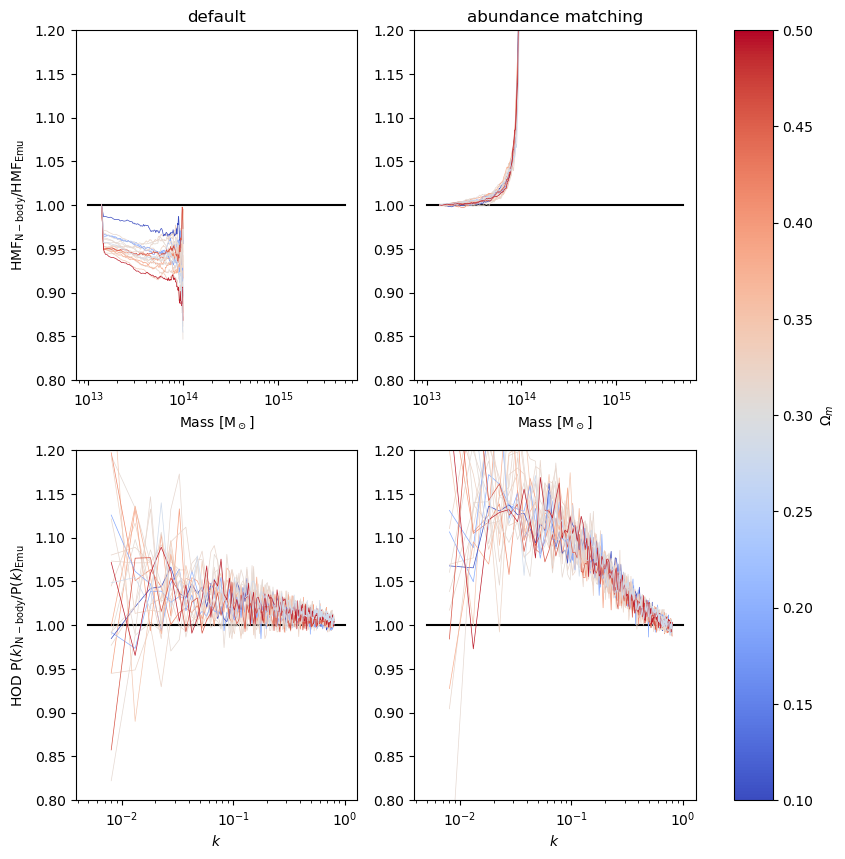

In [92]:
N = 400000
Om_range = np.linspace(0.1,0.5,10)

poles = []


fig, axs = plt.subplots(2,2,figsize=(10,10))
axs[0][0].plot([1e13, 5e15], [1,1], color="black")
axs[0][1].plot([1e13, 5e15], [1,1], color="black")
axs[1][0].plot([0.005, 1], [1,1], color="black")
axs[1][1].plot([0.005, 1], [1,1], color="black")

axs[0][0].set_title("default")
axs[0][1].set_title("abundance matching")
axs[0][0].set_xscale("log")
axs[0][1].set_xscale("log")
axs[1][0].set_xscale("log")
axs[1][1].set_xscale("log")
axs[0][0].set_ylim(0.8,1.2)
axs[0][1].set_ylim(0.8,1.2)
axs[1][0].set_ylim(0.8,1.2)
axs[1][1].set_ylim(0.8,1.2)


axs[0][0].set_xlabel(r"Mass [M$_\odot$]")
axs[0][1].set_xlabel(r"Mass [M$_\odot$]")
axs[1][0].set_xlabel(r"$k$")
axs[1][1].set_xlabel(r"$k$")


axs[0][0].set_ylabel(r"HMF$_{\rm N-body}$/HMF$_{\rm Emu}$")
axs[1][0].set_ylabel(r"HOD P$(k)_{\rm N-body}$/P$(k)_{\rm Emu}$")


for lh_num in LH_NUMS:
    
    mn,me,vn,ve,pn,pe = read_halos(lh_num)
    
    mn_filt = np.where(mn<1e14)
    me_filt = np.where(me<1e14)
    
    mn,me,vn,ve,pn,pe = mn[mn_filt],me[me_filt],vn[mn_filt],ve[me_filt],pn[mn_filt],pe[me_filt]
    
    
    cosmo, mp = get_cosmo(lh_num)
    Om = cosmo.Omega0_cdm + cosmo.Omega0_b
    col=CMAP((Om-np.min(Om_range))/(np.max(Om_range) - np.min(Om_range)))


    N = np.size(mn[mn>1e13])
    unique_mn = np.unique(mn)
    unique_bins = unique_mn[np.where(unique_mn >= 1e13)]
    sortn = np.argsort(mn)
    sorte = np.argsort(me)
    mn,me,vn,ve,pn,pe = mn[sortn][-N:],me[sorte][-N:],vn[sortn][-N:],ve[sorte][-N:],pn[sortn][-N:],pe[sorte][-N:]
    
    
    mr, hmfn = get_hmf(mn, bins = unique_bins)
    mr, hmfe = get_hmf(me, bins = unique_bins)
    axs[0][0].plot(mr[:-1], hmfn/hmfe, color=col,lw=0.5)
    
    
    

    cdf = 1-hmfn/N
    s = np.random.uniform(0,np.max(cdf),N)
    f = interpolate.interp1d(cdf, mr[:-1])
    me_abundance = f(s)
    mr, hmfe = get_hmf(me_abundance, bins = unique_bins)
    axs[0][1].plot(mr[:-1], hmfn/hmfe, color=col, lw=0.5)
    
    
#     cat_nbod = Catalogue(pn, vn, 0,1000,cosmo,"nbod", mass=mn)
#     cat_emu = Catalogue(pe, ve, 0,1000,cosmo,"emu", mass=me)
#     cat_emu_abundance = Catalogue(pe, ve, 0,1000,cosmo,"emu", mass=me_abundance)
  
    hod_nbod = get_hod(pn, vn, mn, cosmo=cosmo)
    hod_emu = get_hod(pe, ve, me, cosmo=cosmo)
    hod_emu_abundance = get_hod(pe, ve, me_abundance, cosmo=cosmo)
        
    Pk_nbod_gal = FFTPower(hod_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu_gal = FFTPower(hod_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu_gal_abundance = FFTPower(hod_emu_abundance, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
        
#     mesh_nbod = cat_nbod.to_mesh(n_mesh=256)
#     mesh_emu = cat_emu.to_mesh(n_mesh=256)
#     mesh_emu_abundance = cat_emu_abundance.to_mesh(n_mesh=256)
#     Pk_nbod = FFTPower(mesh_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.000).power
#     Pk_emu = FFTPower(mesh_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.000).power
#     Pk_emu_abundance = FFTPower(mesh_emu_abundance, mode='1d', Nmesh=256, dk=0.005, kmin=0.000).power
    kn, pkn = Pk_nbod_gal['k'], Pk_nbod_gal['power'].real
    ke, pke = Pk_emu_gal['k'], Pk_emu_gal['power'].real
    ke_abundance, pke_abundance = Pk_emu_gal_abundance['k'], Pk_emu_gal_abundance['power'].real
    
    axs[1][0].plot(kn, pkn/pke, color=col, lw=0.5)
    axs[1][1].plot(kn, pkn/pke_abundance, color=col, lw=0.5)
#     axs[1][0].plot(ke, pke, color=col, lw=0.5)

    

    


c = axs[0][1].scatter([1e13,1e14], [1,1], c=[np.min(Om_range),np.max(Om_range)],cmap=CMAP, s=0)
fig.colorbar(c, ax=axs.ravel().tolist(),label=r"$\Omega_m$")
plt.savefig("figures/abundance_check_1e14_max_mass.pdf", bbox_inches="tight")


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass

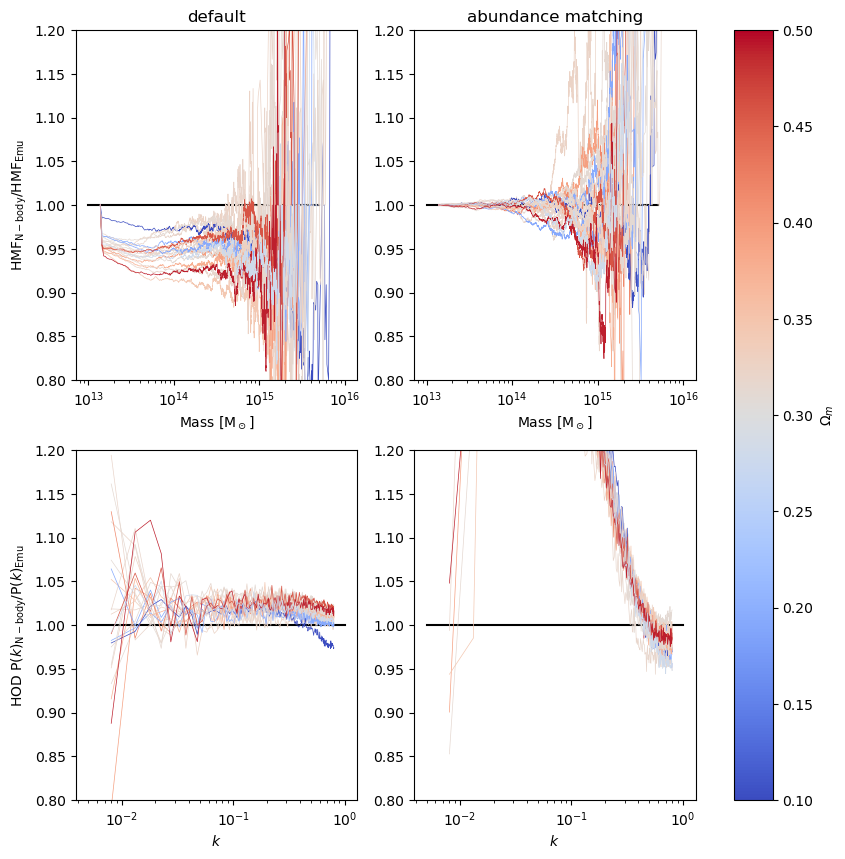

In [93]:
N = 400000
Om_range = np.linspace(0.1,0.5,10)

poles = []


fig, axs = plt.subplots(2,2,figsize=(10,10))
axs[0][0].plot([1e13, 5e15], [1,1], color="black")
axs[0][1].plot([1e13, 5e15], [1,1], color="black")
axs[1][0].plot([0.005, 1], [1,1], color="black")
axs[1][1].plot([0.005, 1], [1,1], color="black")

axs[0][0].set_title("default")
axs[0][1].set_title("abundance matching")
axs[0][0].set_xscale("log")
axs[0][1].set_xscale("log")
axs[1][0].set_xscale("log")
axs[1][1].set_xscale("log")
axs[0][0].set_ylim(0.8,1.2)
axs[0][1].set_ylim(0.8,1.2)
axs[1][0].set_ylim(0.8,1.2)
axs[1][1].set_ylim(0.8,1.2)


axs[0][0].set_xlabel(r"Mass [M$_\odot$]")
axs[0][1].set_xlabel(r"Mass [M$_\odot$]")
axs[1][0].set_xlabel(r"$k$")
axs[1][1].set_xlabel(r"$k$")


axs[0][0].set_ylabel(r"HMF$_{\rm N-body}$/HMF$_{\rm Emu}$")
axs[1][0].set_ylabel(r"HOD P$(k)_{\rm N-body}$/P$(k)_{\rm Emu}$")


for lh_num in LH_NUMS:
    
    mn,me,vn,ve,pn,pe = read_halos(lh_num)
    
#     mn_filt = np.where(mn<1e14)
#     me_filt = np.where(me<1e14)
    
#     mn,me,vn,ve,pn,pe = mn[mn_filt],me[me_filt],vn[mn_filt],ve[me_filt],pn[mn_filt],pe[me_filt]
    
    
    cosmo, mp = get_cosmo(lh_num)
    Om = cosmo.Omega0_cdm + cosmo.Omega0_b
    col=CMAP((Om-np.min(Om_range))/(np.max(Om_range) - np.min(Om_range)))


    N = np.size(mn[mn>1e13])
    unique_mn = np.unique(mn)
    unique_bins = unique_mn[np.where(unique_mn >= 1e13)]
    sortn = np.argsort(mn)
    sorte = np.argsort(me)
    mn,me,vn,ve,pn,pe = mn[sortn][-N:],me[sorte][-N:],vn[sortn][-N:],ve[sorte][-N:],pn[sortn][-N:],pe[sorte][-N:]
    
    
    mr, hmfn = get_hmf(mn, bins = unique_bins)
    mr, hmfe = get_hmf(me, bins = unique_bins)
    axs[0][0].plot(mr[:-1], hmfn/hmfe, color=col,lw=0.5)
    
    
    

    cdf = 1-hmfn/N
    s = np.random.uniform(0,np.max(cdf),N)
    f = interpolate.interp1d(cdf, mr[:-1])
    me_abundance = f(s)
    mr, hmfe = get_hmf(me_abundance, bins = unique_bins)
    axs[0][1].plot(mr[:-1], hmfn/hmfe, color=col, lw=0.5)
    
    
#     cat_nbod = Catalogue(pn, vn, 0,1000,cosmo,"nbod", mass=mn)
#     cat_emu = Catalogue(pe, ve, 0,1000,cosmo,"emu", mass=me)
#     cat_emu_abundance = Catalogue(pe, ve, 0,1000,cosmo,"emu", mass=me_abundance)
  
    hod_nbod = get_hod(pn, vn, mn, cosmo=cosmo)
    hod_emu = get_hod(pe, ve, me, cosmo=cosmo)
    hod_emu_abundance = get_hod(pe, ve, me_abundance, cosmo=cosmo)
        
    Pk_nbod_gal = FFTPower(hod_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu_gal = FFTPower(hod_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    Pk_emu_gal_abundance = FFTPower(hod_emu_abundance, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
        
#     mesh_nbod = cat_nbod.to_mesh(n_mesh=256)
#     mesh_emu = cat_emu.to_mesh(n_mesh=256)
#     mesh_emu_abundance = cat_emu_abundance.to_mesh(n_mesh=256)
#     Pk_nbod = FFTPower(mesh_nbod, mode='1d', Nmesh=256, dk=0.005, kmin=0.000).power
#     Pk_emu = FFTPower(mesh_emu, mode='1d', Nmesh=256, dk=0.005, kmin=0.000).power
#     Pk_emu_abundance = FFTPower(mesh_emu_abundance, mode='1d', Nmesh=256, dk=0.005, kmin=0.000).power
    kn, pkn = Pk_nbod_gal['k'], Pk_nbod_gal['power'].real
    ke, pke = Pk_emu_gal['k'], Pk_emu_gal['power'].real
    ke_abundance, pke_abundance = Pk_emu_gal_abundance['k'], Pk_emu_gal_abundance['power'].real
    
    axs[1][0].plot(kn, pkn/pke, color=col, lw=0.5)
    axs[1][1].plot(kn, pkn/pke_abundance, color=col, lw=0.5)
#     axs[1][0].plot(ke, pke, color=col, lw=0.5)

    

    


c = axs[0][1].scatter([1e13,1e14], [1,1], c=[np.min(Om_range),np.max(Om_range)],cmap=CMAP, s=0)
fig.colorbar(c, ax=axs.ravel().tolist(),label=r"$\Omega_m$")
plt.savefig("figures/abundance_check.pdf", bbox_inches="tight")


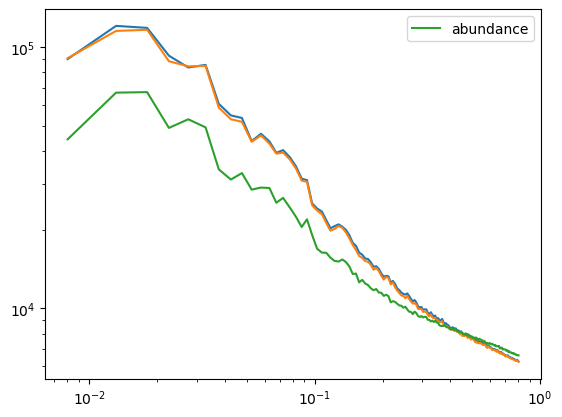

In [135]:
#     kn, pkn = Pk_nbod_gal['k'], Pk_nbod_gal['power'].real
#     ke, pke = Pk_emu_gal['k'], Pk_emu_gal['power'].real
#     ke_abundance, pke_abundance = Pk_emu_gal_abundance['k'], Pk_emu_gal_abundance['power'].real
plt.plot(kn, pkn)
plt.plot(ke, pke)
plt.plot(ke_abundance, pke_abundance,label="abundance")
plt.legend()
plt.xscale("log")
plt.yscale("log")


In [137]:
np.mean(np.array(hod_nbod["Position"]))

499.31592

In [138]:
np.mean(np.array(hod_emu["Position"]))

499.0783

In [139]:
np.mean(np.array(hod_emu_abundance["Position"]))

499.13193

In [123]:
hmn = np.log10(np.array(hod_nbod["halo_mvir"]))
hme = np.log10(np.array(hod_emu["halo_mvir"]))
hme_abundance = np.log10(np.array(hod_emu_abundance["halo_mvir"]))



Text(0, 0.5, 'N HOD Gals')

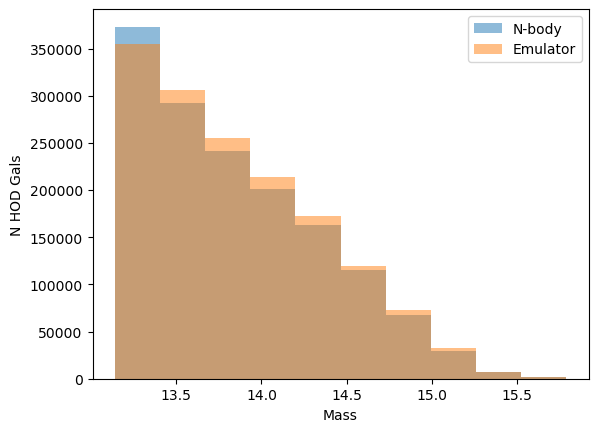

In [132]:
a=plt.hist(hmn,alpha=0.5,label="N-body")
bins=a[1]
plt.hist(hme,alpha=0.5,bins=bins,label="Emulator")
plt.legend()
plt.xlabel("Mass")
plt.ylabel("N HOD Gals")


Text(0, 0.5, 'N HOD Gals')

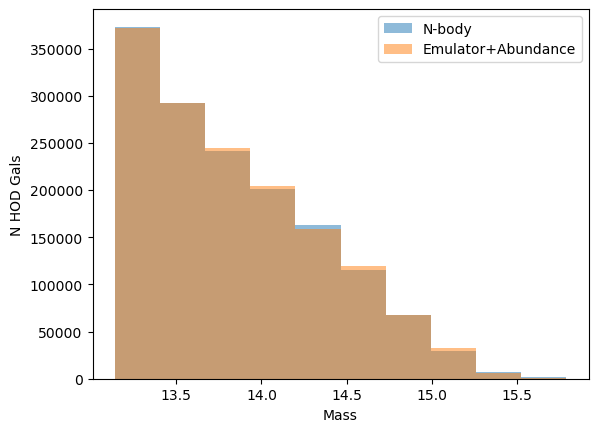

In [133]:
a=plt.hist(hmn,alpha=0.5,label="N-body")
bins=a[1]
plt.hist(hme_abundance,alpha=0.5,bins=bins,label="Emulator+Abundance")
plt.legend()
plt.xlabel("Mass")
plt.ylabel("N HOD Gals")

In [ ]:
ld = np.log10(hod_nbod["halo_mvir"])

In [ ]:
plt.hist(ld)

In [101]:
hod_nbod.columns

['Position',
 'Selection',
 'Value',
 'Velocity',
 'VelocityOffset',
 'Weight',
 'conc_NFWmodel',
 'gal_type',
 'halo_hostid',
 'halo_id',
 'halo_mvir',
 'halo_num_centrals',
 'halo_num_satellites',
 'halo_rvir',
 'halo_upid',
 'halo_vx',
 'halo_vy',
 'halo_vz',
 'halo_x',
 'halo_y',
 'halo_z',
 'host_centric_distance',
 'vx',
 'vy',
 'vz',
 'x',
 'y',
 'z']

In [ ]:
def get_hmf(mass, log_low_m = 13, bins = []):
    log_mass = np.log10(mass)
    if(np.min(log_mass)< log_low_m): 
        print("ERROR IN get_hmf(mass), mass isn't filtered.")
    if(bins == []): mass_range = np.logspace(log_low_m,16,20)
    else: mass_range = bins
    dlogm = 1#np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass >= lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf

/tmp/ipykernel_7387/2586664091.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


5.792733788996057e-06 0.9999941899026364
0.0 0.999995


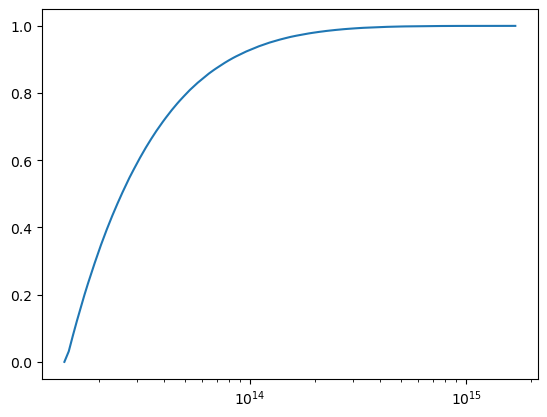

In [36]:
mr, hmfe = get_hmf(me)
mr, hmfn = get_hmf(mn)

N = 400000
unique_mn = np.unique(mn)
unique_bins = unique_mn[np.where(unique_mn >= 1e13)]
mr, hmfn = get_hmf(np.sort(mn)[-N:], bins = unique_bins)
# plt.plot(mr[:-1], hmfn, label='n')
# plt.yscale("log")
# plt.xscale("log")


cdf = 1-hmfn/N
plt.plot(mr[:-1], cdf, label='n')
plt.xscale("log")
s = np.random.uniform(0,np.max(cdf),N)
f = interpolate.interp1d(cdf, mr[:-1])
print(np.min(s), np.max(s))
print(np.min(cdf), np.max(cdf))
me_abundance = f(s)

mr, hmfe = get_hmf(me_abundance, bins = unique_bins)


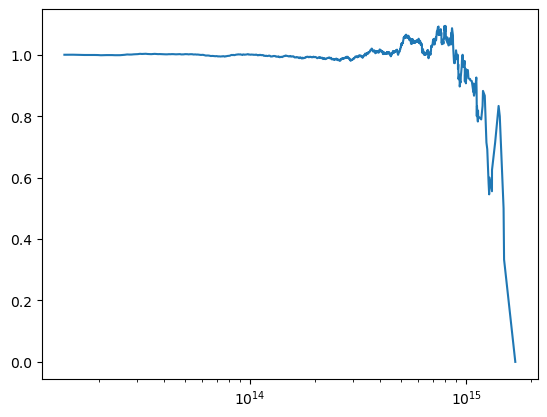

In [38]:
plt.plot(mr[:-1], hmfe/hmfn, label="e")
# plt.plot(mr[:-1], hmfn, label='n')
# plt.yscale("log")
plt.xscale("log")

In [ ]:
###grab N most massive e pos and vels, compute bispectra on those

In [44]:
lh_list =[]
m1, m3, n136 = [],[],[]
om_list = []
Nemu = []
Nnbody = []
Ngalnbody = []

for lh_num in LH_NUMS:
    print(lh_num)
    
    mn,me,vn,ve,pn,pe = read_halos(lh_num)
    
    cosmo, mp = get_cosmo(lh_num)
    me = np.sort(me)
    lh_list.append(int(lh_num))
    m1.append(me[-100000])
    m3.append(me[-250000])
    n136.append(np.size(np.where(me>100*mp)))
    om_list.append(read_sim_params2(lh_num, "Om"))
    Nemu.append(np.size(me))
    Nnbody.append(np.size(mn))
    Ngalnbody.append(get_hod(pn, vn, mn, cosmo=cosmo,z=0.5).size)
    
    
argsorts = np.argsort(lh_list)
lh_list = np.array(lh_list)[argsorts]
m1      = np.array(m1)[argsorts]
m3 = np.array(m3)[argsorts]
n136 = np.array(n136)[argsorts]
om_list = np.array(om_list)[argsorts]
Nemu = np.array(Nemu)[argsorts]
Nnbody = np.array(Nnbody)[argsorts]
Ngalnbody = np.array(Ngalnbody)[argsorts]



/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


324


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1702


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1026


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1951


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1122


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


944


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


485


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1582


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


592


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1323


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


401


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


406


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1608


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


391


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1710


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


444


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1696


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


926


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


694


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


1515


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


502


In [53]:
get_hod(pn, vn, mn, cosmo=cosmo,z=0.5).size

1491625

In [57]:
get_hod(pn[mn<1e13.5], vn[mn<1e13.5], mn[mn<1e13.5], cosmo=cosmo,z=0.0).size

SyntaxError: invalid syntax (2370883907.py, line 1)

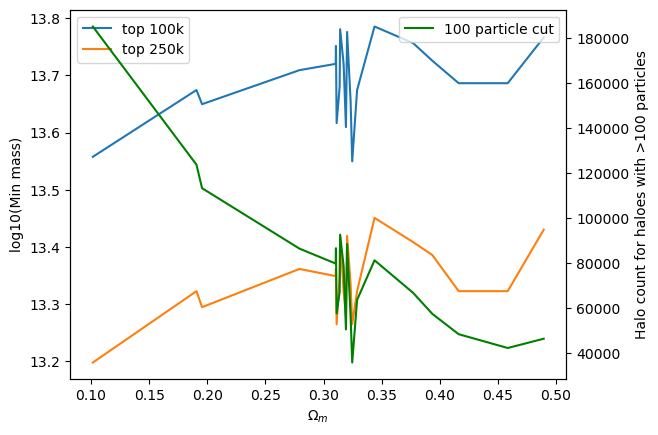

In [46]:

fig, ax1 = plt.subplots()
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis


om_sort = np.argsort(om_list)
ax1.plot(om_list[om_sort], np.log10(m1)[om_sort], label="top 100k")
ax1.plot(om_list[om_sort], np.log10(m3)[om_sort], label="top 250k")
ax2.plot(om_list[om_sort], n136[om_sort], label="100 particle cut", c="green")
ax1.set_xlabel(r"$\Omega_m$")
ax1.set_ylabel("log10(Min mass)")
ax2.set_ylabel("Halo count for haloes with >100 particles")
ax1.legend()
ax2.legend()
plt.savefig("figures/ncuts_vs_om.pdf", bbox_inches="tight")





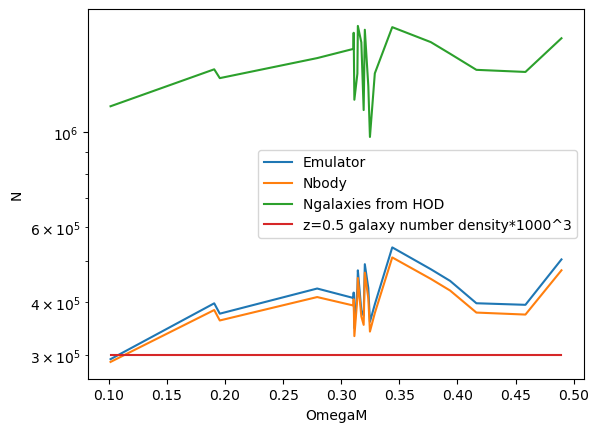

In [52]:

fig, ax1 = plt.subplots()
n = 3e-4*1000**3
n3 = n *1.5**3

om_sort = np.argsort(om_list)
plt.plot(om_list[om_sort], Nemu[om_sort], label="Emulator")
plt.plot(om_list[om_sort], Nnbody[om_sort], label="Nbody")
plt.plot(om_list[om_sort], Ngalnbody[om_sort], label="Ngalaxies from HOD")
plt.plot(om_list[om_sort], np.linspace(n,n,len(om_list)), label="z=0.5 galaxy number density*1000^3")
plt.xlabel("OmegaM")
plt.ylabel("N")
plt.yscale("log")
plt.legend()

plt.savefig("figures/N_vs_Om.pdf", bbox_inches="tight")



setting up runners
init WST from wst summary package


 device: 

 cpu
Working on LH 324


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/4154887630.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/4154887630.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/4154887630.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/4154887630.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1702


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/4154887630.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/4154887630.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/4154887630.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/4154887630.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


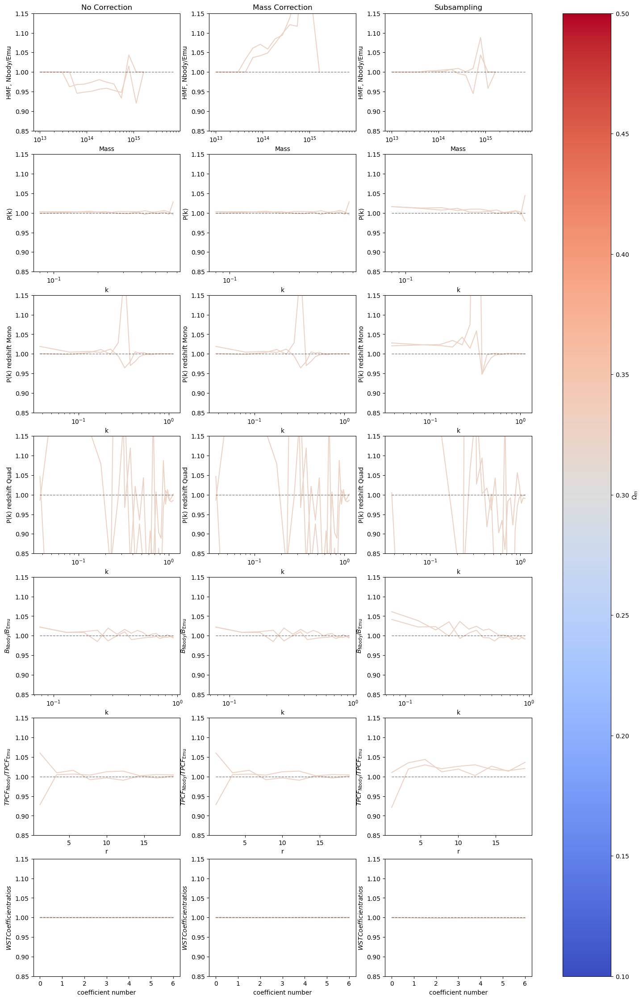

In [40]:
POWER = 3
compare_ratios(LH_NUMS[:2],savename="figures/all_ratios_2_cosmos.pdf")

setting up runners
init WST from wst summary package


 device: 

 cpu
Working on LH 324


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1702


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1026


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1951


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1122


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 944


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 485


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1582


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 592


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1323


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: divide by zero encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 401


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu


pk
tpcf
pk
tpcf
pk
tpcf
Working on LH 406


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1608


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu


pk
tpcf
pk
tpcf
pk
tpcf
Working on LH 391


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1710


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 444


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1696


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 926


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 694


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 1515


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf
Working on LH 502


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/2300116006.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


/tmp/ipykernel_3969/2300116006.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
tpcf


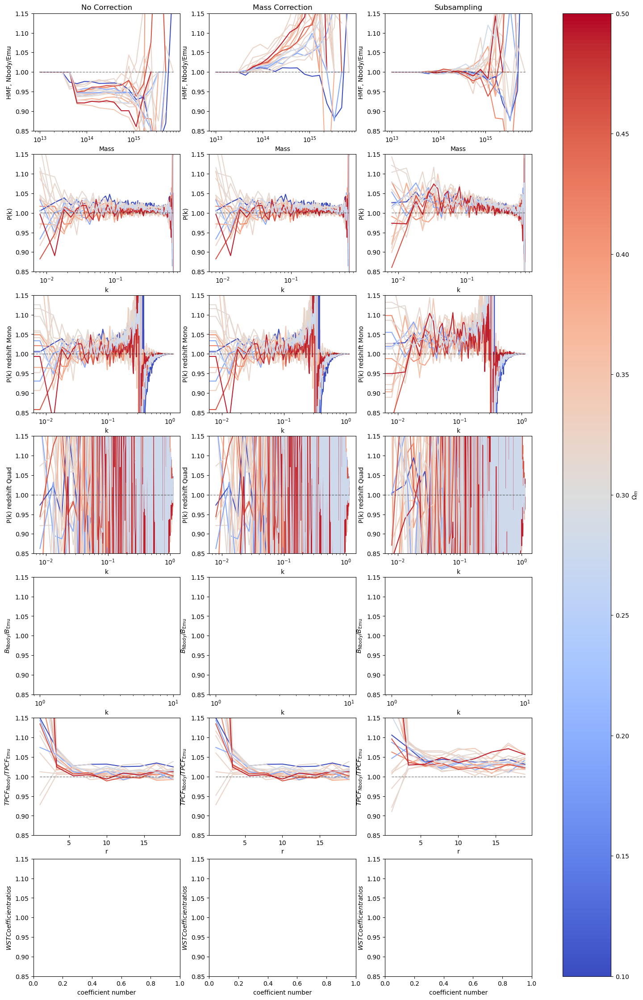

In [42]:
compare_ratios(LH_NUMS,savename="figures/some_ratios_all_cosmos.pdf")

setting up runners
init WST from wst summary package


 device: 

 cpu
Working on LH 324


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1702


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1026


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1951


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1122


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 944


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 485


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1582


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 592


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1323


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: divide by zero encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 401


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu


pk
bk
tpcf
wst
pk
bk
tpcf
wst
pk
bk
tpcf
wst
Working on LH 406


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1608


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu


pk
bk
tpcf
wst
pk
bk
tpcf
wst
pk
bk
tpcf
wst
Working on LH 391


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1710


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 444


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1696


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 926


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 694


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 1515


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst
Working on LH 502


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3969/844094686.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


/tmp/ipykernel_3969/844094686.py:198: RuntimeWarning: invalid value encountered in true_divide
  axs[0][x].plot(mass_range[:-1], hmfn/hmfe,c=col)


pk
bk
tpcf
wst


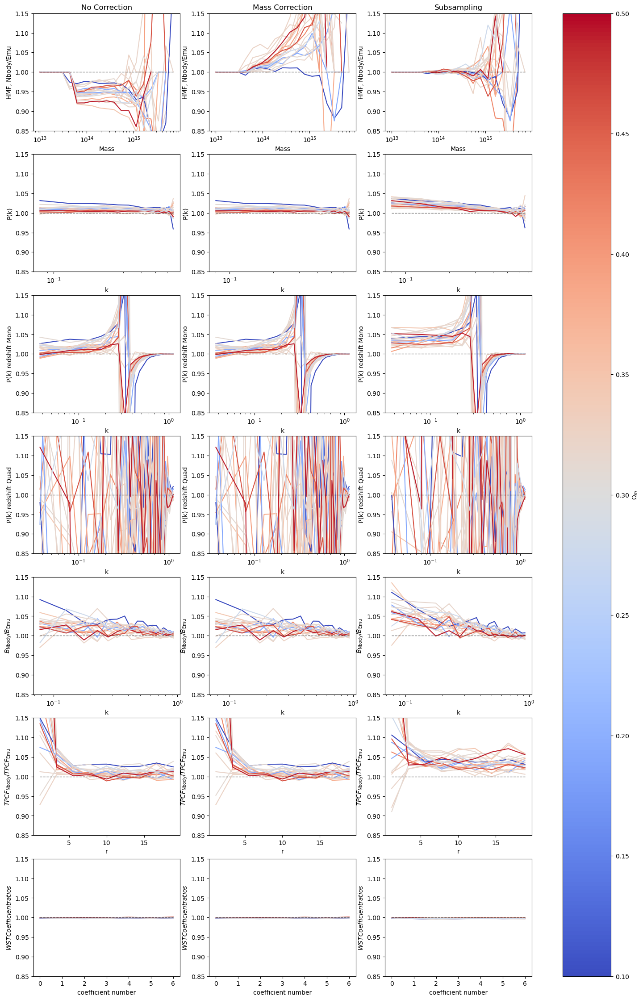

In [46]:
compare_ratios(LH_NUMS,savename="figures/all_ratios_all_cosmos.pdf")

In [8]:
#### For each cosmo, compare N excess, excess mass, and fit params (power and subsample)

def read_sim_params2(lh_num, arg):
    df = pd.read_csv("../../../LH_data/"+str(lh_num)+"_sim_params_full")
    params=[]
    return list(df[arg])[0]




def calc_subsample_params(mass_filtered_nbod, mass_filtered_emu, num_bins=10):
    bins = np.logspace(13,15.,num_bins+1)
    binned_mean = np.log10((bins[1:] + bins[:-1])/2.0)
#     print(mass_filtered_nbod, mass_filtered_emu, binned_mean)
    N_emu,N_nbod =[],[]

    for x in range(num_bins):
        lo,up = bins[x], bins[x+1]
        mn=mass_filtered_nbod[(lo <= mass_filtered_nbod) & ( mass_filtered_nbod < up)]
        N_nbod.append(np.size(mn))
        me = mass_filtered_emu[(lo <= mass_filtered_emu) & ( mass_filtered_emu < up)]
        N_emu.append(np.size(me))

    N_emu,N_nbod = np.array(N_emu),np.array(N_nbod)
    remove_fraction = (N_emu-N_nbod)/N_emu
    x,y = binned_mean,remove_fraction
    fin_filter = np.where((np.isfinite(y)) & (np.isfinite(x)))[0]
    x= x[fin_filter]
    y = y[fin_filter]
    plt.scatter(x,y)
#     return np.polyfit(x,y,1)
    


# s8, om, ndif, mdif, a_fit, a_sub,fdif = [],[],[],[],[],[],[]
# n_nbod = []
# for lh_num in lh_nums:
#     mn,me,vn,ve,pn,pe = read_halos(lh_num)

#     cosmo, mp = get_cosmo(lh_num)
#     Om = cosmo.Omega0_cdm + cosmo.Omega0_b
    
#     om.append(read_sim_params2(lh_num, "Om"))
#     s8.append(read_sim_params2(lh_num, "sigma_8"))
#     n_nbod.append(len(mn))
#     ndif.append(len(me) - len(mn))
#     fdif.append((len(me) - len(mn))/len(mn))
    
#     totalmn = np.sum(mn)
#     totalme = np.sum(me)
#     mdif.append(totalme-totalmn)

#     #Mass power corr
#     npair, epair, npl, epl, ns, es = read_pairs(lh_num)
#     popt = calc_fit(mn[npair], me[epair])    
#     a,b,c = popt
#     a_fit.append(a)
    
#     a_sub.append(calc_subsample_params(mn,me)[-1]) #-1 is the slope of a line (change this later)
    
    
    
    
    
    


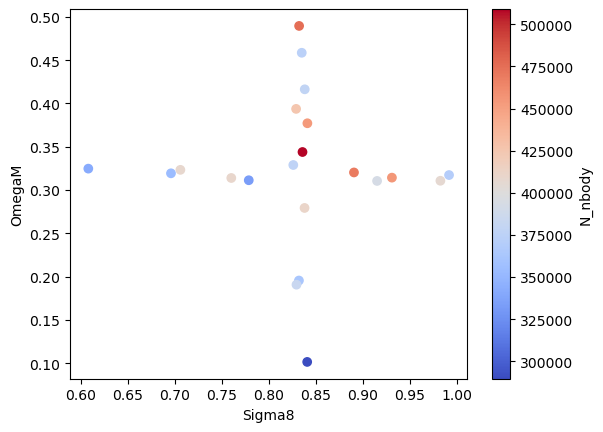

In [118]:
plt.figure()
plt.scatter(s8, om, c=n_nbod, cmap=CMAP)
plt.colorbar(label="N_nbody")
plt.xlabel("Sigma8")
plt.ylabel("OmegaM")
plt.savefig("figures/params_vs_N_nbody.pdf")

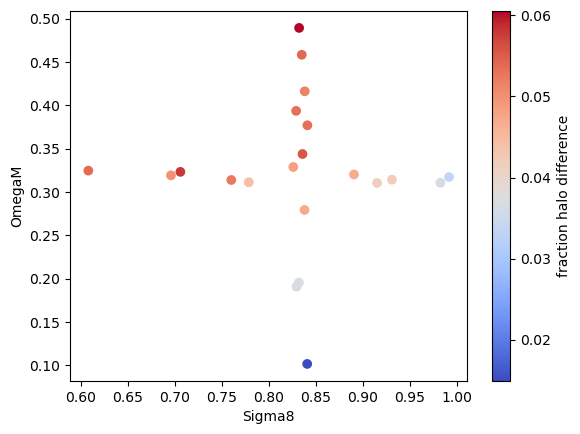

In [119]:
plt.figure()
plt.scatter(s8, om, c=fdif, cmap=CMAP)
plt.colorbar(label="fraction halo difference")
plt.xlabel("Sigma8")
plt.ylabel("OmegaM")
plt.savefig("figures/params_vs_fdif.pdf")

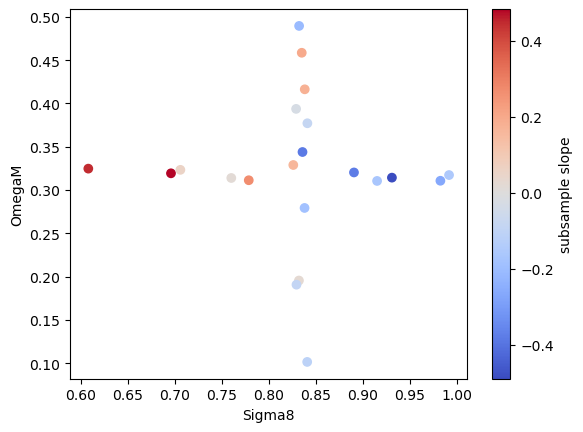

In [110]:
plt.figure()
plt.scatter(s8, om, c=a_sub, cmap=CMAP)
plt.colorbar(label="subsample slope")
plt.xlabel("Sigma8")
plt.ylabel("OmegaM")
plt.savefig("figures/params_vs_asub.pdf")

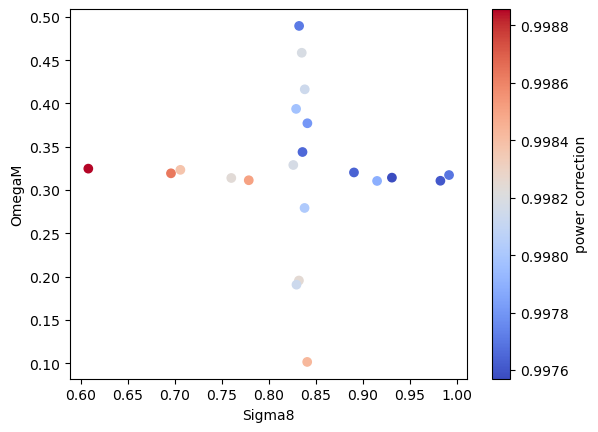

In [109]:
plt.figure()
plt.scatter(s8, om, c=a_fit, cmap=CMAP)
plt.colorbar(label="power correction")
plt.xlabel("Sigma8")
plt.ylabel("OmegaM")
plt.savefig("figures/params_vs_apower.pdf")

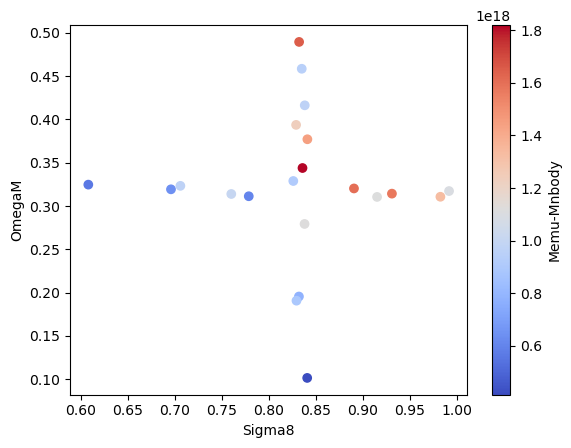

In [108]:
plt.figure()
plt.scatter(s8, om, c=mdif, cmap=CMAP)
plt.colorbar(label="Memu-Mnbody")
plt.xlabel("Sigma8")
plt.ylabel("OmegaM")
plt.savefig("figures/params_vs_mdif.pdf")

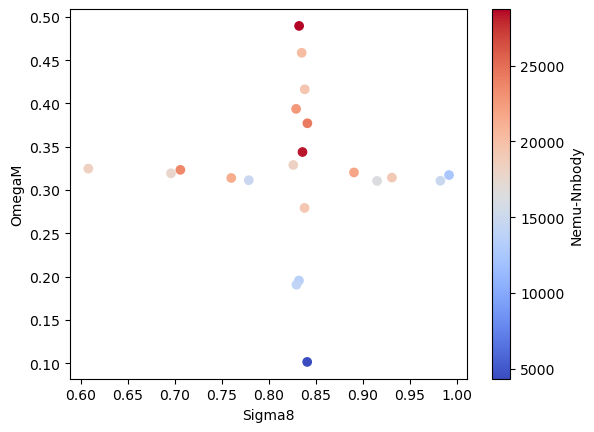

In [107]:
plt.figure()
plt.scatter(s8, om, c=ndif, cmap=CMAP)
plt.colorbar(label="Nemu-Nnbody")
plt.xlabel("Sigma8")
plt.ylabel("OmegaM")
plt.savefig("figures/params_vs_ndif.pdf")

# Bispectrum

In [11]:

lh_num = LH_NUMS[:1][0]
mn,me,vn,ve,pn,pe = read_halos(lh_num)
cosmo = get_cosmo(lh_num)

cat1 = Catalogue(pn, vn, 0,1000,cosmo,"name", mass=mn)
cat2 = Catalogue(pe, ve, 0,1000,cosmo,"name", mass=me)

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


In [7]:
from summarizer import Bk
bk_runner1 = Bk(BoxSize = cat1.boxsize,kmin = 0.01,  kmax = 1.,dk = 0.05)
bkn = bk_runner1(catalogue=cat1)
bkn = bk_runner1.to_dataset(bkn)

bk_runner2 = Bk(BoxSize = cat2.boxsize,kmin = 0.01,  kmax = 1.,dk = 0.05)
bke = bk_runner2(catalogue=cat2)
bke = bk_runner2.to_dataset(bke)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


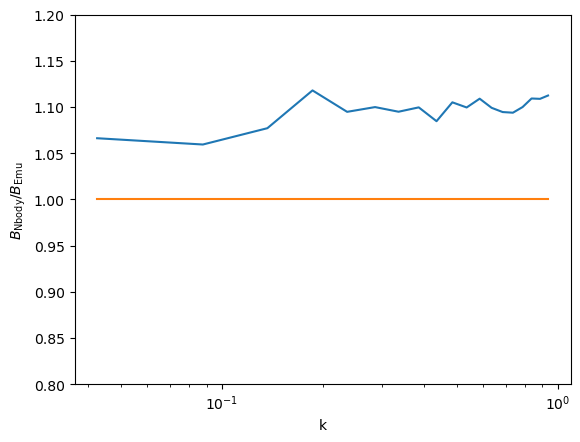

In [155]:
plt.plot(bk['k'],bkn/bke)
plt.xlabel("k")
plt.ylabel(r"$B_{\rm Nbody}/B_{\rm Emu}$")
# plt.yscale("log")
plt.xscale("log")
plt.ylim(0.8,1.2)
plt.plot(bk["k"], np.linspace(1,1,len(bk["k"])))

# Two point CF

In [153]:
tpcf_runner = TwoPCF(
        r_bins=np.linspace(0.01, 20., 10),
        mu_bins=np.linspace(-1.,1.,210),
        ells=[0,2,4],
    )
tpcf1 = tpcf_runner(cat1)
tpcf1 = tpcf_runner.to_dataset(tpcf1)
tpcf2 = tpcf_runner(cat2)
tpcf2 = tpcf_runner.to_dataset(tpcf2)


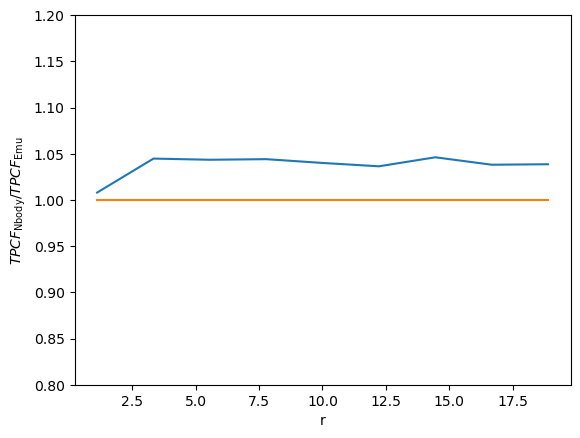

In [157]:
plt.plot(tpcf1["r"], tpcf1[0]/tpcf2[0])
plt.xlabel("r")
plt.ylabel(r"$TPCF_{\rm Nbody}/TPCF_{\rm Emu}$")
# plt.yscale("log")
# plt.xscale("log")
plt.ylim(0.8,1.2)
plt.plot(tpcf1["r"], np.linspace(1,1,len(tpcf1["r"])))

# redshift space P(k)

In [16]:
pk_runner = Pk(ells=[0,4],dk=0.05)
pk1 = pk_runner(catalogue=cat1)
pk1 = pk_runner.to_dataset(pk1)
pk2 = pk_runner(catalogue=cat2)
pk2 = pk_runner.to_dataset(pk2)

#assert pk1.values.shape == (2, 40)

NameError: name 'cat1' is not defined

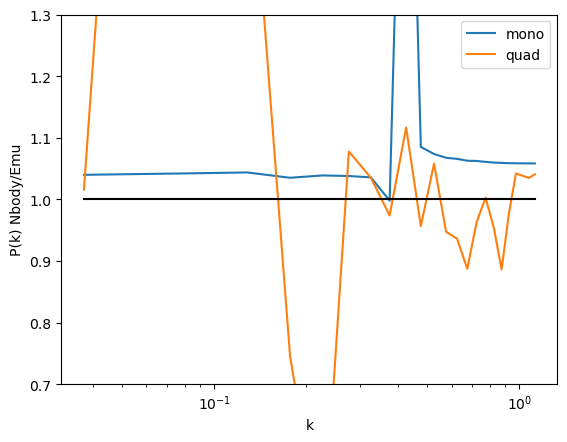

In [21]:
plt.plot(pk1["k"], pk1[0]/pk2[0],label="mono")
plt.plot(pk1["k"], pk1[1]/pk2[1], label="quad")
plt.plot(pk1["k"], np.linspace(1,1,len(pk1["k"])), color="black")
plt.ylim(0.7,1.3)
plt.xlabel("k")
plt.legend()
plt.ylabel("P(k) Nbody/Emu")
plt.xscale("log")

# Wavelet Coefs

In [9]:
from summarizer import WST

In [12]:
wst_runner = WST(J_3d = 1, L_3d = 1)
wst = wst_runner(catalogue=cat1)
wst = wst_runner.to_dataset(wst)

In [14]:
wst2 = wst_runner(catalogue=cat2)
wst2 = wst_runner.to_dataset(wst2)

In [20]:
wst2[0]

<xarray.DataArray ()>
array(0.58656576)
Coordinates:
    coefficient  int64 0

In [13]:
wst

<xarray.DataArray (coefficient: 7)>
array([0.58085168, 0.77475077, 0.60081739, 0.90321065, 0.57471378,
       0.92089618, 0.31992065])
Coordinates:
  * coefficient  (coefficient) int64 0 1 2 3 4 5 6

# Gen all pairs

In [6]:
def gen_fof_pair_cands(lh_num):
    savename = "pair_files/fof_pair_cands_"+str(lh_num)
    ehd_emu_full = np.load("../../../LH_data/"+str(lh_num)+"_emu_hid.npy")
    ehd_nbody_full = np.load("../../../LH_data/"+str(lh_num)+"_nbody_hid.npy")

    ehd_emu_full=ehd_emu_full.astype(int)
    ehd_nbody_full=ehd_nbody_full.astype(int)
    find_all_pairs(ehd_emu_full, ehd_nbody_full,savename)
    
    

def cross_check_pairs_by_particle(lh_num):

    f0nbody = BigFileCatalog("../../../LH_data/"+str(lh_num)+"_nbody_fof_halos")
    f0emu = BigFileCatalog("../../../LH_data/"+str(lh_num)+"_emu_fof_halos")
    mass_nbod  = np.array(f0nbody["Mass"])
    mass_emu  = np.array(f0emu["Mass"])


    df1 = pd.read_csv("pair_files/fof_pair_cands_"+str(lh_num)+"_nbod")
    df2 = pd.read_csv("pair_files/fof_pair_cands_"+str(lh_num)+"_emu")
    base_ids1,target_ids1,frac1, base_ids2,target_ids2,frac2 = np.array(df1["base_ids1"]).astype(int),np.array(df1["target_ids1"]).astype(int),np.array(df1["frac1"]), np.array(df2["base_ids2"]).astype(int),np.array(df2["target_ids2"]).astype(int),np.array(df2["frac2"])

    lonely_baseids1 = base_ids1[np.where(frac1 == -1)[0]]
    lonely_baseids1 = lonely_baseids1[~np.isin(lonely_baseids1, target_ids2)]
    lonely_baseids2 = base_ids2[np.where(frac2 == -1)[0]]
    lonely_baseids2 = lonely_baseids2[~np.isin(lonely_baseids2, target_ids1)]

    filt1 = ~np.isin(base_ids1, lonely_baseids1)
    filt2 = ~np.isin(base_ids2, lonely_baseids2)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]

    unique_base1, indices1 = np.unique(base_ids1, return_index=True)
    unique_base2, indices2 = np.unique(base_ids2, return_index=True)

    base_ids1, target_ids1 = base_ids1[indices1], target_ids1[indices1]
    base_ids2, target_ids2 = base_ids2[indices2], target_ids2[indices2]
    frac1, frac2   = frac1[indices1], frac2[indices2]


    total = len(base_ids1)
    b_best, t_best = [],[]
    print("working on mutual pairs")
    for x in range(total):
        b,t = base_ids1[x], target_ids1[x]
        cand = target_ids2[np.where(base_ids2 == t)]
        if(cand == b ):
            b_best.append(b)
            t_best.append(t)
        #print("progress: ", x*100.0/total,"%")
    n_agree, e_agree = np.array(b_best), np.array(t_best)



    df1 = pd.read_csv("pair_files/fof_pair_cands_"+str(lh_num)+"_nbod")
    df2 = pd.read_csv("pair_files/fof_pair_cands_"+str(lh_num)+"_emu")


    base_ids1,target_ids1,frac1, base_ids2,target_ids2,frac2 = np.array(df1["base_ids1"]).astype(int),np.array(df1["target_ids1"]).astype(int),np.array(df1["frac1"]), np.array(df2["base_ids2"]).astype(int),np.array(df2["target_ids2"]).astype(int),np.array(df2["frac2"])

    filt1 = ~np.isin(base_ids1, lonely_baseids1)
    filt2 = ~np.isin(base_ids2, lonely_baseids2)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]


#     frac_filter = np.where((fn > MIN_FRAC) & (fe > MIN_FRAC))[0]
#     n_agree = n_agree[frac_filter]
#     e_agree = e_agree[frac_filter]

    filt1 = ~np.isin(base_ids1, n_agree) & ~np.isin(target_ids1, e_agree)
    filt2 = ~np.isin(base_ids2, e_agree) & ~np.isin(target_ids2, n_agree)
    base_ids1 = base_ids1[filt1]
    target_ids1 = target_ids1[filt1]
    frac1 = frac1[filt1]
    base_ids2 = base_ids2[filt2]
    target_ids2 = target_ids2[filt2]
    frac2 = frac2[filt2]

    append_base,append_target = [],[]
    unique_t1 = np.unique(target_ids1)
    print("working on other pairs")
    for x in range(len(unique_t1)):
        t = unique_t1[x]
        args = np.where(target_ids1 == t)[0]
        cand_bases = base_ids1[args]
        cand_bases = cand_bases[~np.isin(cand_bases, np.array(append_base))]
        if(len(cand_bases) == 0):continue
        append_target.append(t)

        if(len(cand_bases) == 1): 
            append_base.append(cand_bases[0])
        else:
            mass_t = mass_emu[t]
            cand_masses = mass_nbod[cand_bases-1]
            append_base.append(cand_bases[np.argmin(np.abs(cand_masses-mass_t))])

    filt = ~np.isin(base_ids2, np.array(append_target)) & ~np.isin(target_ids2, np.array(append_base))
    base_ids2 = base_ids2[filt]
    target_ids2 = target_ids2[filt]

    unique_t2 = np.unique(target_ids2)

    for x in range(len(unique_t2)):
        t = unique_t2[x]
        append_base.append(t)

        args = np.where(target_ids2 == t)[0]
        cand_bases = base_ids2[args]
        if(len(cand_bases) == 1): 
            append_target.append(cand_bases[0])
        else:
            mass_t = mass_nbod[t]
            cand_masses = mass_emu[cand_bases-1]
            append_target.append(cand_bases[np.argmin(np.abs(cand_masses-mass_t))])

    append_base,append_target = np.array(append_base),np.array(append_target)



    n_agree = np.append(n_agree, append_base)
    e_agree = np.append(e_agree, append_target)
    sort = np.argsort(n_agree)
    n_agree = n_agree[sort]
    e_agree = e_agree[sort]


    n,e = n_agree-1, e_agree-1
    mask_pairless_nbod = np.ones(len(mass_nbod), bool)
    mask_pairless_emu = np.ones(len(mass_emu), bool)

    mask_pairless_nbod[n] = 0
    mask_pairless_emu[e] = 0

    mask_pairless_nbod[lonely_baseids1-1] = 0
    mask_pairless_emu[lonely_baseids2-1] = 0

    a,b,c,d = lonely_baseids1, lonely_baseids2, np.where(mask_pairless_nbod == True)[0]+1, np.where(mask_pairless_emu == True)[0]+1
    total = np.size(n_agree)
    a = np.append(a, np.linspace(-1,-1, total-np.size(a)))
    b = np.append(b, np.linspace(-1,-1, total-np.size(b)))
    c = np.append(c, np.linspace(-1,-1, total-np.size(c)))
    d = np.append(d, np.linspace(-1,-1, total-np.size(d)))
    data = np.array([n_agree, e_agree, a,b,c,d]).T


    columns=["nbody_id", "emu_id", "nbody_pairless_id", "emu_pairless_id", "nbody_stolen_id", "emu_stolen_id"]
    df = pd.DataFrame(data, columns=columns)
    df.to_csv("pair_files/fof_pairs_"+str(lh_num))



for lh_num in LH_NUMS[8:]:    
#     gen_fof_pair_cands(lh_num)
    cross_check_pairs_by_particle(lh_num)
    
# cross_check_pairs_by_particle(savename, cand_file, fof=True) 


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


# Fitting a subsample of the cosmos and applying that to others, comparing to the actual best fit




/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hm

[0.99837687 1.         1.        ]
0.9983768710769015 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99885603 1.         1.        ]
0.9988560255295851 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99763829 1.         1.        ]
0.9976382904635173 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99863407 1.         1.        ]
0.9986340722154284 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99823579 1.         1.        ]
0.9982357920515532 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99797665 1.         1.        ]
0.9979766543175969 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99789063 1.         1.        ]
0.9978906318565125 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99765069 1.         1.        ]
0.9976506859562307 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99814234 1.         1.        ]
0.9981423373575422 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.9982468 1.        1.       ]
0.998246803540167 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/3173220100.py:49: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'

[0.99842609 1.         1.        ]
0.9984260894769655 1.0 1.0
[0.99850627 1.         1.        ]
0.9985062659341953 1.0 1.0


/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod

[0.99769143 1.         1.        ]
0.9976914347288134 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu


[0.99813495 1.         1.        ]
0.9981349514958744 1.0 1.0


/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[0.99780271 1.         1.        ]
0.997802705945366 1.0 1.0


/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be esti

[0.99817499 1.         1.        ]
0.9981749908224737 1.0 1.0


/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


[0.99757001 1.         1.        ]
0.9975700148213549 1.0 1.0


/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be esti

[0.99760904 1.         1.        ]
0.9976090372319936 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.9981853 1.        1.       ]
0.9981852959982674 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, siz

[0.99771037 1.         1.        ]
0.9977103693888209 1.0 1.0


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/tmp/ipykernel_31183/3173220100.py:37: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu
/tmp/ipykernel_31183/4150590173.py:46: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
/tmp/ipykernel_31183/4150590173.py:47: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")


[0.99802078 1.         1.        ]
0.998020781411432 1.0 1.0


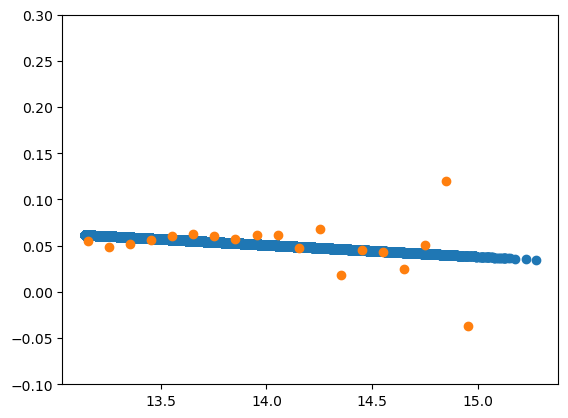

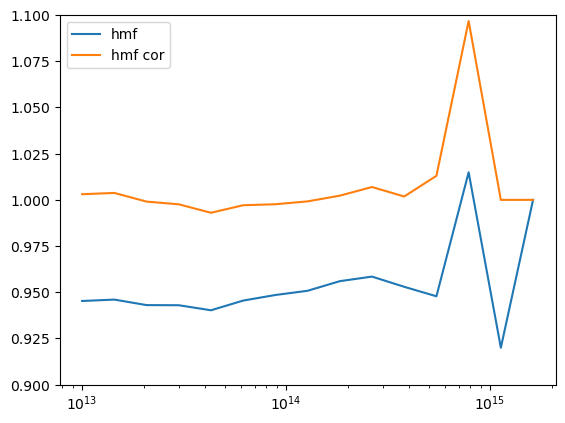

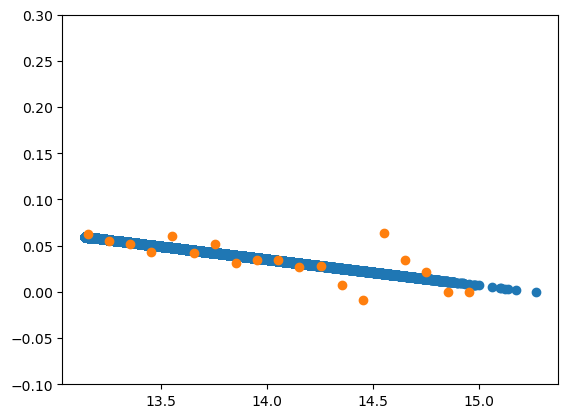

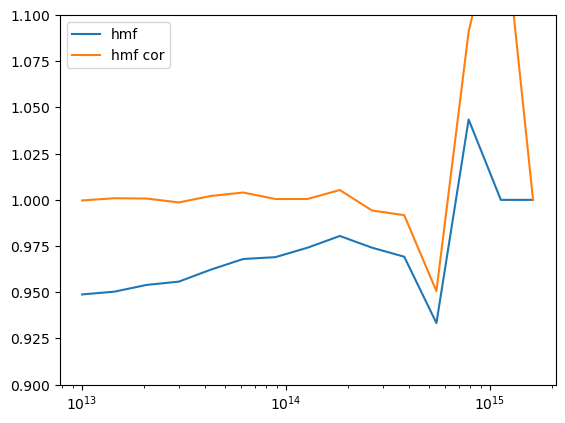

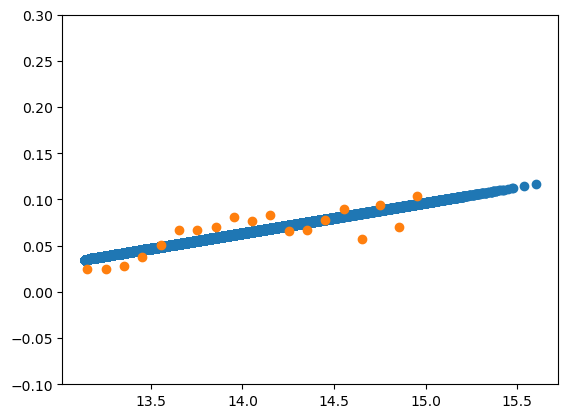

...

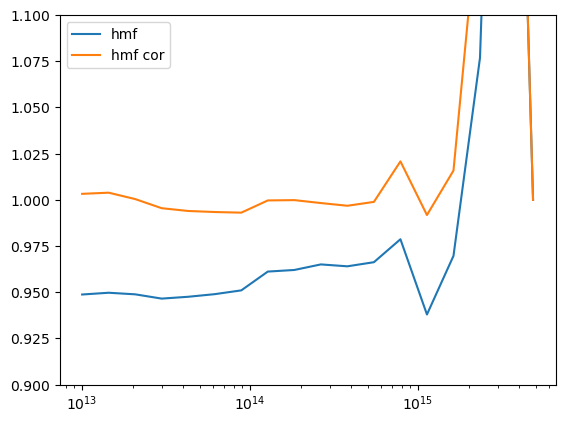

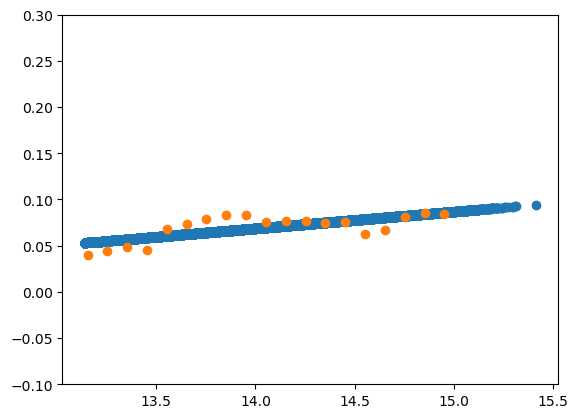

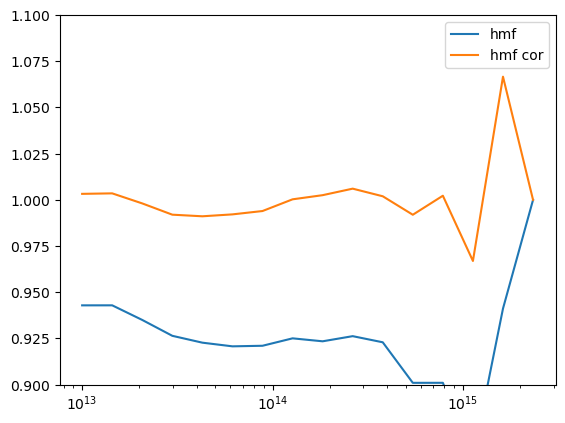

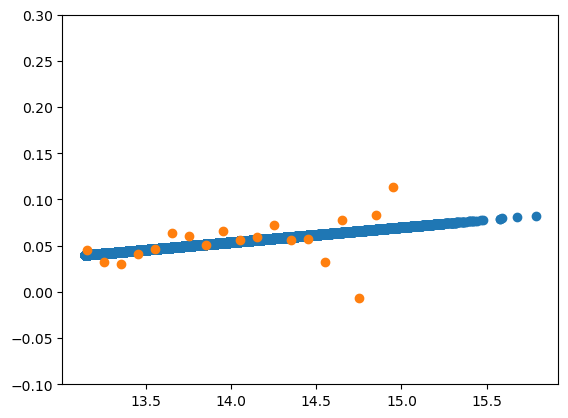

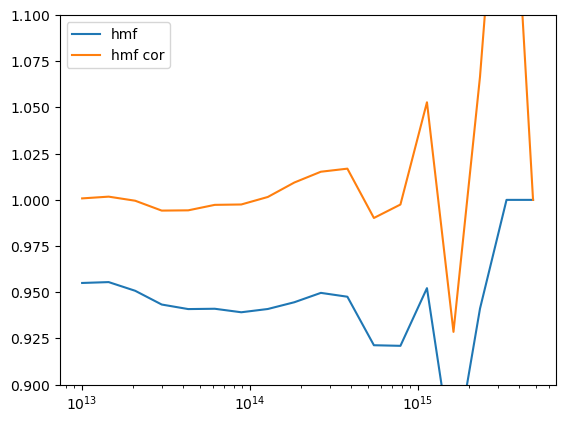

In [67]:
lh_num = LH_NUMS[10]
POWER = 1



a_list, cosmo_list = [],[]
Om_list = []
for lh_num in LH_NUMS:
    mn,me,vn,ve,pn,pe = read_halos(lh_num)
    npair, epair, npl, epl, ns, es = read_pairs(lh_num)


    #derive simple linear correction using pairs, and apply that to all halos
    cosmo, mp = get_cosmo(lh_num)
    Om = cosmo.Omega0_cdm + cosmo.Omega0_b
    cosmo_list.append(cosmo)
    Om_list.append(Om)

    popt = calc_fit(mn[npair], me[epair])    
    print(popt)
    a,b,c = popt
    print(a,b,c)
    a_list.append(a)

#     lme = np.log10(me)
#     mass_emu_corrected = mass_emu_calc(lme, a,b,c)
#     mass_emu_corrected = np.power(10, mass_emu_corrected)
    
#     plt.figure()
#     mass_range, hmfn = get_hmf(mn)
#     mass_range, hmfe = get_hmf(me)
#     mass_range, hmfe2 = get_hmf(mass_emu_corrected)
#     plt.plot(mass_range[:-1], hmfn/hmfe)
#     plt.plot(mass_range[:-1], hmfn/hmfe2,label="cor")
#     plt.legend()
#     plt.ylim(0.9, 1.1)
#     plt.xscale("log")
    
    
    mass_emu_corrected, keep_args = calc_subsample(mn,me, num_bins=20)
    
    plt.figure()
    mass_range, hmfn = get_hmf(mn)
    mass_range, hmfe = get_hmf(me)
    mass_range, hmfe2 = get_hmf(mass_emu_corrected)
    plt.plot(mass_range[:-1], hmfn/hmfe, label="hmf")
    plt.plot(mass_range[:-1], hmfn/hmfe2,label="hmf cor")
    plt.legend()
    plt.ylim(0.9, 1.1)
    plt.xscale("log")
    
#     k1, pk1 = calc_pk(mn, vn, pn,cosmo)
#     k2, pk2 = calc_pk(me,ve,pe,cosmo)
#     k3, pk3 = calc_pk(me[keep_args],ve[keep_args],pe[keep_args],cosmo)
#     step=10
#     plt.figure()
#     plt.plot(k1[::step], pk1[::step]/pk2[::step], label="pk, Nm/Ne:"+str(len(mn)/len(me)))#,c=c)
#     plt.plot(k1[::step], pk1[::step]/pk3[::step], label="pk cor Nm/Ne:"+str(len(mn)/len(me[keep_args])))#,c=c)
#     plt.legend()
#     plt.ylim(0.9, 1.1)
#     plt.xscale("log")
    
#subsample




/tmp/ipykernel_31183/2836809812.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


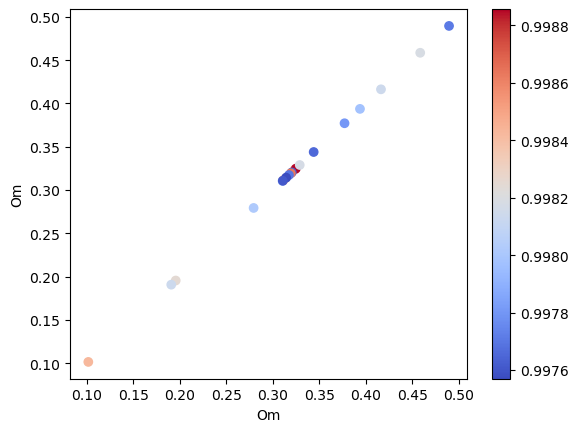

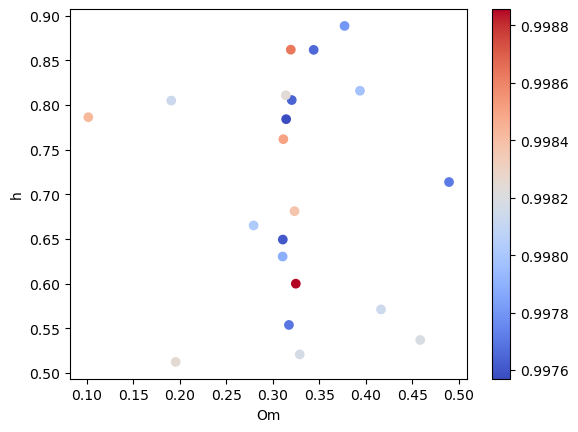

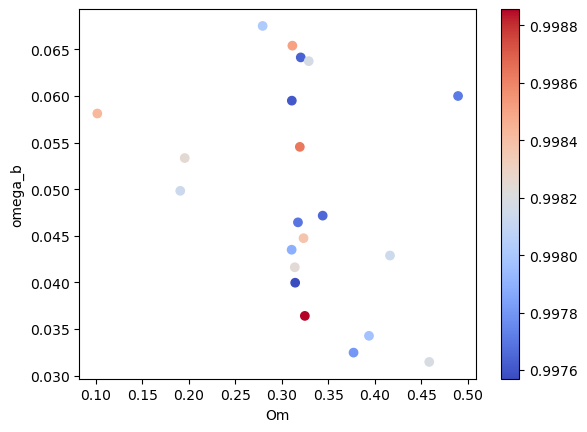

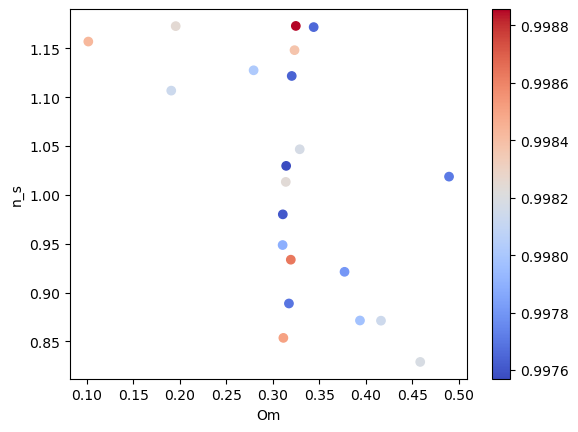

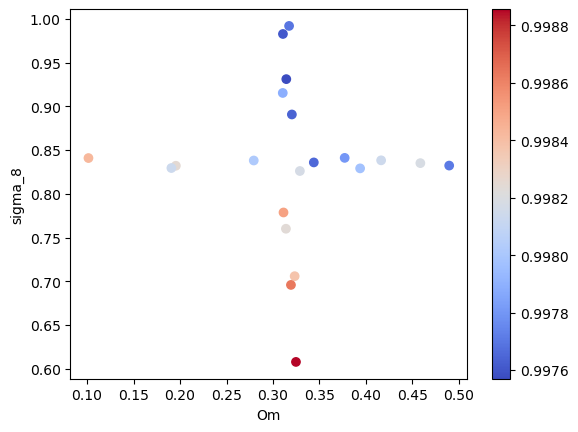

...

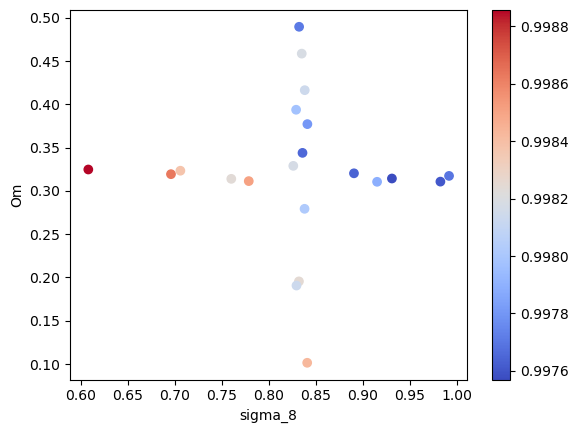

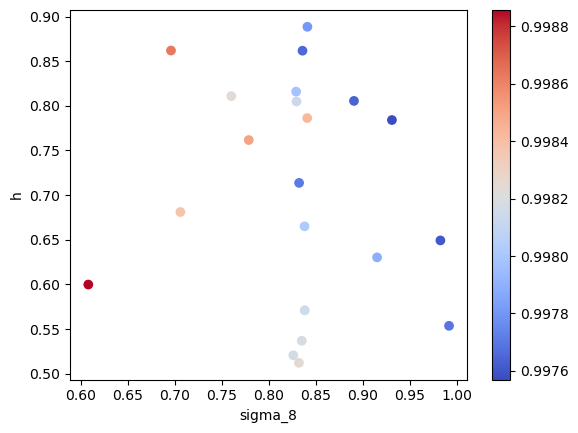

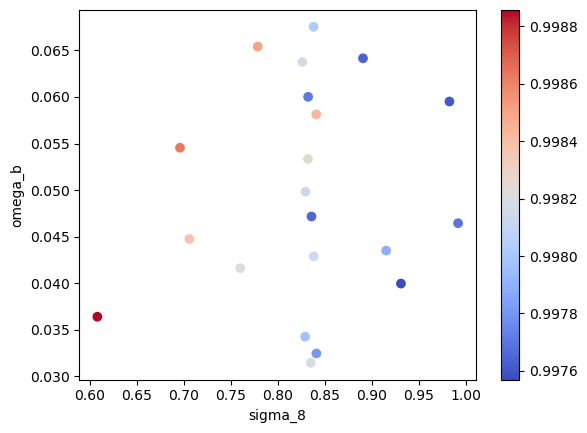

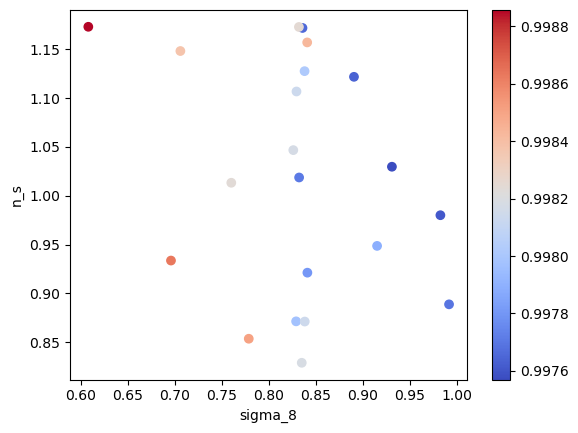

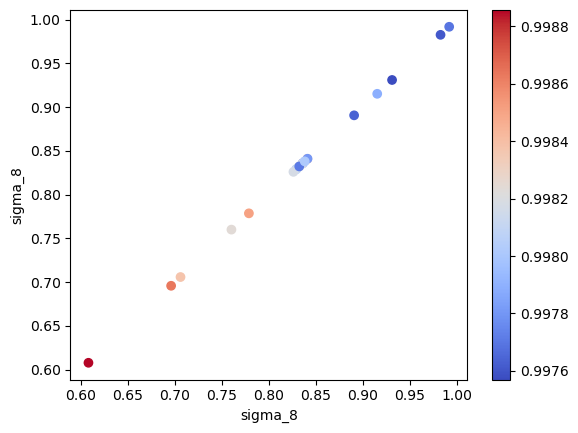

In [65]:
param_names = ["Om", "h", "omega_b", "n_s", "sigma_8"]


def read_sim_params2(lh_num, arg):
    df = pd.read_csv("../../../LH_data/"+str(lh_num)+"_sim_params_full")
    params=[]
    return list(df[arg])[0]

for p in param_names:
    temp_list1 = []
    for lh_num in LH_NUMS: temp_list1.append(read_sim_params2(lh_num, p))
    for p2 in param_names:
        temp_list2 = []
        for lh_num in LH_NUMS: temp_list2.append(read_sim_params2(lh_num, p2))
        plt.figure()
        plt.xlabel(p)
        plt.ylabel(p2)
        plt.scatter(temp_list1, temp_list2,c=a_list,cmap=CMAP)
        plt.colorbar()

In [57]:
cosmo

/tmp/ipykernel_31183/2548758114.py:31: RuntimeWarning: invalid value encountered in true_divide
  remove_fraction = (N_emu-N_nbod)/N_emu


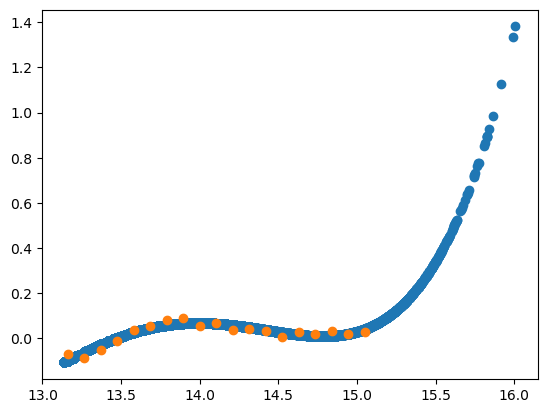

In [23]:
mass_emu_corrected, keep_args = calc_subsample(mn[npair],me[epair], num_bins=20)

/tmp/ipykernel_31183/1616639860.py:5: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(mass_range[:-1], hmfn/hmfe2,label="cor")


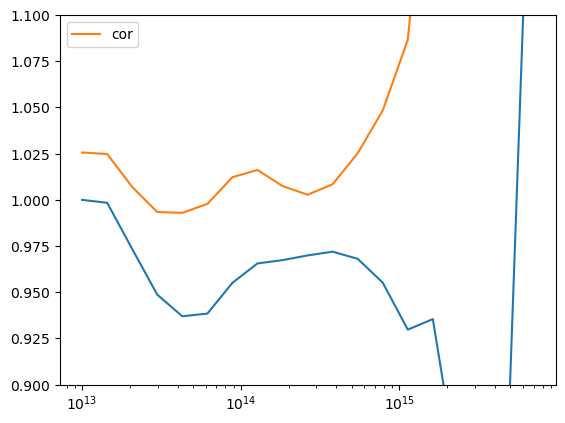

In [25]:
mass_range, hmfn = get_hmf(mn[npair])
mass_range, hmfe = get_hmf(me[epair])
mass_range, hmfe2 = get_hmf(mass_emu_corrected)
plt.plot(mass_range[:-1], hmfn/hmfe)
plt.plot(mass_range[:-1], hmfn/hmfe2,label="cor")
plt.legend()
plt.ylim(0.9, 1.1)
plt.xscale("log")

# Check density fields

In [15]:
lh_num = "325"
#cosmo, mp = get_cosmo(lh_num)
mp = 793042892492.1378
mass = np.linspace(mp, mp, 512**3)

base_dir = "../../../LH_test325/"
p = (np.load(base_dir+'325_nbody_pos.npy').T).reshape(512**3,3)
v = (np.load(base_dir+'325_nbody_vel.npy').T).reshape(512**3,3)

In [17]:
N_GRID = 256
cat = ArrayCatalog({'Position' : p,'Velocity' : v, 'Mass' : mass }, BoxSize=[1000,1000,1000])

mesh = cat.to_mesh(window='tsc', Nmesh=N_GRID)
density = mesh.preview(Nmesh = N_GRID, axes=(0,1,2))

/tmp/ipykernel_5143/3406554285.py:4: DeprecationWarning: The window argument is deprecated. Use `resampler=` instead
  mesh = cat.to_mesh(window='tsc', Nmesh=N_GRID)


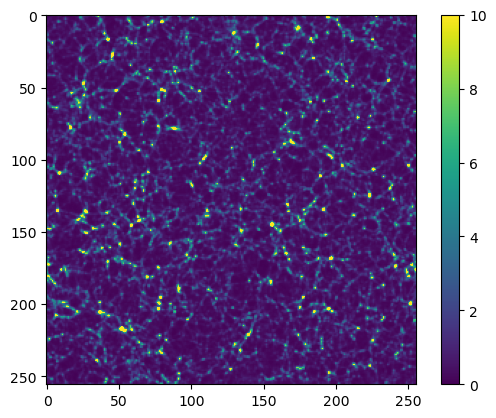

In [18]:
plt.figure()
# plt.title("Om = "+str(cosmo.Omega0_cdm+cosmo.Omega0_b))
plt.imshow(density[120],vmin=0, vmax=10)
plt.colorbar()
plt.savefig("figures/325_nbody_field.pdf")

In [27]:
lh_num = "324"
cosmo, mp = get_cosmo(lh_num)
mass = np.linspace(mp, mp, 512**3)

base_dir = "../../../LH_data/"+lh_num+"_"
# print("testing shape, should be 3,512,512,512", np.shape(np.load(base_dir+'nbody_pos.npy')))
print("Loading Nbody")
p = (np.load(base_dir+'nbody_pos.npy').T).reshape(512**3,3)
v = (np.load(base_dir+'nbody_vel.npy').T).reshape(512**3,3)
# cat = ArrayCatalog({'Position' : p,'Velocity' : v, 'Mass' : mass }, BoxSize=[1000,1000,1000])
# print("Loading emu")
# p2 = np.load(base_dir+'emu_pos.npy').reshape(3,512**3).T
# v2 = np.load(base_dir+'emu_vel.npy').reshape(3,512**3).T
# cat2 = ArrayCatalog({'Position' : p2,'Velocity' : v2, 'Mass' : mass }, BoxSize=[1000,1000,1000])

Loading Nbody


In [124]:
N_GRID = 256
mesh = cat.to_mesh(window='tsc', Nmesh=N_GRID)
density = mesh.preview(Nmesh = N_GRID, axes=(0,1,2))
mesh = cat2.to_mesh(window='tsc', Nmesh=N_GRID)
density2 = mesh.preview(Nmesh = N_GRID, axes=(0,1,2))

/tmp/ipykernel_11593/1707814871.py:2: DeprecationWarning: The window argument is deprecated. Use `resampler=` instead
  mesh = cat.to_mesh(window='tsc', Nmesh=N_GRID)
/tmp/ipykernel_11593/1707814871.py:4: DeprecationWarning: The window argument is deprecated. Use `resampler=` instead
  mesh = cat2.to_mesh(window='tsc', Nmesh=N_GRID)


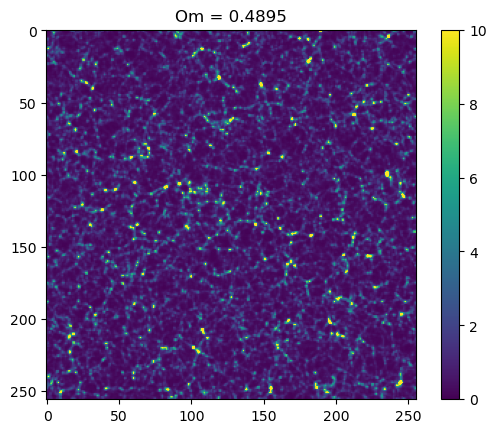

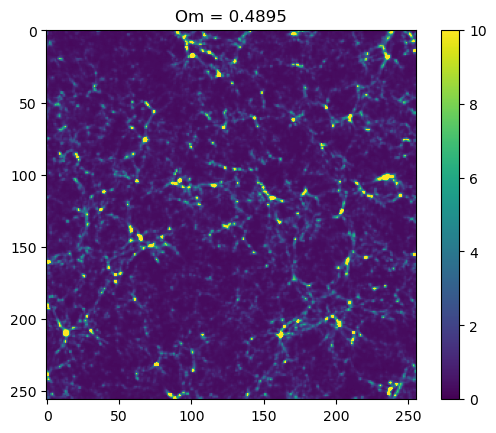

In [125]:
plt.figure()
plt.title("Om = "+str(cosmo.Omega0_cdm+cosmo.Omega0_b))
plt.imshow(density[120],vmin=0, vmax=10)
plt.colorbar()
plt.savefig("figures/nbody_field_"+str(lh_num)+".pdf")
plt.figure()
plt.title("Om = "+str(cosmo.Omega0_cdm+cosmo.Omega0_b))

plt.imshow(density2[120],vmin=0, vmax=10)
plt.colorbar()
plt.savefig("figures/emu_field_"+str(lh_num)+".pdf")

In [5]:
lh_num = "1515"
cosmo, mp = get_cosmo(lh_num)
mass = np.linspace(mp, mp, 512**3)

base_dir = "../../../LH_data/"+lh_num+"_"
print("Loading LPT")
p3 = np.load('../../../LPTDATA/LH'+str(lh_num)+'/pos_borg.npy')
p3 = (p3.reshape(3,512**3)).T
v3 = np.load('../../../LPTDATA/'+str(lh_num)+'/pvel.npy')
cat3 = ArrayCatalog({'Position' : p3,'Velocity' : v3, 'Mass' : mass }, BoxSize=[1000,1000,1000])

Loading LPT


In [6]:
N_GRID = 256
mesh3 = cat3.to_mesh(window='tsc', Nmesh=N_GRID)
density3 = mesh3.preview(Nmesh = N_GRID, axes=(0,1,2))

/tmp/ipykernel_22212/2021506087.py:2: DeprecationWarning: The window argument is deprecated. Use `resampler=` instead
  mesh3 = cat3.to_mesh(window='tsc', Nmesh=N_GRID)


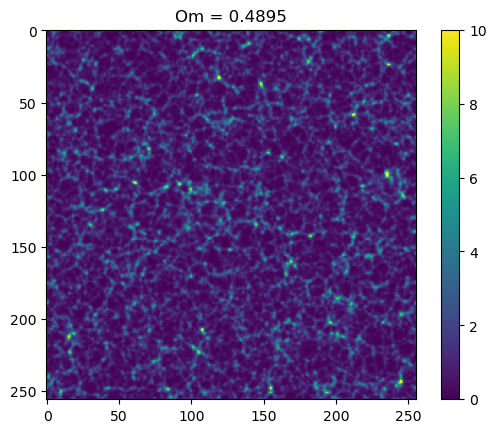

In [8]:
plt.figure()
plt.title("Om = "+str(cosmo.Omega0_cdm+cosmo.Omega0_b))
plt.imshow(density3[120],vmin=0, vmax=10)
plt.colorbar()
plt.savefig("figures/BorgLPT_field_"+str(lh_num)+".pdf")

# Calculating displacements from 2LPT inputs

In [1]:
import numpy as np

In [24]:
np.mean(vel[0])

-0.06098995

In [20]:
pos = np.load("LtU-selected/pos_emu.npy")
vel = np.load("LtU-selected/vel_emu.npy")
# print(np.shape(pos))
# pos

In [26]:
np.min(vel)

-7485.0137

In [21]:
np.std(vel)

379.3415

In [14]:
pos[0][0]

array([[3.2034674e+00, 3.5627625e+00, 3.3199947e+00, ..., 1.0077686e+00,
        2.0478926e+00, 2.1886160e+00],
       [3.3595326e+00, 3.4588747e+00, 3.3842926e+00, ..., 2.1924510e+00,
        2.7431524e+00, 3.6499751e+00],
       [2.4533844e+00, 3.3524201e+00, 3.4881783e+00, ..., 2.7735798e+00,
        3.3356972e+00, 3.6806695e+00],
       ...,
       [9.9849548e+02, 9.9880176e+02, 9.9884576e+02, ..., 9.9695422e+02,
        9.9667773e+02, 9.9687360e+02],
       [9.9962805e+02, 4.5425203e-01, 7.6348889e-01, ..., 9.9676715e+02,
        9.9689630e+02, 9.9808527e+02],
       [2.4218888e+00, 3.9601371e+00, 3.7957425e+00, ..., 9.9927325e+02,
        9.9988306e+02, 9.6663934e-01]], dtype=float32)

In [9]:
#OLD
# dx = 1000/512.0
# dxh = dx/2.0
# a = 512
# a = np.linspace(0,1000-dx,512)
# b = np.meshgrid( a, a, a )
# grid = np.vstack(list(map(np.ravel,b))).T
# xg,yg, zg = grid.T[1], grid.T[0], grid.T[2] 

# grid_array = np.array([xg,yg,zg])
# g = grid_array.reshape(3,512,512,512)

In [15]:
d = p-g
d[np.where(d>500)] -= 1000
d[np.where(d<-500)] += 1000

In [19]:
np.std(d)

7.063766035066132

In [10]:
dx = 1000/512.0
dxh = dx/2.0
a = 512
g = np.linspace(0,1000-dx,512)
g = np.vstack(list(map(np.ravel,np.meshgrid( g,g,g ))))
#grid_array = np.array([g[1], g[0], g[2]])
grid_array = np.array([g[1], g[0], g[2]])
g = grid_array.reshape(3,512,512,512)
g

array([[[[  0.      ,   0.      ,   0.      , ...,   0.      ,
            0.      ,   0.      ],
         [  0.      ,   0.      ,   0.      , ...,   0.      ,
            0.      ,   0.      ],
         [  0.      ,   0.      ,   0.      , ...,   0.      ,
            0.      ,   0.      ],
         ...,
         [  0.      ,   0.      ,   0.      , ...,   0.      ,
            0.      ,   0.      ],
         [  0.      ,   0.      ,   0.      , ...,   0.      ,
            0.      ,   0.      ],
         [  0.      ,   0.      ,   0.      , ...,   0.      ,
            0.      ,   0.      ]],

        [[  1.953125,   1.953125,   1.953125, ...,   1.953125,
            1.953125,   1.953125],
         [  1.953125,   1.953125,   1.953125, ...,   1.953125,
            1.953125,   1.953125],
         [  1.953125,   1.953125,   1.953125, ...,   1.953125,
            1.953125,   1.953125],
         ...,
         [  1.953125,   1.953125,   1.953125, ...,   1.953125,
            1.953125,   1

In [11]:
import glob
p_files = glob.iglob("../../../LPTDATA/LH1515/*.npy")
for p_file in p_files:
    lh_num = p_file.split("/")[-2]
    print("calculating displace for lhnum, ", lh_num)
    p= (np.load(p_file).T).reshape(3,512,512,512)
    d = p-g
    d[np.where(d>500)] -= 1000
    d[np.where(d<-500)] += 1000
    print("mean d", np.mean(d))
    np.save('../../../LPTDATA/'+str(lh_num)+'/dis_in.npy',d)


# Correct outputs for periodic boundary conditions and move them. Move vel files too

In [6]:
dx = 1000/512.0
dxh = dx/2.0
a = 512
a = np.linspace(0,1000-dx,512)
b = np.meshgrid( a, a, a )
grid = np.vstack(list(map(np.ravel,b))).T
xg,yg, zg = grid.T[1], grid.T[0], grid.T[2] 

grid_array = np.array([xg,yg,zg])
g = grid_array.reshape(3,512,512,512)

In [7]:
p_files = glob.iglob("../../../LPTDATA/*/dis_out.npy")
for p_file in p_files:
    lh_num = p_file.split("/")[-2]
    print("adjusting pos for lhnum, ", lh_num)
    p = np.load(p_file)
    new_p = p+g
    new_p[new_p >1000] -= 1000
    new_p[new_p <0] += 1000
    print("mean d", np.mean(new_p))
#     np.save("../../../LPTDATA/LH1515/pos_borg.npy",new_p)

    np.save('../../../LH_data/'+str(lh_num)+'_emu_pos.npy',new_p)
    

adjusting pos for lhnum,  592
mean d 498.8990149341651
adjusting pos for lhnum,  1515
mean d 499.70864751445424
adjusting pos for lhnum,  406
mean d 500.2636372638246
adjusting pos for lhnum,  926
mean d 499.6513513067161
adjusting pos for lhnum,  1608
mean d 498.93984228262576
adjusting pos for lhnum,  694
mean d 499.97338748221824
adjusting pos for lhnum,  1582
mean d 500.67458280698446
adjusting pos for lhnum,  1696
mean d 500.2344342178551
adjusting pos for lhnum,  391
mean d 499.2214728775435
adjusting pos for lhnum,  401
mean d 508.09938380949797
adjusting pos for lhnum,  485
mean d 500.0976368490651
adjusting pos for lhnum,  1951
mean d 500.4654707951156
adjusting pos for lhnum,  1702
mean d 500.26464988743805
adjusting pos for lhnum,  502
mean d 499.5260706352257
adjusting pos for lhnum,  444
mean d 499.0979366182403
adjusting pos for lhnum,  1710
mean d 499.45840296460966
adjusting pos for lhnum,  944
mean d 499.8525075250622
adjusting pos for lhnum,  324
mean d 499.5261760747

In [8]:
v_files = glob.iglob("../../../LPTDATA/*/vel_out.npy")
for v_file in v_files:
    lh_num = v_file.split("/")[-2]
    print("moving vel for lhnum, ", lh_num)
    print("mean vel", np.mean(np.load(v_file)))
    shutil.move(v_file, "../../../LH_data/"+lh_num+"_emu_vel.npy")

moving vel for lhnum,  592
mean vel 0.10106335
moving vel for lhnum,  1515
mean vel -0.003039499
moving vel for lhnum,  406
mean vel 0.1455548
moving vel for lhnum,  926
mean vel 0.13023196
moving vel for lhnum,  1608
mean vel 0.099151395
moving vel for lhnum,  694
mean vel 0.07133789
moving vel for lhnum,  1582
mean vel 0.11444295
moving vel for lhnum,  1696
mean vel 0.11698141
moving vel for lhnum,  391
mean vel 0.16340238
moving vel for lhnum,  401
mean vel 0.27940333
moving vel for lhnum,  485
mean vel 0.10584403
moving vel for lhnum,  1951
mean vel 0.18171285
moving vel for lhnum,  1702
mean vel 0.19598894
moving vel for lhnum,  502
mean vel 0.13535883
moving vel for lhnum,  444
mean vel 0.14505397
moving vel for lhnum,  1710
mean vel 0.11041561
moving vel for lhnum,  944
mean vel 0.11920283
moving vel for lhnum,  324
mean vel 0.15892002


# FOF code

In [4]:
pos_file = "LtU-selected/pos_emu.npy"
vel_file = "LtU-selected/vel_emu.npy"
savename = "fof_halos/lh0000_emu_ll20"


run_FOF(pos_file, vel_file, savename)

KeyboardInterrupt: 

# FOF Halo pairing by particle ID

In [6]:
savename = "pair_files/fof_pair_candidates"
gen_fof_pair_cands(savename)

Working on Nbody pairs
progress:  0.0 %
progress:  2.586191290224973 %
progress:  5.172382580449946 %
progress:  7.758573870674918 %
progress:  10.344765160899891 %
progress:  12.930956451124864 %
progress:  15.517147741349836 %
progress:  18.10333903157481 %
progress:  20.689530321799783 %
progress:  23.275721612024753 %
progress:  25.861912902249728 %
progress:  28.448104192474702 %
progress:  31.034295482699672 %
progress:  33.62048677292464 %
progress:  36.20667806314962 %
progress:  38.79286935337459 %
progress:  41.379060643599566 %
progress:  43.96525193382454 %
progress:  46.55144322404951 %
progress:  49.13763451427448 %
progress:  51.723825804499455 %
progress:  54.31001709472443 %
progress:  56.896208384949404 %
progress:  59.48239967517437 %
progress:  62.068590965399345 %
progress:  64.65478225562433 %
progress:  67.24097354584929 %
progress:  69.82716483607426 %
progress:  72.41335612629923 %
progress:  74.99954741652421 %
progress:  77.58573870674918 %
progress:  80.1719

In [8]:

cand_file = "pair_files/fof_pair_candidates"
savename = "pair_files/fof_pairs_by_particle"
cross_check_pairs_by_particle(savename, cand_file, fof=True) 
savename = "pair_files/fof_pairs_by_mass"
cross_check_pairs_by_mass(savename, cand_file, fof=True)

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


working on mutual pairs
working on other pairs


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


progress:  0.0 %
progress:  2.7164464534075106 %
progress:  5.432892906815021 %
progress:  8.149339360222532 %
progress:  10.865785813630042 %
progress:  13.582232267037552 %
progress:  16.298678720445064 %
progress:  19.015125173852574 %
progress:  21.731571627260085 %
progress:  24.448018080667595 %
progress:  27.164464534075105 %
progress:  29.880910987482615 %
progress:  32.59735744089013 %
progress:  35.313803894297635 %
progress:  38.03025034770515 %
progress:  40.746696801112655 %
progress:  43.46314325452017 %
progress:  46.179589707927676 %
progress:  48.89603616133519 %
progress:  51.612482614742696 %
progress:  54.32892906815021 %
progress:  57.045375521557716 %
progress:  59.76182197496523 %
progress:  62.47826842837274 %
progress:  65.19471488178026 %
progress:  67.91116133518776 %
progress:  70.62760778859527 %
progress:  73.34405424200278 %
progress:  76.0605006954103 %
progress:  78.7769471488178 %
progress:  81.49339360222531 %
progress:  84.20984005563282 %
progress: 

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/c

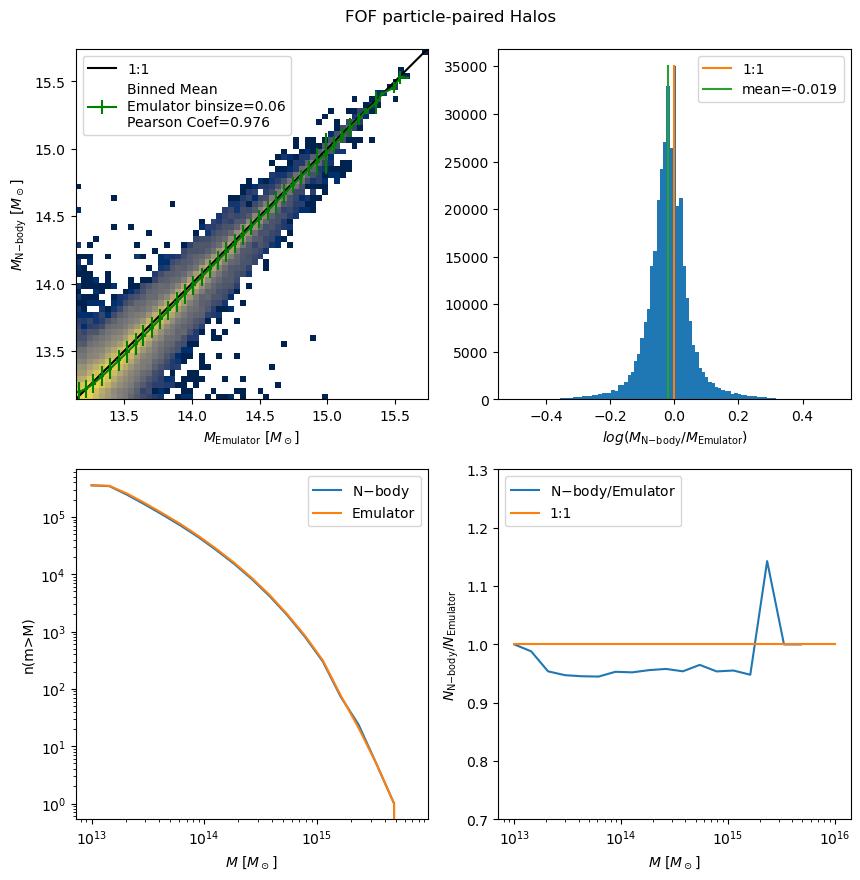

In [31]:
pair_file = "pair_files/fof_pairs_by_particle"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, nbody_pairless_mass,emu_pairless_mass, nbody_stolen_mass,emu_stolen_mass = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos

title = "FOF particle-paired Halos"
savename = -1
plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename,title)

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/c

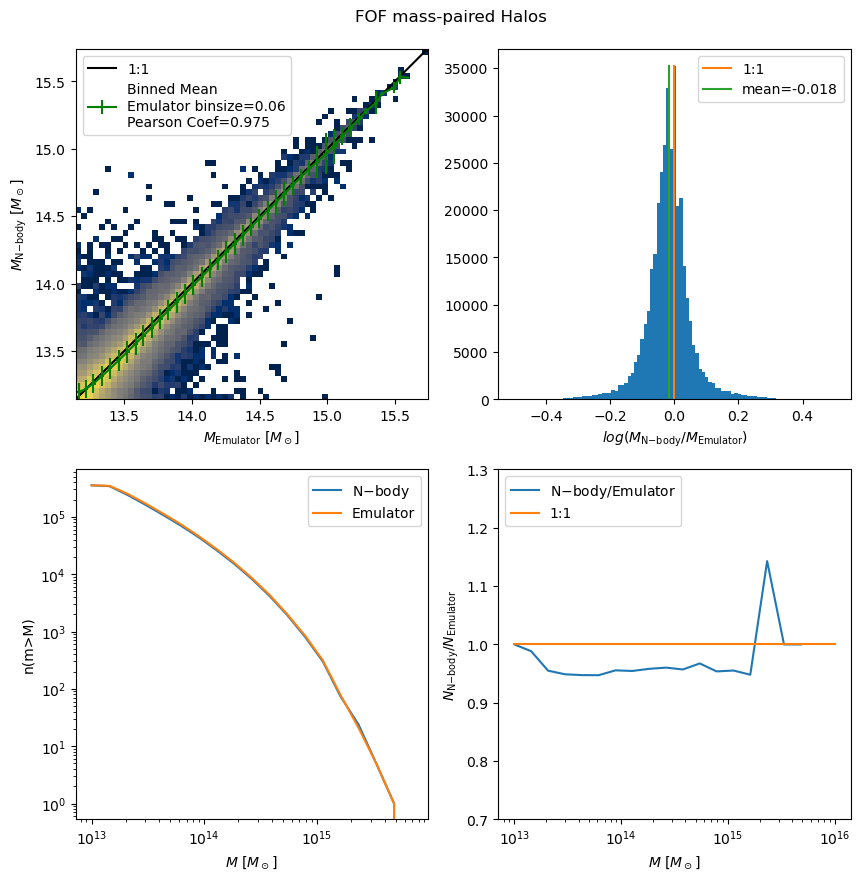

In [32]:
pair_file = "pair_files/fof_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, nbody_pairless_mass,emu_pairless_mass, nbody_stolen_mass,emu_stolen_mass = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos

title = "FOF mass-paired Halos"
savename = -1
plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename,title)

# RS Halo pairing by particle ID

In [18]:
fname_emu = "particle_test_emu/halos_0.0.particles"
fname_nbody = "particle_test_nbody/halos_0.0.particles"
savename = "pair_files/rs_pair_candidates"
gen_rs_pair_cands(fname_emu, fname_nbody,savename)

Working on Nbody pairs
progress:  0.0 %
progress:  0.019569356735674743 %
progress:  0.039138713471349486 %
progress:  0.058708070207024225 %
progress:  0.07827742694269897 %
progress:  0.09784678367837371 %
progress:  0.11741614041404845 %
progress:  0.1369854971497232 %
progress:  0.15655485388539794 %
progress:  0.17612421062107267 %
progress:  0.19569356735674742 %
progress:  0.21526292409242215 %
progress:  0.2348322808280969 %
progress:  0.25440163756377165 %
progress:  0.2739709942994464 %
progress:  0.2935403510351211 %
progress:  0.3131097077707959 %
progress:  0.3326790645064706 %
progress:  0.35224842124214534 %
progress:  0.3718177779778201 %
progress:  0.39138713471349484 %
progress:  0.41095649144916957 %
progress:  0.4305258481848443 %
progress:  0.4500952049205191 %
progress:  0.4696645616561938 %
progress:  0.4892339183918685 %
progress:  0.5088032751275433 %
progress:  0.528372631863218 %
progress:  0.5479419885988928 %
progress:  0.5675113453345675 %
progress:  0.587

In [5]:
cand_file = "pair_files/rs_pair_candidates"
savename = "pair_files/rs_pairs_by_particle"
cross_check_pairs_by_particle(savename, cand_file, fof=False) 
savename = "pair_files/rs_pairs_by_mass"
cross_check_pairs_by_mass(savename, cand_file, fof=False)

yt : [INFO     ] 2023-08-11 02:07:16,245 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-11 02:07:16,246 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-11 02:07:16,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-11 02:07:16,247 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-11 02:07:16,248 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-11 02:07:16,248 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-11 02:07:16,249 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-11 02:07:16,249 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-11 02:07:16,249 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-11 02:07:16,249 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-11 02:07:16,300 Parameters: current

working on mutual pairs
working on other pairs


yt : [INFO     ] 2023-08-11 02:08:27,178 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-11 02:08:27,179 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-11 02:08:27,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-11 02:08:27,180 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-11 02:08:27,181 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-11 02:08:27,181 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-11 02:08:27,182 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-11 02:08:27,182 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-11 02:08:27,183 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-11 02:08:27,183 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-11 02:08:27,220 Parameters: current

progress:  0.0 %
progress:  2.055883012033083 %
progress:  4.111766024066166 %
progress:  6.16764903609925 %
progress:  8.223532048132332 %
progress:  10.279415060165416 %
progress:  12.3352980721985 %
progress:  14.391181084231583 %
progress:  16.447064096264665 %
progress:  18.50294710829775 %
progress:  20.558830120330832 %
progress:  22.614713132363917 %
progress:  24.670596144397 %
progress:  26.72647915643008 %
progress:  28.782362168463166 %
progress:  30.838245180496248 %
progress:  32.89412819252933 %
progress:  34.950011204562415 %
progress:  37.0058942165955 %
progress:  39.061777228628586 %
progress:  41.117660240661664 %
progress:  43.17354325269475 %
progress:  45.229426264727834 %
progress:  47.28530927676091 %
progress:  49.341192288794 %
progress:  51.39707530082708 %
progress:  55.50884132489325 %
progress:  57.56472433692633 %
progress:  59.62060734895942 %
progress:  61.676490360992496 %
progress:  63.73237337302558 %
progress:  67.84413939709175 %
progress:  69.900

yt : [INFO     ] 2023-08-11 03:26:39,062 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-11 03:26:39,063 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-11 03:26:39,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-11 03:26:39,064 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-11 03:26:39,064 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-11 03:26:39,065 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-11 03:26:39,065 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-11 03:26:39,065 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-11 03:26:39,066 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-11 03:26:39,066 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-11 03:26:39,102 Parameters: current

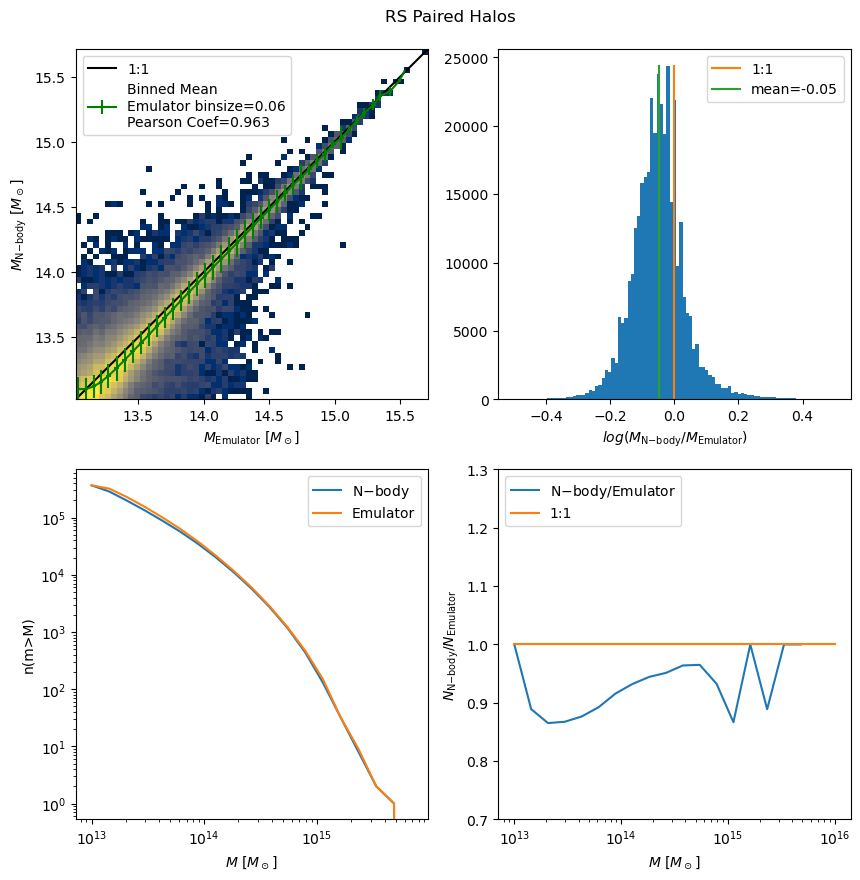

In [26]:
pair_file = "pair_files/rs_pairs_by_particle"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, nbody_pairless_mass,emu_pairless_mass, nbody_stolen_mass,emu_stolen_mass = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos

title = "RS Paired Halos"
savename = -1
plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename,title)

yt : [INFO     ] 2023-08-11 03:37:42,752 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-11 03:37:42,753 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-11 03:37:42,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-11 03:37:42,755 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-11 03:37:42,755 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-11 03:37:42,765 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-11 03:37:42,765 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-11 03:37:42,766 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-11 03:37:42,766 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-11 03:37:42,767 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-11 03:37:42,802 Parameters: current

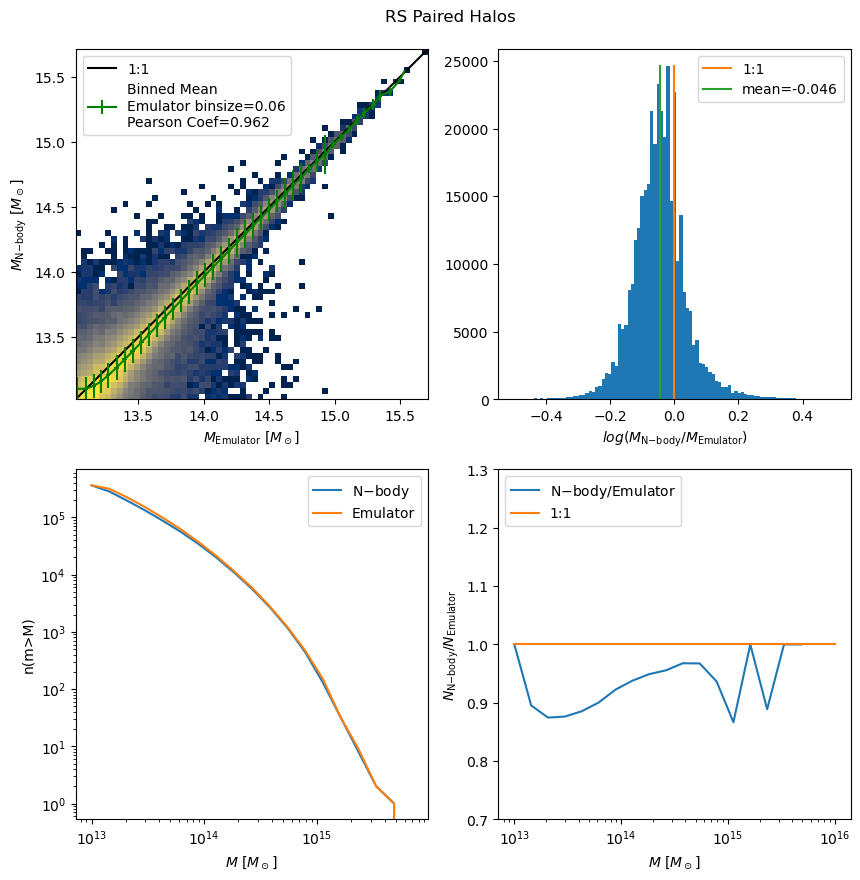

In [36]:
pair_file = "pair_files/rs_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_nbod = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos

title = "RS Paired Halos"
savename = -1
plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename,title)

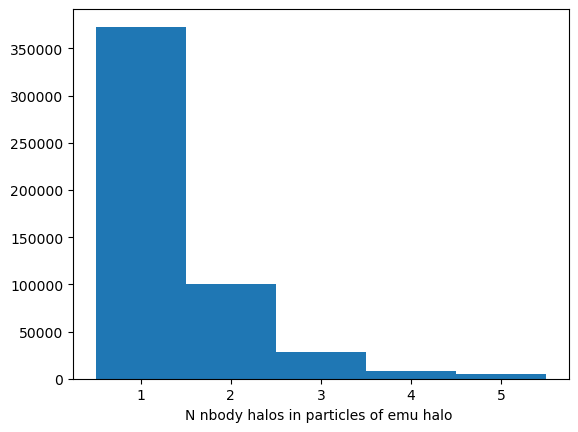

In [38]:
df = pd.read_csv("rs_pairs_full_emu_base")
b,t,f = np.array(df["base_ids2"]).astype(int),np.array(df["target_ids2"]),np.array(df["frac2"])
bins = np.bincount(b)
plt.hist(bins, bins = np.linspace(0.5,5.5,6))
plt.xlabel("N nbody halos in particles of emu halo ")
plt.savefig("figures/N_particle_overlap2.pdf", bbox_inches="tight")

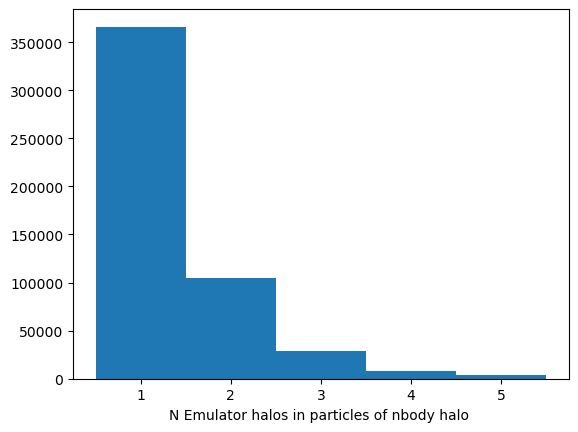

In [35]:
df = pd.read_csv("rs_pairs_full_nbod_base")
b,t,f = np.array(df["base_ids1"]).astype(int),np.array(df["target_ids1"]),np.array(df["frac1"])
bins = np.bincount(b)
plt.hist(bins, bins = np.linspace(0.5,5.5,6))
plt.xlabel("N Emulator halos in particles of nbody halo ")
plt.savefig("figures/N_particle_overlap.pdf", bbox_inches="tight")

yt : [INFO     ] 2023-08-11 03:52:07,866 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-11 03:52:07,867 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-11 03:52:07,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-11 03:52:07,869 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-11 03:52:07,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-11 03:52:07,869 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-11 03:52:07,870 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-11 03:52:07,870 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-11 03:52:07,871 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-11 03:52:07,871 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-11 03:52:07,905 Parameters: current

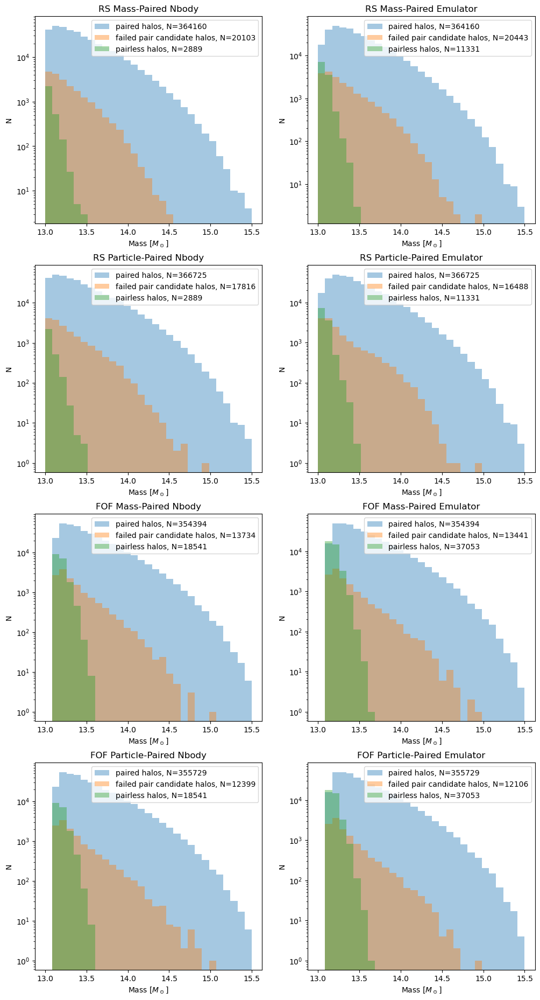

In [47]:


alpha=0.4
fig,axs = plt.subplots(4,2,figsize=(12,24))
bins = np.linspace(13,15.5,30)

pair_file = "pair_files/rs_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos


a,b=0,0
axs[a,b].set_title("RS Mass-Paired Nbody")
axs[a,b].hist(np.log10(mass_paired_nbod), label="paired halos, N="+str(len(mass_paired_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_nbod), label="failed pair candidate halos, N="+str(len(mass_stolen_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_nbod), label="pairless halos, N="+str(len(mass_pairless_nbod)),bins=bins,alpha=alpha)



a,b=0,1
axs[a,b].set_title("RS Mass-Paired Emulator")
axs[a,b].hist(np.log10(mass_paired_emu), label="paired halos, N="+str(len(mass_paired_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_emu), label="failed pair candidate halos, N="+str(len(mass_stolen_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_emu), label="pairless halos, N="+str(len(mass_pairless_emu)),bins=bins,alpha=alpha)



pair_file = "pair_files/rs_pairs_by_particle"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos

a,b=1,0
axs[a,b].set_title("RS Particle-Paired Nbody")
axs[a,b].hist(np.log10(mass_paired_nbod), label="paired halos, N="+str(len(mass_paired_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_nbod), label="failed pair candidate halos, N="+str(len(mass_stolen_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_nbod), label="pairless halos, N="+str(len(mass_pairless_nbod)),bins=bins,alpha=alpha)



a,b=1,1
axs[a,b].set_title("RS Particle-Paired Emulator")
axs[a,b].hist(np.log10(mass_paired_emu), label="paired halos, N="+str(len(mass_paired_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_emu), label="failed pair candidate halos, N="+str(len(mass_stolen_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_emu), label="pairless halos, N="+str(len(mass_pairless_emu)),bins=bins,alpha=alpha)





pair_file = "pair_files/fof_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos


a,b=2,0
axs[a,b].set_title("FOF Mass-Paired Nbody")
axs[a,b].hist(np.log10(mass_paired_nbod), label="paired halos, N="+str(len(mass_paired_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_nbod), label="failed pair candidate halos, N="+str(len(mass_stolen_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_nbod), label="pairless halos, N="+str(len(mass_pairless_nbod)),bins=bins,alpha=alpha)



a,b=2,1
axs[a,b].set_title("FOF Mass-Paired Emulator")
axs[a,b].hist(np.log10(mass_paired_emu), label="paired halos, N="+str(len(mass_paired_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_emu), label="failed pair candidate halos, N="+str(len(mass_stolen_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_emu), label="pairless halos, N="+str(len(mass_pairless_emu)),bins=bins,alpha=alpha)



pair_file = "pair_files/fof_pairs_by_particle"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos

a,b=3,0
axs[a,b].set_title("FOF Particle-Paired Nbody")
axs[a,b].hist(np.log10(mass_paired_nbod), label="paired halos, N="+str(len(mass_paired_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_nbod), label="failed pair candidate halos, N="+str(len(mass_stolen_nbod)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_nbod), label="pairless halos, N="+str(len(mass_pairless_nbod)),bins=bins,alpha=alpha)



a,b=3,1
axs[a,b].set_title("FOF Particle-Paired Emulator")
axs[a,b].hist(np.log10(mass_paired_emu), label="paired halos, N="+str(len(mass_paired_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_stolen_emu), label="failed pair candidate halos, N="+str(len(mass_stolen_emu)),bins=bins,alpha=alpha)
axs[a,b].hist(np.log10(mass_pairless_emu), label="pairless halos, N="+str(len(mass_pairless_emu)),bins=bins,alpha=alpha)










for a in range(4):
    for b in range(2):
        axs[a,b].legend()
        axs[a,b].set_xlabel(r"Mass $[M_\odot]$")
        axs[a,b].set_ylabel("N")
        axs[a,b].set_yscale("log")
plt.savefig("figures/pair_method_comparison.pdf", bbox_inches="tight")


# Comparing local density with halo types

In [4]:
pos_file = "LtU-selected/pos_emu.npy"
vel_file = "LtU-selected/vel_emu.npy"


pos_particle_nbody = np.load(pos_file)
vel_particle_nbody = np.load(vel_file)
vel_particle_nbody = np.reshape(vel_particle_nbody,(3,512**3)).T
pos_particle_nbody = np.reshape(pos_particle_nbody,(3,512**3)).T
cosmo = cosmology.Planck15

mass_per_particle = 6.565293600596489e11 #msun/h
mass = np.linspace(mass_per_particle, mass_per_particle, len(pos_particle_nbody))

cat = ArrayCatalog({'Position' : pos_particle_nbody,'Velocity' : vel_particle_nbody, 'Mass' : mass }, BoxSize=[1000,1000,1000])


In [10]:
N_GRID = 1000
mesh = cat.to_mesh(window='tsc', Nmesh=N_GRID)
one_plus_delta = mesh.paint(mode='real')


/tmp/ipykernel_74846/1139706229.py:2: DeprecationWarning: The window argument is deprecated. Use `resampler=` instead
  mesh = cat.to_mesh(window='tsc', Nmesh=N_GRID)


yt : [INFO     ] 2023-08-12 00:21:19,034 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-12 00:21:19,035 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-12 00:21:19,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-12 00:21:19,036 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-12 00:21:19,036 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-12 00:21:19,037 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-12 00:21:19,037 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-12 00:21:19,037 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-12 00:21:19,037 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-12 00:21:19,037 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-12 00:21:19,075 Parameters: current

500 500


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


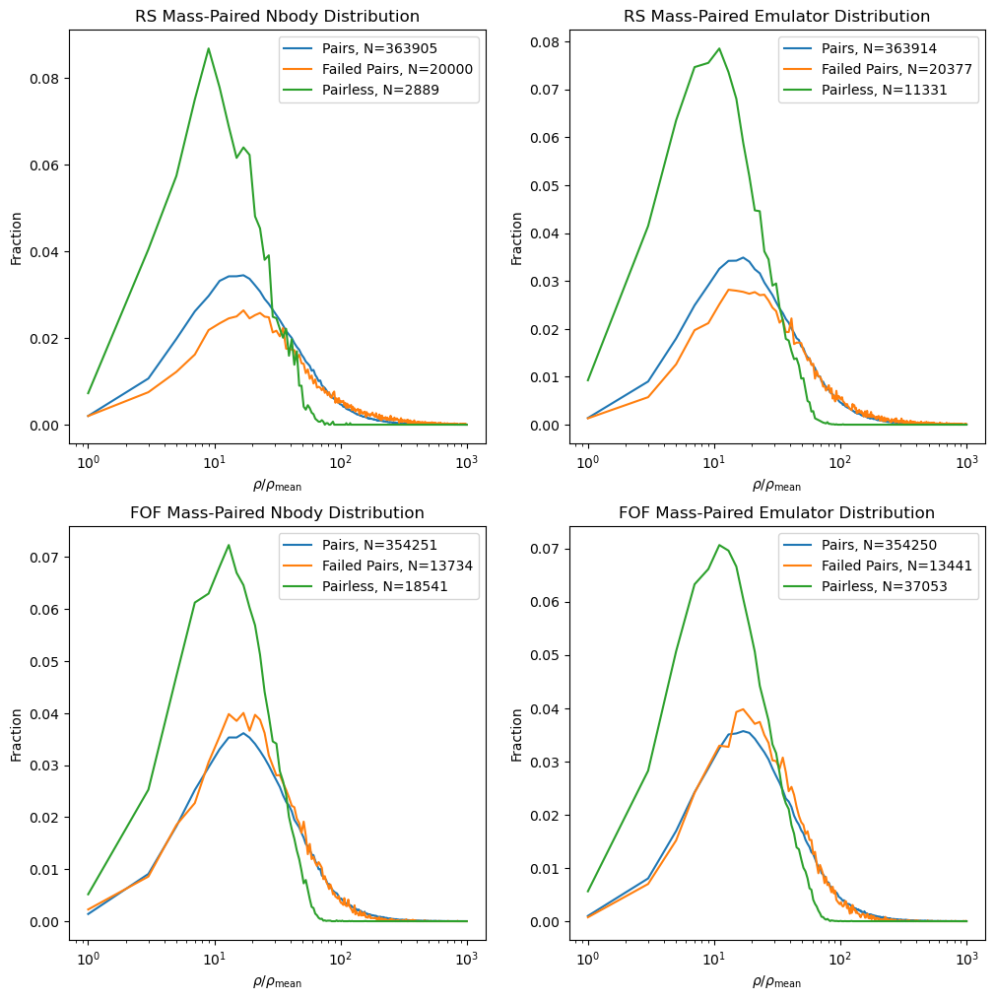

In [21]:

bins = np.linspace(0,1000,501)
bin_mean = (bins[1:] + bins[:-1])/2

alpha=0.4
fig,axs = plt.subplots(2,2,figsize=(12,12))

pair_file = "pair_files/rs_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos




paired_indices = np.floor(pos_paired_nbod).astype(int)
pairless_indices = np.floor(pos_pairless_nbod).astype(int)
stolen_indices = np.floor(pos_stolen_nbod).astype(int)
delta_paired = one_plus_delta[paired_indices.T[0], paired_indices.T[1], paired_indices.T[2]]
delta_pairless = one_plus_delta[pairless_indices.T[0], pairless_indices.T[1], pairless_indices.T[2]]
delta_stolen = one_plus_delta[stolen_indices.T[0], stolen_indices.T[1], stolen_indices.T[2]]

N_paired = [np.size(np.where((bins[x]<=delta_paired) & (delta_paired< bins[x+1]))) for x in range(len(bins)-1)]
N_stolen = [np.size(np.where((bins[x]<=delta_stolen) & (delta_stolen< bins[x+1]))) for x in range(len(bins)-1)]
N_pairless = [np.size(np.where((bins[x]<=delta_pairless) & (delta_pairless< bins[x+1]))) for x in range(len(bins)-1)]

a,b=0,0
print(len(N_paired), len(bin_mean))
axs[a,b].set_title("RS Mass-Paired Nbody Distribution")
axs[a,b].plot(bin_mean, N_paired/np.sum(N_paired), label="Pairs, N="+str(np.sum(N_paired)))
axs[a,b].plot(bin_mean, N_stolen/np.sum(N_stolen), label="Failed Pairs, N="+str(np.sum(N_stolen)))
axs[a,b].plot(bin_mean, N_pairless/np.sum(N_pairless), label="Pairless, N="+str(np.sum(N_pairless)))






paired_indices = np.floor(pos_paired_emu).astype(int)
pairless_indices = np.floor(pos_pairless_emu).astype(int)
stolen_indices = np.floor(pos_stolen_emu).astype(int)
delta_paired = one_plus_delta[paired_indices.T[0], paired_indices.T[1], paired_indices.T[2]]
delta_pairless = one_plus_delta[pairless_indices.T[0], pairless_indices.T[1], pairless_indices.T[2]]
delta_stolen = one_plus_delta[stolen_indices.T[0], stolen_indices.T[1], stolen_indices.T[2]]

N_paired = [np.size(np.where((bins[x]<=delta_paired) & (delta_paired< bins[x+1]))) for x in range(len(bins)-1)]
N_stolen = [np.size(np.where((bins[x]<=delta_stolen) & (delta_stolen< bins[x+1]))) for x in range(len(bins)-1)]
N_pairless = [np.size(np.where((bins[x]<=delta_pairless) & (delta_pairless< bins[x+1]))) for x in range(len(bins)-1)]

a,b=0,1
axs[a,b].set_title("RS Mass-Paired Emulator Distribution")
axs[a,b].plot(bin_mean, N_paired/np.sum(N_paired), label="Pairs, N="+str(np.sum(N_paired)))
axs[a,b].plot(bin_mean, N_stolen/np.sum(N_stolen), label="Failed Pairs, N="+str(np.sum(N_stolen)))
axs[a,b].plot(bin_mean, N_pairless/np.sum(N_pairless), label="Pairless, N="+str(np.sum(N_pairless)))











pair_file = "pair_files/fof_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos




paired_indices = np.floor(pos_paired_nbod).astype(int)
pairless_indices = np.floor(pos_pairless_nbod).astype(int)
stolen_indices = np.floor(pos_stolen_nbod).astype(int)
delta_paired = one_plus_delta[paired_indices.T[0], paired_indices.T[1], paired_indices.T[2]]
delta_pairless = one_plus_delta[pairless_indices.T[0], pairless_indices.T[1], pairless_indices.T[2]]
delta_stolen = one_plus_delta[stolen_indices.T[0], stolen_indices.T[1], stolen_indices.T[2]]

N_paired = [np.size(np.where((bins[x]<=delta_paired) & (delta_paired< bins[x+1]))) for x in range(len(bins)-1)]
N_stolen = [np.size(np.where((bins[x]<=delta_stolen) & (delta_stolen< bins[x+1]))) for x in range(len(bins)-1)]
N_pairless = [np.size(np.where((bins[x]<=delta_pairless) & (delta_pairless< bins[x+1]))) for x in range(len(bins)-1)]

a,b=1,0
axs[a,b].set_title("FOF Mass-Paired Nbody Distribution")
axs[a,b].plot(bin_mean, N_paired/np.sum(N_paired), label="Pairs, N="+str(np.sum(N_paired)))
axs[a,b].plot(bin_mean, N_stolen/np.sum(N_stolen), label="Failed Pairs, N="+str(np.sum(N_stolen)))
axs[a,b].plot(bin_mean, N_pairless/np.sum(N_pairless), label="Pairless, N="+str(np.sum(N_pairless)))






paired_indices = np.floor(pos_paired_emu).astype(int)
pairless_indices = np.floor(pos_pairless_emu).astype(int)
stolen_indices = np.floor(pos_stolen_emu).astype(int)
delta_paired = one_plus_delta[paired_indices.T[0], paired_indices.T[1], paired_indices.T[2]]
delta_pairless = one_plus_delta[pairless_indices.T[0], pairless_indices.T[1], pairless_indices.T[2]]
delta_stolen = one_plus_delta[stolen_indices.T[0], stolen_indices.T[1], stolen_indices.T[2]]

N_paired = [np.size(np.where((bins[x]<=delta_paired) & (delta_paired< bins[x+1]))) for x in range(len(bins)-1)]
N_stolen = [np.size(np.where((bins[x]<=delta_stolen) & (delta_stolen< bins[x+1]))) for x in range(len(bins)-1)]
N_pairless = [np.size(np.where((bins[x]<=delta_pairless) & (delta_pairless< bins[x+1]))) for x in range(len(bins)-1)]

a,b=1,1
axs[a,b].set_title("FOF Mass-Paired Emulator Distribution")
axs[a,b].plot(bin_mean, N_paired/np.sum(N_paired), label="Pairs, N="+str(np.sum(N_paired)))
axs[a,b].plot(bin_mean, N_stolen/np.sum(N_stolen), label="Failed Pairs, N="+str(np.sum(N_stolen)))
axs[a,b].plot(bin_mean, N_pairless/np.sum(N_pairless), label="Pairless, N="+str(np.sum(N_pairless)))


for a in range(2):
    for b in range(2):
        axs[a,b].legend()
        axs[a,b].set_xlabel(r"$\rho/\rho_{\rm mean}$")
        axs[a,b].set_ylabel("Fraction")
        axs[a,b].set_xscale("log")
        
plt.savefig("figures/overdensity_comparison.pdf", bbox_inches="tight")

In [14]:
pair_file = "pair_files/fof_pairs_by_mass"
mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, mass_stolen_nbod,mass_stolen_emu = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu, vel_stolen_nbod,vel_stolen_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu, pos_stolen_nbod, pos_stolen_emu = pos_combos


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


In [15]:
pair_file = "pair_files/fof_pairs_by_mass"
nbody_paired_id,emu_paired_id, nbody_pairless_id, emu_pairless_id, nbody_stolen_id,emu_stolen_id = read_cross_checked_ids(pair_file)   


In [12]:
mass_stolen_emu[mass_argsort][-10:]

array([3.40738747e+14, 3.44677903e+14, 3.75534794e+14, 3.78160898e+14,
       3.81443562e+14, 4.21491850e+14, 4.45783447e+14, 4.62196664e+14,
       7.94400507e+14, 8.50862079e+14])

In [17]:
mass_argsort = np.argsort(mass_stolen_emu)
a = 1
rad_factor=2
most_massive = mass_stolen_emu[mass_argsort][-a]
pos_max_mass = pos_stolen_emu[mass_argsort][-a]
print("mass of failed candidate pair in 10^14msol\n", most_massive/1e14)
print("pos of failed candidate pair halo", pos_max_mass)
#grab all halos near this in the nbody
print()
def calc_distance(p, pos_list):
    return np.sqrt(np.sum(np.power(p-pos_list, 2),axis=1))

distances = calc_distance(pos_max_mass, pos_emu)
rvir_max = r_vir(most_massive,0)


distance_args = np.where(distances <= rvir_max*rad_factor)[0]

print("Positions of all emu halos in  2*rvir\n", pos_emu[distance_args])
print("so " +str(len(distance_args)-1)+ " other halos within the virial radius. How about in the nbody?\n\n")

distances = calc_distance(pos_max_mass, pos_nbod)
distance_args = np.where(distances <= rvir_max*rad_factor)[0]

print("position of nbody halos in 2*rvir", pos_nbod[distance_args])
print("nbody IDs", distance_args)
n_id = distance_args[0]
emu_id = emu_paired_id[np.where(nbody_paired_id == n_id)[0]]
print("emu pair id for that nbody halo", emu_id)
print()
print("position of that emu pair", pos_emu[emu_id])

print()
print("mass of that emu pair in 10^14msol", mass_emu[n_id]/1e14)
print("mass of the nbod pair in 10^14msol", mass_nbod[emu_id]/1e14)
print("mass of the failed pair candidate in 10^14msol", most_massive/1e14)

#compare find the distances between them and their pairs
#and mass comparison




mass of failed candidate pair in 10^14msol
 8.561142855177822
pos of failed candidate pair halo [523.6397 979.7513 704.7966]

Positions of all emu halos in  2*rvir
 [[523.6397  979.7513  704.7966 ]
 [526.2924  979.03284 701.2791 ]
 [522.34906 979.1819  708.15173]]
so 2 other halos within the virial radius. How about in the nbody?


position of nbody halos in 2*rvir [[521.5517 980.4767 707.3968]
 [525.8011 979.1289 701.4665]
 [522.5605 979.2613 708.9073]]
nbody IDs [    62   8894 227514]
emu pair id for that nbody halo [521]

position of that emu pair [[519.85364 981.1357  709.6933 ]]

mass of that emu pair in 10^14msol 17.043502187148484
mass of the nbod pair in 10^14msol [9.18484575]
mass of the failed pair candidate in 10^14msol 8.561142855177822


In [1]:
mp = 6e11

In [5]:
24*mp/1e13

1.44

In [18]:
mass_argsort = np.argsort(mass_stolen_nbod)
a = 7
rad_factor=2
most_massive = mass_stolen_nbod[mass_argsort][-a]
pos_max_mass = pos_stolen_nbod[mass_argsort][-a]
print("mass of failed candidate pair in 10^14msol\n", most_massive/1e14)
print("pos of failed candidate pair halo", pos_max_mass)
#grab all halos near this in the nbody
print()
def calc_distance(p, pos_list):
    return np.sqrt(np.sum(np.power(p-pos_list, 2),axis=1))

distances = calc_distance(pos_max_mass, pos_nbod)
rvir_max = r_vir(most_massive,0)


distance_args = np.where(distances <= rvir_max*rad_factor)[0]

print("Positions of all nbody halos in  2*rvir\n", pos_nbod[distance_args])
print("so " +str(len(distance_args)-1)+ " other halos within the virial radius. How about in the emulator?\n\n")

distances = calc_distance(pos_max_mass, pos_emu)
distance_args = np.where(distances <= rvir_max*rad_factor)[0]

print("position of emulator halos in 2*rvir", pos_emu[distance_args])
print("emulator IDs", distance_args)
em_id = distance_args[0]
n_id = nbody_paired_id[np.where(emu_paired_id == em_id)[0]]
print("nbody pair id for that emulator halo", n_id)
print()
print("position of that nbody pair", pos_nbod[n_id])

print()
print("mass of that nbody pair in 10^14msol", mass_nbod[n_id]/1e14)
print("mass of the emulator pair in 10^14msol", mass_emu[em_id]/1e14)
print("mass of the failed pair candidate in 10^14msol", most_massive/1e14)

#compare find the distances between them and their pairs
#and mass comparison




mass of failed candidate pair in 10^14msol
 4.0573514451686306
pos of failed candidate pair halo [382.86697 736.83167  51.02767]

Positions of all nbody halos in  2*rvir
 [[382.86697  736.83167   51.02767 ]
 [382.9948   737.77966   52.941063]]
so 1 other halos within the virial radius. How about in the emulator?


position of emulator halos in 2*rvir [[381.9911  734.6462   49.93499]]
emulator IDs [203]
nbody pair id for that emulator halo [736]

position of that nbody pair [[381.59866  733.6168    49.407143]]

mass of that nbody pair in 10^14msol [8.07531113]
mass of the emulator pair in 10^14msol 12.756365465958977
mass of the failed pair candidate in 10^14msol 4.0573514451686306


# Updated Pk and HOD

In [11]:
def calc_pk(mass, vel, pos):
    cosmo = cosmology.Planck15
    cat = Catalogue(pos, vel, 0,1000,cosmo,"name", mass=mass)
    mesh = cat.to_mesh(n_mesh=256)
    Pk = FFTPower(mesh, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    
    hod = get_hod(pos, vel, mass, cosmo=cosmo)
        
    Pk_gal = FFTPower(hod, mode='1d', Nmesh=256, dk=0.005, kmin=0.005).power
    return Pk['k'], Pk['power'].real,Pk_gal['k'], Pk_gal['power'].real
    



def plot_power_spectra(pair_file,savename = -1,title=-1,corr=-1):

    
    
    #pair_file = "pair_files/fof_pairs_by_particle"
    mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
    cosmo = cosmology.Planck15
    
    max_halos1 = np.size(mass_combos[0])
    max_halos2 = np.size(mass_combos[0])
    
    
    f, axs = plt.subplots(2,4, gridspec_kw={'height_ratios': [3, 1]},figsize=(20,8))
    
    titles = ["Total", "Paired", "Pairless", "Failed Pairs"]
    for x in range(4):
        
        m1,v1,p1 = mass_combos[x*2], vel_combos[x*2], pos_combos[x*2]
        m2,v2,p2 = mass_combos[x*2+1], vel_combos[x*2+1], pos_combos[x*2+1]
        norm = 1
        k1, pk1, k1_gal, pk1_gal = calc_pk(m1,v1,p1)
        k2, pk2, k2_gal, pk2_gal = calc_pk(m2,v2,p2)
        
        
        
        norm1 = (np.size(m1)/max_halos1)
        norm2 = (np.size(m2)/max_halos2)
        
        pk1, pk1_gal = pk1*norm1, pk1_gal*norm1
        pk2, pk2_gal = pk2*norm2, pk2_gal*norm2
        
        axs[0][x].plot(k1, pk1,label=r"$P(k)_{\rm Nbody DM}$",c="orange")
        axs[0][x].plot(k2, pk2,label=r"$P(k)_{\rm Emulator DM}$", c="orange",ls=":")
        axs[0][x].plot(k1_gal, pk1_gal,label=r"$P(k)_{\rm Nbody HOD}$",c="blue")
        axs[0][x].plot(k2_gal, pk2_gal,label=r"$P(k)_{\rm Emulator HOD}$",c="blue", ls=":")
        
        res1 = stats.pearsonr(pk1, pk2)
        res2 = stats.pearsonr(pk1_gal, pk2_gal)

        
        axs[1][x].plot(k1, pk1/pk2, label="DM Nbody/Em, cor="+str(round(10000*res1[0])/10000),c="orange")
        axs[1][x].plot(k1_gal, pk1_gal/pk2_gal, label="HOD Nbody/Em, cor="+str(round(10000*res2[0])/10000),c="blue")

        axs[1][x].plot(k1, np.linspace(1,1,len(k1)), label="1:1",lw=1)
        
    
        axs[0][x].set_title(titles[x])
        axs[0][x].set_yscale("log")
        axs[0][x].set_xscale("log")
        axs[1][x].set_xscale("log")
        axs[1][x].set_xlabel("k")
        axs[0][x].set_ylabel(r"$P(k)*N_{\rm halos}/N_{\rm emulator halos}$")
        axs[1][x].set_ylabel("Nbody/Emulator")
        axs[0][x].legend()
        axs[1][x].legend(fontsize=8)
        axs[1][x].set_ylim(0.85,1.15)
    
    
    if(title != -1): plt.suptitle(title,y=0.92)
    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
    

    
    
    
    

def plot_power_spectra2(pair_file,savename = -1,title=-1,corr=-1):

    
    N = 100000
    #pair_file = "pair_files/fof_pairs_by_particle"
    mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)
    cosmo = cosmology.Planck15
    
    mn, me, pn, pe, vn, ve = mass_combos[0],  mass_combos[1],  pos_combos[0],  pos_combos[1],  vel_combos[0],  vel_combos[1],  
    
    
    argsort_nbod = np.argsort(mn)
    argsort_emu   = np.argsort(me)
    
    
    mc = [mn, me, mn, me, mn[argsort_nbod][-N:], me[argsort_emu][-N:], mn[argsort_nbod][-N:], mn[argsort_nbod][-N:]]
    pc = [pn, pe, pn, pe, pn[argsort_nbod][-N:], pe[argsort_emu][-N:], pn[argsort_nbod][-N:], pe[argsort_emu][-N:]]
    vc = [vn, ve, vn, ve, vn[argsort_nbod][-N:], ve[argsort_emu][-N:], vn[argsort_nbod][-N:], ve[argsort_emu][-N:]]
    
    mass_combos, pos_combos, vel_combos = mc,pc,vc
    
    norms = [1,1,1,np.size(me)/np.size(mn),1,1,1,1]
    
    max_halos1 = np.size(mass_combos[0])
    max_halos2 = np.size(mass_combos[0])
    
    
    f, axs = plt.subplots(2,4, gridspec_kw={'height_ratios': [3, 1]},figsize=(20,8))
    
    titles = ["Normal", "Scaled by N_halos", "Top 100k", "Top 100k with matching masses"]
    for x in range(4):
        
        m1,v1,p1 = mass_combos[x*2], vel_combos[x*2], pos_combos[x*2]
        m2,v2,p2 = mass_combos[x*2+1], vel_combos[x*2+1], pos_combos[x*2+1]

        k1, pk1, k1_gal, pk1_gal = calc_pk(m1,v1,p1)
        k2, pk2, k2_gal, pk2_gal = calc_pk(m2,v2,p2)
        
        norm1 = norms[x*2]
        norm2 = norms[x*2+1]
        
        pk1, pk1_gal = pk1*norm1, pk1_gal*norm1
        pk2, pk2_gal = pk2*norm2, pk2_gal*norm2
        
        axs[0][x].plot(k1, pk1,label=r"$P(k)_{\rm Nbody DM}$",c="orange")
        axs[0][x].plot(k2, pk2,label=r"$P(k)_{\rm Emulator DM}$", c="orange",ls=":")
        axs[0][x].plot(k1_gal, pk1_gal,label=r"$P(k)_{\rm Nbody HOD}$",c="blue")
        axs[0][x].plot(k2_gal, pk2_gal,label=r"$P(k)_{\rm Emulator HOD}$",c="blue", ls=":")
        
        res1 = stats.pearsonr(pk1, pk2)
        res2 = stats.pearsonr(pk1_gal, pk2_gal)

        axs[1][x].plot(k1, pk1/pk2, label="DM Nbody/Em, cor="+str(round(10000*res1[0])/10000),c="orange")
        axs[1][x].plot(k1_gal, pk1_gal/pk2_gal, label="HOD Nbody/Em, cor="+str(round(10000*res2[0])/10000),c="blue")

        axs[1][x].plot(k1, np.linspace(1,1,len(k1)), label="1:1",lw=1)
        
    
        axs[0][x].set_title(titles[x])
        axs[0][x].set_yscale("log")
        axs[0][x].set_xscale("log")
        axs[1][x].set_xscale("log")
        axs[1][x].set_xlabel("k")
        axs[0][x].set_ylabel(r"$P(k)$")
        axs[1][x].set_ylabel("Nbody/Emulator")
        axs[0][x].legend()
        axs[1][x].legend(fontsize=8)
        axs[1][x].set_ylim(0.85,1.15)
    
    
    if(title != -1): plt.suptitle(title,y=0.92)
    if(savename != -1): plt.savefig(savename, bbox_inches="tight")
    

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


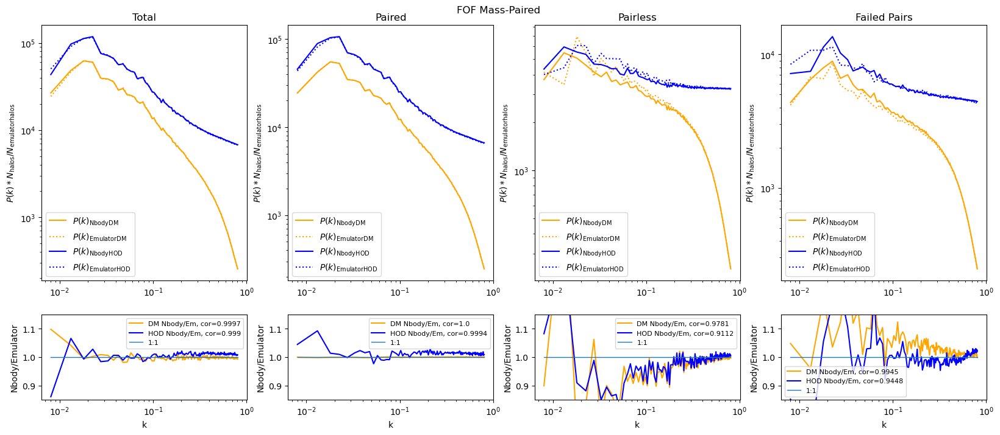

In [12]:
pair_file = 'pair_files/fof_pairs_by_mass'
plot_power_spectra(pair_file,title="FOF Mass-Paired",savename="figures/pk_fof_bymass.pdf")
       

yt : [INFO     ] 2023-08-14 11:16:21,998 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-14 11:16:21,999 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-14 11:16:22,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-14 11:16:22,001 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-14 11:16:22,001 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-14 11:16:22,001 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-14 11:16:22,002 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-14 11:16:22,002 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-14 11:16:22,002 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-14 11:16:22,003 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-14 11:16:22,056 Parameters: current

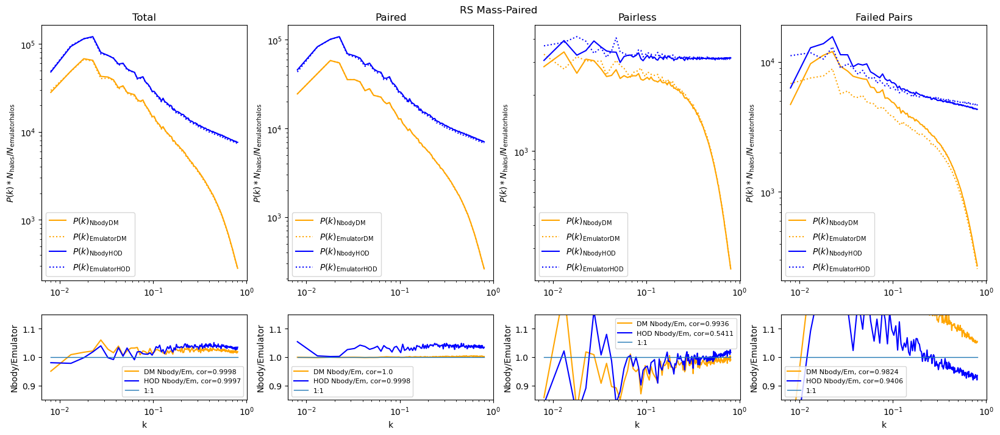

In [13]:
pair_file = 'pair_files/rs_pairs_by_mass'
plot_power_spectra(pair_file,title="RS Mass-Paired",savename="figures/rs_fof_bymass.pdf")
       

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


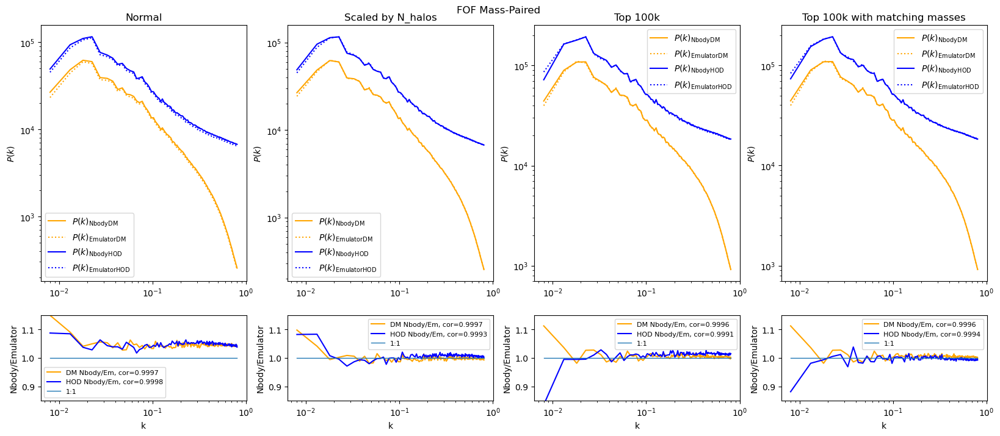

In [14]:
pair_file = 'pair_files/fof_pairs_by_mass'
plot_power_spectra2(pair_file,title="FOF Mass-Paired",savename="figures/pk_fof_by_match.pdf")
       

yt : [INFO     ] 2023-08-14 11:17:22,194 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-14 11:17:22,195 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-14 11:17:22,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-14 11:17:22,197 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-14 11:17:22,197 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-14 11:17:22,198 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-14 11:17:22,198 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-14 11:17:22,198 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-14 11:17:22,199 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-14 11:17:22,199 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-14 11:17:22,238 Parameters: current

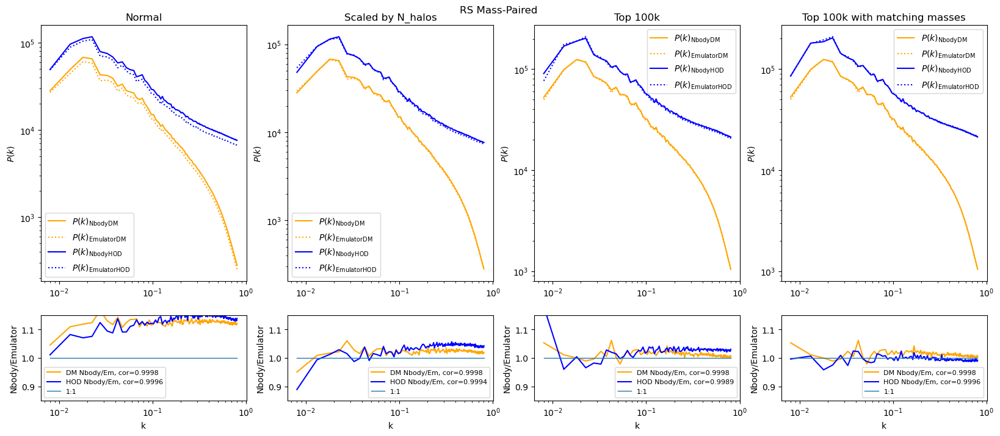

In [15]:
pair_file = 'pair_files/rs_pairs_by_mass'
plot_power_spectra2(pair_file,title="RS Mass-Paired",savename="figures/pk_rs_by_match.pdf")
       

In [21]:
pair_file = 'pair_files/fof_pairs_by_mass'

mass_combos, pos_combos, vel_combos, unique_bins = read_halos(pair_file, min_mass = 1e13)

sortn = np.sort(mass_combos[0])[-100000:]
sorte = np.sort(mass_combos[1])[-100000:]

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


In [30]:
m,n = get_hmf(sortn)
m2,n2 = get_hmf(sorte)

In [43]:
m

array([1.00000000e+13, 1.43844989e+13, 2.06913808e+13, 2.97635144e+13,
       4.28133240e+13, 6.15848211e+13, 8.85866790e+13, 1.27427499e+14,
       1.83298071e+14, 2.63665090e+14, 3.79269019e+14, 5.45559478e+14,
       7.84759970e+14, 1.12883789e+15, 1.62377674e+15, 2.33572147e+15,
       3.35981829e+15, 4.83293024e+15, 6.95192796e+15, 1.00000000e+16])

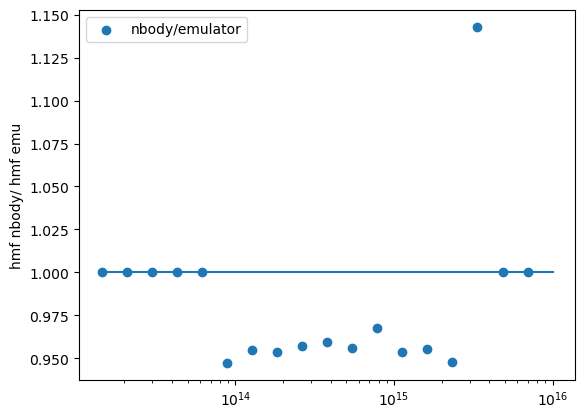

In [42]:
plt.scatter(m[1:], n/n2, label = "nbody/emulator")
plt.plot(m[1:],np.linspace(1,1,len(m)-1))
plt.legend()
plt.ylabel("hmf nbody/ hmf emu")
plt.xscale("log")
plt.savefig("figures/hmf_top_hundredk.pdf")


In [22]:
np.min(sortn)/1e13

4.661358456423507

In [23]:
np.min(sorte)/1e13

4.8583172644414025

# Comparing total number of pairs vs fraction cutoff

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
yt : [INFO     ] 2023-08-04 13:36:40,447 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-04 13:36:40,448 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-04 13:36:40,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-04 13:36:40,449 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-04 13:36:40,450 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-04 13:36:40,450 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-04 13:36:40,450 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     

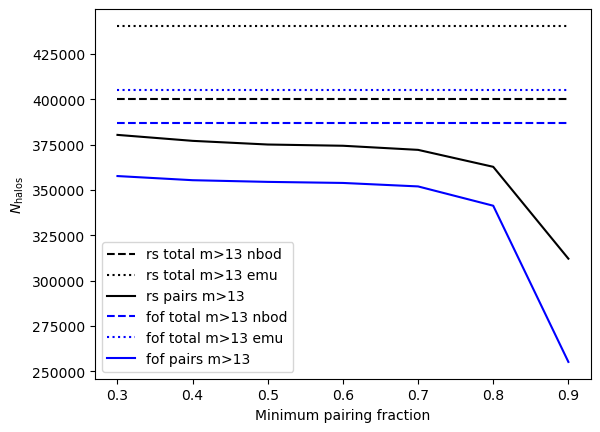

In [12]:
f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
f0emu = BigFileCatalog('fof_halos/lh0000_emu')
mass_nbod_fof  = np.array(f0nbody["Mass"])
mass_emu_fof  = np.array(f0emu["Mass"])
dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
dsemu = yt.load("particle_test_emu/halos_0.0.bin")
mass_nbod_rs  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
mass_emu_rs  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))

plt.figure()
plt.xlabel("Minimum pairing fraction")
plt.ylabel(r"$N_{\rm halos}$")


for hf, mass_nbod,mass_emu in zip(["rs", "fof"], [mass_nbod_rs,mass_nbod_fof], [mass_emu_rs,mass_emu_fof]):
    all_pairs = np.sort(glob.glob("pair_files/"+hf+"*"))
    f_list, n_total, n_id,n_total_m13_nbod,n_total_m13_emu, n_m13= [],[],[],[],[],[]
    for f in all_pairs:
        frac = float(f.split("_")[-1])
        f_list.append(frac)
        n_total.append(len(mass_nbod))
        #print(len(mass_nbod))
        nbod_ids = np.array(pd.read_csv(f)["nbody_id"])-1
        n_id.append(len(nbod_ids))
        mpairs = mass_nbod[nbod_ids]
        n_m13.append(len(mpairs[mpairs>1e13]))
        n_total_m13_nbod.append(len(mass_nbod[mass_nbod>1e13]))
        n_total_m13_emu.append(len(mass_emu[mass_emu>1e13]))
#     print(mass_nbod[mass_nbod>1e13])
#     print(len(mass_nbod[mass_nbod>1e13]))
#     print(len(mass_nbod))
    c="black"
    if(hf == "fof"): c = "blue"
    plt.plot(f_list, n_total_m13_nbod, c=c, ls="--",label=hf+" total m>13 nbod")
    plt.plot(f_list, n_total_m13_emu, c=c, ls=":",label=hf+" total m>13 emu")
#     plt.plot(f_list, n_total, c="black",lw=5, ls=ls)
#     plt.plot(f_list, n_id, c="green", ls=ls)
    plt.plot(f_list, n_m13, c=c, ls="-",label=hf+" pairs m>13")
plt.legend()
plt.savefig("figures/pair_frac_comp.pdf", bbox_inches="tight")
    

# Plotting FOF and RS stats

In [35]:
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
mass_combos, pos_combos, vel_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=True, pos_n_vel = True)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, unique_bins = mass_combos


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


In [9]:
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
mass_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=True)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, unique_bins = mass_combos

title = "FOF All Halos"
savename = "figures/FOF_all.pdf"
plot_halo_stats(mass_nbod,mass_emu,savename,title)

title = "FOF Pairless Haloes"
savename = "figures/FOF_pairless.pdf"
plot_halo_stats(mass_pairless_nbod,mass_pairless_emu,savename,title)

title = "FOF Paired Halos"
savename = "figures/FOF_pairs.pdf"
plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename,title)

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


In [197]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'rs_pairs'
mass_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=False)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, unique_bins = mass_combos

title = "RS All Halos"
savename = "figures/RS_all.pdf"
plot_halo_stats(mass_nbod,mass_emu,savename,title)

title = "RS Pairless Haloes"
savename = "figures/RS_pairless.pdf"
plot_halo_stats(mass_pairless_nbod,mass_pairless_emu,savename,title)

title = "RS Paired Halos"
savename = "figures/RS_pairs.pdf"
plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu, savename,title)

yt : [INFO     ] 2023-08-06 15:27:49,228 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-06 15:27:49,229 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-06 15:27:49,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-06 15:27:49,231 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-06 15:27:49,231 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-06 15:27:49,231 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-06 15:27:49,232 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-06 15:27:49,232 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-06 15:27:49,232 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-06 15:27:49,232 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-06 15:27:49,272 Parameters: current

ValueError: not enough values to unpack (expected 7, got 3)

# Mass Correction applied to FOF and RS

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_3746/2178741720.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimiz

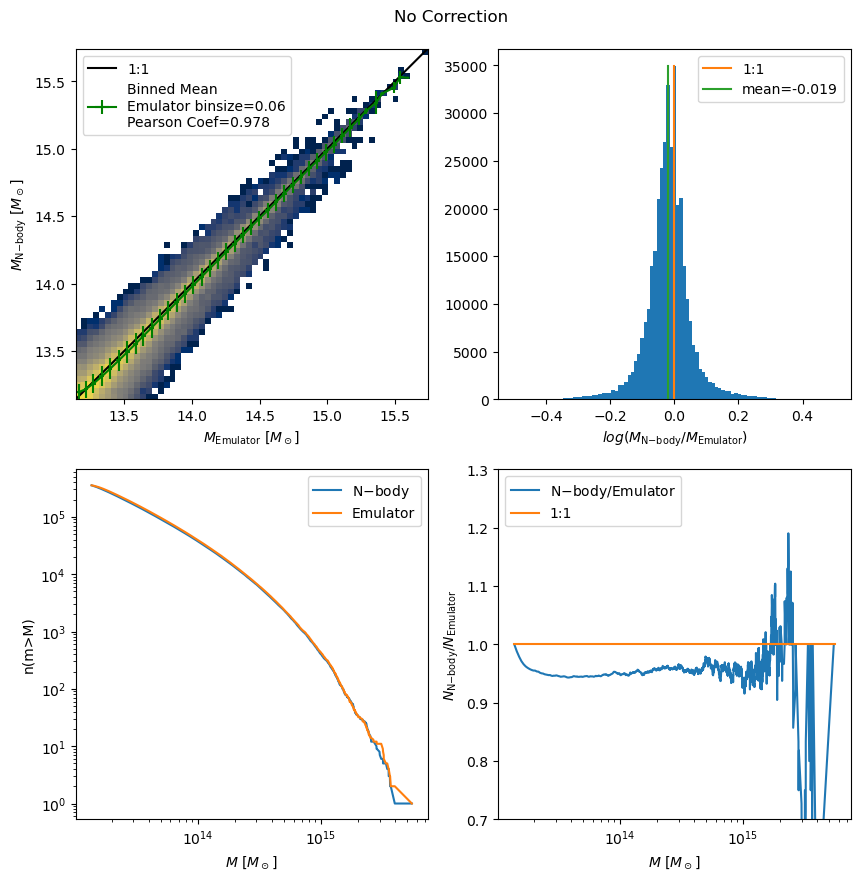

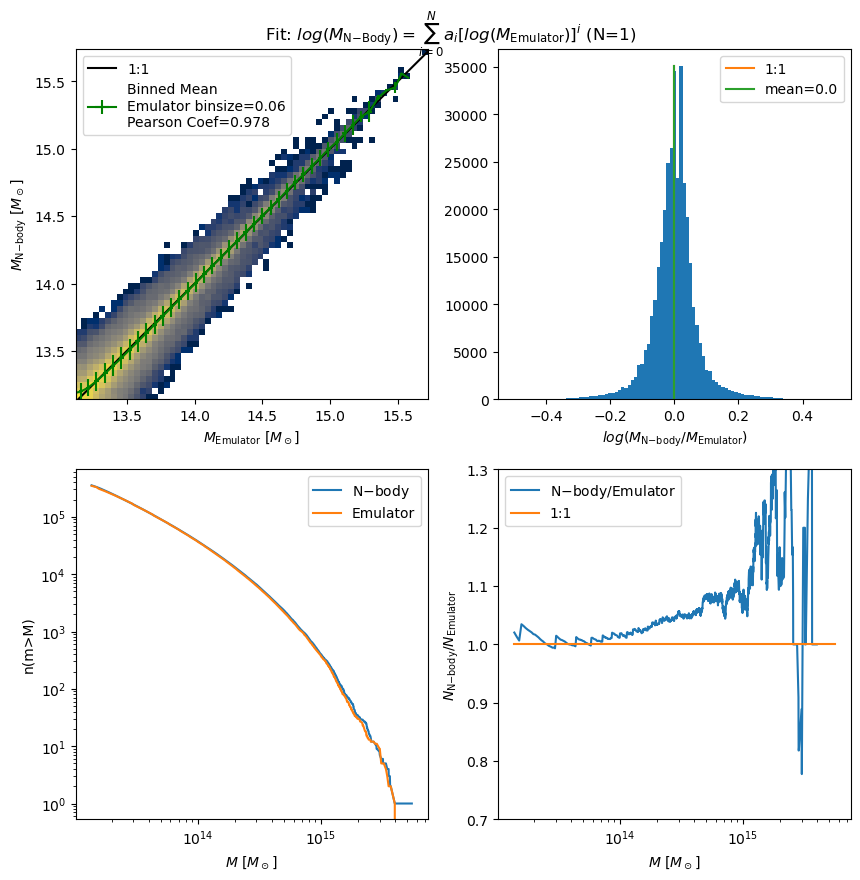

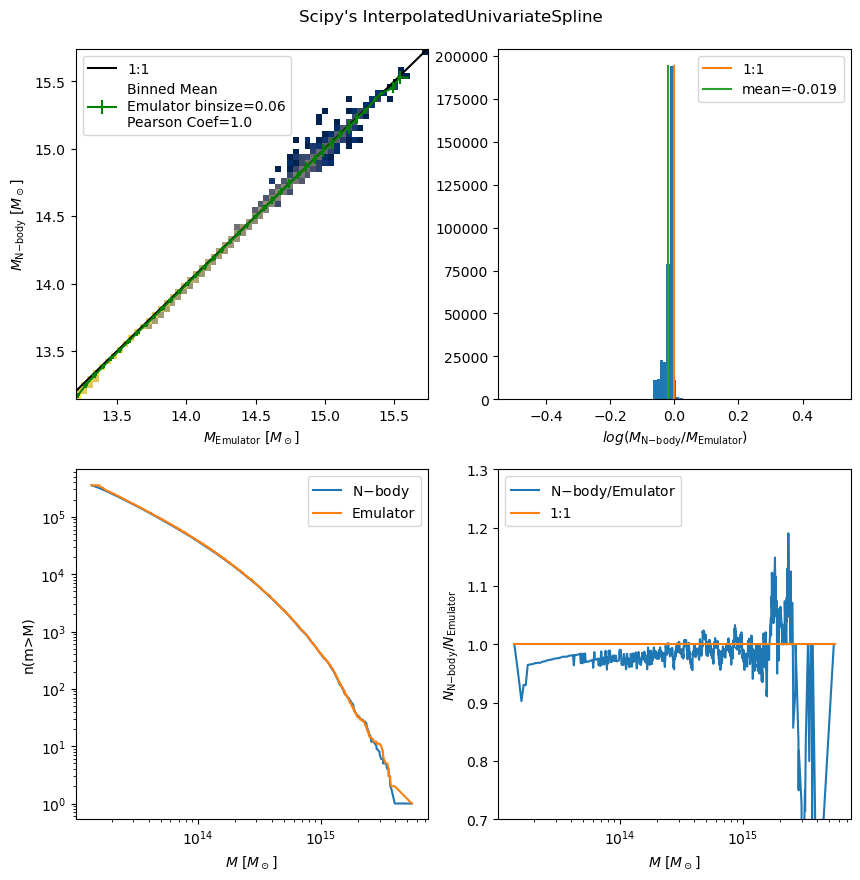

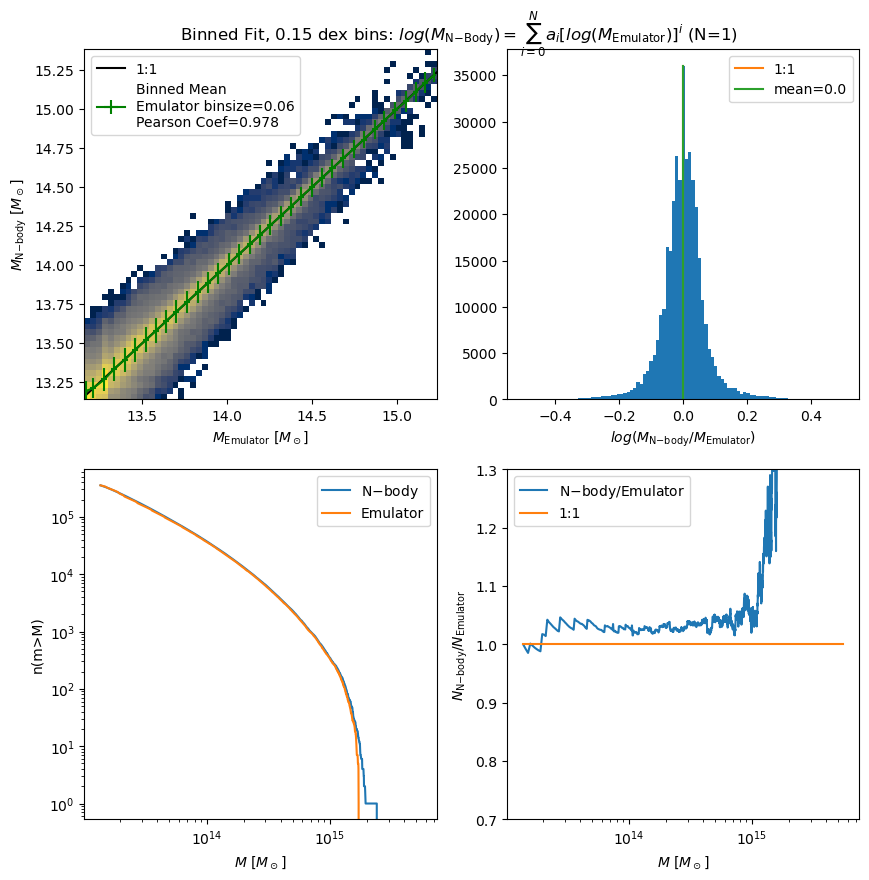

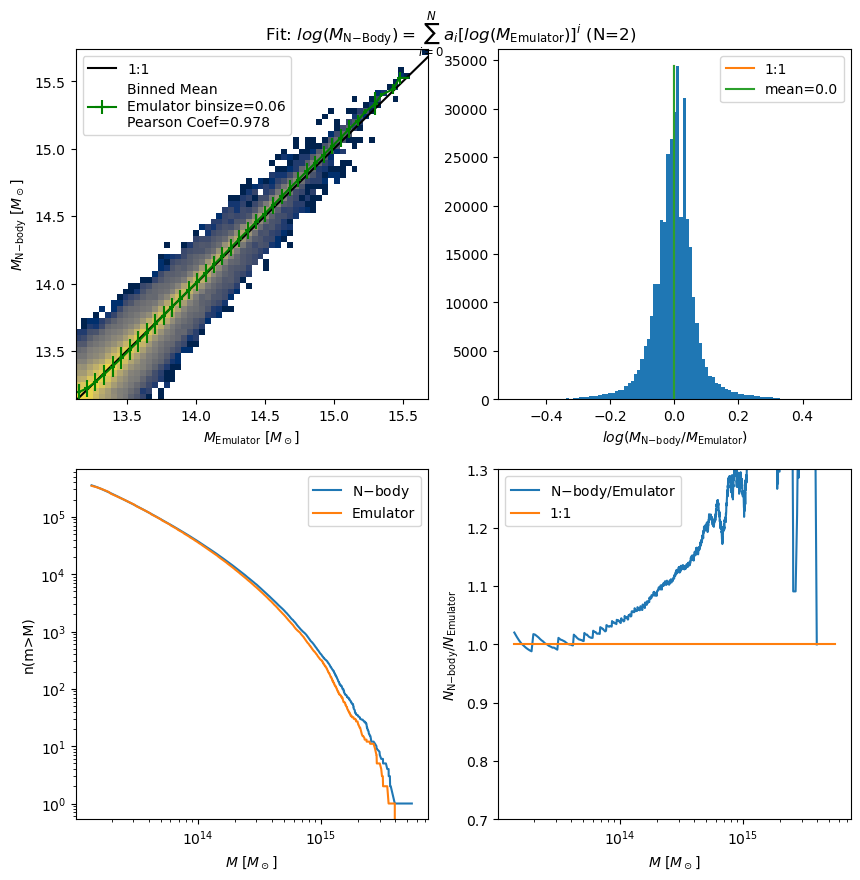

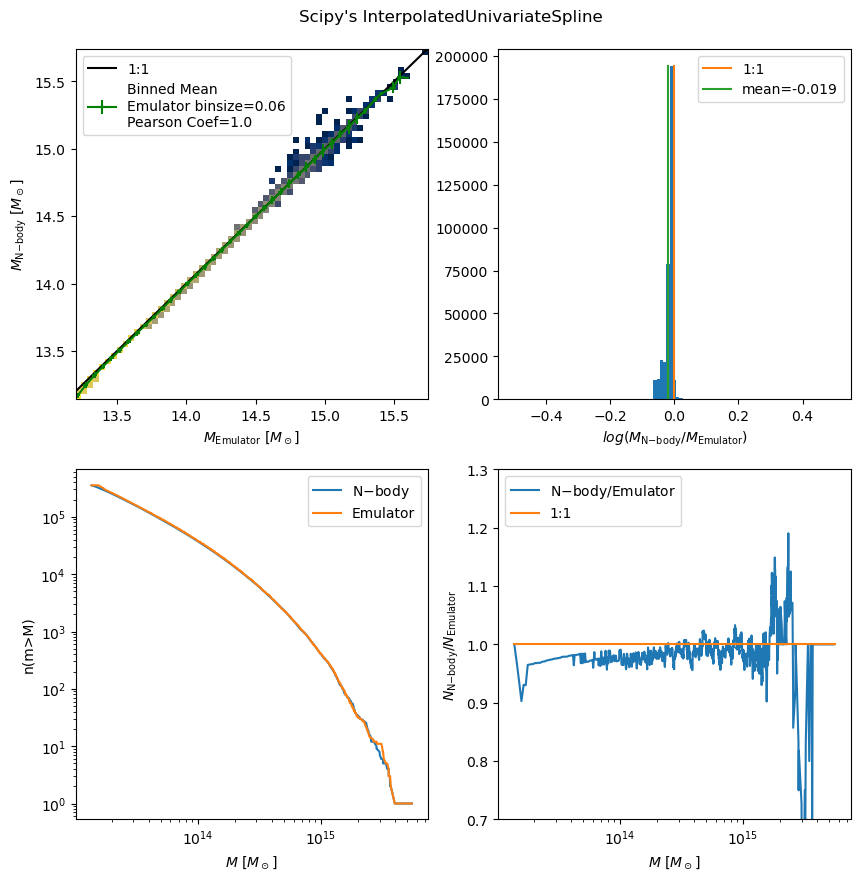

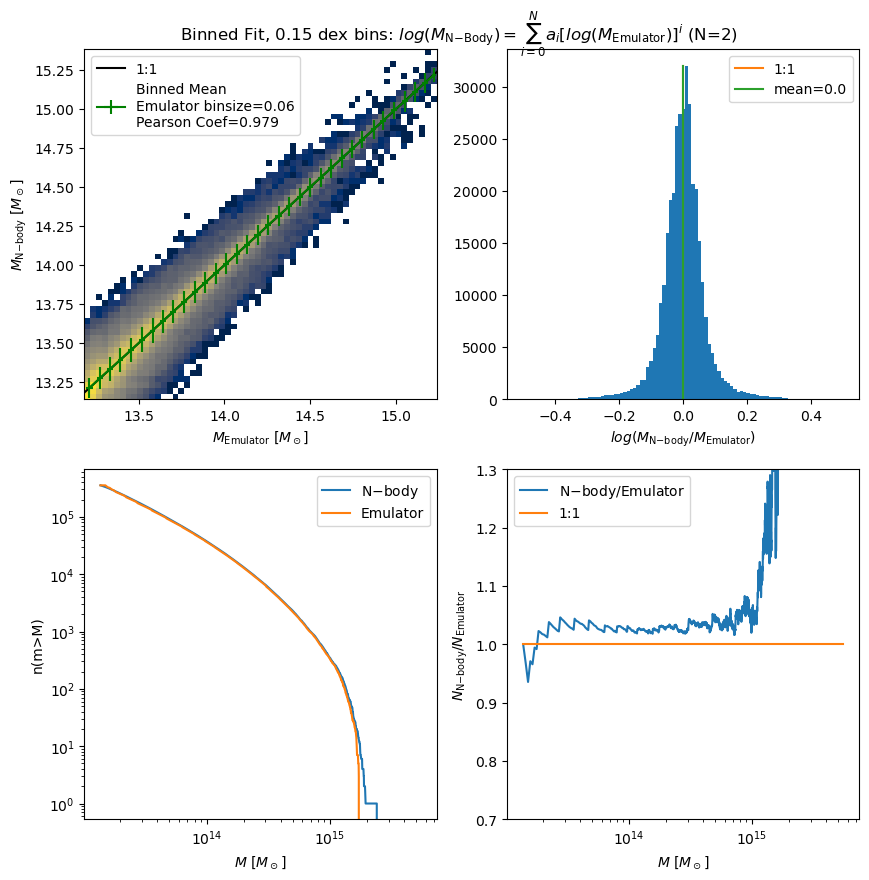

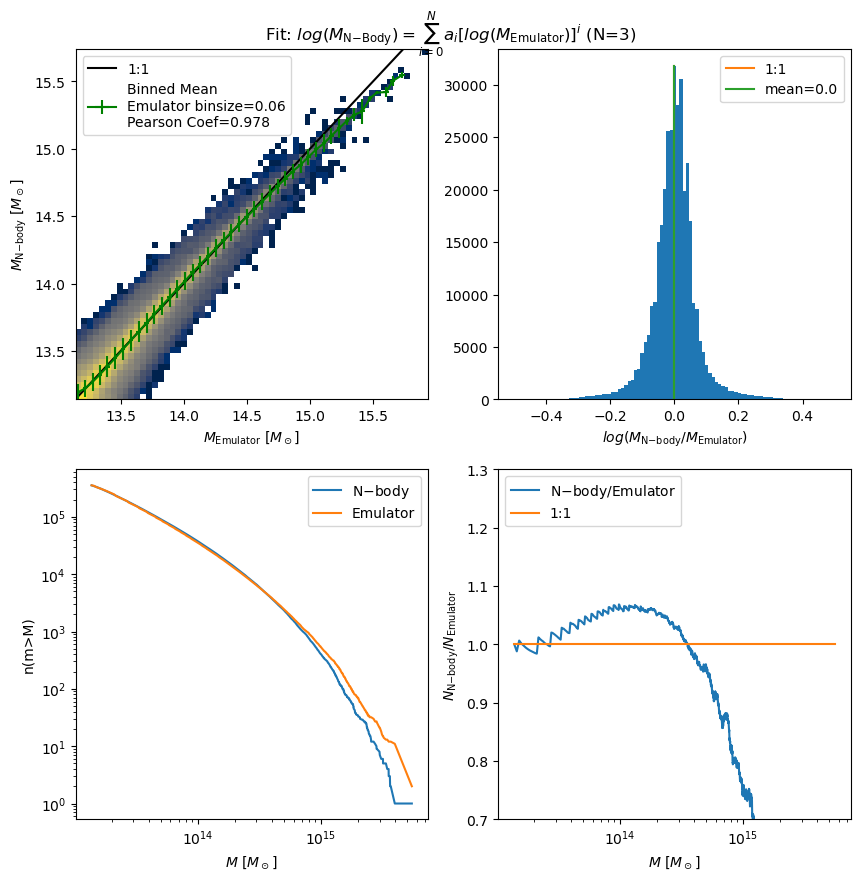

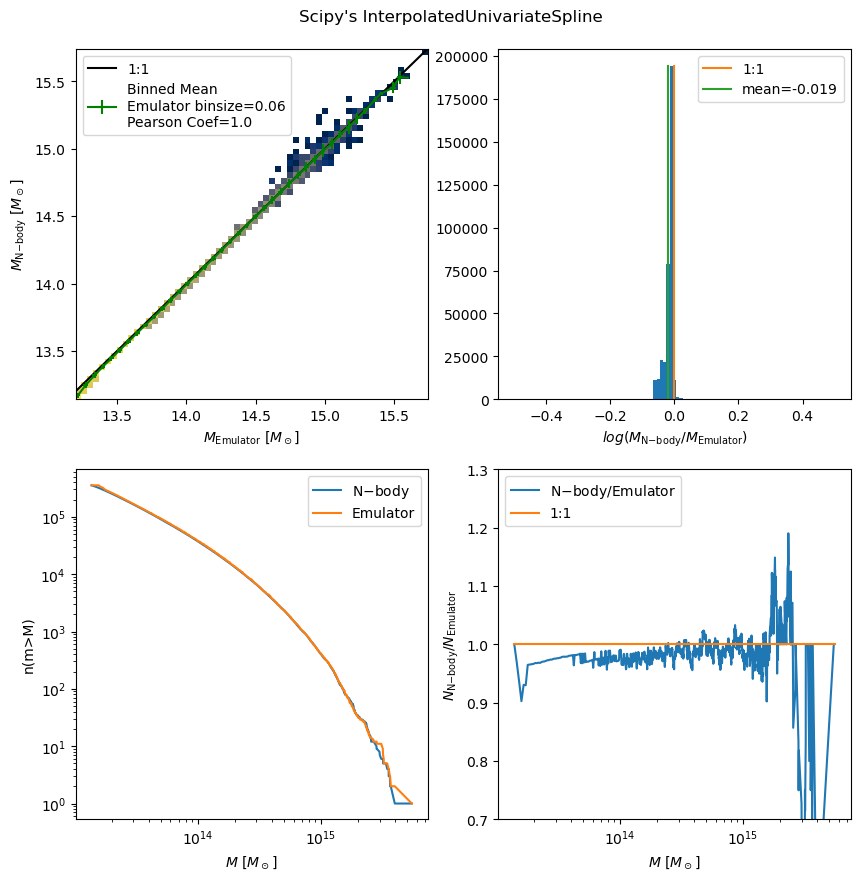

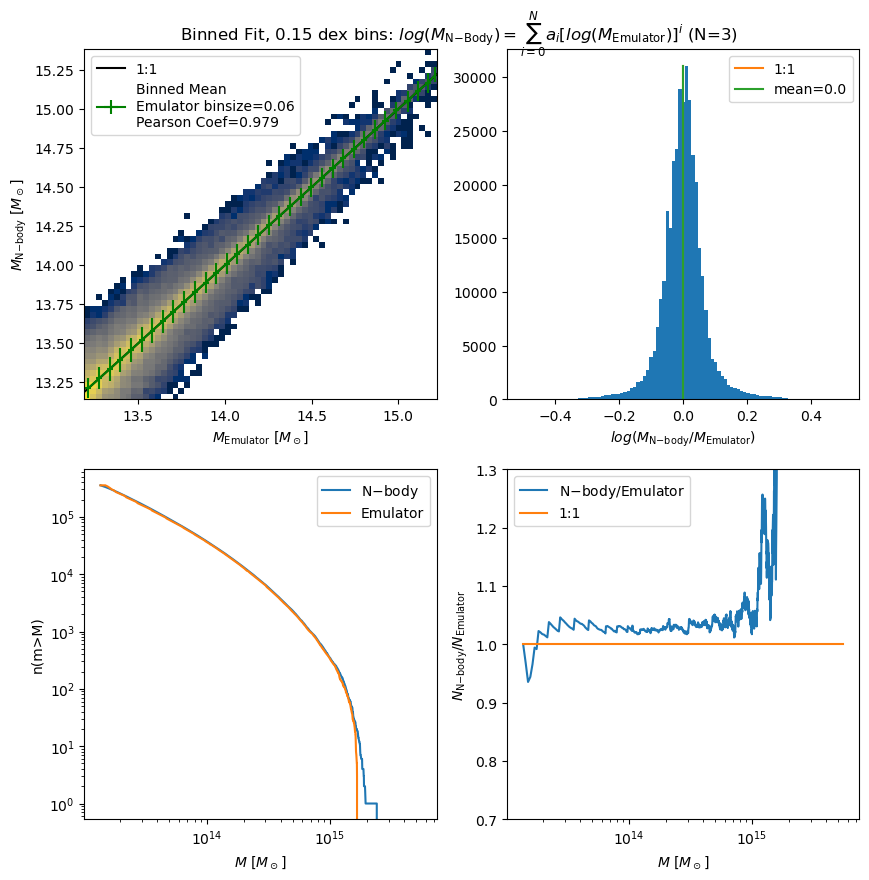

In [140]:
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
mass_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=True,pos_n_vel=False)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu, unique_bins = mass_combos

plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu,"figures/fof_nocor.pdf","No Correction",bins=unique_bins)

for x in range(3):
    POWER = x+1
    mass_paired_emu_corrected =mass_fit_poly(mass_paired_nbod, mass_paired_emu)
    plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu_corrected, "figures/fofcor_poly_p"+str(POWER)+".pdf",r"Fit: $log(M_{\rm N{-}Body}) = \sum_{i=0}^N a_i [log(M_{\rm Emulator})]^i$ (N="+str(POWER)+")", bins=unique_bins)
    mass_paired_emu_corrected = mass_fit_spline(mass_paired_nbod, mass_paired_emu)
    plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu_corrected, "figures/fofcor_unispl.pdf","Scipy's InterpolatedUnivariateSpline", bins=unique_bins)
    bins = np.arange(13,15.26,0.15)
    m_nbod_corrected, m_emu_corrected =mass_fit_poly_binned(mass_paired_nbod, mass_paired_emu, bins=bins)
    plot_halo_pairs_stats(m_nbod_corrected, m_emu_corrected, "figures/fofcor_poly_binned_p"+str(POWER)+".pdf",r"Binned Fit, 0.15 dex bins: $log(M_{\rm N{-}Body}) = \sum_{i=0}^N a_i [log(M_{\rm Emulator})]^i$ (N="+str(POWER)+")", bins=unique_bins)

yt : [INFO     ] 2023-08-06 15:30:28,111 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-06 15:30:28,112 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-06 15:30:28,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-06 15:30:28,113 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-06 15:30:28,114 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-06 15:30:28,114 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-06 15:30:28,114 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-06 15:30:28,115 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-06 15:30:28,115 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-06 15:30:28,115 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-06 15:30:28,156 Parameters: current

ERROR IN get_hmf(mass), mass isn't filtered.


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

ERROR IN get_hmf(mass), mass isn't filtered.


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

ERROR IN get_hmf(mass), mass isn't filtered.


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

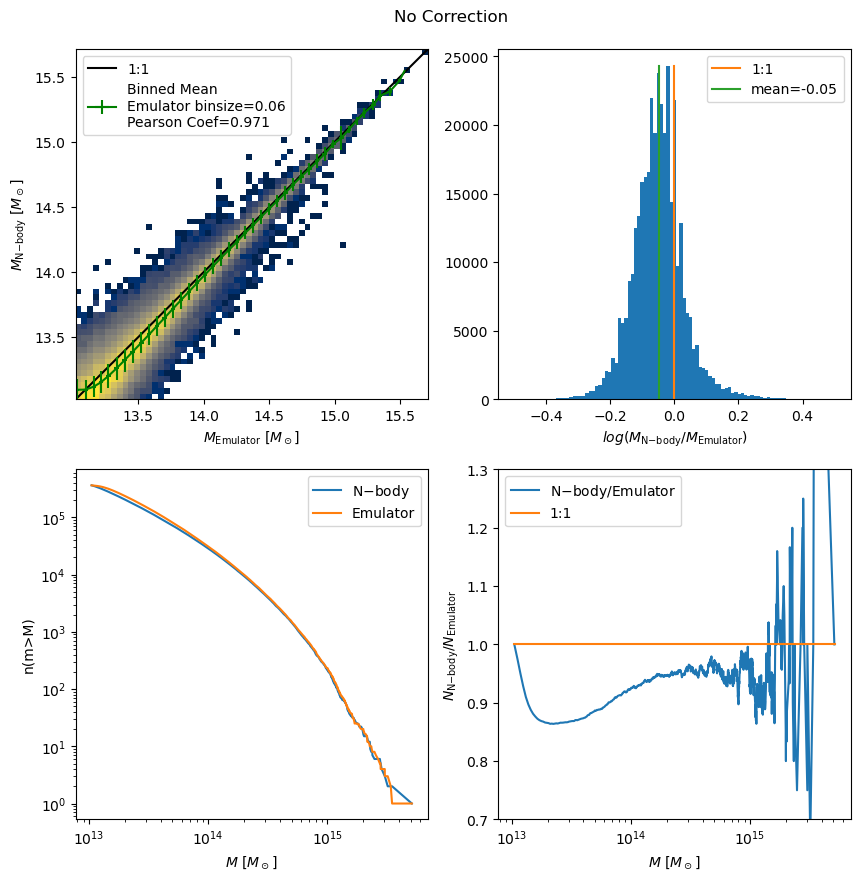

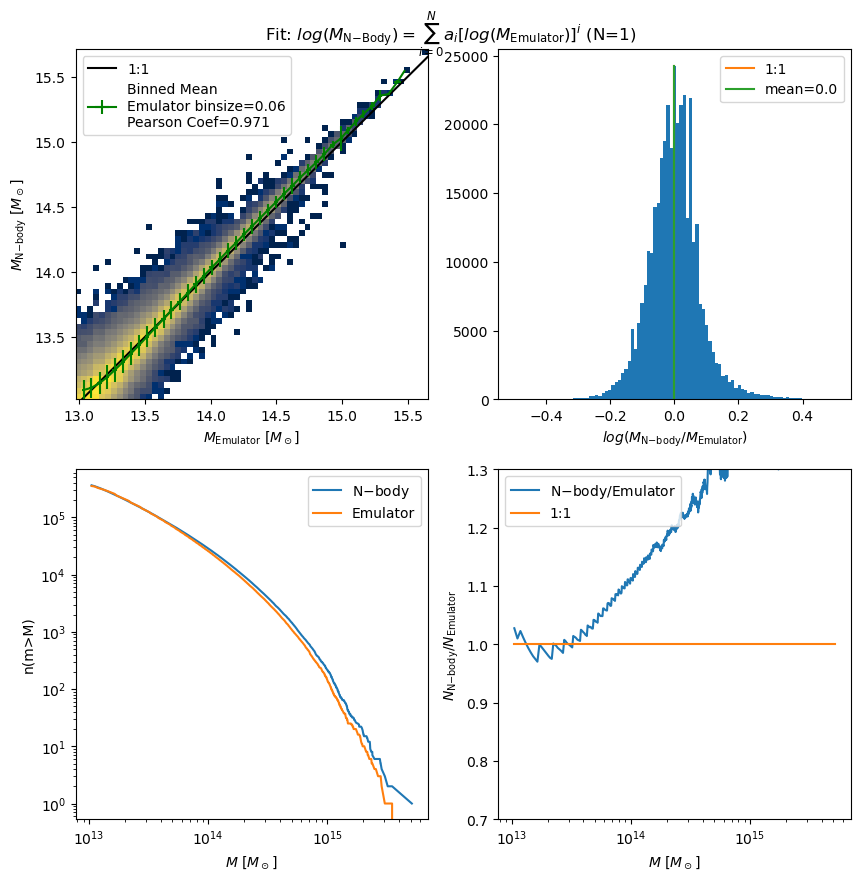

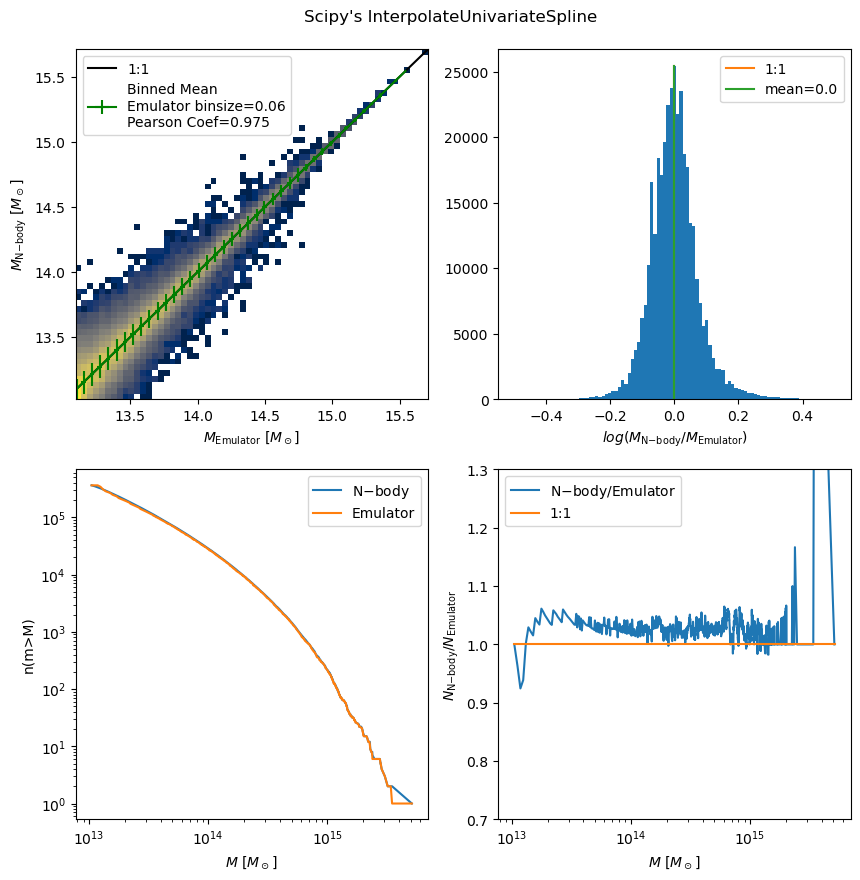

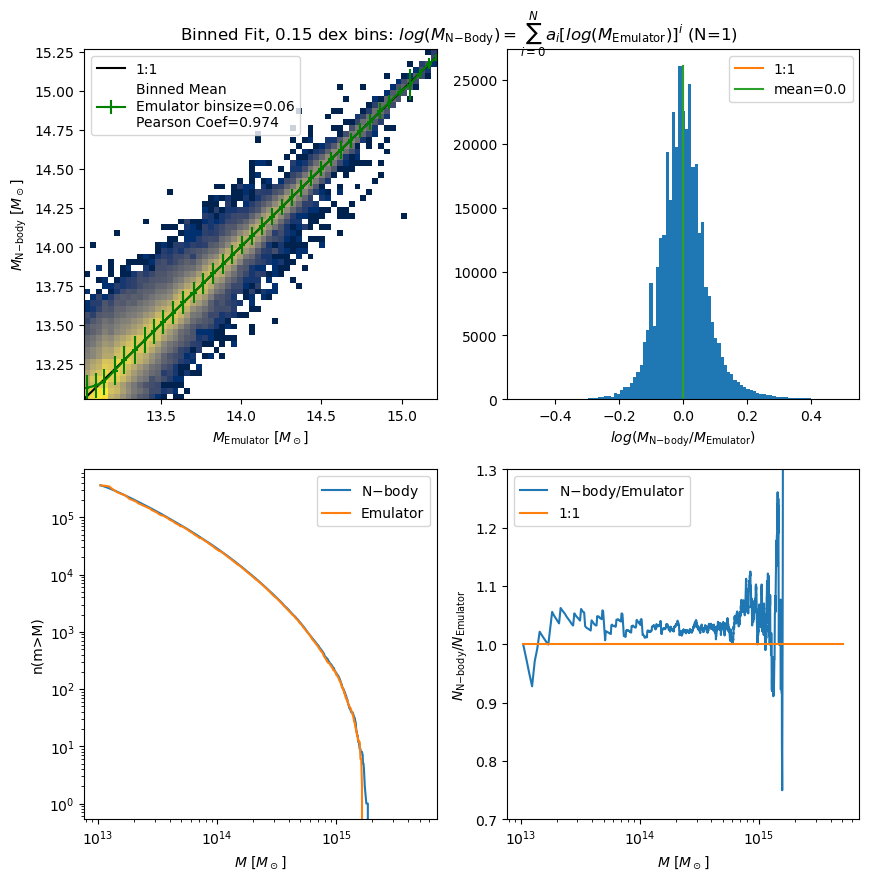

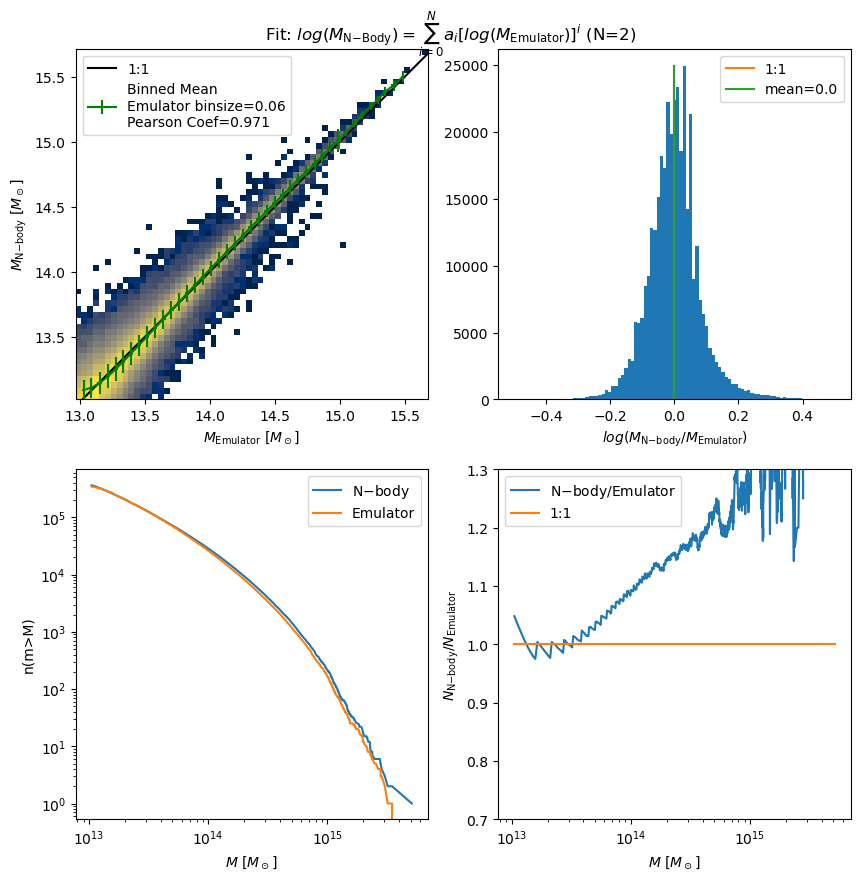

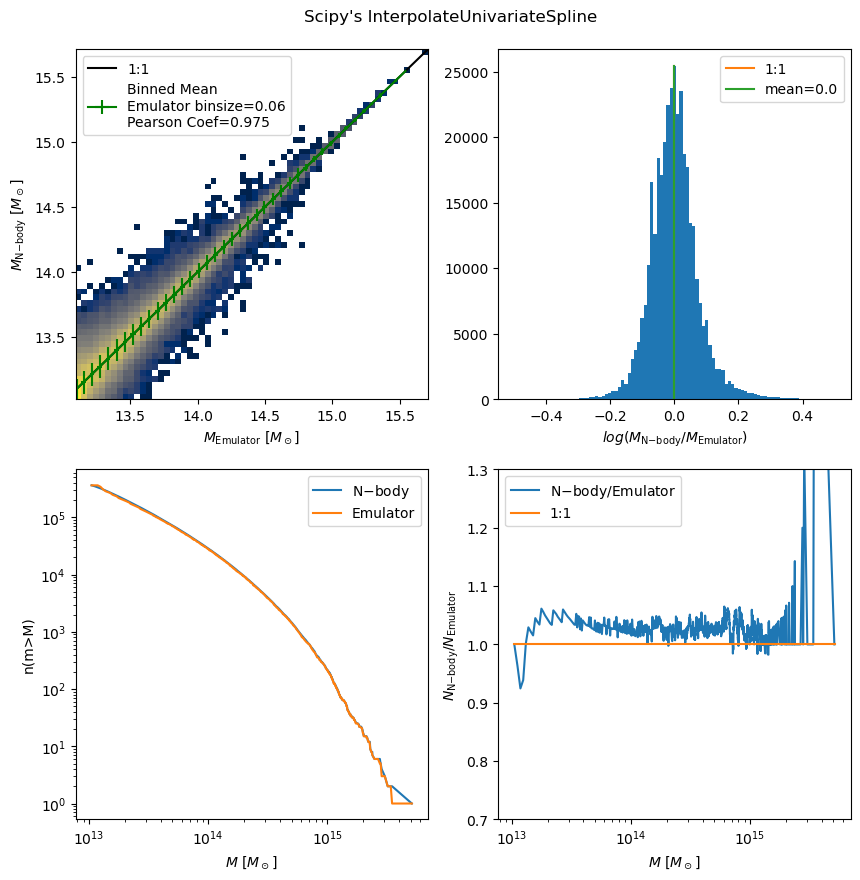

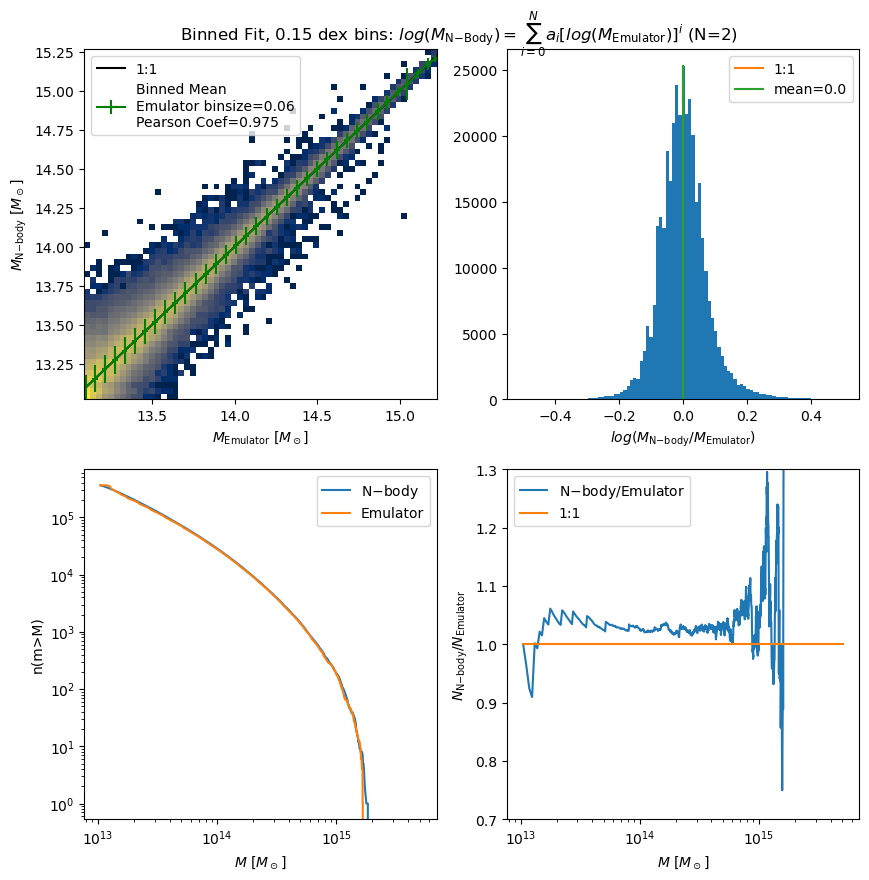

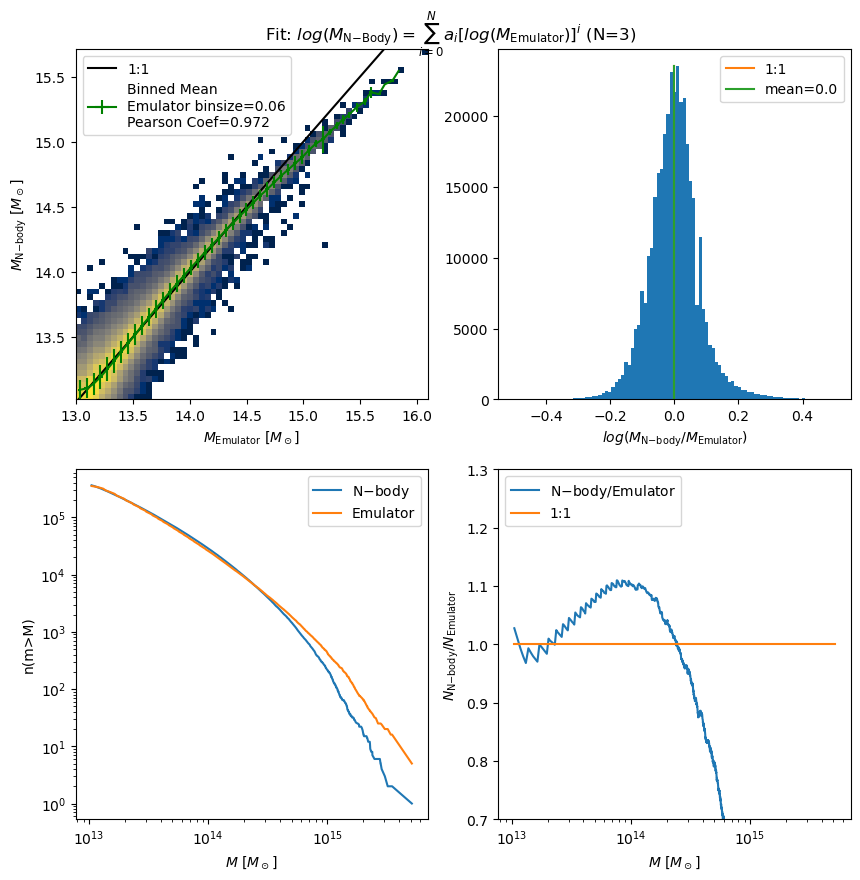

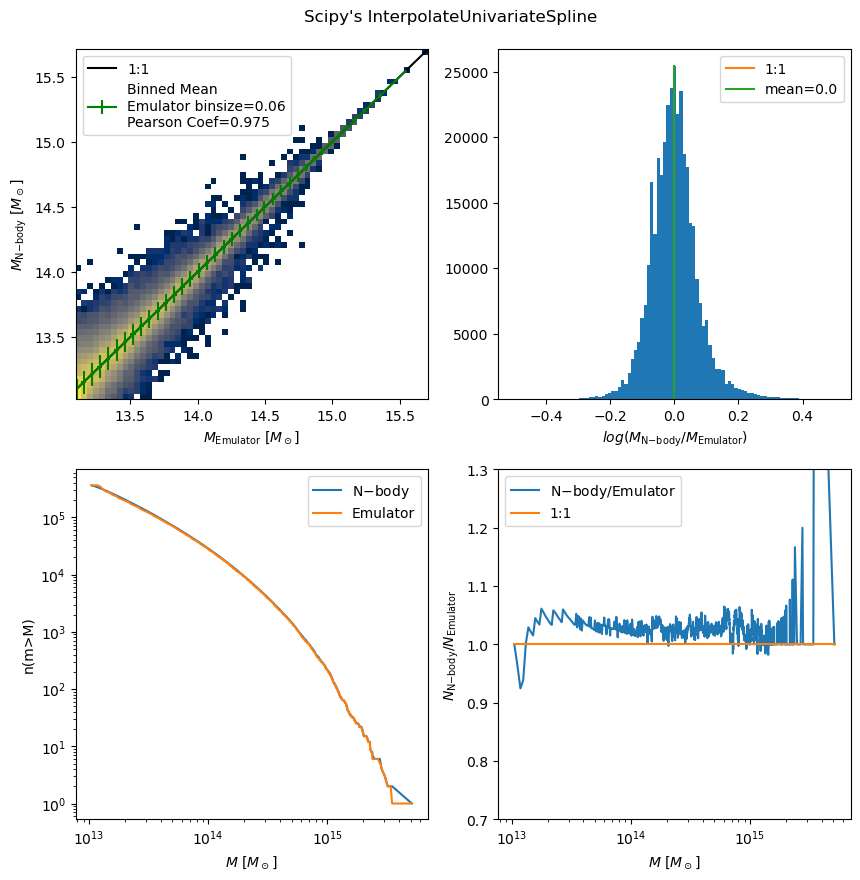

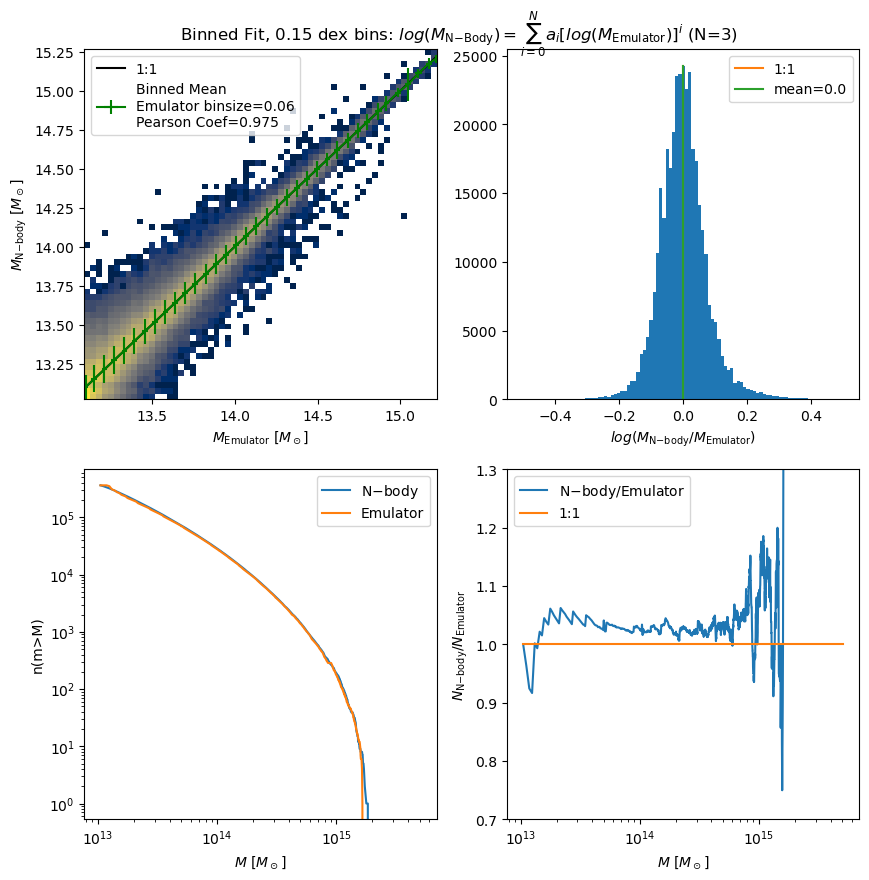

In [200]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'pair_files/rs_pairs_0.5'
mass_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=False,pos_n_vel=False)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu,unique_bins = mass_combos


plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu,"figures/rs_nocor.pdf","No Correction",bins=unique_bins)


for x in range(3):
    POWER = x+1
    mass_paired_emu_corrected =mass_fit_poly(mass_paired_nbod, mass_paired_emu)
    plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu_corrected, "figures/rscor_poly_p"+str(POWER)+".pdf",r"Fit: $log(M_{\rm N{-}Body}) = \sum_{i=0}^N a_i [log(M_{\rm Emulator})]^i$ (N="+str(POWER)+")", bins=unique_bins)
    mass_paired_emu_corrected = mass_fit_spline(mass_paired_nbod, mass_paired_emu)
    plot_halo_pairs_stats(mass_paired_nbod, mass_paired_emu_corrected, "figures/rscor_unispl.pdf","Scipy's InterpolateUnivariateSpline", bins=unique_bins)
    bins = np.arange(13,15.26,0.15)
    m_nbod_corrected, m_emu_corrected =mass_fit_poly_binned(mass_paired_nbod, mass_paired_emu, bins=bins)
    plot_halo_pairs_stats(m_nbod_corrected, m_emu_corrected, "figures/rscor_poly_binned_p"+str(POWER)+".pdf",r"Binned Fit, 0.15 dex bins: $log(M_{\rm N{-}Body}) = \sum_{i=0}^N a_i [log(M_{\rm Emulator})]^i$ (N="+str(POWER)+")", bins=unique_bins)

# correct for all halos and subsample

yt : [INFO     ] 2023-08-07 09:17:58,089 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-07 09:17:58,091 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-07 09:17:58,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-07 09:17:58,092 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-07 09:17:58,092 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-07 09:17:58,093 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-07 09:17:58,093 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-07 09:17:58,093 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-07 09:17:58,094 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-07 09:17:58,095 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-07 09:17:58,136 Parameters: current

yt : [INFO     ] 2023-08-07 09:18:19,998 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-07 09:18:19,999 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-07 09:18:20,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-07 09:18:20,000 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-07 09:18:20,001 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-07 09:18:20,001 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-07 09:18:20,001 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-07 09:18:20,001 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-07 09:18:20,002 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-07 09:18:20,002 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-07 09:18:20,038 Parameters: current

yt : [INFO     ] 2023-08-07 09:18:30,710 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-07 09:18:30,711 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-07 09:18:30,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-07 09:18:30,712 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-07 09:18:30,712 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-07 09:18:30,712 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-07 09:18:30,713 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-07 09:18:30,713 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-07 09:18:30,713 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-07 09:18:30,713 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-07 09:18:30,750 Parameters: current

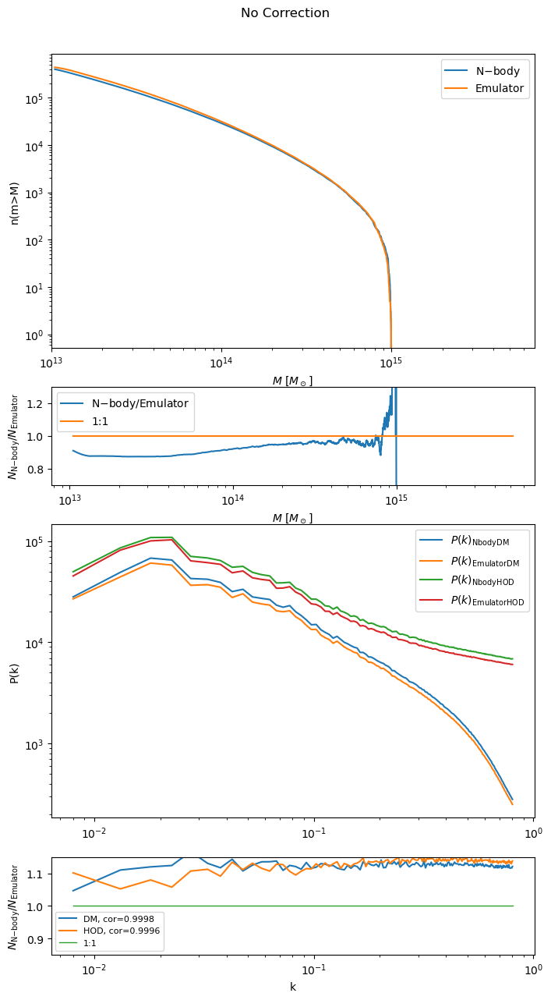

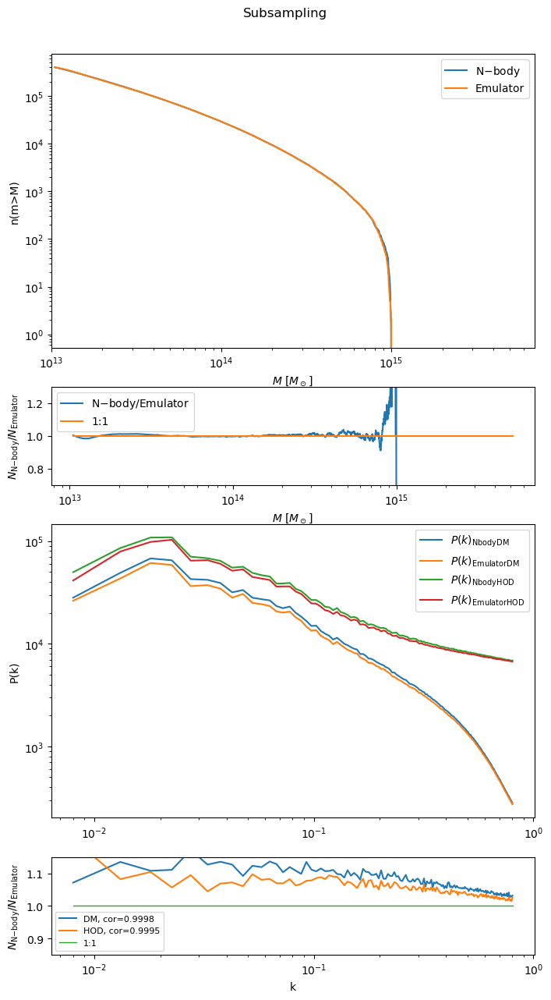

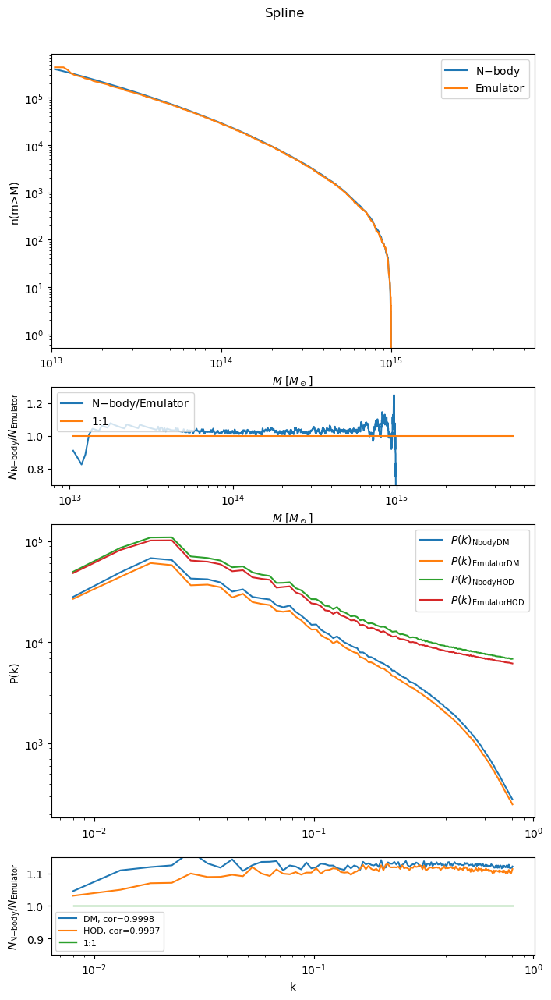

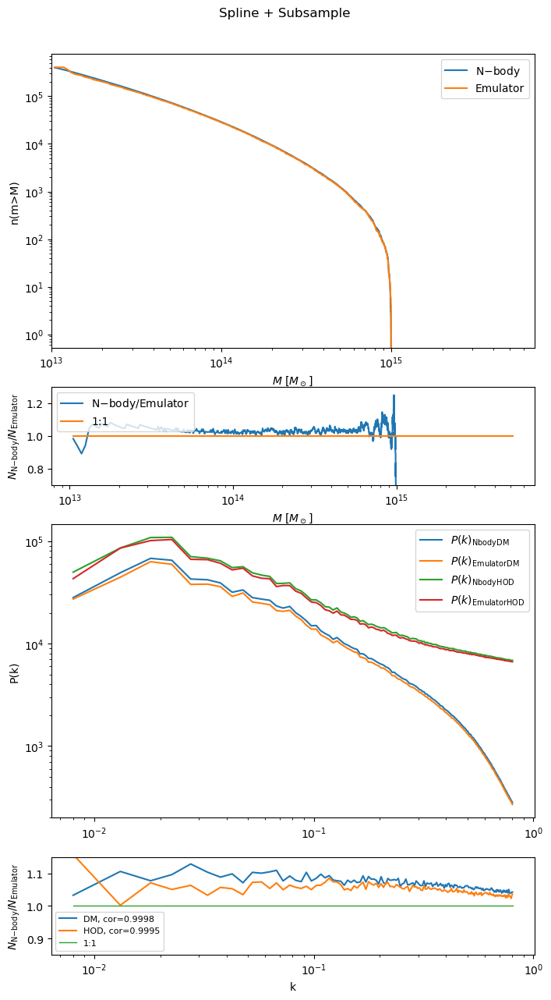

In [46]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'pair_files/rs_pairs_0.5'
POWER=3
plot_subsample(nbody_file, emu_file, pair_file,fof=False,savename = "figures/rs_stats_nocorr.pdf",title="No Correction",num_bins = 20,spline=False,subsample=False)
plot_subsample(nbody_file, emu_file, pair_file,fof=False,savename = "figures/rs_stats_subsample.pdf",title="Subsampling",num_bins = 20,spline=False,subsample=True)
plot_subsample(nbody_file, emu_file, pair_file,fof=False,savename = "figures/rs_stats_spline.pdf",title="Spline",num_bins = 20,spline=True,subsample=False)
plot_subsample(nbody_file, emu_file, pair_file,fof=False,savename = "figures/rs_stats_subsample_n_spline.pdf",title="Spline + Subsample",num_bins = 20,spline=True,subsample=True)
#plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = -1,title=-1,num_bins = 10,bins=[],spline=False,subsample=True):


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_17694/2142904666.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_17694/2142904666.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): ma

/tmp/ipykernel_17694/2142904666.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_17694/2142904666.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)


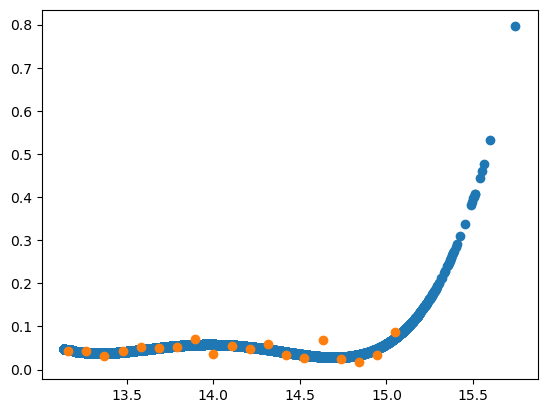

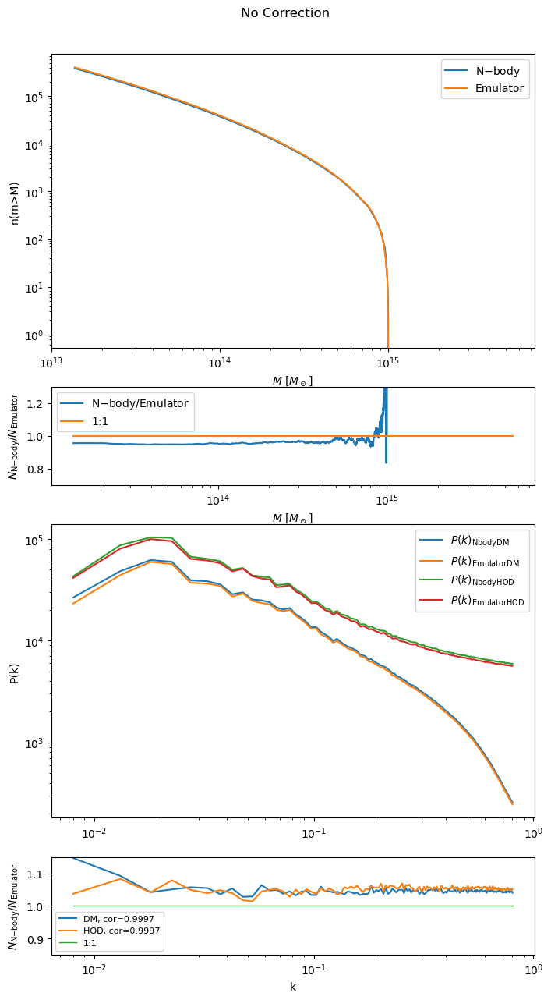

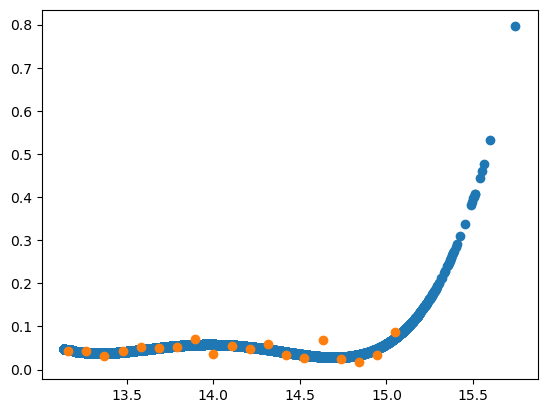

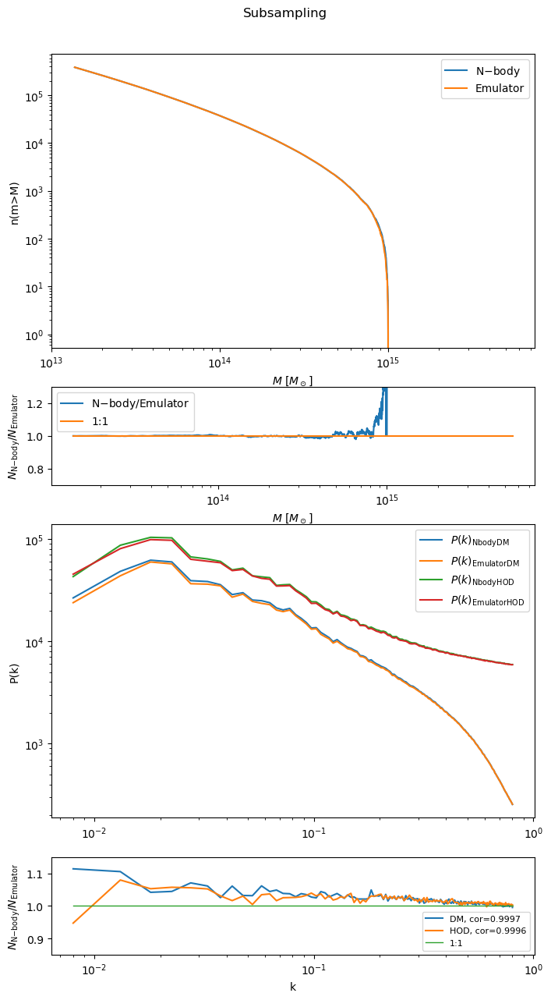

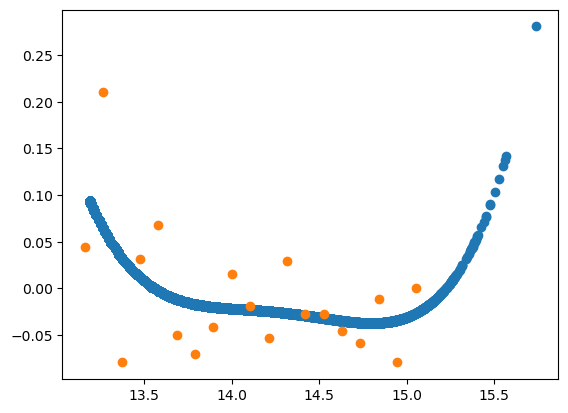

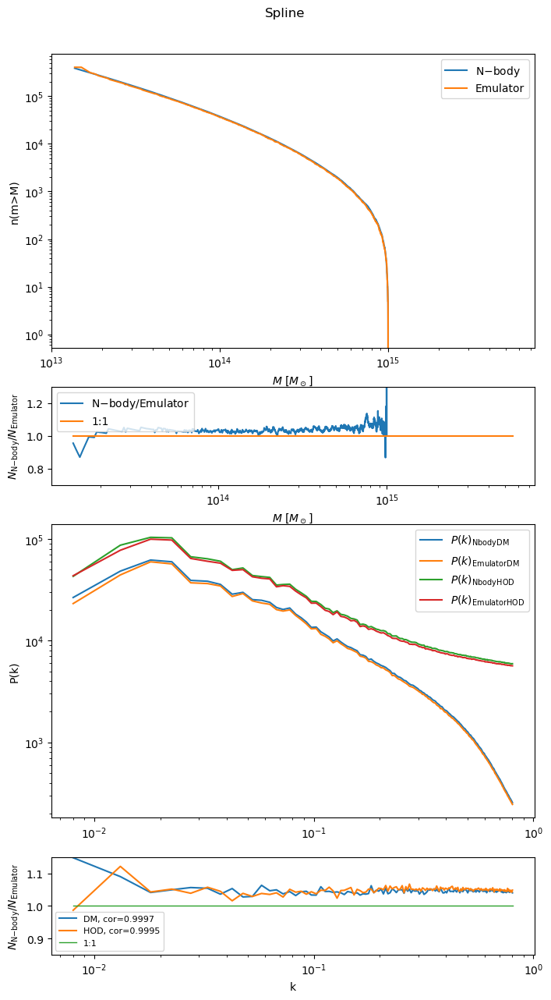

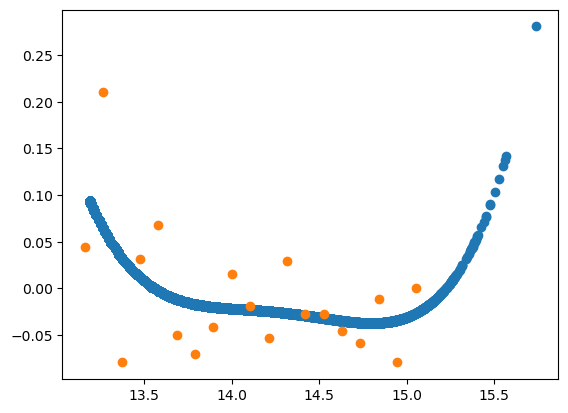

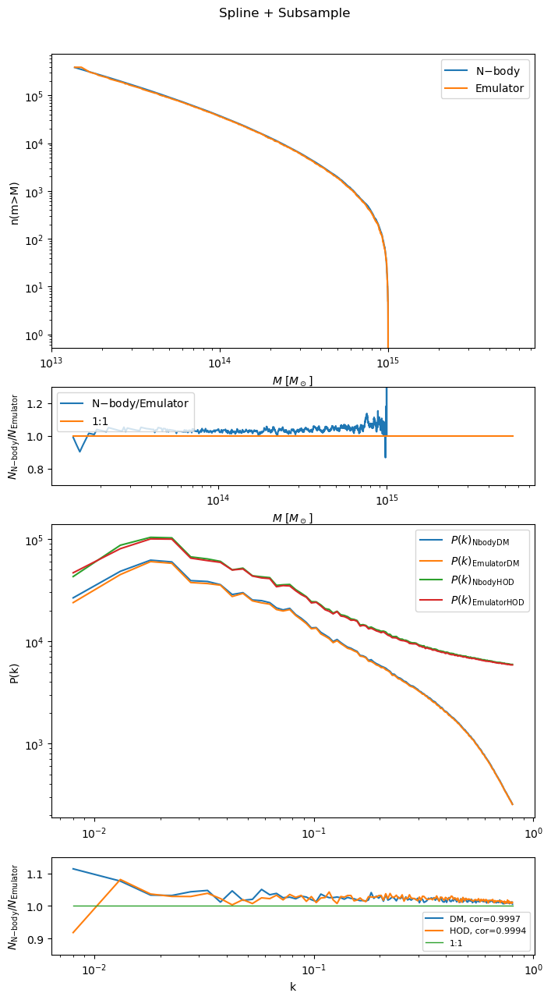

In [68]:

nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','pair_files/fof_pairs_0.5'
plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = "figures/fof_stats_nocorr.pdf",title="No Correction",num_bins = 20,spline=False,subsample=False)
plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = "figures/fof_stats_subsample.pdf",title="Subsampling",num_bins = 20,spline=False,subsample=True)
plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = "figures/fof_stats_spline.pdf",title="Spline",num_bins = 20,spline=True,subsample=False)
plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = "figures/fof_stats_subsample_n_spline.pdf",title="Spline + Subsample",num_bins = 20,spline=True,subsample=True)
#plot_subsample(nbody_file, emu_file, pair_file,fof=True,savename = -1,title=-1,num_bins = 10,bins=[],spline=False,subsample=True):


# Calculating distance to the nearest halo for paired and pairless 

In [4]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'pair_files/rs_pairs_0.3'

mass_combos, pos_combos, vel_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=False, pos_n_vel = True,min_mass = 1e11)

mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu,unique_bins = mass_combos
vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu = vel_combos
pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu = pos_combos


yt : [INFO     ] 2023-08-08 12:11:03,169 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-08 12:11:03,171 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-08 12:11:03,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-08 12:11:03,173 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-08 12:11:03,174 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-08 12:11:03,174 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-08 12:11:03,174 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-08 12:11:03,175 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-08 12:11:03,175 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-08 12:11:03,175 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-08 12:11:03,226 Parameters: current

In [5]:
def calc_distance(p, pos_list):
    return np.sqrt(np.sum(np.power(p-pos_list, 2),axis=1))


def find_nearest_neighbor(pos):
    dx=100
    buffer = 3
    steps = int(1000/dx)

    step_list = np.linspace(dx/2,1000-dx/2,steps)
    print(step_list)
    x = pos.T[0]
    y = pos.T[1]
    z = pos.T[2]
    min_dist = np.zeros(len(pos))
    total = 0
    min_indices = np.zeros(len(pos))-1
    for x0 in step_list:
        for y0 in step_list:
            for z0 in step_list:
                filter_ = np.where((np.abs(x - x0) <= dx/2 + buffer) &
                                   (np.abs(y - y0) <= dx/2 + buffer) &
                                   (np.abs(z - z0) <= dx/2 + buffer) )[0]
                pos_filt = pos[filter_]
                for p,i in zip(pos_filt, filter_):
                    old_dist = min_dist[i]
                    new_dist =np.sort(calc_distance(p, pos_filt))[1]
                    if(old_dist == 0 or new_dist<old_dist): 
                        min_dist[i] = new_dist
                        min_indices[i] = i
    return min_dist, min_indices


In [17]:
min_dist_nbod, i = find_nearest_neighbor(pos_nbod)
min_dist_emu, i  = find_nearest_neighbor(pos_emu)

[ 50. 150. 250. 350. 450. 550. 650. 750. 850. 950.]
[ 50. 150. 250. 350. 450. 550. 650. 750. 850. 950.]


In [18]:
min_dist_nbod_pairless, i = find_nearest_neighbor(pos_pairless_nbod)
min_dist_emu_pairless, i = find_nearest_neighbor(pos_pairless_emu)



[ 50. 150. 250. 350. 450. 550. 650. 750. 850. 950.]
[ 50. 150. 250. 350. 450. 550. 650. 750. 850. 950.]


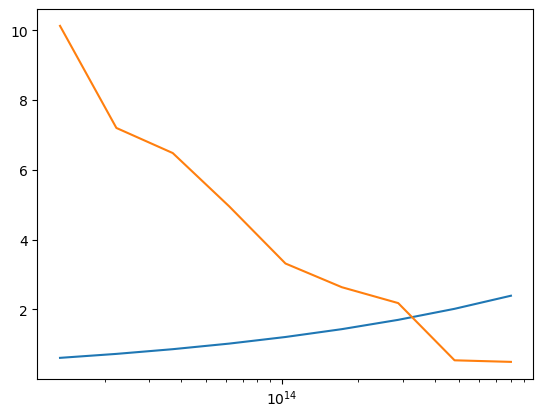

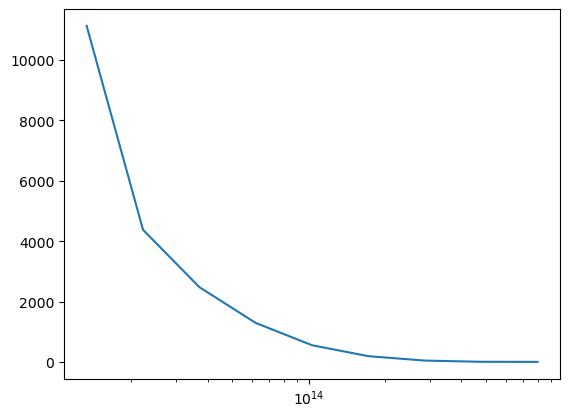

In [20]:
def get_mean_dist(mass, dist):
    bins = np.logspace(13,15,10)
    bin_mean = (bins[1:] + bins[:-1])/2
    r_list = r_vir(bin_mean, 0)
    mean_dists = []
    N = []
    for x in range(len(bins)-1):

        lo,up = bins[x], bins[x+1]
        _filter = np.where((lo <= mass) & (mass < up))[0]
        d_filt = dist[_filter]
        mean_dists.append(np.mean(d_filt))
        N.append(np.size(d_filt))

    mean_dists = np.array(mean_dists)  
    N = np.array(N)
    return mean_dists, N, bin_mean

mean_dists, N, bin_mean = get_mean_dist(mass_pairless_nbod, min_dist_nbod_pairless)
r_list = r_vir(bin_mean, 0)
plt.plot(bin_mean, r_list)
plt.plot(bin_mean, mean_dists)

plt.xscale("log")
plt.figure()
plt.plot(bin_mean, N)
plt.xscale("log")

In [23]:
bins = np.logspace(13,15,10)
bin_mean = (bins[1:] + bins[:-1])/2
r_list = r_vir(bin_mean, 0)
mean_dists = []
N = []
for x in range(len(bins)-1):

    lo,up = bins[x], bins[x+1]
    nbod_filter = np.where((lo <= mass_nbod) & (mass_nbod < up))[0]
    nbod_paired_filter = np.where((lo <= mass_paired_nbod) & (mass_paired_nbod < up))[0]
    nbod_pairless_filter = np.where((lo <= mass_pairless_nbod) & (mass_pairless_nbod < up))[0]
    emu_filter = np.where((lo <= mass_emu) & (mass_emu < up))[0]
    emu_paired_filter = np.where((lo <= mass_paired_emu) & (mass_paired_emu < up))[0]
    emu_pairless_filter = np.where((lo <= mass_pairless_emu) & (mass_pairless_emu < up))[0]

    ms = [min_dist_nbod[nbod_filter],min_dist_paired_nbod[nbod_paired_filter],min_dist_pairless_nbod[nbod_pairless_filter],
          min_dist_emu[emu_filter], min_dist_paired_emu[emu_paired_filter], min_dist_pairless_emu[emu_pairless_filter]]

    l = []
    n = []
    for x in range(6): 
        l.append(np.mean(ms[x]))
        n.append(np.size(ms[x]))
    mean_dists.append(np.array(l))
    N.append(np.array(n))

mean_dists = np.array(mean_dists)  
N = np.array(N)

In [ ]:
#A comparison of distances using all halos
plt.figure()
plt.plot(bin_mean, r_list, label="rvir")
labels=["nbod", "nbod paired", "nbod pairless", "emu", "emu paired", "emu_pairless"]
for x in range(6):
    plt.plot(bin_mean, mean_dists.T[x], label=labels[x])
plt.legend()
plt.xscale("log")

plt.figure()
labels=["nbod", "nbod paired", "nbod pairless", "emu", "emu paired", "emu_pairless"]
for x in range(6):
    plt.plot(bin_mean, N.T[x], label=labels[x])
plt.legend()
plt.xscale("log")

# Check the neighbor function (it works, one halo with no other halos within 37 Mpc!)

In [153]:
furthest = np.argsort(min_dist_nbod)[-1]
dist = calc_distance(pos_nbod[furthest], pos_nbod)

np.sort(dist)

array([   0.        ,   37.39067648,   37.77447835, ..., 1684.29384002,
       1684.91705805, 1687.60301262])

# Investigate the most massive pairless halo, do they have unpaired halos within their virial radius?

# 

# Pk for DM and HOD

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


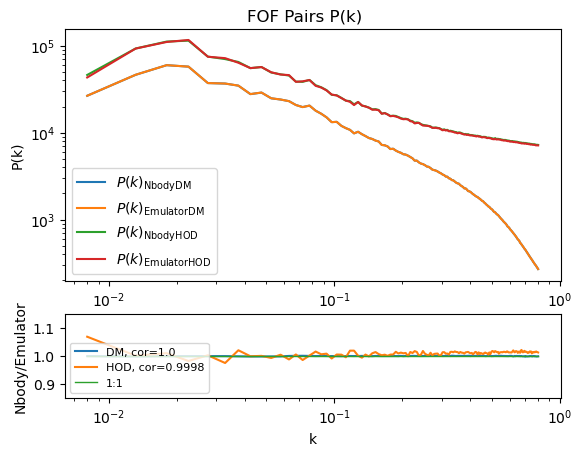

In [144]:
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
Pk_nbod = plot_power_spectra(nbody_file, emu_file, pair_file,pairs=True,
                   savename = "figures/fof_pk_pairs.pdf",title="FOF Pairs P(k)")

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


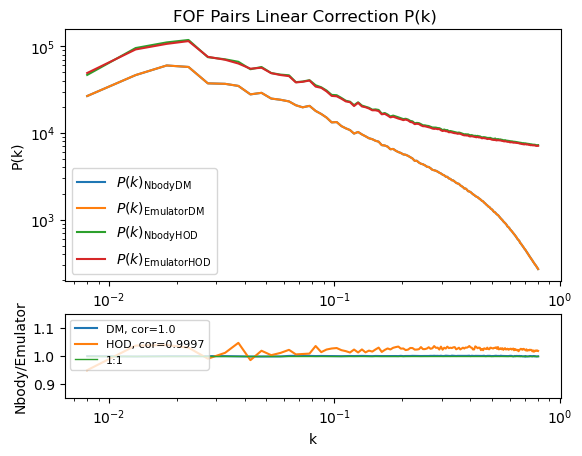

In [145]:
POWER = 1
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
plot_power_spectra(nbody_file, emu_file, pair_file,pairs=True,
                   savename = "figures/fof_pk_pairs_corr.pdf",title="FOF Pairs Linear Correction P(k)",corr=1)

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


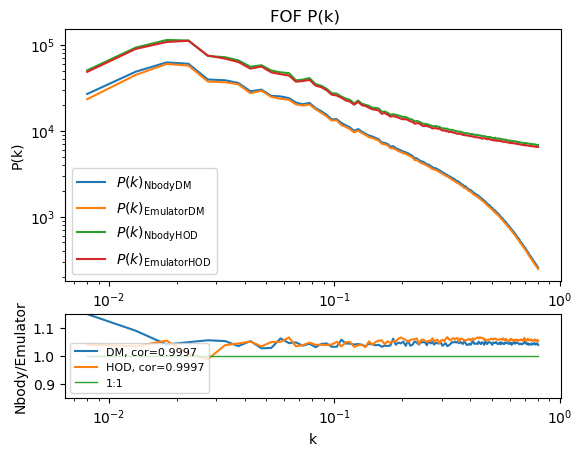

In [146]:
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
plot_power_spectra(nbody_file, emu_file, pair_file,pairs=False,
                   savename = "figures/fof_pk.pdf",title="FOF P(k)")

yt : [INFO     ] 2023-07-31 09:45:27,470 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-31 09:45:27,472 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-31 09:45:27,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-31 09:45:27,473 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-31 09:45:27,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-31 09:45:27,474 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-31 09:45:27,474 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-31 09:45:27,475 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-31 09:45:27,475 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-31 09:45:27,476 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-31 09:45:27,514 Parameters: current

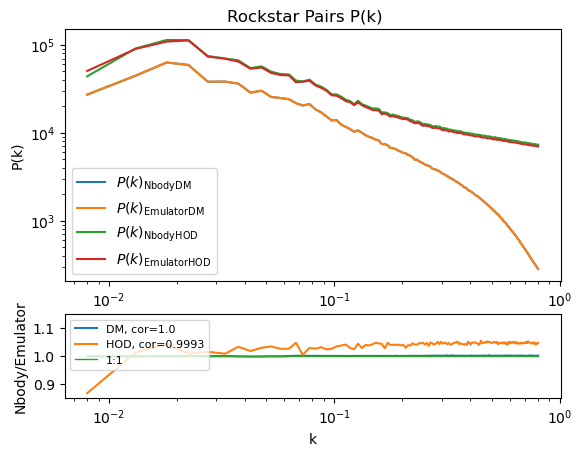

In [147]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'rs_pairs'
plot_power_spectra(nbody_file, emu_file, pair_file,pairs=True, fof=False,savename = "figures/rs_pk_pairs.pdf",title="Rockstar Pairs P(k)")


yt : [INFO     ] 2023-07-31 09:45:36,865 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-31 09:45:36,867 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-31 09:45:36,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-31 09:45:36,868 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-31 09:45:36,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-31 09:45:36,869 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-31 09:45:36,869 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-31 09:45:36,870 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-31 09:45:36,870 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-31 09:45:36,870 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-31 09:45:36,907 Parameters: current

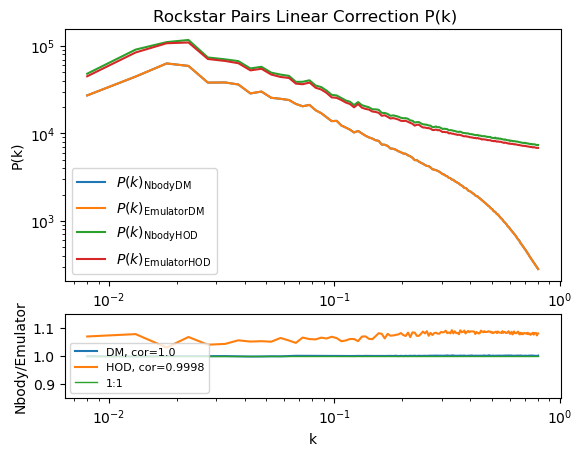

In [148]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'rs_pairs'
plot_power_spectra(nbody_file, emu_file, pair_file,pairs=True, fof=False,savename = "figures/rs_pk_pairs_corr.pdf",title="Rockstar Pairs Linear Correction P(k)", corr=1)


yt : [INFO     ] 2023-07-31 09:45:46,297 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-31 09:45:46,298 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-31 09:45:46,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-31 09:45:46,300 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-31 09:45:46,300 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-31 09:45:46,301 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-31 09:45:46,301 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-31 09:45:46,301 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-31 09:45:46,301 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-31 09:45:46,302 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-31 09:45:46,339 Parameters: current

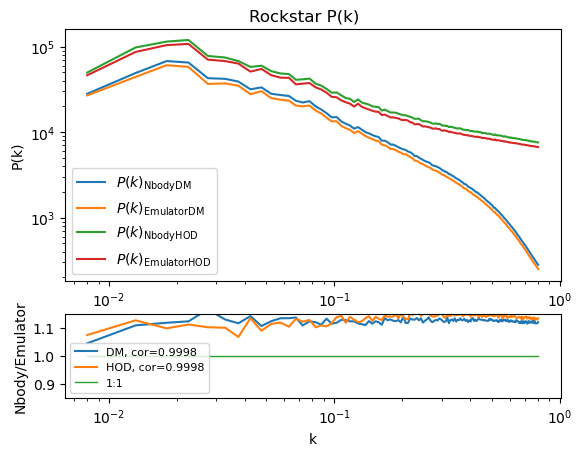

In [149]:
nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'rs_pairs'
plot_power_spectra(nbody_file, emu_file, pair_file,pairs=False, fof=False,savename = "figures/rs_pk.pdf",title="Rockstar P(k)")


# Unbound Threshold

yt : [INFO     ] 2023-08-10 19:32:39,017 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-08-10 19:32:39,018 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-08-10 19:32:39,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-08-10 19:32:39,020 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-08-10 19:32:39,021 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-08-10 19:32:39,021 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-08-10 19:32:39,021 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-08-10 19:32:39,022 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-08-10 19:32:39,022 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-08-10 19:32:39,022 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-08-10 19:32:39,025 Allocating for 5.11

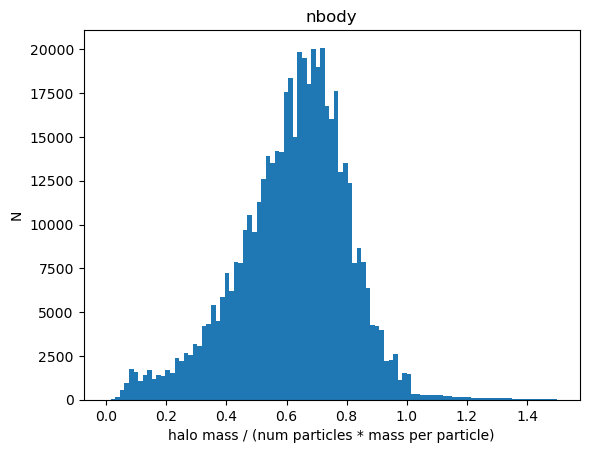

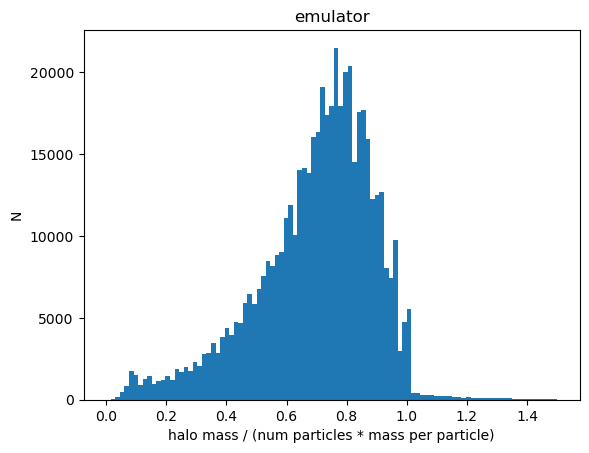

In [609]:
dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
num_p      = np.array(dsnbody.all_data()["num_p"])
bound_frac = mass_nbod/num_p/mass_per_particle
plt.hist(bound_frac, bins=np.linspace(0,1.5,100))
plt.ylabel("N")
plt.xlabel("halo mass / (num particles * mass per particle)")
plt.title("nbody")
plt.savefig("figures/unbound_hist_nbody.pdf")
    
plt.figure()

dsnbody = yt.load("particle_test_emu/halos_0.0.bin")
mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
num_p      = np.array(dsnbody.all_data()["num_p"])
bound_frac = mass_nbod/num_p/mass_per_particle
plt.hist(bound_frac, bins=np.linspace(0,1.5,100))
plt.ylabel("N")
plt.xlabel("halo mass / (num particles * mass per particle)")
plt.title("emulator")
plt.savefig("figures/unbound_hist_emu.pdf")


# Graveyard August 7th

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
/tmp/ipykernel_6704/1261557214.py:17: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if(bins == []): mass_range = np.logspace(log_low_m,16,20)
/tmp/ipykernel_6704/801647689.py:10: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(mass_range[:-1], hmf_nbody/hmf_emu,label="a="+str(a))


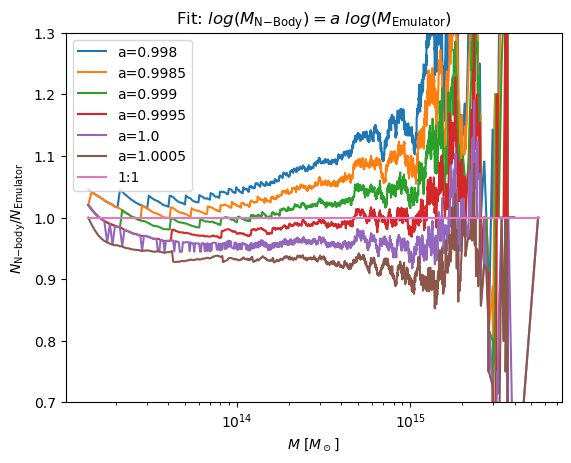

In [21]:
nbody_file, emu_file, pair_file = 'fof_halos/lh0000_nbody','fof_halos/lh0000_emu','fof_pairs'
mass_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=True)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu,unique_bins = mass_combos

mass_range,hmf_nbody = get_hmf(mass_paired_nbod, bins=unique_bins)
a_range = np.arange(0.998,1.001,0.0005)
for a in a_range:
    a = round(a*10000)/10000
    mass_range, hmf_emu = get_hmf(np.power(10.0,np.log10(mass_paired_emu)*a), bins=unique_bins)
    plt.plot(mass_range[:-1], hmf_nbody/hmf_emu,label="a="+str(a))
    
plt.plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")    
plt.legend(loc = "upper left")
plt.ylim(0.7,1.3)
plt.xscale("log")
plt.xlabel(r"$M \ [M_\odot]$")
plt.ylabel(r"$N_{\rm N{-}body}/ N_{\rm Emulator}$")
plt.title(r"Fit: $log(M_{\rm N{-}Body}) = a \ log(M_{\rm Emulator})$")
plt.savefig("figures/fofcor_hmf_comp.pdf")


nbody_file, emu_file, pair_file = "particle_test_nbody/halos_0.0.bin","particle_test_emu/halos_0.0.bin",'rs_pairs'
mass_combos = get_mass_combos(nbody_file, emu_file, pair_file, fof=False)
mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, mass_pairless_nbod,mass_pairless_emu,unique_bins = mass_combos

mass_range,hmf_nbody = get_hmf(mass_paired_nbod, bins=unique_bins)
a_range = np.arange(0.998,1.001,0.0005)
for a in a_range:
    a = round(a*10000)/10000
    mass_range, hmf_emu = get_hmf(np.power(10.0,np.log10(mass_paired_emu)*a), bins=unique_bins)
    plt.plot(mass_range[:-1], hmf_nbody/hmf_emu,label="a="+str(a))
    
plt.plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")    
plt.legend(loc = "upper left")
plt.ylim(0.7,1.3)
plt.xscale("log")
plt.xlabel(r"$M \ [M_\odot]$")
plt.ylabel(r"$N_{\rm N{-}body}/ N_{\rm Emulator}$")
plt.title(r"Fit: $log(M_{\rm N{-}Body}) = a \ log(M_{\rm Emulator})$")
plt.savefig("figures/rscor_hmf_comp.pdf")


# Does a different LL change rockstar outputs?

In [191]:
dsemu= yt.load('rockstar_comparisons/test_default_emu/halos_0.0.bin')
dsnbod= yt.load('rockstar_comparisons/test_default_nbody/halos_0.0.bin')
dsemull = yt.load('rockstar_lowll_emu/halos_0.0.bin')
dsnbodll = yt.load('rockstar_lowll_nbod/halos_0.0.bin')

yt : [INFO     ] 2023-07-20 17:53:19,871 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-20 17:53:19,872 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-20 17:53:19,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-20 17:53:19,873 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-20 17:53:19,873 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-20 17:53:19,874 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-20 17:53:19,874 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-20 17:53:19,874 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-20 17:53:19,874 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-20 17:53:19,874 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-20 17:53:19,914 Parameters: current

In [194]:
hmfemu

array([515294., 515294., 515294., 515294., 515294., 515294., 515294.,
       515294., 515294., 515294., 515294., 515294., 515294., 515294.,
       515294., 515294., 515294., 515294., 515294.])

ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.


/tmp/ipykernel_13622/1271018603.py:6: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemu, label ="LL=0.28 (default) nbod/emu")
/tmp/ipykernel_13622/1271018603.py:7: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemull, label="emu_LL=0.2 nbod/emu")


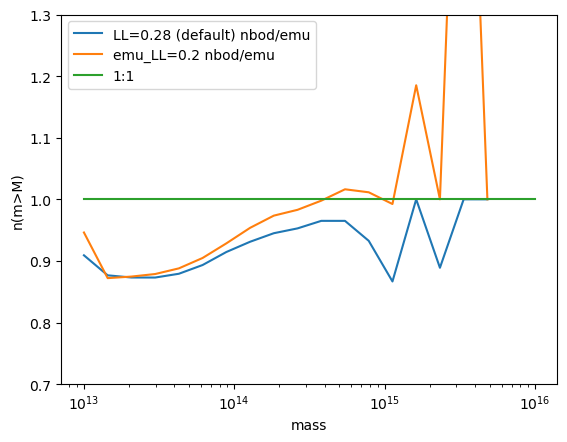

In [201]:
mass_range, hmfemu = get_hmf(dsemu.all_data()["particle_mass"].to("Msun/h"))
mass_range, hmfnbod = get_hmf(dsnbod.all_data()["particle_mass"].to("Msun/h"))
mass_range, hmfemull = get_hmf(dsemull.all_data()["particle_mass"].to("Msun/h"))
mass_range, hmfnbodll = get_hmf(dsnbodll.all_data()["particle_mass"].to("Msun/h"))

plt.plot(mass_range[:-1], hmfnbod/hmfemu, label ="LL=0.28 (default) nbod/emu")
plt.plot(mass_range[:-1], hmfnbod/hmfemull, label="emu_LL=0.2 nbod/emu")
plt.ylim(0.7,1.3)
plt.plot([1e13,1e16], [1,1], label="1:1")
plt.xscale("log")
plt.xlabel("mass")
plt.ylabel("n(m>M)")
plt.legend()
plt.savefig("figures/rs_ll_test.pdf",bbox_inches="tight")

# Comparing nbody halos to rockstar haloes with an alternative mass definition

In [204]:
dsnbod= yt.load('rockstar_comparisons/test_default_nbody/halos_0.0.bin')
dsemu= yt.load('rockstar_mass_vary/halos_0.0.bin')

yt : [INFO     ] 2023-07-20 18:22:16,850 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-20 18:22:16,851 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-20 18:22:16,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-20 18:22:16,853 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-20 18:22:16,854 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-20 18:22:16,855 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-20 18:22:16,855 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-20 18:22:16,855 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-20 18:22:16,856 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-20 18:22:16,856 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-20 18:22:16,894 Parameters: current

ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.
ERROR IN get_hmf(mass), mass isn't filtered.


/tmp/ipykernel_13622/4154560467.py:8: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemu, label ="vir (default)")
/tmp/ipykernel_13622/4154560467.py:9: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemu2, label ="220b")
/tmp/ipykernel_13622/4154560467.py:10: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemu3, label ="250b")
/tmp/ipykernel_13622/4154560467.py:11: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemu4, label ="300b")
/tmp/ipykernel_13622/4154560467.py:12: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmfnbod/hmfemu5, label ="350b")


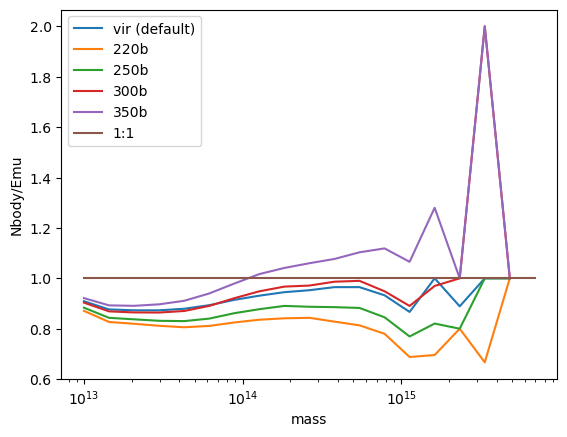

In [210]:
mass_range, hmfnbod = get_hmf(dsnbod.all_data()["particle_mass"].to("Msun/h"))# mass_range, hmfemu = get_hmf(dsemu.all_data()["particle_mass"].to("Msun/h"))
mass_range, hmfemu = get_hmf(dsemu.all_data()["particle_mass"].to("Msun/h"))
mass_range, hmfemu2 = get_hmf(dsemu.all_data()["alt_m1"].to("Msun/h"))
mass_range, hmfemu3 = get_hmf(dsemu.all_data()["alt_m2"].to("Msun/h"))
mass_range, hmfemu4 = get_hmf(dsemu.all_data()["alt_m3"].to("Msun/h"))
mass_range, hmfemu5 = get_hmf(dsemu.all_data()["alt_m4"].to("Msun/h"))

plt.plot(mass_range[:-1], hmfnbod/hmfemu, label ="vir (default)")
plt.plot(mass_range[:-1], hmfnbod/hmfemu2, label ="220b")
plt.plot(mass_range[:-1], hmfnbod/hmfemu3, label ="250b")
plt.plot(mass_range[:-1], hmfnbod/hmfemu4, label ="300b")
plt.plot(mass_range[:-1], hmfnbod/hmfemu5, label ="350b")
plt.plot(mass_range[:-1], np.linspace(1,1,len(mass_range)-1),label="1:1")
plt.xscale("log")
plt.xlabel("mass")
plt.ylabel("Nbody/Emu")
plt.legend()
plt.savefig("figures/alternative_mass.pdf")

# GRAVEYARD Jul 20th 2023

# Mass corrections for FOF

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

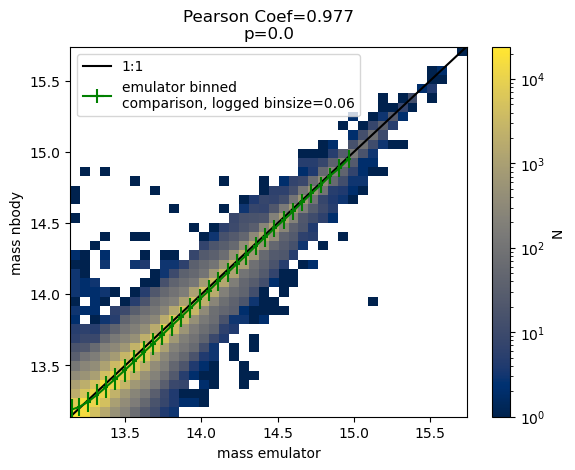

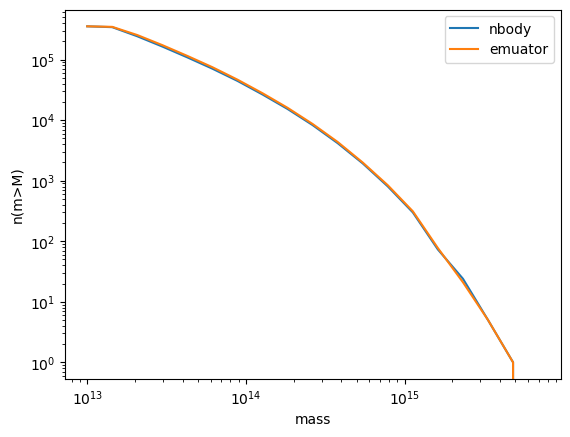

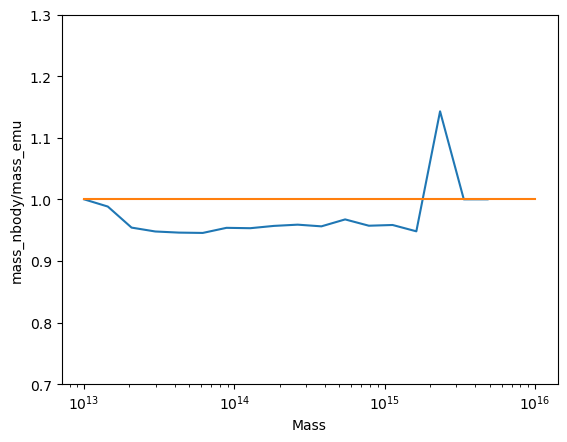

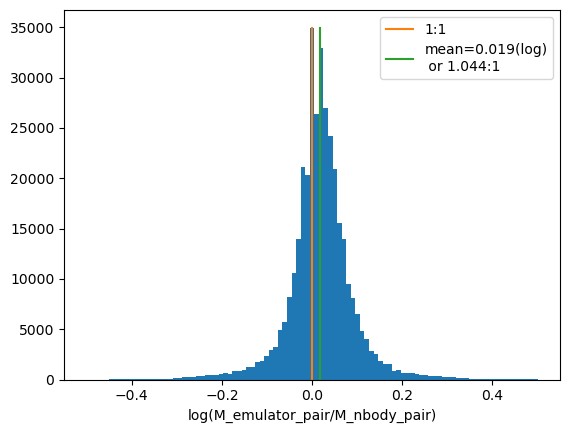

In [57]:
mass_paired_emu = np.power(10.0,emu_pair)
mass_paired_nbod = np.power(10.0,nbod_pair)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_fof.pdf", bbox_inches="tight")


mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)

plt.figure()
plt.plot(mass_range[:-1], hmf_nbody,label="nbody")
plt.plot(mass_range[:-1], hmf_emu, label='emuator')
plt.yscale("log")
plt.xscale("log")
plt.legend()
plt.xlabel("mass")
plt.ylabel("n(m>M)")
plt.savefig("figures/hmf_fof.pdf", bbox_inches="tight")

plt.figure()
mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)
plt.plot(mass_range[:-1], hmf_nbody/hmf_emu,label="nbody/emu")
plt.plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")
#plt.yscale("log")
plt.ylim(0.7,1.3)
plt.xscale("log")
plt.xlabel("Mass")
plt.ylabel("mass_nbody/mass_emu")
plt.savefig("figures/hmf_ratio_fof.pdf", bbox_inches="tight")

plt.figure()
paired_nbod = np.where(ids_nbod != -1)[0]
#mass_paired_emu, mass_paired_nbod = mass_emu[emu_args2],mass_nbod[nbod_args2]
log_rat = np.log10(mass_paired_emu/mass_paired_nbod)
bins = np.linspace(-0.5,0.5,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(M_emulator_pair/M_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/pair_ratio_fof.pdf", bbox_inches="tight")




In [59]:
log_mass_emulator_pair = np.log10(mass_emu[emu_args2])
log_mass_nbody_pair = np.log10(mass_nbod[nbod_args2])

mass_filter = np.where((log_mass_emulator_pair > 13) & (log_mass_nbody_pair > 13))

log_mass_emulator_pair = log_mass_emulator_pair[mass_filter]
log_mass_nbody_pair = log_mass_nbody_pair[mass_filter]



############# 1 ##############
# def mass_emu_calc(log_nbody_mass, a):
#     return a * log_nbody_mass



# def scale_emu_mass(log_emu_mass, a):
#     return (log_emu_mass)/a



# popt, pcov = curve_fit(mass_emu_calc, log_mass_nbody_pair, log_mass_emulator_pair)
# a = popt[0]

# log_mass_emu_corrected = scale_emu_mass(log_mass_emulator_pair, a)







######### 2 ##########
# def mass_emu_correction(log_emu_mass, a,b,c):
#     return a * log_emu_mass + b * np.power(log_emu_mass, 2.0) + c * np.power(log_emu_mass, 3.0)


# popt, pcov = curve_fit(mass_emu_correction, log_mass_emulator_pair, log_mass_nbody_pair)

# a,b,c = popt
# log_mass_emu_corrected = mass_emu_correction(log_mass_emulator_pair, a,b,c)




##################### 3 #######
def mass_emu_correction_function(log_emu_mass, a,b,c):
    #return a * log_emu_mass 
    return a * log_emu_mass + b * np.power(log_emu_mass, 2.0) + c * np.power(log_emu_mass, 3.0)



def mass_emu_correction(log_emu_mass, log_nbody_mass):

    #bins = np.linspace(12,16,8)
    bins = [13,13.25,13.5,13.75,14,14.5,14.75, 15,15.25]
    bins = np.arange(13,15.25,0.15)
    m_emu_corrected = []
    m_nbod_corrected = []
    for x in range(len(bins)-1):
        indices = np.where((log_emu_mass < bins[x+1]) & (log_emu_mass >= bins[x]))[0]
     
        me = log_emu_mass[indices]
        mn = log_nbody_mass[indices]
        
        popt, pcov = curve_fit(mass_emu_correction_function, me, mn)
        #a= popt[0]
        a,b,c = popt[0], popt[1], popt[2]
        print(bins[x], a)
        
        m_nbod_corrected.extend(list(mn))
        m_emu_corrected.extend(list(mass_emu_correction_function(me, a,b,c)))
    
    m_emu_corrected = np.array(m_emu_corrected)
    m_nbod_corrected = np.array(m_nbod_corrected)
    
    return m_emu_corrected, m_nbod_corrected

log_mass_emu_corrected, log_mass_nbody_pair = mass_emu_correction(log_mass_emulator_pair, log_mass_nbody_pair)

#################### 4 #######
# x,y = log_mass_emulator_pair, log_mass_nbody_pair

# sort_args = np.argsort(x)
# x = x[sort_args]
# y = y[sort_args]
# from scipy.interpolate import UnivariateSpline
# spl = UnivariateSpline(x,y)
# log_mass_emu_corrected = spl(x)



/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


13.0 -2831.722181748692
13.15 33.760154314101754
13.3 2.2892339525566876
13.450000000000001 1.6940423404764966
13.600000000000001 1.5524438042345254
13.750000000000002 -1.336544755209535
13.900000000000002 -2.187653296721152
14.050000000000002 -6.390337718592556
14.200000000000003 -8.78673988420543
14.350000000000003 8.020113773278391
14.500000000000004 -0.8594957300594563
14.650000000000004 -0.4635080805878271
14.800000000000004 -2.0291198334477363
14.950000000000005 -8.625756229996016


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

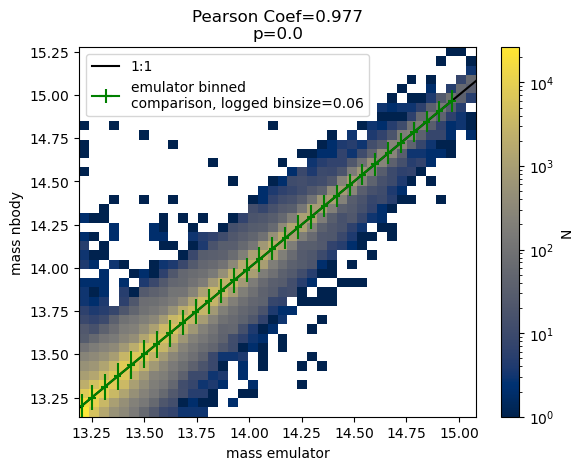

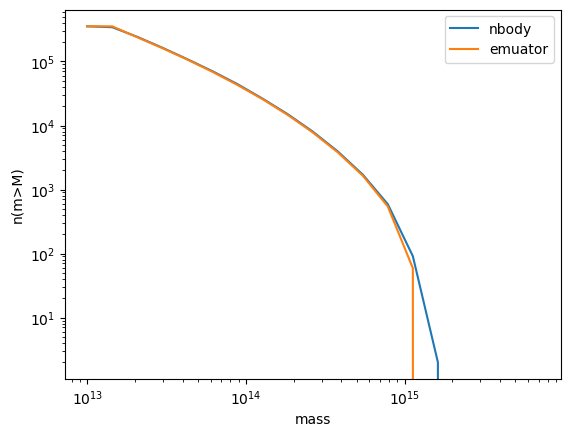

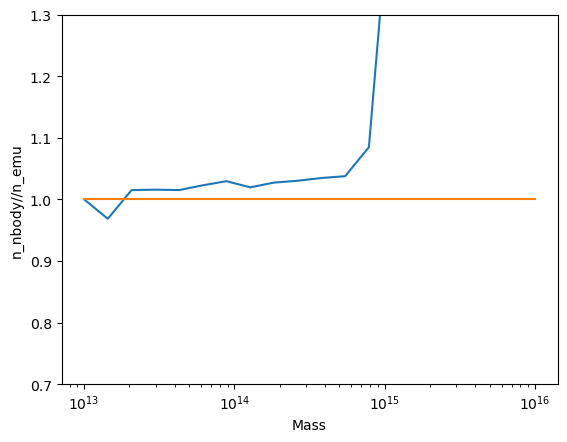

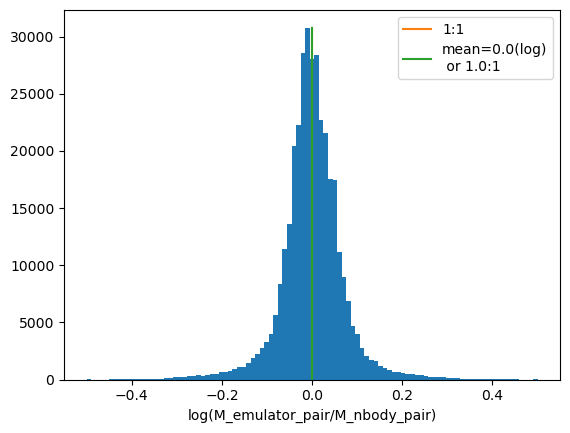

In [60]:
mass_paired_emu = np.power(10.0,log_mass_emu_corrected)
mass_paired_nbod = np.power(10.0,log_mass_nbody_pair)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_corrected_fof.pdf", bbox_inches="tight")




mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)

plt.figure()
plt.plot(mass_range[:-1], hmf_nbody,label="nbody")
plt.plot(mass_range[:-1], hmf_emu, label='emuator')
plt.yscale("log")
plt.xscale("log")
plt.legend()
plt.xlabel("mass")
plt.ylabel("n(m>M)")
plt.savefig("figures/hmf_corrected_fof.pdf", bbox_inches="tight")

plt.figure()
mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)
plt.plot(mass_range[:-1], hmf_nbody/hmf_emu,label="nbody/emu")
plt.plot([np.min(mass_range), np.max(mass_range)], [1,1], label="1:1")
#plt.yscale("log")
plt.ylim(0.7,1.3)
plt.xscale("log")
plt.xlabel("Mass")
plt.ylabel("n_nbody//n_emu")
plt.savefig("figures/hmf_ratio_corrected_fof.pdf", bbox_inches="tight")

plt.figure()
paired_nbod = np.where(ids_nbod != -1)[0]
#mass_paired_emu, mass_paired_nbod = mass_emu[emu_args2],mass_nbod[nbod_args2]
log_rat = np.log10(mass_paired_emu/mass_paired_nbod)
bins = np.linspace(-0.5,0.5,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(M_emulator_pair/M_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/pair_ratio_corrected_fof.pdf", bbox_inches="tight")




# Mass corrections for RS

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

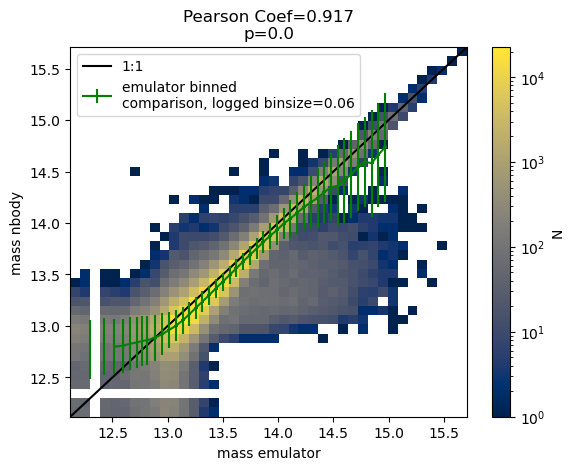

In [97]:
mass_paired_emu = np.power(10.0,emu_pair)
mass_paired_nbod = np.power(10.0,nbod_pair)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_corrected.pdf", bbox_inches="tight")

In [141]:
log_mass_emulator_pair = np.log10(mass_emu[emu_args2].value)
log_mass_nbody_pair = np.log10(mass_nbod[nbod_args2].value)

mass_filter = np.where((log_mass_emulator_pair > 13) & (log_mass_nbody_pair > 13))

log_mass_emulator_pair = log_mass_emulator_pair[mass_filter]
log_mass_nbody_pair = log_mass_nbody_pair[mass_filter]


def mass_emu_calc(log_nbody_mass, a):
    return a * log_nbody_mass



def scale_emu_mass(log_emu_mass, a):
    return (log_emu_mass)/a



popt, pcov = curve_fit(mass_emu_calc, log_mass_nbody_pair, log_mass_emulator_pair)
a = popt[0]

log_mass_nbody = log_mass_nbody_pair
log_mass_emu_corrected = scale_emu_mass(log_mass_emulator_pair, a)

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

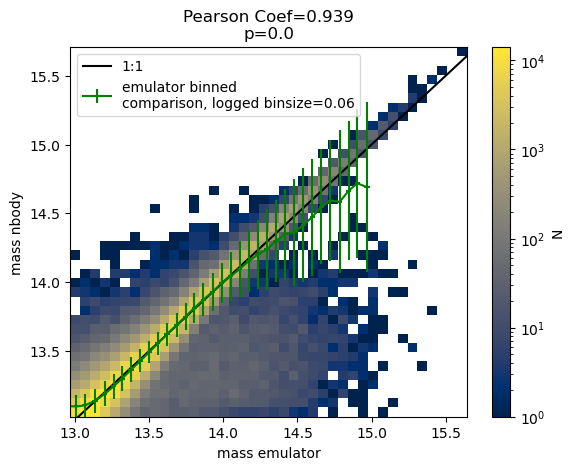

In [142]:
mass_paired_emu = np.power(10.0,log_mass_emu_corrected)
mass_paired_nbod = np.power(10.0,log_mass_nbody)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_corrected.pdf", bbox_inches="tight")

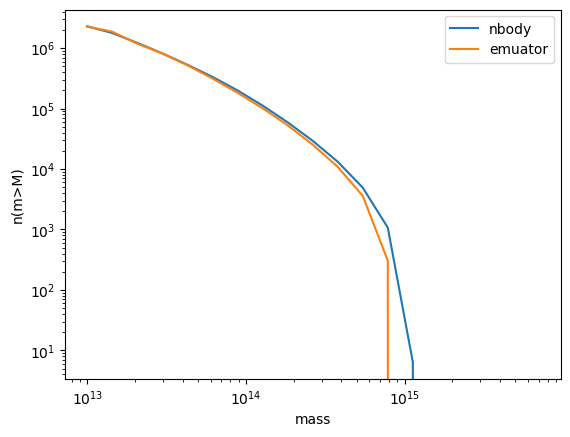

In [182]:
def get_hmf(mass):
    log_mass = np.log10(mass)
    mass_range = np.logspace(13,16,20)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass >= lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf

mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)

plt.figure()
plt.plot(mass_range[:-1], hmf_nbody,label="nbody")
plt.plot(mass_range[:-1], hmf_emu, label='emuator')
plt.yscale("log")
plt.xscale("log")
plt.legend()
plt.xlabel("mass")
plt.ylabel("n(m>M)")
plt.savefig("figures/hmf_corrected.pdf", bbox_inches="tight")

plt.figure()
mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)
plt.plot(mass_range[:-1], hmf_nbody/hmf_emu)
#plt.yscale("log")
plt.ylim(0.7,1.3)
plt.xscale("log")
plt.xlabel("Mass")
plt.ylabel("mass_nbody/mass_emu")
plt.savefig("figures/hmf_ratio_corrected.pdf", bbox_inches="tight")

plt.figure()
paired_nbod = np.where(ids_nbod != -1)[0]
#mass_paired_emu, mass_paired_nbod = mass_emu[emu_args2],mass_nbod[nbod_args2]
log_rat = np.log10(mass_paired_emu/mass_paired_nbod)
bins = np.linspace(-0.5,0.5,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(M_emulator_pair/M_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/pair_ratio_corrected.pdf", bbox_inches="tight")




In [152]:
log_mass_emulator_pair = np.log10(mass_emu[emu_args2].value)
log_mass_nbody_pair = np.log10(mass_nbod[nbod_args2].value)

mass_filter = np.where((log_mass_emulator_pair > 13) & (log_mass_nbody_pair > 13))

log_mass_emulator_pair = log_mass_emulator_pair[mass_filter]
log_mass_nbody_pair = log_mass_nbody_pair[mass_filter]

def mass_emu_correction(log_emu_mass, a,b,c):
    return a * log_emu_mass + b * np.power(log_emu_mass, 2.0) + c * np.power(log_emu_mass, 3.0)


popt, pcov = curve_fit(mass_emu_correction, log_mass_emulator_pair, log_mass_nbody_pair)

a,b,c = popt
log_mass_emu_corrected = mass_emu_correction(log_mass_emulator_pair, a,b,c)


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

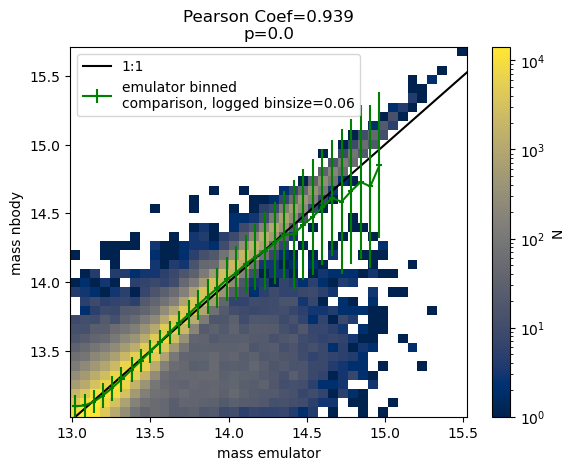

In [153]:
mass_paired_emu = np.power(10.0,log_mass_emu_corrected)
mass_paired_nbod = np.power(10.0,log_mass_nbody_pair)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_corrected.pdf", bbox_inches="tight")

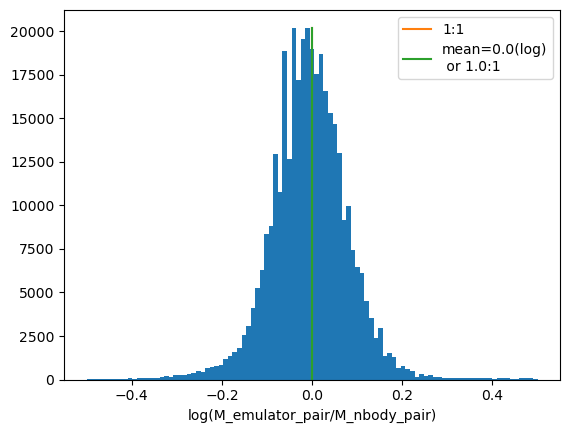

In [154]:
paired_nbod = np.where(ids_nbod != -1)[0]
#mass_paired_emu, mass_paired_nbod = mass_emu[emu_args2],mass_nbod[nbod_args2]
log_rat = np.log10(mass_paired_emu/mass_paired_nbod)
bins = np.linspace(-0.5,0.5,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(M_emulator_pair/M_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/pair_ratio_corrected.pdf", bbox_inches="tight")


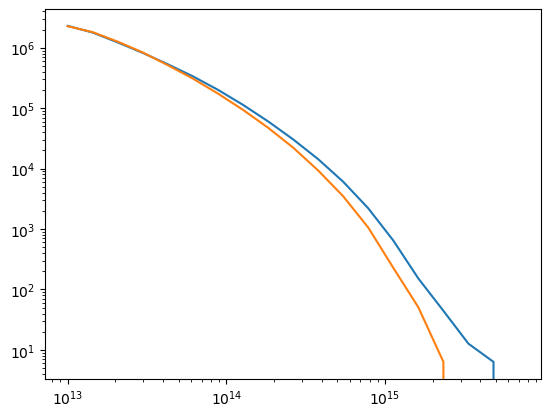

In [155]:
mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)


plt.plot(mass_range[:-1], hmf_nbody)
plt.plot(mass_range[:-1], hmf_emu)
plt.yscale("log")
plt.xscale("log")

In [157]:
log_mass_emulator_pair = np.log10(mass_emu[emu_args2].value)
log_mass_nbody_pair = np.log10(mass_nbod[nbod_args2].value)


mass_filter = np.where((log_mass_emulator_pair > 13) & (log_mass_nbody_pair > 13))

log_mass_emulator_pair = log_mass_emulator_pair[mass_filter]
log_mass_nbody_pair = log_mass_nbody_pair[mass_filter]




def mass_emu_correction_function(log_emu_mass, a):
    return a * log_emu_mass 
    #return a * log_emu_mass + b * np.power(log_emu_mass, 2.0) + c * np.power(log_emu_mass, 3.0)



def mass_emu_correction(log_emu_mass, log_nbody_mass):

    #bins = np.linspace(12,16,8)
    bins = [13,13.25,13.5,13.75, 15]
    m_emu_corrected = []
    m_nbod_corrected = []
    for x in range(len(bins)-1):
        indices = np.where((log_emu_mass < bins[x+1]) & (log_emu_mass >= bins[x]))[0]
     
        me = log_emu_mass[indices]
        mn = log_nbody_mass[indices]
        
        popt, pcov = curve_fit(mass_emu_correction_function, me, mn)
        a= popt[0]
        #a,b,c = popt[0], popt[1], popt[2]
        print(bins[x], a)
        
        m_nbod_corrected.extend(list(mn))
        m_emu_corrected.extend(list(mass_emu_correction_function(me, a)))
    
    m_emu_corrected = np.array(m_emu_corrected)
    m_nbod_corrected = np.array(m_nbod_corrected)
    
    return m_emu_corrected, m_nbod_corrected




m_emu_corrected, m_nbod_corrected = mass_emu_correction(log_mass_emulator_pair, log_mass_nbody_pair)

13 0.9977861976870271
13.25 0.9946712136031772
13.5 0.995514093913618
13.75 0.9950259107209982


/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

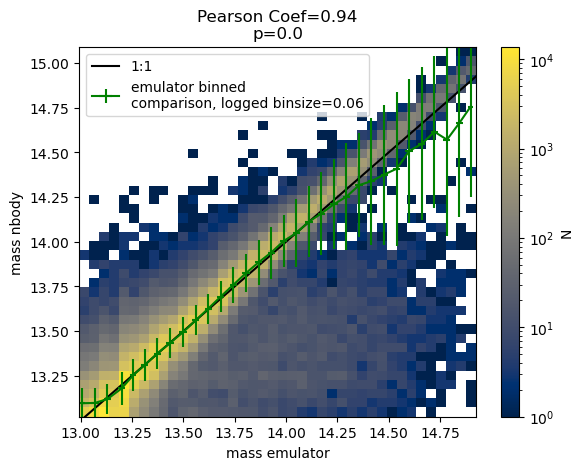

In [167]:
mass_paired_emu = np.power(10.0,m_emu_corrected)
mass_paired_nbod = np.power(10.0,m_nbod_corrected)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_corrected.pdf", bbox_inches="tight")

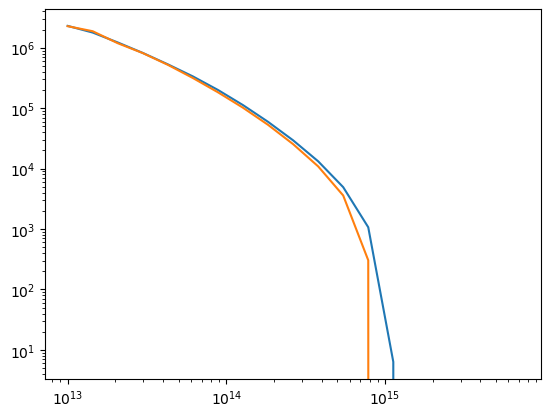

In [169]:
mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)


plt.plot(mass_range[:-1], hmf_nbody)
plt.plot(mass_range[:-1], hmf_emu)
plt.yscale("log")
plt.xscale("log")

/tmp/ipykernel_4106/2875282330.py:5: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(mass_range[:-1], hmf_nbody/hmf_emu)
/tmp/ipykernel_4106/2875282330.py:5: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range[:-1], hmf_nbody/hmf_emu)


Text(0, 0.5, 'mass_nbody/mass_emu')

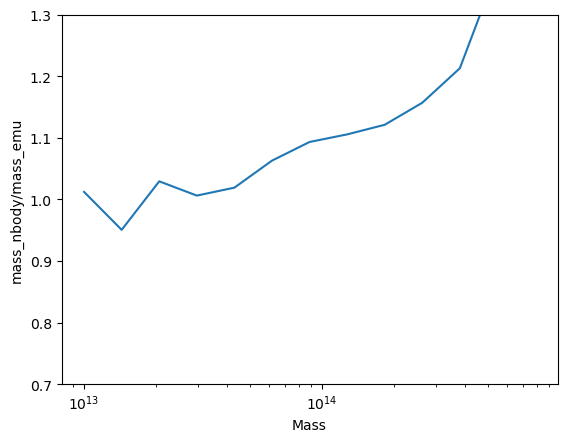

In [168]:
mass_range, hmf_nbody = get_hmf(mass_paired_nbod)
mass_range, hmf_emu = get_hmf(mass_paired_emu)


plt.plot(mass_range[:-1], hmf_nbody/hmf_emu)
#plt.yscale("log")
plt.ylim(0.7,1.3)
plt.xscale("log")
plt.xlabel("Mass")
plt.ylabel("mass_nbody/mass_emu")

In [185]:
log_mass_emulator_pair = np.log10(mass_emu[emu_args2].value)
log_mass_nbody_pair = np.log10(mass_nbod[nbod_args2].value)

mass_filter = np.where((log_mass_emulator_pair > 13) & (log_mass_nbody_pair > 13))

log_mass_emulator_pair = log_mass_emulator_pair[mass_filter]
log_mass_nbody_pair = log_mass_nbody_pair[mass_filter]
x,y = log_mass_emulator_pair, log_mass_nbody_pair

sort_args = np.argsort(x)
x = x[sort_args]
y = y[sort_args]
from scipy.interpolate import UnivariateSpline
spl = UnivariateSpline(x,y)
spl(x)

array([13.03364316, 13.03364316, 13.03364316, ..., 14.39295996,
       14.36780363, 14.14707569])

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/numpy/core/_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type

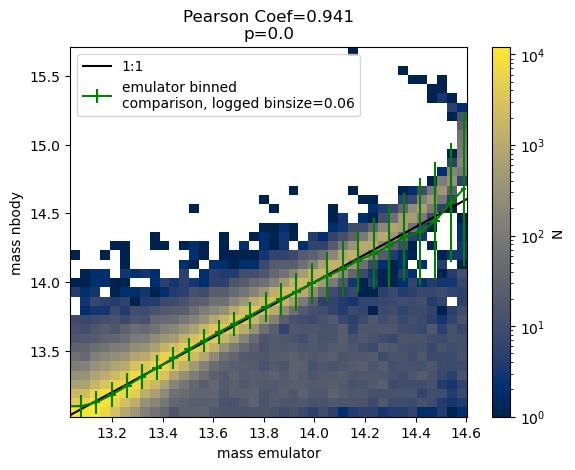

In [187]:
mass_paired_emu = np.power(10.0,spl(x))
mass_paired_nbod = np.power(10.0,y)

res = stats.pearsonr(np.log10(mass_paired_emu), np.log10(mass_paired_nbod))
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty_corrected.pdf", bbox_inches="tight")

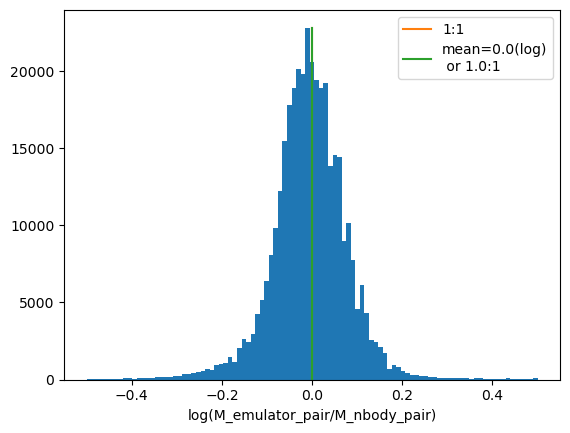

In [188]:
#paired_nbod = np.where(ids_nbod != -1)[0]
#mass_paired_emu, mass_paired_nbod = mass_emu[emu_args2],mass_nbod[nbod_args2]
log_rat = np.log10(mass_paired_emu/mass_paired_nbod)
bins = np.linspace(-0.5,0.5,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(M_emulator_pair/M_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/pair_ratio_corrected.pdf", bbox_inches="tight")


## FOF and RS comparisons

In [77]:
f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
f0emu = BigFileCatalog('fof_halos/lh0000_emu')
f1nbody = BigFileCatalog('fof_halos/lh0001_nbody')
f1emu = BigFileCatalog('fof_halos/lh0001_emu')
f0emul15 = BigFileCatalog('fof_halos/lh0000_emu_ll15')
f0emul19 = BigFileCatalog('fof_halos/lh0000_emu_ll19')


rs0nbody = yt.load("rockstar_comparisons/test_default_nbody/halos_0.0.bin")
rs0emu = yt.load("rockstar_comparisons/test_default_emu/halos_0.0.bin")
rs1nbody = yt.load("cosmo2_halos/test_default_nbody/halos_0.0.bin")
rs1emu = yt.load("cosmo2_halos/test_default_borg_emu/halos_0.0.bin")

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)
yt : [INFO     ] 2023-06-28 15:54:58,677 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-06-28 15:54:58,679 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-28 15:54:58,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-28 15:54:58,680 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-28 15:54:58,680 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-28 15:54:58,680 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-28 15:54:58,680 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     

In [78]:


def get_hmf(ds):
    ds = ds.all_data()
    mass = ds["particle_mass"].to('Msun')
    mass_range = np.logspace(12,16,20)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass > lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf



def get_hmf_fof(f):
    mass = np.array(f["Mass"])
    mass_range = np.logspace(12,16,20)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass > lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf

mass_range, fof0n = get_hmf_fof(f0nbody)
mass_range, fof0e  = get_hmf_fof(f0emu)
mass_range, fof0ell15  = get_hmf_fof(f0emul15)
mass_range, fof0ell19  = get_hmf_fof(f0emul19)
mass_range, fof1n  = get_hmf_fof(f1nbody)
mass_range, fof1e  = get_hmf_fof(f1emu)


mass_range, rs0n  = get_hmf(rs0nbody)
mass_range, rs0e  = get_hmf(rs0emu)
mass_range, rs1n  = get_hmf(rs1nbody)
mass_range, rs1e  = get_hmf(rs1emu)


yt : [INFO     ] 2023-06-28 15:55:03,794 Allocating for 5.110e+05 particles
Loading particle index: 100%|███████████████| 2/2 [00:00<00:00, 5596.14it/s]
yt : [INFO     ] 2023-06-28 15:55:04,920 Allocating for 5.153e+05 particles
Loading particle index: 100%|███████████████| 2/2 [00:00<00:00, 6716.26it/s]
yt : [INFO     ] 2023-06-28 15:55:05,359 Allocating for 4.889e+05 particles
Loading particle index: 100%|███████████████| 2/2 [00:00<00:00, 5903.31it/s]
yt : [INFO     ] 2023-06-28 15:55:05,806 Allocating for 4.887e+05 particles
Loading particle index: 100%|███████████████| 2/2 [00:00<00:00, 5882.61it/s]


In [ ]:
def 
    a *np.log10(M_nbody) + b = np.log10(M_emu)

/tmp/ipykernel_88477/3870165312.py:11: RuntimeWarning: invalid value encountered in divide
  axs[1][0].plot(mass_range[:-1], fof0n/fof0e,label="FOF0N/FOF0E")
/tmp/ipykernel_88477/3870165312.py:12: RuntimeWarning: invalid value encountered in divide
  axs[1][0].plot(mass_range[:-1], fof0n/fof0ell15,label="FOF0N/FOF0EL15")
/tmp/ipykernel_88477/3870165312.py:13: RuntimeWarning: invalid value encountered in divide
  axs[1][0].plot(mass_range[:-1], fof0n/fof0ell19,label="FOF0N/FOF0EL19")


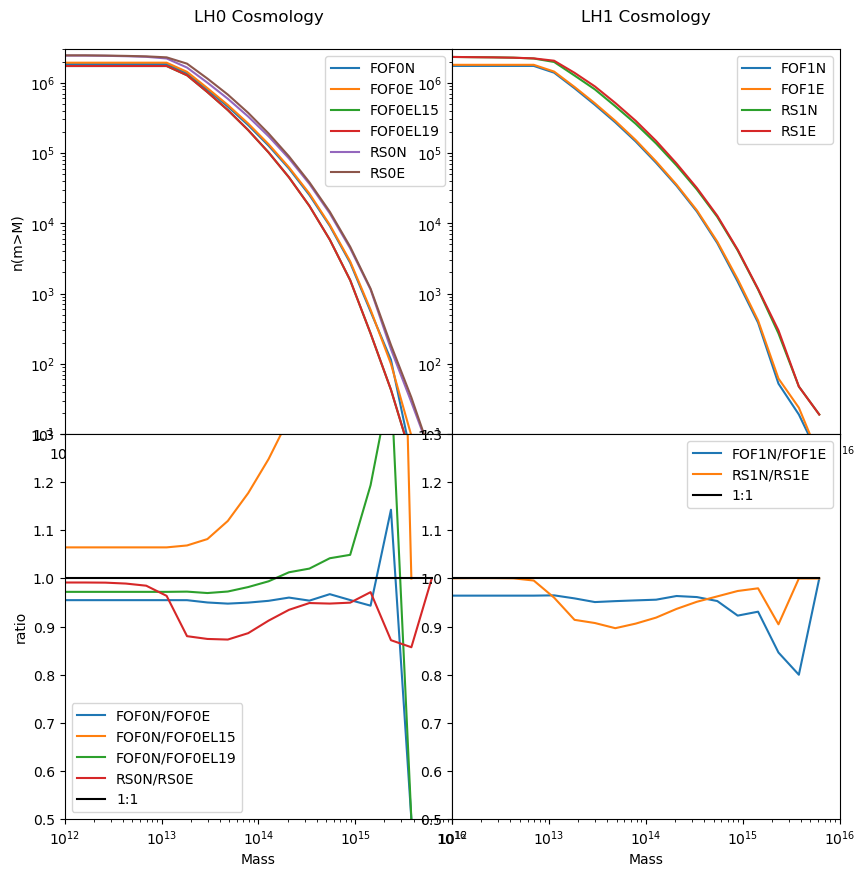

In [80]:
fig, axs = plt.subplots(2,2,figsize=(10,10))

plt.subplots_adjust(wspace=0, hspace=0)

axs[0][0].plot(mass_range[:-1], fof0n,label="FOF0N")
axs[0][0].plot(mass_range[:-1], fof0e,label="FOF0E")
axs[0][0].plot(mass_range[:-1], fof0ell15,label="FOF0EL15")
axs[0][0].plot(mass_range[:-1], fof0ell15,label="FOF0EL19")
axs[0][0].plot(mass_range[:-1], rs0n,label="RS0N")
axs[0][0].plot(mass_range[:-1], rs0e,label="RS0E")
axs[1][0].plot(mass_range[:-1], fof0n/fof0e,label="FOF0N/FOF0E")
axs[1][0].plot(mass_range[:-1], fof0n/fof0ell15,label="FOF0N/FOF0EL15")
axs[1][0].plot(mass_range[:-1], fof0n/fof0ell19,label="FOF0N/FOF0EL19")
axs[1][0].plot(mass_range[:-1], rs0n/rs0e,label="RS0N/RS0E")
#axs[1][0].plot(mass_range[:-1], rs0n/fof0n,label="RS0N/FOF0N")
axs[1][0].plot(mass_range[:-1], np.linspace(1,1,len(fof0n)),label="1:1", c="black")



axs[0][1].plot(mass_range[:-1], fof1n,label="FOF1N")
axs[0][1].plot(mass_range[:-1], fof1e,label="FOF1E")
axs[0][1].plot(mass_range[:-1], rs1n,label="RS1N")
axs[0][1].plot(mass_range[:-1], rs1e,label="RS1E")
axs[1][1].plot(mass_range[:-1], fof1n/fof1e,label="FOF1N/FOF1E")
axs[1][1].plot(mass_range[:-1], rs1n/rs1e,label="RS1N/RS1E")
axs[1][1].plot(mass_range[:-1], np.linspace(1,1,len(fof1n)),label="1:1", c="black")





axs[0][0].set_title("LH0 Cosmology",y=1.05)
axs[0][1].set_title("LH1 Cosmology",y=1.05)
axs[0][0].set_yscale("log")
axs[0][1].set_yscale("log")
axs[1][0].set_xlabel("Mass")
axs[1][1].set_xlabel("Mass")
axs[0][0].set_ylabel("n(m>M)")
axs[1][0].set_ylabel("ratio")
axs[1][0].set_ylim(0.5,1.3)
axs[1][1].set_ylim(0.5,1.3)
axs[0][0].set_ylim(10,3e6)
axs[0][1].set_ylim(10,3e6)

for x in range(2):
    for y in range(2):
        axs[x][y].set_xscale("log")
        axs[x][y].legend()
        axs[x][y].set_xlim(1e12,1e16)
plt.savefig("figures/hmf_fof_rs_comp.pdf",bbox_inches="tight")

# FOF and RS mean profile comparisons

In [ ]:
import bigfile
from nbodykit.source.catalog import BigFileCatalog
f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
f0emu = BigFileCatalog('fof_halos/lh0000_emu')
f1nbody = BigFileCatalog('fof_halos/lh0001_nbody')
f1emu = BigFileCatalog('fof_halos/lh0001_emu')
f0emul15 = BigFileCatalog('fof_halos/lh0000_emu_ll15')
f0emul19 = BigFileCatalog('fof_halos/lh0000_emu_ll19')


rs0nbody = yt.load("rockstar_comparisons/test_default_nbody/halos_0.0.bin")
rs0emu = yt.load("rockstar_comparisons/test_default_emu/halos_0.0.bin")
rs1nbody = yt.load("cosmo2_halos/test_default_nbody/halos_0.0.bin")
rs1emu = yt.load("cosmo2_halos/test_default_borg_emu/halos_0.0.bin")

# Reading RS halos

In [2]:
dir_ = "rockstar_halos_low_N/"
dir_ = "rockstar_halos/"
ds  = yt.load(dir_+'halos_emu_0.0.bin')
ds = ds.all_data()


yt : [INFO     ] 2023-05-25 11:03:35,615 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-05-25 11:03:35,618 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-05-25 11:03:35,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-05-25 11:03:35,621 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-05-25 11:03:35,621 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-05-25 11:03:35,621 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-05-25 11:03:35,622 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-05-25 11:03:35,622 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-05-25 11:03:35,622 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-05-25 11:03:35,623 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-05-25 11:03:35,628 Allocating for 5.1

In [2]:
plt.figure()
for fname in ["nbody", "emu"]:
    print(dir_+"halos_"+fname+'_0.0.bin')
    ds  = yt.load(dir_+"halos_"+fname+'_0.0.bin')
    ds = ds.all_data()
    mass = ds["particle_mass"].to('Msun')
    mass_range = np.logspace(12,16,40)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass > lo) )[0]))

    plt.scatter(mass_range[:-1], N,label=fname)





plt.xscale("log")
plt.yscale("log")
plt.ylabel(r"n(m>M) [$Mpc^{-3}$]")
plt.xlabel("Mass [$M_\odot$]")   
plt.legend()
plt.savefig("figures/"+dir_+"_n_vs_m.pdf")

NameError: name 'dir_' is not defined

<Figure size 432x288 with 0 Axes>

In [3]:
N_list = []
dir_list = ["rockstar_halos_low_N/", "rockstar_halos/", "rockstar_halos_high_N/"]
for dir_item in dir_list:
    for fname in ["nbody", "emu"]:
        ds  = yt.load(dir_item+'halos_'+fname+'_0.0.bin')
        ds = ds.all_data()
        mass = ds["particle_mass"].to('Msun')
        mass_range = np.logspace(12,16,20)
        dlogm = 1#np.log10(mass_range[1])-np.log10(mass_range[0])
        N = []
        for x in range(len(mass_range)-1):
            up,lo = mass_range[x+1], mass_range[x]
            N.append(np.size(np.where((mass > lo) )[0]))

            #N.append(np.size(np.where((mass > lo) & (mass < up))[0]))
        N_list.append(np.array(N)/dlogm)

yt : [INFO     ] 2023-05-16 11:17:29,118 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-05-16 11:17:29,120 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-05-16 11:17:29,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-05-16 11:17:29,123 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-05-16 11:17:29,124 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-05-16 11:17:29,124 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-05-16 11:17:29,124 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-05-16 11:17:29,125 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-05-16 11:17:29,125 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-05-16 11:17:29,125 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-05-16 11:17:29,131 Allocating for 9.1

In [ ]:

plt.rcParams.update({'font.size': 12})
fnames = ["N-body", "emulator"]


fig, axs = plt.subplots(3,3,figsize=(15,15))

axs[0][0].set_title("Rockstar N min particles = 10",y=1.05)
axs[0][1].set_title("Rockstar N min particles = 20 (default)",y=1.05)
axs[0][2].set_title("Rockstar N min particles = 50",y=1.05)

for x in range(3):
    N_list_temp = N_list[2*x: 2*(x+1)]
    for N,fname in zip(N_list_temp,fnames):
        axs[0][x].scatter(mass_range[:-1], N,label=fname)
        axs[1][x].scatter(mass_range[:-1], np.log10(N),label=fname)
    axs[2][x].plot(mass_range[:-1], (np.array(N_list_temp[0])/np.array(N_list_temp[1])))
    axs[2][x].plot(mass_range[:-1], np.linspace(1,1,len(mass_range[:-1])),color='black')

    
    axs[0][x].set_ylabel(r"n(m>M) [$Mpc^{-3}$]")
    axs[1][x].set_ylabel(r"$log_{10}$(n(m>M)) [$Mpc^{-3}$]")
    axs[2][x].set_ylabel(r"$N_{\rm Nbody}/N_{\rm emulator}$")

    plt.xlabel("Mass [$M_\odot$]")
    for y in range(3):
        axs[y][x].set_xscale("log")
        axs[y][x].legend()
    axs[0][x].set_ylim(0,1.3e6)
    axs[1][x].set_ylim(1,6.5)
    axs[2][x].set_ylim(0.6,1.1)


    
    
plt.savefig("figures/n_vs_m_comparison.jpg",bbox_inches="tight")

In [59]:

import numpy as np
import matplotlib.pyplot as plt
from scipy import interpolate
N_nbody = N_list[0]
N_emu = N_list[1]


mass_eval=1e13
f_nbody = interpolate.interp1d(mass_range[:-1],N_nbody)
density_nbody = f_nbody(mass_eval)
f_emu_inv = interpolate.interp1d(N_emu,mass_range[:-1])
mass_emu = f_emu_inv(density_nbody)
f_emu = interpolate.interp1d(mass_range[:-1], N_emu)
density_emu = f_emu(mass_emu)
print(mass_emu/mass_eval)
print(density_emu, density_nbody)

1.1895972132778698
5853679.706732949 5853679.706732949


# Doubling the velocity components in the nbody halos, does it change halo outputs?

In [69]:
base_dir = "cosmo2_halos/test_default_nbody/halos_0.0.bin"
high_v_dir = "cosmo2_halos/test_default_borg_emu_highv/halos_0.0.bin"
emu_dir = "cosmo2_halos/test_default_borg_emu/halos_0.0.bin"


mass,N_base = get_hmf(yt.load(base_dir))
mass_hv,N_base_hv = get_hmf(yt.load(high_v_dir))
mass_hv,N_emu = get_hmf(yt.load(emu_dir))


yt : [INFO     ] 2023-06-28 15:14:52,471 Parameters: current_time              = 3.793419208989919e+17 s
yt : [INFO     ] 2023-06-28 15:14:52,473 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-28 15:14:52,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-28 15:14:52,475 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-28 15:14:52,475 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-28 15:14:52,475 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-28 15:14:52,476 Parameters: omega_lambda              = 0.7860999703407288
yt : [INFO     ] 2023-06-28 15:14:52,476 Parameters: omega_matter              = 0.21389999985694885
yt : [INFO     ] 2023-06-28 15:14:52,477 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-28 15:14:52,477 Parameters: hubble_constant           = 0.8598999977111816
yt : [INFO     ] 2023-06-28 15:14:52,479 Allocating for 4.8

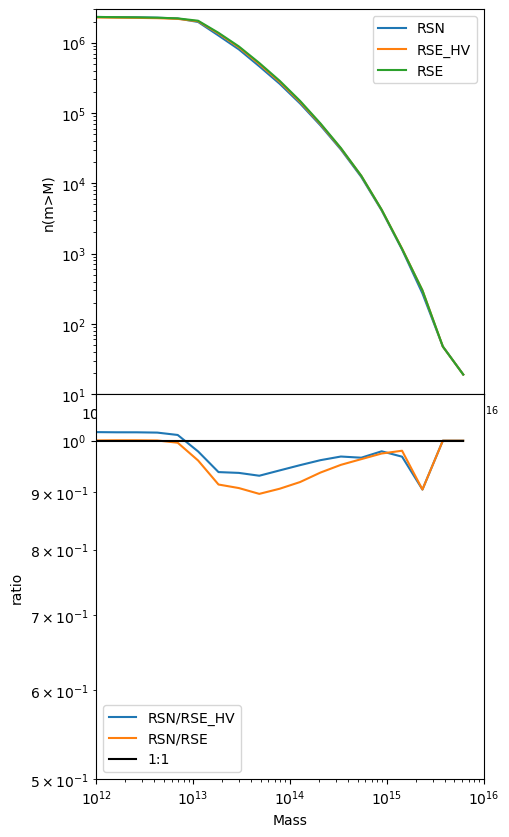

In [72]:
fig, axs = plt.subplots(2,1,figsize=(5,10))

plt.subplots_adjust(wspace=0, hspace=0)

axs[0].plot(mass[:-1], N_base,label="RSN")
axs[0].plot(mass[:-1], N_base_hv,label="RSE_HV")
axs[0].plot(mass[:-1], N_emu,label="RSE")
axs[1].plot(mass[:-1], N_base/N_base_hv,label="RSN/RSE_HV")
axs[1].plot(mass[:-1], N_base/N_emu,label="RSN/RSE")
#axs[1][0].plot(mass_range[:-1], rs0n/fof0n,label="RS0N/FOF0N")
axs[1].plot(mass[:-1], np.linspace(1,1,len(N_base)),label="1:1", c="black")






axs[0].set_yscale("log")
axs[1].set_yscale("log")
axs[1].set_xlabel("Mass")
axs[0].set_ylabel("n(m>M)")
axs[1].set_ylabel("ratio")
axs[1].set_ylim(0.5,1.1)
axs[0].set_ylim(10,3e6)

for x in range(2):
    axs[x].set_xscale("log")
    axs[x].legend()
    axs[x].set_xlim(1e12,1e16)
plt.savefig("figures/hmf_highv_comp.pdf",bbox_inches="tight")

# Comparing Rockstar nbody to emu with different params

In [15]:
comp_dirs = glob.glob("rockstar_comparisons/*")
base = "rockstar_comparisons/test_default_nbody/halos_0.0.bin"
# base = "high_v_halos/halos_0.0.bin"
comparisons = glob.glob("rockstar_comparisons/*emu/*.bin")


In [16]:
def get_hmf(ds):
    ds = ds.all_data()
    mass = ds["particle_mass"].to('Msun')
    mass_range = np.logspace(12,16,20)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass > lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf

In [17]:
mass,N_base = get_hmf(yt.load(base))

N_list = []
for fname in comparisons:
    ds  = yt.load(fname)
    mass, hmf = get_hmf(ds)
    N_list.append(hmf)

yt : [INFO     ] 2023-06-28 08:15:13,041 Parameters: current_time              = 3.793419208989919e+17 s
yt : [INFO     ] 2023-06-28 08:15:13,042 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-28 08:15:13,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-28 08:15:13,043 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-28 08:15:13,044 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-28 08:15:13,044 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-28 08:15:13,044 Parameters: omega_lambda              = 0.7860999703407288
yt : [INFO     ] 2023-06-28 08:15:13,045 Parameters: omega_matter              = 0.21389999985694885
yt : [INFO     ] 2023-06-28 08:15:13,045 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-28 08:15:13,045 Parameters: hubble_constant           = 0.8598999977111816
yt : [INFO     ] 2023-06-28 08:15:13,047 Allocating for 4.6

rockstar_comparisons/test_highbound_emu/halos_0.0.bin
rockstar_comparisons/test_default_emu/halos_0.0.bin
rockstar_comparisons/test_so_masses_emu/halos_0.0.bin
rockstar_comparisons/test_highres_emu/halos_0.0.bin
rockstar_comparisons/test_lowbound_emu/halos_0.0.bin
rockstar_comparisons/test_lowres_emu/halos_0.0.bin


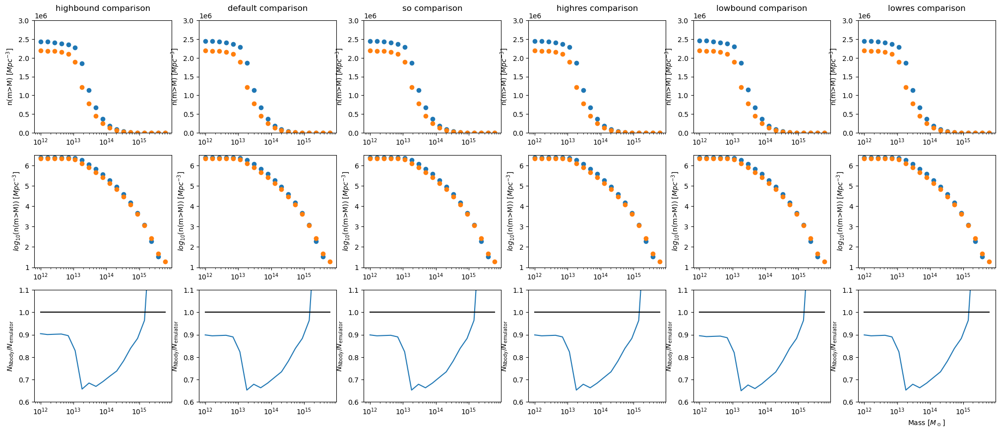

In [18]:
fig, axs = plt.subplots(3,6,figsize=(25,10))

for x in range(6):
    print(comparisons[x])
    title = (comparisons[x].split("test_")[-1]).split("_")[0]
    axs[0][x].set_title(title + " comparison",y=1.05)

    N_list_temp = N_list[x]
    axs[0][x].scatter(mass[:-1], N_list_temp,label=fname)
    axs[1][x].scatter(mass[:-1], np.log10(N_list_temp),label=fname)
    axs[0][x].scatter(mass[:-1], N_base,label=fname)
    axs[1][x].scatter(mass[:-1], np.log10(N_base),label=fname)   
    axs[2][x].plot(mass[:-1], (np.array(N_base)/np.array(N_list_temp)))
    axs[2][x].plot(mass[:-1], np.linspace(1,1,len(mass[:-1])),color='black')

    
    axs[0][x].set_ylabel(r"n(m>M) [$Mpc^{-3}$]")
    axs[1][x].set_ylabel(r"$log_{10}$(n(m>M)) [$Mpc^{-3}$]")
    axs[2][x].set_ylabel(r"$N_{\rm Nbody}/N_{\rm emulator}$")

    plt.xlabel("Mass [$M_\odot$]")
    for y in range(3):
        axs[y][x].set_xscale("log")
        #axs[y][x].legend()
    axs[0][x].set_ylim(0,3e6)
    axs[1][x].set_ylim(1,6.5)
    axs[2][x].set_ylim(0.6,1.1)
    
plt.savefig("figures/hmf_vary_rockstar_params.pdf",bbox_inches="tight")

In [19]:
comp_dirs = glob.glob("cosmo2_halos/*")
#base = "cosmo2_halos/test_default_nbody/halos_0.0.bin"
base = "high_v_halos/halos_0.0.bin"
comparisons = glob.glob("cosmo2_halos/*borg_emu/*.bin")


def get_hmf(ds):
    ds = ds.all_data()
    mass = ds["particle_mass"].to('Msun')
    mass_range = np.logspace(12,16,20)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass > lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf


mass,N_base = get_hmf(yt.load(base))

N_list = []
for fname in comparisons:
    ds  = yt.load(fname)
    mass, hmf = get_hmf(ds)
    N_list.append(hmf)

yt : [INFO     ] 2023-06-28 08:22:02,046 Parameters: current_time              = 3.793419208989919e+17 s
yt : [INFO     ] 2023-06-28 08:22:02,048 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-28 08:22:02,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-28 08:22:02,050 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-28 08:22:02,050 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-28 08:22:02,051 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-28 08:22:02,051 Parameters: omega_lambda              = 0.7860999703407288
yt : [INFO     ] 2023-06-28 08:22:02,052 Parameters: omega_matter              = 0.21389999985694885
yt : [INFO     ] 2023-06-28 08:22:02,052 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-28 08:22:02,053 Parameters: hubble_constant           = 0.8598999977111816
yt : [INFO     ] 2023-06-28 08:22:02,056 Allocating for 4.6

cosmo2_halos/test_default_borg_emu/halos_0.0.bin
cosmo2_halos/test_so_masses_borg_emu/halos_0.0.bin
cosmo2_halos/test_highres_borg_emu/halos_0.0.bin
cosmo2_halos/test_lowbound_borg_emu/halos_0.0.bin
cosmo2_halos/test_highbound_borg_emu/halos_0.0.bin
cosmo2_halos/test_lowres_borg_emu/halos_0.0.bin


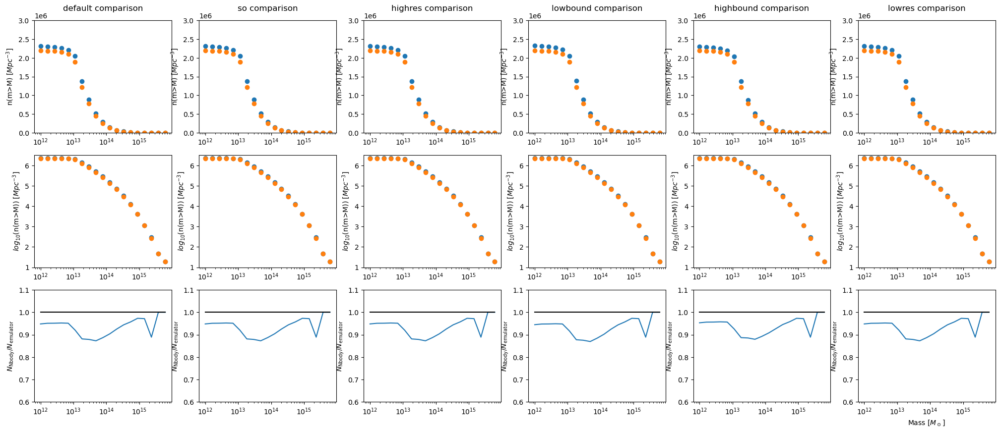

In [20]:
fig, axs = plt.subplots(3,6,figsize=(25,10))

for x in range(6):
    print(comparisons[x])
    title = (comparisons[x].split("test_")[-1]).split("_")[0]
    axs[0][x].set_title(title + " comparison",y=1.05)

    N_list_temp = N_list[x]
    axs[0][x].scatter(mass[:-1], N_list_temp,label=fname)
    axs[1][x].scatter(mass[:-1], np.log10(N_list_temp),label=fname)
    axs[0][x].scatter(mass[:-1], N_base,label=fname)
    axs[1][x].scatter(mass[:-1], np.log10(N_base),label=fname)   
    axs[2][x].plot(mass[:-1], (np.array(N_base)/np.array(N_list_temp)))
    axs[2][x].plot(mass[:-1], np.linspace(1,1,len(mass[:-1])),color='black')

    
    axs[0][x].set_ylabel(r"n(m>M) [$Mpc^{-3}$]")
    axs[1][x].set_ylabel(r"$log_{10}$(n(m>M)) [$Mpc^{-3}$]")
    axs[2][x].set_ylabel(r"$N_{\rm Nbody}/N_{\rm emulator}$")

    plt.xlabel("Mass [$M_\odot$]")
    for y in range(3):
        axs[y][x].set_xscale("log")
        #axs[y][x].legend()
    axs[0][x].set_ylim(0,3e6)
    axs[1][x].set_ylim(1,6.5)
    axs[2][x].set_ylim(0.6,1.1)
    
plt.savefig("figures/hmf_vary_rockstar_params_cosmo2_high_v.pdf",bbox_inches="tight")

In [8]:
comp_dirs = glob.glob("cosmo2_halos/*")
base = "cosmo2_halos/test_default_nbody/halos_0.0.bin"
comparisons = glob.glob("cosmo2_halos/*drew_emu/*.bin")


def get_hmf(ds):
    ds = ds.all_data()
    mass = ds["particle_mass"].to('Msun')
    mass_range = np.logspace(12,16,20)
    dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
    N = []
    for x in range(len(mass_range)-1):
        up,lo = mass_range[x+1], mass_range[x]
        N.append(np.size(np.where((mass > lo) )[0]))
    hmf = np.array(N)/dlogm
    return mass_range, hmf


mass,N_base = get_hmf(yt.load(base))

N_list = []
for fname in comparisons:
    ds  = yt.load(fname)
    mass, hmf = get_hmf(ds)
    N_list.append(hmf)

yt : [INFO     ] 2023-06-24 08:12:44,088 Parameters: current_time              = 3.793419208989919e+17 s
yt : [INFO     ] 2023-06-24 08:12:44,090 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-24 08:12:44,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-24 08:12:44,093 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-24 08:12:44,094 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-24 08:12:44,094 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-24 08:12:44,095 Parameters: omega_lambda              = 0.7860999703407288
yt : [INFO     ] 2023-06-24 08:12:44,095 Parameters: omega_matter              = 0.21389999985694885
yt : [INFO     ] 2023-06-24 08:12:44,097 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-24 08:12:44,097 Parameters: hubble_constant           = 0.8598999977111816
yt : [INFO     ] 2023-06-24 08:12:44,103 Allocating for 4.8

yt : [INFO     ] 2023-06-24 08:12:55,060 Parameters: hubble_constant           = 0.8598999977111816
yt : [INFO     ] 2023-06-24 08:12:55,067 Allocating for 4.888e+05 particles
Initializing refined index: 100%|████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  6.31it/s]


cosmo2_halos\test_default_drew_emu\halos_0.0.bin
cosmo2_halos\test_highbound_drew_emu\halos_0.0.bin
cosmo2_halos\test_highres_drew_emu\halos_0.0.bin
cosmo2_halos\test_lowbound_drew_emu\halos_0.0.bin
cosmo2_halos\test_lowres_drew_emu\halos_0.0.bin
cosmo2_halos\test_so_masses_drew_emu\halos_0.0.bin


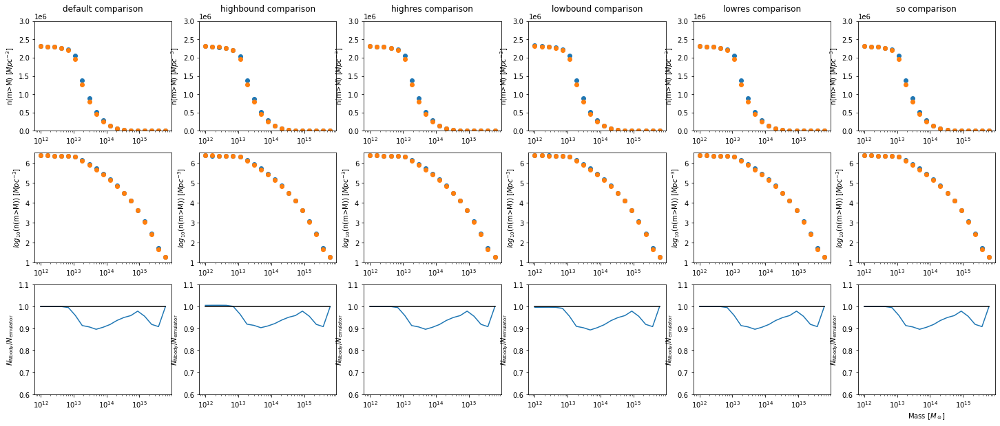

In [9]:
fig, axs = plt.subplots(3,6,figsize=(25,10))

for x in range(6):
    print(comparisons[x])
    title = (comparisons[x].split("test_")[-1]).split("_")[0]
    axs[0][x].set_title(title + " comparison",y=1.05)

    N_list_temp = N_list[x]
    axs[0][x].scatter(mass[:-1], N_list_temp,label=fname)
    axs[1][x].scatter(mass[:-1], np.log10(N_list_temp),label=fname)
    axs[0][x].scatter(mass[:-1], N_base,label=fname)
    axs[1][x].scatter(mass[:-1], np.log10(N_base),label=fname)   
    axs[2][x].plot(mass[:-1], (np.array(N_base)/np.array(N_list_temp)))
    axs[2][x].plot(mass[:-1], np.linspace(1,1,len(mass[:-1])),color='black')

    
    axs[0][x].set_ylabel(r"n(m>M) [$Mpc^{-3}$]")
    axs[1][x].set_ylabel(r"$log_{10}$(n(m>M)) [$Mpc^{-3}$]")
    axs[2][x].set_ylabel(r"$N_{\rm Nbody}/N_{\rm emulator}$")

    plt.xlabel("Mass [$M_\odot$]")
    for y in range(3):
        axs[y][x].set_xscale("log")
        #axs[y][x].legend()
    axs[0][x].set_ylim(0,3e6)
    axs[1][x].set_ylim(1,6.5)
    axs[2][x].set_ylim(0.6,1.1)
    
plt.savefig("figures/hmf_vary_rockstar_params_cosmo2.pdf",bbox_inches="tight")

## Comparing outputs with different energy inputs

In [7]:
#plt.figure()
dir_ = "rockstar_energy_test"
mass_range_list = []
N_list = []
file_list = []
for energy in ["energy", "noenergy"]:
    for fname in ["nbody", "emu"]:
        file = dir_+"/halos_"+energy+"_"+fname+'_0.0.bin'
        print(file)
        ds  = yt.load(file)
        ds = ds.all_data()
        mass = ds["particle_mass"].to('Msun')
        mass_range = np.logspace(12,16,40)
        dlogm = np.log10(mass_range[1])-np.log10(mass_range[0])
        N = []
        for x in range(len(mass_range)-1):
            up,lo = mass_range[x+1], mass_range[x]
            N.append(np.size(np.where((mass > lo) )[0]))

        #plt.scatter(mass_range[:-1], N,label=fname)
        file_list.append(file)
        mass_range_list.append(np.array(mass_range[:-1]))
        N_list.append(np.array(N))

yt : [INFO     ] 2023-06-07 09:24:22,018 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-06-07 09:24:22,020 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-07 09:24:22,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-07 09:24:22,023 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-07 09:24:22,023 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-07 09:24:22,023 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-07 09:24:22,024 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-06-07 09:24:22,024 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-06-07 09:24:22,024 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-07 09:24:22,025 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-06-07 09:24:22,030 Allocating for 5.1

rockstar_energy_test/halos_energy_nbody_0.0.bin


Loading particle index: 100%|██████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 4000.29it/s]
yt : [INFO     ] 2023-06-07 09:24:24,771 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-06-07 09:24:24,773 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-07 09:24:24,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-07 09:24:24,776 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-07 09:24:24,776 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-07 09:24:24,776 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-07 09:24:24,776 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-06-07 09:24:24,777 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-06-07 09:24:24,777 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-07 09:24:24,77

rockstar_energy_test/halos_energy_emu_0.0.bin


Loading particle index: 100%|██████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 3998.38it/s]
yt : [INFO     ] 2023-06-07 09:24:27,398 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-06-07 09:24:27,400 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-07 09:24:27,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-07 09:24:27,402 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-07 09:24:27,403 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-07 09:24:27,403 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-07 09:24:27,404 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-06-07 09:24:27,404 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-06-07 09:24:27,404 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-07 09:24:27,40

rockstar_energy_test/halos_noenergy_nbody_0.0.bin


Loading particle index: 100%|██████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 3998.38it/s]
yt : [INFO     ] 2023-06-07 09:24:30,053 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-06-07 09:24:30,054 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-07 09:24:30,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-07 09:24:30,057 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-07 09:24:30,057 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-07 09:24:30,058 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-07 09:24:30,058 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-06-07 09:24:30,058 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-06-07 09:24:30,058 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-07 09:24:30,05

rockstar_energy_test/halos_noenergy_emu_0.0.bin


Loading particle index: 100%|██████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 2000.62it/s]


C:\Users\Matthew\AppData\Local\Temp/ipykernel_30000/770499274.py:3: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range_list[0], N_list[1]/N_list[3])
No handles with labels found to put in legend.
C:\Users\Matthew\AppData\Local\Temp/ipykernel_30000/770499274.py:12: RuntimeWarning: invalid value encountered in true_divide
  plt.plot(mass_range_list[0], N_list[0]/N_list[2])
No handles with labels found to put in legend.


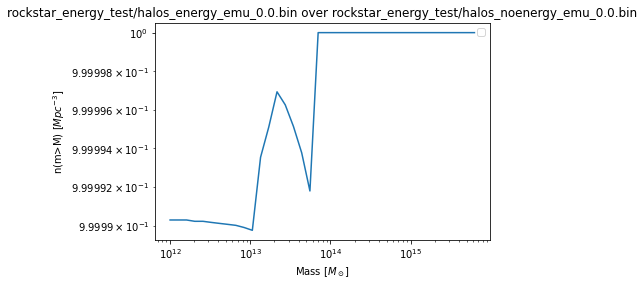

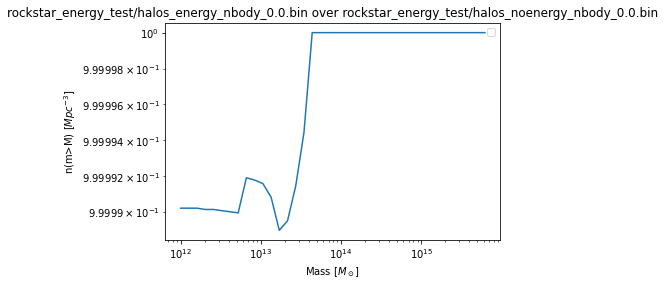

In [11]:
plt.figure()
plt.title(file_list[1] +" over " + file_list[3])
plt.plot(mass_range_list[0], N_list[1]/N_list[3])
plt.xscale("log")
plt.yscale("log")
plt.ylabel(r"n(m>M) [$Mpc^{-3}$]")
plt.xlabel("Mass [$M_\odot$]")   
plt.legend()

plt.figure()
plt.title(file_list[0] +" over " + file_list[2])
plt.plot(mass_range_list[0], N_list[0]/N_list[2])
plt.xscale("log")
plt.yscale("log")
plt.ylabel(r"n(m>M) [$Mpc^{-3}$]")
plt.xlabel("Mass [$M_\odot$]")   
plt.legend()
#plt.savefig("figures/"+dir_+"_n_vs_m.pdf")

In [ ]:
#Energy input for rockstar not important for DM only sims

# 

# Checking halo positions

In [4]:
import bigfile
from nbodykit.source.catalog import BigFileCatalog
f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
f0emu = BigFileCatalog('fof_halos/lh0000_emu')
# f1nbody = BigFileCatalog('fof_halos/lh0001_nbody')
# f1emu = BigFileCatalog('fof_halos/lh0001_emu')
# f0emul15 = BigFileCatalog('fof_halos/lh0000_emu_ll15')
# f0emul19 = BigFileCatalog('fof_halos/lh0000_emu_ll19')


# rs0nbody = yt.load("rockstar_comparisons/test_default_nbody/halos_0.0.bin")
# rs0emu = yt.load("rockstar_comparisons/test_default_emu/halos_0.0.bin")
# rs1nbody = yt.load("cosmo2_halos/test_default_nbody/halos_0.0.bin")
# rs1emu = yt.load("cosmo2_halos/test_default_borg_emu/halos_0.0.bin")

/home/matthew/anaconda3/envs/nbodykit-env/lib/python3.8/site-packages/bigfile/__init__.py:358: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  return pyxbigfile.Dataset.__init__(self, file, dtype=dtype, size=size)


In [2]:
dir_ = "rockstar_halos_corrected/"   
dsnbod = yt.load(dir_+"halos_"+"nbody"+'_0.0.bin')
dsemu = yt.load(dir_+"halos_"+"emu"+'_0.0.bin')


yt : [INFO     ] 2023-06-13 16:50:06,617 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-06-13 16:50:06,620 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-13 16:50:06,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-13 16:50:06,622 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-13 16:50:06,623 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-13 16:50:06,623 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-13 16:50:06,623 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-06-13 16:50:06,623 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-06-13 16:50:06,624 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-13 16:50:06,624 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-06-13 16:50:06,703 Parameters: curren

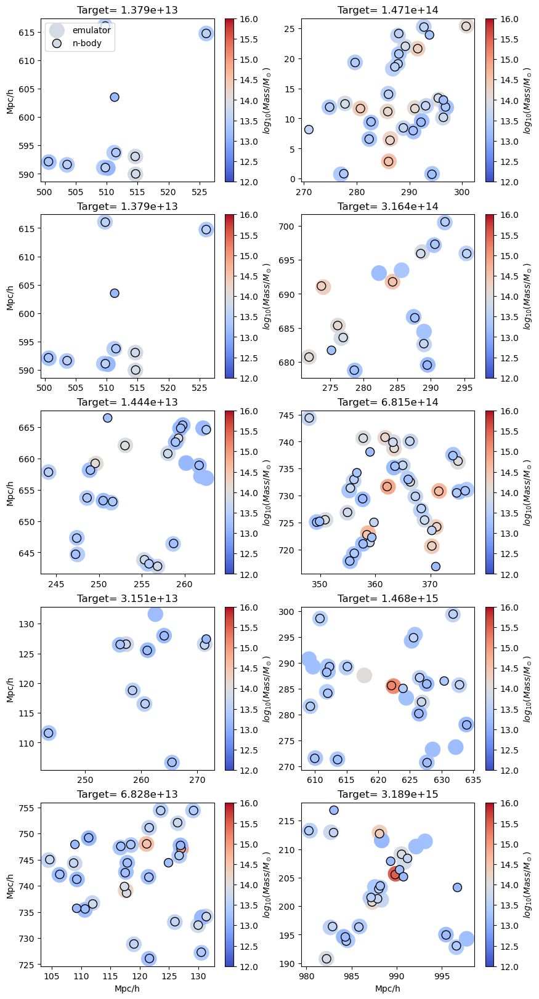

In [16]:
#Halo comparison for FOF
pos_nbod = np.array(f0nbody["Position"])
mass_nbod  = np.array(f0nbody["Mass"])
pos_emu = np.array(f0emu["Position"])
mass_emu  = np.array(f0emu["Mass"])
box_width = 30
hw = box_width/2

fig, axs = plt.subplots(5,2,figsize=(10,20))
target_positions = []


for i,target_mass in enumerate(np.logspace(12.5,15.5,10)):
    a = i%5
    b = 0
    if(i>= 5): b=1
    nbod_index = np.argmin(np.abs(mass_nbod-target_mass))
    actual_mass = mass_nbod[nbod_index]
    max_pos_nbod = pos_nbod[nbod_index]
    target_positions.append(max_pos_nbod)
    p = max_pos_nbod

    bd = np.abs(p-pos_nbod).T
    inds_nbod = np.where((bd[0] <= hw) & (bd[1] <= hw) & (bd[2] <= hw))
    box_pos_nbod = pos_nbod[inds_nbod]
    box_mass_nbod = mass_nbod[inds_nbod]
    



    bd = np.abs(p-pos_emu).T
    inds_emu = np.where((bd[0] <= hw) & (bd[1] <= hw) & (bd[2] <= hw))
    box_pos_emu = pos_emu[inds_emu]
    box_mass_emu = mass_emu[inds_emu]

    
    #box_pos_emu[np.where(box_pos_emu>=800)] = -(dsemu.quan(1000,"Mpc/h")-box_pos_emu[np.where(box_pos_emu>=800)])
    #box_pos_nbod[np.where(box_pos_nbod>=800)] = -(dsnbod.quan(1000,"Mpc/h")-box_pos_nbod[np.where(box_pos_nbod>=800)])

    
    axs[a][b].scatter(box_pos_emu.T[0], box_pos_emu.T[1],c = np.log10(box_mass_emu),cmap=CMAP, label="emulator",s=300,vmin=12, vmax=16)
    c=axs[a][b].scatter(box_pos_nbod.T[0], box_pos_nbod.T[1],c = np.log10(box_mass_nbod), cmap=CMAP, label="n-body",s=100,vmin=12, vmax=16,edgecolors='black')
    plt.colorbar(c,label=r"$log_{\rm10}(Mass/M_\odot)$",ax=axs[a][b])
    #plt.scatter(max_pos[0], max_pos[1], label="Central Halo", s=500, color="red")
    #plt.scatter(max_pos_nbod[0], max_pos[1], label="Central Halo", s=500, color="red")
    #plt.scatter(max_pos_nbod[0],max_pos_nbod[1], label="central",s=40)
    if(i== 0): axs[a][b].legend(loc="upper left")
    if(b==0): axs[a][b].set_ylabel("Mpc/h")
    if(a ==4): axs[a][b].set_xlabel("Mpc/h")
    print_mass = scientific_notation="{:.3e}".format(actual_mass)
    axs[a][b].set_title("Target= "+str(print_mass))
    plt.savefig("figures/emu_vs_nbody_halos_FOF0.pdf",bbox_inches="tight")





yt : [INFO     ] 2023-06-07 09:35:31,611 Allocating for 5.110e+05 particles
Initializing refined index: 100%|████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  7.12it/s]
yt : [INFO     ] 2023-06-07 09:35:35,056 Allocating for 5.153e+05 particles
Initializing refined index: 100%|████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  7.68it/s]


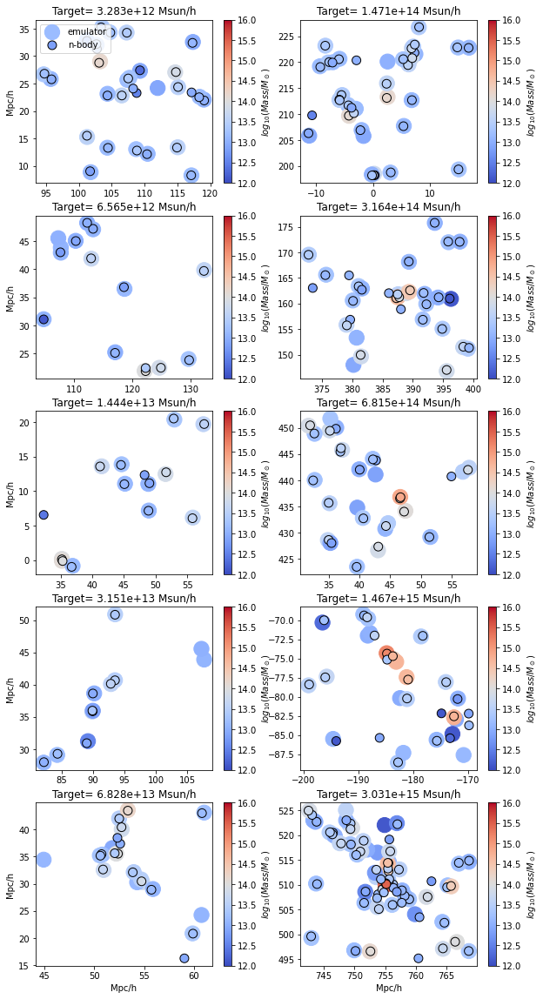

In [13]:

#Halo comparison for RS
pos_nbod = dsnbod.all_data()["all","particle_position"].to("Mpc/h")
mass_nbod  = dsnbod.all_data()["all","particle_mass"].to("Msun/h")
pos_emu = dsemu.all_data()["all","particle_position"].to("Mpc/h")
mass_emu  = dsemu.all_data()["all","particle_mass"].to("Msun/h")
box_width = dsnbod.quan(30, 'Mpc/h')
hw = box_width/2

fig, axs = plt.subplots(5,2,figsize=(10,20))
target_positions = []


for i,target_mass in enumerate(np.logspace(12.5,15.5,10)):
    a = i%5
    b = 0
    if(i>= 5): b=1
    nbod_index = np.argmin(np.abs(mass_nbod-dsnbod.quan(target_mass, 'Msun/h')))
    actual_mass = mass_nbod[nbod_index]
    max_pos_nbod = pos_nbod[nbod_index]
    target_positions.append(max_pos_nbod)
    p = max_pos_nbod
    box_edges = [[p[0]-hw, p[1]-hw,p[2]-hw],[p[0]+hw,p[1]+hw, p[2]+hw]]
    box_nbod = dsnbod.box(left_edge=box_edges[0], right_edge=box_edges[1])
    box_pos_nbod = box_nbod["all","particle_position"].to("Mpc/h")
    box_mass_nbod = box_nbod["all","particle_mass"].to("Msun/h")


    # emu_index = np.argmin(np.abs(mass_nbod-dsnbod.quan(target_mass, 'Msun/h')))
    # distance = pos_emu - max_pos_nbod


    # max_pos_emu = pos_emu[max_mass_emu_index]
    # box_width = dsemu.quan(30, 'Mpc/h')
    # hw = box_width/2
    # p = max_pos_emu
    # box_edges = [[p[0]-hw, p[1]-hw,p[2]-hw],[p[0]+hw,p[1]+hw, p[2]+hw]]
    box_emu = dsemu.box(left_edge=box_edges[0], right_edge=box_edges[1])
    box_pos_emu = box_emu["all","particle_position"].to("Mpc/h")
    box_mass_emu= box_emu["all","particle_mass"].to("Msun/h")
    box_pos_emu[np.where(box_pos_emu>=800)] = -(dsemu.quan(1000,"Mpc/h")-box_pos_emu[np.where(box_pos_emu>=800)])
    box_pos_nbod[np.where(box_pos_nbod>=800)] = -(dsnbod.quan(1000,"Mpc/h")-box_pos_nbod[np.where(box_pos_nbod>=800)])

    
    axs[a][b].scatter(box_pos_emu.T[0], box_pos_emu.T[1],c = np.log10(box_mass_emu),cmap=CMAP, label="emulator",s=300,vmin=12, vmax=16)
    c=axs[a][b].scatter(box_pos_nbod.T[0], box_pos_nbod.T[1],c = np.log10(box_mass_nbod), cmap=CMAP, label="n-body",s=100,vmin=12, vmax=16,edgecolors='black')
    plt.colorbar(c,label=r"$log_{\rm10}(Mass/M_\odot)$",ax=axs[a][b])
    #plt.scatter(max_pos[0], max_pos[1], label="Central Halo", s=500, color="red")
    #plt.scatter(max_pos_nbod[0], max_pos[1], label="Central Halo", s=500, color="red")
    #plt.scatter(max_pos_nbod[0],max_pos_nbod[1], label="central",s=40)
    if(i== 0): axs[a][b].legend(loc="upper left")
    if(b==0): axs[a][b].set_ylabel("Mpc/h")
    if(a ==4): axs[a][b].set_xlabel("Mpc/h")
    print_mass = scientific_notation="{:.3e}".format(actual_mass)
    axs[a][b].set_title("Target= "+str(print_mass))
    plt.savefig("figures/emu_vs_nbody_halos.pdf",bbox_inches="tight")

# Stacking test #2 (pair-wise positions, rather than absolute positions)

In [3]:
dir_ = "rockstar_comparisons/test_default_"  
dsnbod = yt.load(dir_+"nbody/halos_0.0.bin")
dsemu = yt.load(dir_+"emu/halos_0.0.bin")
pos_nbod = dsnbod.all_data()["all","particle_position"].to("Mpc/h")
mass_nbod  = dsnbod.all_data()["all","particle_mass"].to("Msun/h")
rad_nbod  = dsnbod.all_data()["all","virial_radius"].to("Mpc/h")
pos_emu = dsemu.all_data()["all","particle_position"].to("Mpc/h")
mass_emu  = dsemu.all_data()["all","particle_mass"].to("Msun/h")
rad_emu  = dsemu.all_data()["all","virial_radius"].to("Mpc/h")

yt : [INFO     ] 2023-07-11 15:25:33,096 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-11 15:25:33,098 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-11 15:25:33,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-11 15:25:33,100 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-11 15:25:33,100 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-11 15:25:33,101 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-11 15:25:33,101 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-11 15:25:33,102 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-11 15:25:33,102 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-11 15:25:33,102 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-11 15:25:33,159 Parameters: current

In [4]:
TOLERANCE = 2

dir_ = "rockstar_comparisons/test_default_"   
dsnbod = yt.load(dir_+"nbody/halos_0.0.bin")
dsemu = yt.load(dir_+"emu/halos_0.0.bin")
pos_nbod = dsnbod.all_data()["all","particle_position"].to("Mpc/h")
mass_nbod  = dsnbod.all_data()["all","particle_mass"].to("Msun/h")
rad_nbod  = dsnbod.all_data()["all","virial_radius"].to("Mpc/h")
pos_emu = dsemu.all_data()["all","particle_position"].to("Mpc/h")
mass_emu  = dsemu.all_data()["all","particle_mass"].to("Msun/h")
rad_emu  = dsemu.all_data()["all","virial_radius"].to("Mpc/h")
vrms_emu  = dsemu.all_data()["all","vrms"].to("km/s")
vrms_nbod  = dsnbod.all_data()["all","vrms"].to("km/s")
ids_nbod, ids_emu = np.linspace(-1,-1,len(mass_nbod)), np.linspace(-1,-1,len(mass_emu))
bs= 50
bw = bs/2.0
bf=3
l = bw+bf
xc = bw
xsteps, ysteps, zsteps = int(1000/bs),int(1000/bs),int(1000/bs)
N=0
N_emu = 0
emu_args = []
nbod_args = []
sizes=[]
for xstep in range(xsteps):
    yc = bw
    for ystep in range(ysteps):
        zc = bw
        for zstep in range(zsteps):
            c = np.array([xc,yc,zc])
            
            x1,y1,z1 = (pos_nbod.value - c).T
            x2,y2,z2 = (pos_emu.value - c).T
            nb_filt = np.where((-bw<=x1) & (x1<=bw) & (-bw<=y1) & (y1<=bw) & (-bw<=z1) & (z1<=bw))[0]
            em_filt = np.where((-l<=x2) & (x2<=l) & (-l<=y2) & (y2<=l) & (-l<=z2) & (z2<=l))[0]
            pos_nbod1 = pos_nbod[nb_filt]
            mass_nbod1 = mass_nbod[nb_filt]
            rad_nbod1 = rad_nbod[nb_filt]
            ids_nbod1 = ids_nbod[nb_filt]
            pos_emu1 = pos_emu[em_filt]
            mass_emu1 = mass_emu[em_filt]
            rad_emu1 = rad_emu[em_filt]
            ids_emu1 = ids_emu[em_filt]
            for i in range(len(pos_nbod1)):
                pos_target = pos_nbod1[i]
                rad_target = rad_nbod1[i]*TOLERANCE
                mass_target = mass_nbod1[i]
                dist = np.sqrt(np.sum(np.power((pos_emu1 - pos_target),2),axis=1))
                size = len(np.where(dist<rad_target)[0])
                virial_rad_args = np.where(dist<=rad_target)[0]
                
                
                
                sizes.append(size)
                pair_ind = np.argmin(dist)
                if(dist[pair_ind] > rad_target): continue
                    
                mass_in_vir = mass_emu1[virial_rad_args]
                pair_ind = virial_rad_args[np.argmin(np.abs(mass_target-mass_in_vir))]
                
                
                
    
                if(ids_emu1[pair_ind] != -1): continue
            
            
                ids_emu1[pair_ind] = i+N
                ids_nbod1[i] = i+N
                emu_args.append(ids_emu1[pair_ind])
                nbod_args.append(ids_nbod1[i])
            ids_emu[em_filt] = ids_emu1
            ids_nbod[nb_filt] = ids_nbod1
            
            #print(xc,yc,zc)
            zc += bs
            N+= len(pos_nbod1)
            N_emu += len(pos_emu1)
        yc+=bs
    xc+= bs
    print(xc)
nbod_args2 = []
emu_args2  = []
for x in range(len(ids_nbod)):
    target_id = ids_nbod[x]
    if(target_id == -1): continue
    nbod_args2.append(x)
    emu_args2.append(np.where(ids_emu == target_id)[0][0])
emu_args2 = np.array(emu_args2)
nbod_args2 = np.array(nbod_args2)
emu_pair = np.log10(mass_emu[emu_args2].value)
nbod_pair = np.log10(mass_nbod[nbod_args2].value)

yt : [INFO     ] 2023-07-11 15:25:35,481 Parameters: current_time              = 4.362843250214618e+17 s
yt : [INFO     ] 2023-07-11 15:25:35,482 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-07-11 15:25:35,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-07-11 15:25:35,484 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-07-11 15:25:35,484 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-07-11 15:25:35,484 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-07-11 15:25:35,485 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-07-11 15:25:35,485 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-07-11 15:25:35,485 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-07-11 15:25:35,486 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-07-11 15:25:35,522 Parameters: current

75.0
125.0
175.0
225.0
275.0
325.0
375.0
425.0
475.0
525.0
575.0
625.0
675.0
725.0
775.0
825.0
875.0
925.0
975.0
1025.0


In [5]:
pos_nbod = dsnbod.all_data()["all","particle_position"].to("Mpc/h")
mass_nbod  = dsnbod.all_data()["all","particle_mass"].to("Msun/h")

pos_emu = dsemu.all_data()["all","particle_position"].to("Mpc/h")
mass_emu  = dsemu.all_data()["all","particle_mass"].to("Msun/h")

PAIR = False

target_mass = 5e12

N_targets=500


indices_nbod = np.argsort(np.abs(mass_nbod-dsnbod.quan(target_mass, 'Msun/h')))[0:int(N_targets*2)]
ids_nbod_stack = ids_nbod[indices_nbod]
ids_nbod_stack = ids_nbod_stack[np.where(ids_nbod_stack != -1.0)[0]][0:N_targets].astype(int)
indices_nbod = [np.where(ids_nbod == id_)[0][0] for id_ in ids_nbod_stack]
if(PAIR):
    indices_emu = [np.where(ids_emu == id_)[0][0] for id_ in ids_nbod_stack]

else:
    indices_emu= np.argsort(np.abs(mass_emu-dsnbod.quan(target_mass, 'Msun/h')))[0:int(N_targets*2)]
    ids_emu_stack = ids_emu[indices_emu]
    ids_emu_stack = ids_emu_stack[np.where(ids_emu_stack != -1.0)[0]][0:N_targets].astype(int)
    indices_emu = [np.where(ids_emu == id_)[0][0] for id_ in ids_emu_stack]

target_mass_list_nbod =  mass_nbod[indices_nbod]
target_positions_nbod= pos_nbod[indices_nbod]
poss_nbod = target_positions_nbod.value


target_mass_list_emu =  mass_emu[indices_emu]
target_positions_emu= pos_emu[indices_emu]
poss_emu = target_positions_emu.value

In [ ]:
print("mean distance between target, in MPC:", np.mean(np.sqrt(np.sum(np.power(np.array(poss_nbod)-np.array(poss_emu),2),axis=1))))

In [6]:
pos_particle_nbody = np.load("LtU-selected/pos_nbody.npy")
vel_particle_nbody = np.load("LtU-selected/vel_nbody.npy")
vel_particle_nbody = np.reshape(vel_particle_nbody,(3,512**3)).T
pos_particle_nbody = np.reshape(pos_particle_nbody,(3,512**3)).T

vmag_nbody = np.sqrt(np.sum(np.power(vel_particle_nbody,2),axis=1))
px_nbody,py_nbody,pz_nbody = pos_particle_nbody.T


pos_particle_emu = np.load("LtU-selected/pos_emu.npy")
vel_particle_emu = np.load("LtU-selected/vel_emu.npy")
vel_particle_emu = np.reshape(vel_particle_emu,(3,512**3)).T
pos_particle_emu = np.reshape(pos_particle_emu,(3,512**3)).T

vmag_emu = np.sqrt(np.sum(np.power(vel_particle_emu,2),axis=1))
px_emu,py_emu,pz_emu = pos_particle_emu.T





vmag_emu = np.sqrt(np.sum(np.power(vel_particle_emu,2),axis=1))
px_emu,py_emu,pz_emu = pos_particle_emu.T

vmag_nbody = np.sqrt(np.sum(np.power(vel_particle_nbody,2),axis=1))
px_nbody,py_nbody,pz_nbody = pos_particle_nbody.T




In [9]:


xl = r_vir(target_mass,0)*1.5
yl = xl
zl = xl

dif_emus = []
dif_nbodys = []
vmag_emus, vmag_nbodys = [],[]
v3d_emus, v3d_nbodys = [],[]

pos_emu = pos_particle_emu
vel_emu = vel_particle_emu
pos_nbody = pos_particle_nbody
vel_nbody = vel_particle_nbody
i=0
for pos in poss_nbod:
    dif_nbody = np.subtract(pos_nbody, pos).T
    dif_nbody_mag = np.abs(dif_nbody)
    yes_nbody = np.where((dif_nbody_mag[0] <= xl/2.0)
                            & (dif_nbody_mag[1] <= yl/2.0)
                            & (dif_nbody_mag[2] <= zl/2.0)
                           )
    dif_nbodys.extend(dif_nbody.T[yes_nbody])
    v3d_nbodys.extend(vel_nbody[yes_nbody])

    vmag_nbodys.extend(vmag_nbody[yes_nbody])

    if(i%10 == 0): print(i/N_targets, "%")
    i+=1
    
i=0
for pos in poss_emu:

    dif_emu = np.subtract(pos_emu, pos).T
    dif_emu_mag = np.abs(dif_emu)
    yes_emu = np.where((dif_emu_mag[0] <= xl/2.0)
                            & (dif_emu_mag[1] <= yl/2.0)
                            & (dif_emu_mag[2] <= zl/2.0)
                           )
    dif_emus.extend(dif_emu.T[yes_emu])
    v3d_emus.extend(vel_emu[yes_emu])
    vmag_emus.extend(vmag_emu[yes_emu])

    if(i%10 == 0): print(i/N_targets, "%")
    i+=1
    
    
dif_emus = np.array(dif_emus)
dif_nbodys = np.array(dif_nbodys)
vmag_emus = np.array(vmag_emus)
vmag_nbodys = np.array(vmag_nbodys)
v3d_emus = np.array(v3d_emus)
v3d_nbodys = np.array(v3d_nbodys)




0.0 %
0.02 %
0.04 %
0.06 %
0.08 %
0.1 %
0.12 %
0.14 %
0.16 %
0.18 %
0.2 %
0.22 %
0.24 %
0.26 %
0.28 %
0.3 %
0.32 %
0.34 %
0.36 %
0.38 %
0.4 %
0.42 %
0.44 %
0.46 %
0.48 %
0.5 %
0.52 %
0.54 %
0.56 %
0.58 %
0.6 %
0.62 %
0.64 %
0.66 %
0.68 %
0.7 %
0.72 %
0.74 %
0.76 %
0.78 %
0.8 %
0.82 %
0.84 %
0.86 %
0.88 %
0.9 %
0.92 %
0.94 %
0.96 %
0.98 %
0.0 %
0.02 %
0.04 %
0.06 %
0.08 %
0.1 %
0.12 %
0.14 %
0.16 %
0.18 %
0.2 %
0.22 %
0.24 %
0.26 %
0.28 %
0.3 %
0.32 %
0.34 %
0.36 %
0.38 %
0.4 %
0.42 %
0.44 %
0.46 %
0.48 %
0.5 %
0.52 %
0.54 %
0.56 %
0.58 %
0.6 %
0.62 %
0.64 %
0.66 %
0.68 %
0.7 %
0.72 %
0.74 %
0.76 %
0.78 %
0.8 %
0.82 %
0.84 %
0.86 %
0.88 %
0.9 %
0.92 %
0.94 %
0.96 %


In [30]:
# dx, dy = 0.05,0.05
# x0, y0 = -xl/2.0+dx/2.0, -yl/2.0+dx/2.0
# xsteps = int(xl/dx)
# ysteps = int(yl/dy)
xsteps = 51
ysteps = xsteps
dx, dy = xl*1.0/xsteps,yl*1.0/ysteps 
x0, y0 = -xl/2.0+dx/2.0, -yl/2.0+dx/2.0



x_list, y_list, N_list_emu,N_list_nbody = [],[],[],[]
V_list_emu, V_list_nbody = [],[]
V3d_list_emu, V3d_list_nbody = [],[]
V3d_dif_list = []


for x_step in  range(xsteps):
    y0 =  -yl/2.0+dx/2.0
    for y_step in range(ysteps):
        
        dif = np.array([x0,y0,0])
        V3d_dif = np.array([0,0,0])
        lens = np.abs(dif_emus - dif).T
        yes_emu = np.where((lens[0] <= dx/2.0)& (lens[1] <= dy/2.0))
        N_emu= len(yes_emu[0])
        
        if(N_emu == 0): 
            V_emu = 0
            V3d_emu = 0
        else: 
            V_emu = np.sum(vmag_emus[yes_emu[0]])/N_emu
            V3d_emu = np.sqrt(np.sum(np.power(np.sum(v3d_emus[yes_emu[0]],axis=0),2)))/N_emu
            V3d_dif = np.sum(v3d_emus[yes_emu[0]],axis=0)/N_emu
            
        lens = np.abs(dif_nbodys - dif).T
        yes_nbody = np.where((lens[0] <= dx/2.0)& (lens[1] <= dy/2.0))
        N_nbody= len(yes_nbody[0])
        
        if(N_nbody == 0): 
            V_nbody = 0
            V3d_nbody = 0
        else: 
            V_nbody= np.sum(vmag_nbodys[yes_nbody[0]])/N_nbody
            V3d_nbody = np.sqrt(np.sum(np.power(np.sum(v3d_nbodys[yes_nbody[0]],axis=0),2)))/N_nbody
            V3d_dif = V3d_dif - (np.sum(v3d_nbodys[yes_nbody[0]],axis=0)/N_nbody)
        
        x_list.append(x0)
        y_list.append(y0)
        N_list_emu.append(N_emu)
        N_list_nbody.append(N_nbody)
        V_list_emu.append(V_emu)
        V_list_nbody.append(V_nbody)
        V3d_list_emu.append(V3d_emu)
        V3d_list_nbody.append(V3d_nbody)
        V3d_dif_list.append(np.sqrt(np.sum(np.power(V3d_dif,2))))
#         print(x0,y0,N_emu, N_nbody)
        y0 += dy
    x0 += dx

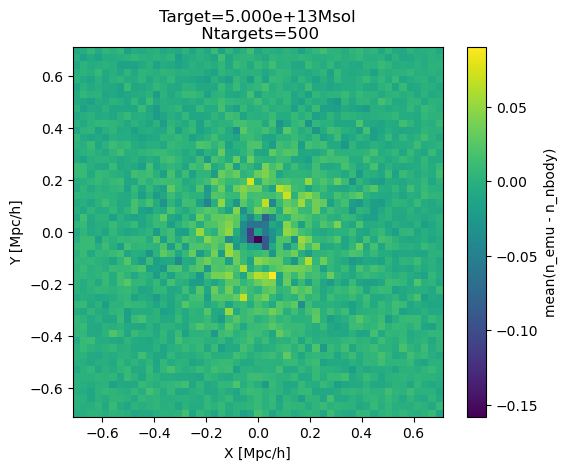

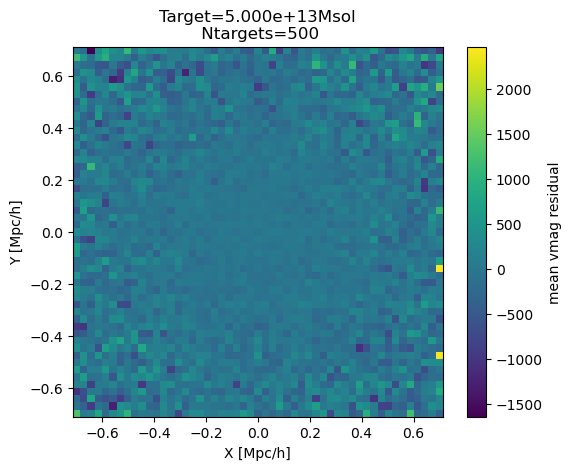

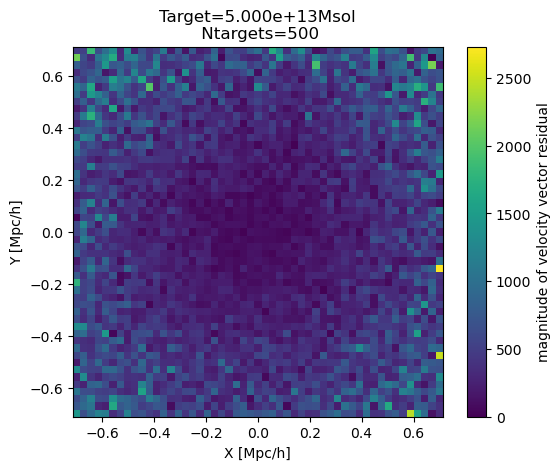

In [178]:
plt.figure()
N_residual = (np.array(N_list_emu)-np.array(N_list_nbody))
plt.imshow(np.reshape(np.array(N_residual)/N_targets, (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="mean(n_emu - n_nbody)")
plt.savefig("figures/nresid2_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

plt.figure()
V3d_residual = (np.array(V3d_list_emu)-np.array(V3d_list_nbody))
plt.imshow(np.reshape(np.array(V3d_residual), (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="mean vmag residual")
plt.savefig("figures/vmagresid2_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

plt.figure()
plt.imshow(np.reshape(np.array(V3d_dif_list), (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="magnitude of velocity vector residual")
plt.savefig("figures/vdifmag2_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

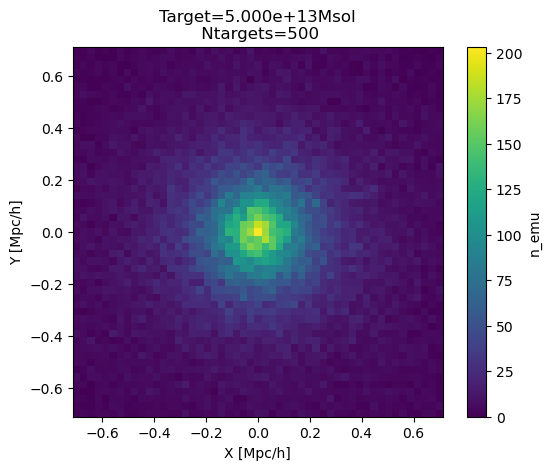

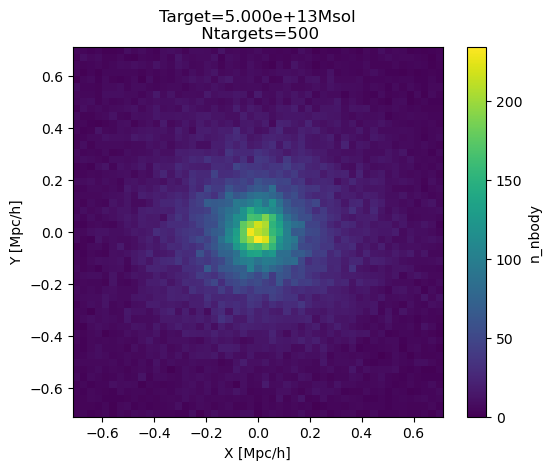

In [179]:
plt.figure()
plt.imshow(np.reshape(np.array(N_list_emu), (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="n_emu")
plt.savefig("figures/nemu_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

plt.figure()
plt.imshow(np.reshape(np.array(N_list_nbody), (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="n_nbody")
plt.savefig("figures/nnbody_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

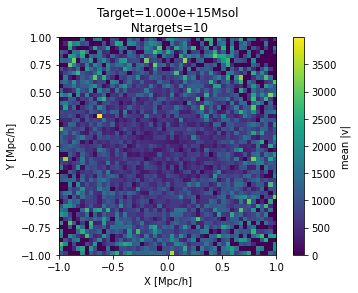

In [164]:

plt.figure()
plt.imshow(np.reshape(np.array(V3d_list_emu), (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="mean |v|")
plt.savefig("figures/vmag_emu_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

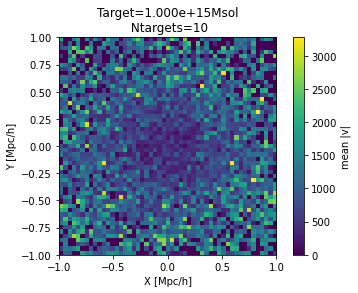

In [165]:

plt.figure()
plt.imshow(np.reshape(np.array(V3d_list_nbody), (xsteps,ysteps)),extent = [-xl/2.0,xl/2.0,-yl/2.0,yl/2.0])
plt.xlabel("X [Mpc/h]")
plt.ylabel("Y [Mpc/h]")
print_mass = scientific_notation="{:.3e}".format(target_mass)
plt.title("Target="+str(print_mass)+"Msol\n Ntargets="+str(N_targets))
plt.colorbar(label="mean |v|")
plt.savefig("figures/vmag_nbody_N_"+str(N_targets)+"_mass_"+str(print_mass)+".pdf",bbox_inches="tight")

In [10]:
# dx, dy = 0.05,0.05
# x0, y0 = -xl/2.0+dx/2.0, -yl/2.0+dx/2.0
# xsteps = int(xl/dx)
# ysteps = int(yl/dy)
xsteps = 51
ysteps = xsteps
zsteps = xsteps
dx, dy = xl*1.0/xsteps,yl*1.0/ysteps 
x0, y0 = -xl/2.0+dx/2.0, -yl/2.0+dx/2.0
dz = zl*1.0/zsteps
z0 = -zl/2.0+dz/2.0

z_list = []
x_list, y_list, N_list_emu,N_list_nbody = [],[],[],[]
V_list_emu, V_list_nbody = [],[]
V3d_list_emu, V3d_list_nbody = [],[]
V3d_dif_list = []

for z_step in range(zsteps):
    x0 = -xl/2.0+dx/2.0
    for x_step in  range(xsteps):
        y0 =  -yl/2.0+dy/2.0
        for y_step in range(ysteps):

            dif = np.array([x0,y0,z0])
            V3d_dif = np.array([0,0,0])
            lens = np.abs(dif_emus - dif).T
            yes_emu = np.where((lens[0] <= dx/2.0)& (lens[1] <= dy/2.0) & (lens[2] <= dz/2.0))
            N_emu= len(yes_emu[0])

            if(N_emu == 0): 
                V_emu = 0
                V3d_emu = 0
            else: 
                V_emu = np.sum(vmag_emus[yes_emu[0]])/N_emu
                V3d_emu = np.sqrt(np.sum(np.power(np.sum(v3d_emus[yes_emu[0]],axis=0),2)))/N_emu
                V3d_dif = np.sum(v3d_emus[yes_emu[0]],axis=0)/N_emu

            lens = np.abs(dif_nbodys - dif).T
            yes_nbody = np.where((lens[0] <= dx/2.0)& (lens[1] <= dy/2.0) & (lens[2] <= dz/2.0))
            N_nbody= len(yes_nbody[0])

            if(N_nbody == 0): 
                V_nbody = 0
                V3d_nbody = 0
            else: 
                V_nbody= np.sum(vmag_nbodys[yes_nbody[0]])/N_nbody
                V3d_nbody = np.sqrt(np.sum(np.power(np.sum(v3d_nbodys[yes_nbody[0]],axis=0),2)))/N_nbody
                V3d_dif = V3d_dif - (np.sum(v3d_nbodys[yes_nbody[0]],axis=0)/N_nbody)

            x_list.append(x0)
            y_list.append(y0)
            z_list.append(z0)
            N_list_emu.append(N_emu)
            N_list_nbody.append(N_nbody)
            V_list_emu.append(V_emu)
            V_list_nbody.append(V_nbody)
            V3d_list_emu.append(V3d_emu)
            V3d_list_nbody.append(V3d_nbody)
            V3d_dif_list.append(np.sqrt(np.sum(np.power(V3d_dif,2))))
    #         print(x0,y0,N_emu, N_nbody)
            y0 += dy
        x0 += dx
    z0 += dz

In [11]:
x_list = np.array(x_list)
y_list = np.array(y_list)
z_list = np.array(z_list)
N_list_nbody = np.array(N_list_nbody)
N_list_emu = np.array(N_list_emu)
r_max = xl/2.0*np.sqrt(2.1)
d_square = np.sqrt(np.power(x_list, 2) + np.power(y_list,2) + np.power(z_list,2))

mass_per_particle = 6.565293600596489e11 #msun/h

r_list = np.logspace(-1.5,np.log10(r_max),20)
rho_list_emu = []
rho_list_nbody = []

for r in r_list:
    r_args = np.where(d_square <= r)[0]
    mass_enc_emu = np.sum(N_list_emu[r_args])*mass_per_particle/N_targets
    mass_enc_nbody = np.sum(N_list_nbody[r_args])*mass_per_particle/N_targets
    vol = 4/3 * np.pi * np.power(r,3.0)
    rho_list_emu.append(mass_enc_emu/vol)
    rho_list_nbody.append(mass_enc_nbody/vol)



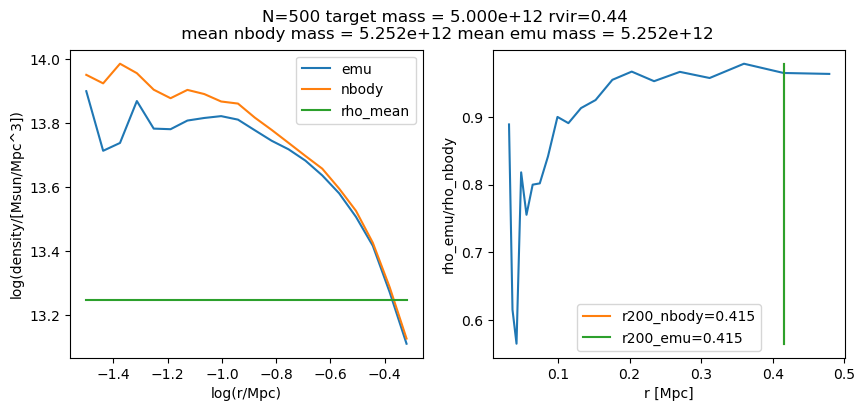

In [12]:
fig, axs = plt.subplots(1,2,figsize=(10,4))
print_mass = scientific_notation="{:.3e}".format(target_mass)
print_massn = scientific_notation="{:.3e}".format(np.mean(target_mass_list_nbod).value)
print_masse = scientific_notation="{:.3e}".format(np.mean(target_mass_list_emu).value)

plt.suptitle("N="+str(N_targets)+" target mass = "+str(print_mass)+" rvir="+str(int(r_vir(target_mass,0)*1000)/1000.0) +
            "\n mean nbody mass = "+str(print_massn) +
            " mean emu mass = "+str(print_masse))
# axs[0].plot(r_list, rho_list_emu, label ="emu")
# axs[0].plot(r_list, rho_list_nbody, label ="nbody")
# axs[0].legend()
# axs[0].set_xlabel("r [Mpc]")
# axs[0].set_ylabel("density [Msun/Mpc^3]")
# axs[0].set_yscale("log")
mean_density = mass_per_particle*np.power(512.0/1000,3)
p200 = 200*mean_density

axs[0].plot(np.log10(r_list), np.log10(rho_list_emu), label ="emu")
axs[0].plot(np.log10(r_list), np.log10(rho_list_nbody), label ="nbody")
axs[0].plot(np.log10(r_list), np.log10(np.linspace(p200, p200,len(r_list))),label="rho_mean")
axs[0].legend()
axs[0].set_xlabel("log(r/Mpc)")
axs[0].set_ylabel("log(density/[Msun/Mpc^3])")


rat = np.array(rho_list_emu)/np.array(rho_list_nbody)
axs[1].plot(r_list, rat)
axs[1].set_xlabel("r [Mpc]")
axs[1].set_ylabel("rho_emu/rho_nbody")

r200_nbody = r_list[np.argmin(np.abs(rho_list_nbody-p200))]
r200_emu = r_list[np.argmin(np.abs(rho_list_emu-p200))]

axs[1].plot(np.linspace(r200_nbody,r200_nbody,10),
            np.linspace(np.min(rat), np.max(rat),10),
            label="r200_nbody="+str(int(r200_nbody*1000)/1000.0))
axs[1].plot(np.linspace(r200_emu,r200_emu,10),
            np.linspace(np.min(rat), np.max(rat),10),
            label="r200_emu="+str(int(r200_emu*1000)/1000.0))

axs[1].legend()


plt.savefig("figures/density_v_r_nopair_tm_"+str(print_mass)+".pdf")



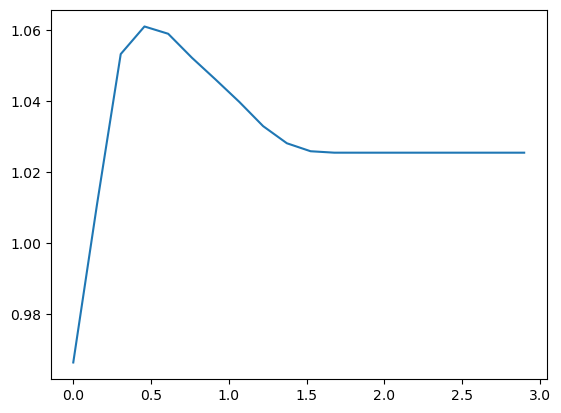

In [13]:
plt.plot(r_list, rho_list_emu/np.array(rho_list_nbody))

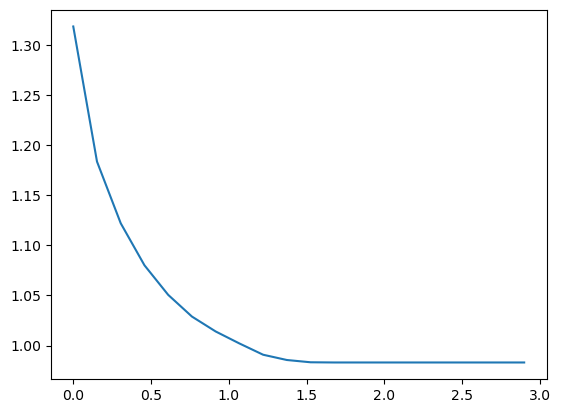

In [39]:
plt.plot(r_list, rho_list_emu/np.array(rho_list_nbody))

Text(0, 0.5, 'log(Density/(Msun/Mpc^3))')

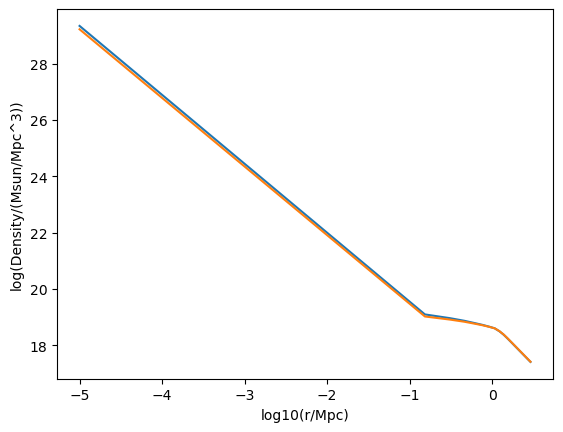

In [35]:
plt.plot(np.log10(r_list), np.log10(rho_list_emu), label="Emu")
plt.plot(np.log10(r_list), np.log10(rho_list_nbody), label="Nbody")
plt.xlabel("log10(r/Mpc)")
plt.ylabel("log(Density/(Msun/Mpc^3))")


# Finding halo pairs and checking mass ratio

In [53]:
dir_ = "rockstar_halos_corrected/"   
dsnbod = yt.load(dir_+"halos_"+"nbody"+'_0.0.bin')
dsemu = yt.load(dir_+"halos_"+"emu"+'_0.0.bin')
pos_nbod = dsnbod.all_data()["all","particle_position"].to("Mpc/h")
mass_nbod  = dsnbod.all_data()["all","particle_mass"].to("Msun/h")
rad_nbod  = dsnbod.all_data()["all","virial_radius"].to("Mpc/h")
pos_emu = dsemu.all_data()["all","particle_position"].to("Mpc/h")
mass_emu  = dsemu.all_data()["all","particle_mass"].to("Msun/h")
rad_emu  = dsemu.all_data()["all","virial_radius"].to("Mpc/h")


yt : [INFO     ] 2023-06-07 12:35:04,439 Parameters: current_time              = 4.3628432502146176e+17 s
yt : [INFO     ] 2023-06-07 12:35:04,441 Parameters: domain_dimensions         = [1 1 1]
yt : [INFO     ] 2023-06-07 12:35:04,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2023-06-07 12:35:04,444 Parameters: domain_right_edge         = [1000. 1000. 1000.]
yt : [INFO     ] 2023-06-07 12:35:04,444 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2023-06-07 12:35:04,444 Parameters: current_redshift          = 0.0
yt : [INFO     ] 2023-06-07 12:35:04,445 Parameters: omega_lambda              = 0.6825000047683716
yt : [INFO     ] 2023-06-07 12:35:04,445 Parameters: omega_matter              = 0.3174999952316284
yt : [INFO     ] 2023-06-07 12:35:04,445 Parameters: omega_radiation           = 0.0
yt : [INFO     ] 2023-06-07 12:35:04,445 Parameters: hubble_constant           = 0.6711000204086304
yt : [INFO     ] 2023-06-07 12:35:04,503 Parameters: curren

In [54]:
vrms_emu  = dsemu.all_data()["all","vrms"].to("km/s")
vrms_nbod  = dsnbod.all_data()["all","vrms"].to("km/s")


In [10]:
# filter_mass1 = np.where(mass_nbod >= 1e13)
# filter_mass2 = np.where(mass_emu >= 1e13)
# pos_nbod = pos_nbod[filter_mass1]
# mass_nbod = mass_nbod[filter_mass1]
# rad_nbod = rad_nbod[filter_mass1]
# pos_emu = pos_emu[filter_mass2]
# mass_emu = mass_emu[filter_mass2]
# rad_emu = rad_emu[filter_mass2]



OMEGA_B = 0.0486 
OMEGA_M = 0.307
OMEGA_L = 1-OMEGA_M
SIGMA_8 = 0.8159
delta_c = 1.686
h=0.677
rho_crit = 1.5*1e11 #Msol/mpc^3
T_HUBBLE = 4.55e17 #s
MPC_TO_CM = 3.086e+24

K = 1.380649e-16 #ergs/K
SEC_PER_MYR = 3.15576e+13
m_p = 1.6e-27
msol = 2e30
mpc = 3.086e+24
n = rho_crit*msol/mpc**3*OMEGA_B/m_p #cm^-3



def r_vir(m_h,z):
    #returns mpc
    h=0.7
    
    OMEGA_K = 1-OMEGA_M-OMEGA_L
    OMEGA_M_Z=OMEGA_M*np.float_power(1+z,3)/ (OMEGA_M*np.float_power(1+z,3) + OMEGA_L + OMEGA_K*np.float_power(1+z,2))
    d = OMEGA_M_Z-1
    delta_c = 18*np.pi*np.pi + 82*d -39*d*d

    return 1e-3*0.784/h* np.float_power(m_h*h/1e8, 1.0/3)*np.float_power(OMEGA_M/OMEGA_M_Z * (delta_c/(18*np.pi*np.pi)), -1.0/3) * (10/(1+z))




In [56]:
ids_nbod, ids_emu = np.linspace(-1,-1,len(mass_nbod)), np.linspace(-1,-1,len(mass_emu))
bs= 50
bw = bs/2.0
bf=3
l = bw+bf
xc = bw
xsteps, ysteps, zsteps = int(1000/bs),int(1000/bs),int(1000/bs)
N=0
N_emu = 0
emu_args = []
nbod_args = []
sizes=[]

for xstep in range(xsteps):
    yc = bw
    for ystep in range(ysteps):
        zc = bw
        for zstep in range(zsteps):
            c = np.array([xc,yc,zc])
            
            x1,y1,z1 = (pos_nbod.value - c).T
            x2,y2,z2 = (pos_emu.value - c).T
            nb_filt = np.where((-bw<=x1) & (x1<=bw) & (-bw<=y1) & (y1<=bw) & (-bw<=z1) & (z1<=bw))[0]
            em_filt = np.where((-l<=x2) & (x2<=l) & (-l<=y2) & (y2<=l) & (-l<=z2) & (z2<=l))[0]

            pos_nbod1 = pos_nbod[nb_filt]
            rad_nbod1 = rad_nbod[nb_filt]
            ids_nbod1 = ids_nbod[nb_filt]
            pos_emu1 = pos_emu[em_filt]
            rad_emu1 = rad_emu[em_filt]
            ids_emu1 = ids_emu[em_filt]

            for i in range(len(pos_nbod1)):
                pos_target = pos_nbod1[i]
                rad_target = rad_nbod1[i]



                dist = np.sqrt(np.sum(np.power((pos_emu1 - pos_target),2),axis=1))
                size = len(np.where(dist<rad_target)[0])
                if(size>= 2): sizes.append(size)
                pair_ind = np.argmin(dist)

                if(dist[pair_ind] > rad_target): continue
    
                if(ids_emu1[pair_ind] != -1): continue
                ids_emu1[pair_ind] = i+N

                ids_nbod1[i] = i+N
                emu_args.append(ids_emu1[pair_ind])
                nbod_args.append(ids_nbod1[i])

            ids_emu[em_filt] = ids_emu1
            ids_nbod[nb_filt] = ids_nbod1
            
            #print(xc,yc,zc)
            zc += bs
            N+= len(pos_nbod1)
            N_emu += len(pos_emu1)
        yc+=bs
    xc+= bs
    print(xc)


75.0
125.0
175.0
225.0
275.0
325.0
375.0
425.0
475.0
525.0
575.0
625.0
675.0
725.0
775.0
825.0
875.0
925.0
975.0
1025.0


In [57]:
nbod_args2 = []
emu_args2  = []
for x in range(len(ids_nbod)):
    target_id = ids_nbod[x]
    if(target_id == -1): continue
    nbod_args2.append(x)
    emu_args2.append(np.where(ids_emu == target_id)[0][0])
emu_args2 = np.array(emu_args2)
nbod_args2 = np.array(nbod_args2)



In [58]:

pos_paired_emu, pos_paired_nbod = pos_emu[emu_args2],pos_nbod[nbod_args2]

mean_dist = np.mean(np.sqrt(np.sum(np.power(pos_paired_emu - pos_paired_nbod, 2),axis=1)))
print(mean_dist)

0.1857717275410269 Mpc/h


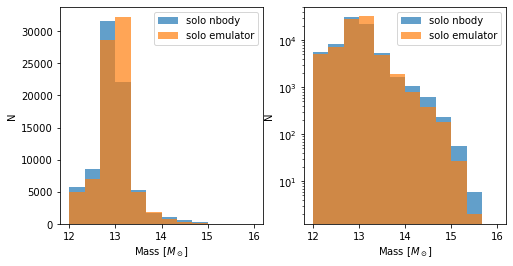

In [59]:
fig, axs = plt.subplots(1,2,figsize=(8,4))
bins = np.linspace(12,16,13)
emu_solo = np.log10(mass_emu[np.where(ids_emu == -1)].value)
nbod_solo = np.log10(mass_nbod[np.where(ids_nbod == -1)].value)
a=axs[0].hist(nbod_solo,label="solo nbody",alpha=0.7,bins=bins)
axs[0].hist(emu_solo,label="solo emulator",alpha=0.7,bins=bins)
axs[0].legend()
axs[0].set_xlabel(r"Mass [$M_\odot$]")
axs[0].set_ylabel(r"N")

a=axs[1].hist(nbod_solo,label="solo nbody",alpha=0.7,log=True,bins=bins)
axs[1].hist(emu_solo,label="solo emulator",alpha=0.7,log=True,bins=bins)
axs[1].legend()
plt.savefig("figures/solo_hist.pdf", bbox_inches="tight")
axs[1].set_xlabel(r"Mass [$M_\odot$]")
axs[1].set_ylabel(r"N")
plt.savefig("figures/solo_hist.pdf", bbox_inches="tight")

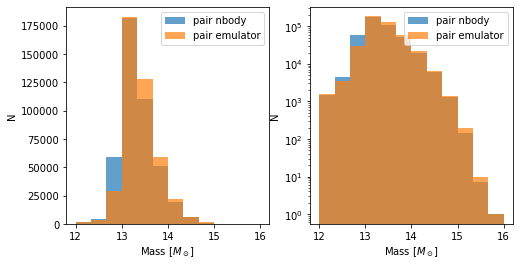

In [60]:
fig, axs = plt.subplots(1,2,figsize=(8,4))

emu_pair = np.log10(mass_emu[emu_args2].value)
nbod_pair = np.log10(mass_nbod[nbod_args2].value)
a=axs[0].hist(nbod_pair,label="pair nbody",alpha=0.7,bins=bins)
axs[0].hist(emu_pair,label="pair emulator",alpha=0.7,bins=bins)
axs[0].legend()
axs[0].set_xlabel(r"Mass [$M_\odot$]")
axs[0].set_ylabel(r"N")

a=axs[1].hist(nbod_pair,label="pair nbody",alpha=0.7,log=True,bins=bins)
axs[1].hist(emu_pair,label="pair emulator",alpha=0.7,log=True,bins=bins)
axs[1].legend()
plt.savefig("figures/pair_hist.pdf", bbox_inches="tight")
axs[1].set_xlabel(r"Mass [$M_\odot$]")
axs[1].set_ylabel(r"N")
plt.savefig("figures/pair_hist.pdf", bbox_inches="tight")


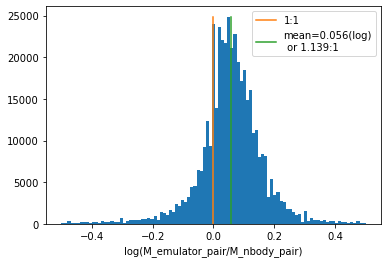

In [61]:
paired_nbod = np.where(ids_nbod != -1)[0]
mass_paired_emu, mass_paired_nbod = mass_emu[emu_args2],mass_nbod[nbod_args2]
log_rat = np.log10(mass_paired_emu/mass_paired_nbod)
bins = np.linspace(-0.5,0.5,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(M_emulator_pair/M_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/pair_ratio.pdf", bbox_inches="tight")


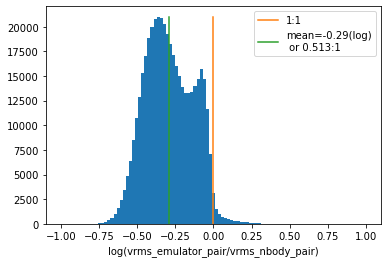

In [66]:
paired_nbod = np.where(ids_nbod != -1)[0]
vrms_paired_emu, vrms_paired_nbod = vrms_emu[emu_args2],vrms_nbod[nbod_args2]
log_rat = np.log10(vrms_paired_emu/vrms_paired_nbod)
bins = np.linspace(-1,1,100)
data = plt.hist(log_rat,bins=bins)
plt.xlabel("log(vrms_emulator_pair/vrms_nbody_pair)")
plt.plot([0,0], [0,np.max(data[0])],label="1:1")
mean = np.mean(log_rat)
plt.plot([mean,mean], [0,np.max(data[0])],label="mean="+str(round(1000*mean)/1000)+"(log)\n or "+str(round(1000*10**mean)/1000)+":1")
plt.legend()
plt.savefig("figures/vrms_pair_ratio.pdf", bbox_inches="tight")

In [67]:
# plt.scatter(mass_paired_emu, mass_paired_nbod,s=1)
# plt.xlabel("mass of emulator halo")
# plt.plot([1e12,1e16], [1e12,1e16], label="1:1",color="black")
# plt.xlabel("mass of nbody halo")
# plt.title("mass comparison between paired halos")
# plt.yscale("log")
# plt.xscale("log")
# plt.legend()
# plt.savefig("figures/scatter_mass_comp.pdf", bbox_inches="tight")


C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\_methods.py:256: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


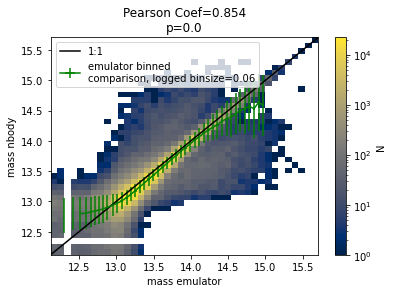

In [63]:
from matplotlib import colors
from scipy import stats
res = stats.pearsonr(mass_paired_emu, mass_paired_nbod)
paired_nbod = np.where(ids_nbod != -1)[0]

plt.hist2d(np.log10(mass_paired_emu), np.log10(mass_paired_nbod),bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
plt.plot([12,16],[12,16],label="1:1",color="black")
plt.xlabel("mass emulator")
plt.ylabel("mass nbody")

mass_list = np.linspace(12,15,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=mass_list[1]-mass_list[0]
for x in range(len(mass_list)-1):
    filter_ = np.where((mass_list[x] <= np.log10(mass_paired_emu)) & (np.log10(mass_paired_emu) <= mass_list[x+1]))
    emu_mean.append(np.mean(np.log10(mass_paired_emu)[filter_]))
    nbod_mean.append(np.mean(np.log10(mass_paired_nbod)[filter_]))
    emu_std.append(np.std(np.log10(mass_paired_emu)[filter_]))
    nbod_std.append(np.std(np.log10(mass_paired_nbod)[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, logged binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/mass_denisty.pdf", bbox_inches="tight")

C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3472: RuntimeWarning: Mean of empty slice.
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
C:\Users\Matthew\anaconda3\lib\site-packages\unyt\array.py:1778: RuntimeWarning: invalid value encountered in true_divide
  out_arr = func(
C:\Users\Matthew\anaconda3\lib\site-packages\numpy\core\_methods.py:264: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


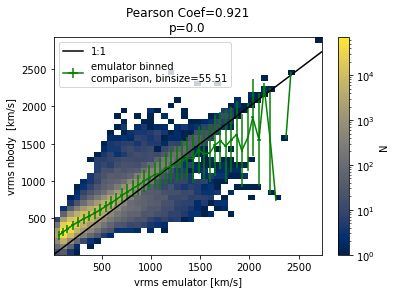

In [64]:
from matplotlib import colors
from scipy import stats
x,y = vrms_paired_emu.value, vrms_paired_nbod.value

res = stats.pearsonr(x, y)



plt.hist2d(x,y,bins = 40, 
           norm = colors.LogNorm(), 
           cmap ="cividis")
plt.title("Pearson Coef="+str(round(1000*res[0])/1000)+"\np="+str(round(1000*res[1])/1000))
plt.colorbar(label="N")
a,b = np.min(x), np.max(x)
plt.plot([a,b],[a,b],label="1:1",color="black")
plt.xlabel("vrms emulator [km/s]")
plt.ylabel("vrms nbody  [km/s]")

vrms_list = np.linspace(a,b,50)
emu_mean, nbod_mean = [],[]
emu_std, nbod_std = [],[]
db=vrms_list[1]-vrms_list[0]
for x in range(len(vrms_list)-1):
    filter_ = np.where((vrms_list[x] <= vrms_paired_emu) & (vrms_paired_emu <= vrms_list[x+1]))
    emu_mean.append(np.mean(vrms_paired_emu[filter_]))
    nbod_mean.append(np.mean(vrms_paired_nbod[filter_]))
    emu_std.append(np.std(vrms_paired_emu[filter_]))
    nbod_std.append(np.std(vrms_paired_nbod[filter_]))
    
plt.errorbar(emu_mean, nbod_mean, xerr = emu_std, yerr=nbod_std,label="emulator binned\ncomparison, binsize="+str(round(db*100)/100), color="green")
#plt.plot(emu_mean, nbod_mean, label="emulator binned\ncomparison, binsize="+str(round(db*100)/100),lw=1, color="green")
plt.legend(loc = "upper left")
plt.savefig("figures/vrms_denisty.pdf", bbox_inches="tight")

2.576935532973152

# Restructuring the data

In [7]:
#OMEGA_M, OMEGA_B, h = 0.3175, 0.049, 0.6711
import numpy as np
OMEGA_M, OMEGA_B, h = 0.27 , 0.00, 0.67

RHO_CRIT = 2.77536627e11*h*h #Msun/MPC^3
vol_box = np.power(0.5/h,3) #Mpc^3
total_mass = OMEGA_M * RHO_CRIT * vol_box
mass_per_particle = total_mass / np.power(512,3) #msun/h
print(mass_per_particle)#/1e11, "e11")
mass_per_particle = 6.565293600596489e11 #msun/h

104.16202092849049


In [2]:
#OMEGA_M, OMEGA_B, h = 0.3175, 0.049, 0.6711
import numpy as np
OMEGA_M, OMEGA_B, h = 0.05557+ 0.15833 , 0.05557, 0.8599

RHO_CRIT = 2.77536627e11*h*h #Msun/MPC^3
vol_box = np.power(1000/h,3) #Mpc^3
total_mass = OMEGA_M * RHO_CRIT * vol_box
mass_per_particle = total_mass / np.power(512,3) *h #msun/h
print(mass_per_particle/1e11, "e11")
mass_per_particle = 6.565293600596489e11 #msun/h


4.423043468244375 e11


In [4]:
min_halo_mass_default = mass_per_particle
print(min_halo_mass_default/1e11,"e11")

6.5652936005964895 e11


In [11]:
# pos = np.load("LtU-selected/pos_nbody.npy")
# vel = np.load("LtU-selected/vel_nbody.npy")
pos1 = np.load("LH0001-selected/pos_nbody.npy")
vel1 = np.load("LH0001-selected/vel_nbody.npy")
# vel = np.reshape(vel,(3,512**3))
# pos = np.reshape(pos,(3,512**3))

# vmag = np.sqrt(np.sum(np.power(vel.T,2),axis=1))
# energy = 0.5*vmag
# mp = mass_per_particle
# mass = np.linspace(mp,mp,len(vmag))
# id_ = np.linspace(1,len(vmag), len(vmag)).astype(int)
# type_ = np.linspace(1,1,len(vmag))


In [12]:
np.shape(pos1)

(3, 512, 512, 512)

In [4]:
print(np.size(id_))
print(np.size(np.unique(id_)))

134217728
134217728


In [11]:
import h5py
with h5py.File("snap_000.0", "w") as f:
    print(f)
    # Print all root level object names (aka keys) 
    # these can be group or dataset names 
    print("Keys: %s" % f.keys())
    # get first object name/key; may or may NOT be a group
    a_group_key = list(f.keys())[0]

    # get the object type for a_group_key: usually group or dataset
    print(type(f[a_group_key])) 

    # If a_group_key is a group name, 
    # this gets the object names in the group and returns as a list
    data = list(f[a_group_key])

    # If a_group_key is a dataset name, 
    # this gets the dataset values and returns as a list
    data = list(f[a_group_key])
    # preferred methods to get dataset values:
    ds_obj = f[a_group_key]      # returns as a h5py dataset object
    ds_arr = f[a_group_key][()]  # returns as a numpy array

<HDF5 file "snap_000.0" (mode r+)>
Keys: <KeysViewHDF5 []>


IndexError: list index out of range

In [28]:
pos = np.load("../map2map_emu/pos_nbody.npy")
pos.shape

FileNotFoundError: [Errno 2] No such file or directory: '../map2map_emu/pos_nbody.npy'

In [6]:
pos = np.load("../map2map_emu/pos_nbody.npy")
# print(np.shape(pos))
# print(pos[0])
# pos = np.reshape(pos,(3,512**3))
# print(np.shape(pos))
# print(pos[0])

FileNotFoundError: [Errno 2] No such file or directory: '../map2map_emu/pos_nbody.npy'

In [64]:
np.save("../../../LTUDATA/324/ppos2.npy", pos)

In [62]:
pos = np.load("../../../LTUDATA/324/ppos.npy")
print(np.shape(pos))
print(np.shape(pos.T))
pos = pos.reshape((3,512,512,512))
print(np.shape(pos))
print(pos[0])

(134217728, 3)
(3, 134217728)
(3, 512, 512, 512)
[[[5.52096540e-02 2.17657451e+00 3.52201837e+00 ... 3.37791285e+02
   9.98063367e+02 9.95935043e+02]
  [3.41457047e+02 9.97707330e+02 9.95301341e+02 ... 1.43545370e+01
   6.63235132e+02 9.90251844e+02]
  [1.14230202e+01 6.64619958e+02 9.89722374e+02 ... 5.61595517e-01
   3.81447911e+00 3.60702016e-01]
  ...
  [3.36433873e+02 6.58687131e+02 7.20877929e+00 ... 9.95747780e+02
   3.38495724e+02 1.78709578e+01]
  [9.97636258e+02 3.31369476e+02 1.31521473e+01 ... 3.31364570e+02
   4.15664402e-01 3.33170517e+02]
  [3.30590484e+02 8.35794189e-01 3.34963604e+02 ... 3.38401751e+02
   6.57829009e+02 6.07944288e+00]]

 [[3.40851132e+02 6.61278232e+02 5.73412698e+00 ... 9.97438856e+02
   3.33317576e+02 1.56726014e+01]
  [9.96990799e+02 3.35750144e+02 1.52846409e+01 ... 3.31680659e+02
   9.99236934e+02 3.31154350e+02]
  [3.32785615e+02 2.65488559e+00 3.34573586e+02 ... 3.44554641e+02
   6.59645742e+02 3.60151037e+00]
  ...
  [3.37436319e+02 9.98405714

In [3]:
data = np.array((pos[0][0:100],pos[1][0:100],pos[2][0:100],vel[0][0:100],vel[1][0:100],vel[2][0:100],mass[0:100], energy[0:100],id_[0:100],type_[0:100]))
df = pd.DataFrame(data.T,columns=["X", "Y", "Z", "VX", "VY", "VZ", "Mass", "Energy", "ID", "Type"])
df.to_csv("nbody", sep=' ', index=False, header=False)
#df.to_csv(file_name, sep='\t', encoding='utf-8')

NameError: name 'pos' is not defined

In [15]:
from pygadgetreader import *

# MASS PER PARTICLE CALCULATOR

In [9]:
import numpy as np
OMEGA_M, OMEGA_B, h = 0.40, 0.049, 0.89
RHO_CRIT = 2.77536627e11*h*h #Msun/MPC^3
#vol_box = np.power(3000/h,3) #Mpc^3
vol_box = 1#np.power(3000/h,3) #Mpc^3
total_mass = OMEGA_M * RHO_CRIT * vol_box
mass_per_particle = total_mass / np.power(1536*h/3000.0,3)*h #msun/h
mass_per_particle/1e11

8.271236032247545

In [10]:
import numpy as np
OMEGA_M, OMEGA_B, h = 0.28226, 0.049, 0.716478
RHO_CRIT = 2.77536627e11*h*h #Msun/MPC^3
#vol_box = np.power(3000/h,3) #Mpc^3
vol_box = 1#np.power(3000/h,3) #Mpc^3
total_mass = OMEGA_M * RHO_CRIT * vol_box
mass_per_particle = total_mass / np.power(1536*h/3000.0,3)*h #msun/h
mass_per_particle/1e11

5.836597706155478

In [8]:
import numpy as np
OMEGA_M, OMEGA_B, h = 0.1429, 1.0, 0.5049
RHO_CRIT = 2.77536627e11*h*h #Msun/MPC^3
#vol_box = np.power(3000/h,3) #Mpc^3
vol_box = 1#np.power(3000/h,3) #Mpc^3
total_mass = OMEGA_M * RHO_CRIT * vol_box
mass_per_particle = total_mass / np.power(1536*h/3000.0,3) *h #msun/h
mass_per_particle/1e11

2.9548990725204356

In [3]:
import numpy as np
# pos = np.load("LtU-selected/pos_emu.npy")
# vel = np.load("LtU-selected/vel_emu.npy")
# vel = np.reshape(vel,(3,512**3))
# pos = np.reshape(pos,(3,512**3))
OMEGA_M, OMEGA_B, h = 0.1429, 1.0, 0.5049
RHO_CRIT = 2.77536627e11*h*h #Msun/MPC^3
vol_box = np.power(1000/h,3) #Mpc^3
total_mass = OMEGA_M * RHO_CRIT * vol_box
mass_per_particle = total_mass / np.power(512,3)
print(mass_per_particle/1e11)
# vmag = np.sqrt(np.sum(np.power(vel.T,2),axis=1))
# energy = 0.5*vmag
# mp = mass_per_particle
# mass = np.linspace(mp,mp,len(vmag))
# id_ = np.linspace(1,len(vmag), len(vmag)).astype(int)
# type_ = np.linspace(1,1,len(vmag))
# data = np.array((pos[0],pos[1],pos[2],vel[0],vel[1],vel[2],mass, energy,id_,type_))
# df = pd.DataFrame(data.T,columns=["X", "Y", "Z", "VX", "VY", "VZ", "Mass", "Energy", "ID", "Type"])

5.852444191959665


In [5]:
import numpy as np
p = np.zeros((3,3))
np.std(p)

0.0

In [7]:
np.mean(vel[0])

-0.06098995

In [8]:
np.mean(vel[1])

0.07409461

In [9]:
np.mean(vel[2])

-0.05099964

In [4]:
pos = np.reshape(pos, (3,512**3))

In [6]:
pos[2]

array([997.43896, 997.2288 , 997.39056, ..., 991.33246, 991.2952 ,
       991.3363 ], dtype=float32)

In [10]:
pos[0]

array([  3.2034674,   3.5627625,   3.3199947, ..., 996.0866   ,
       996.136    , 996.3348   ], dtype=float32)

In [11]:
pos[1]

array([  4.2654715,   3.90266  ,   3.8883126, ..., 996.2801   ,
       996.       , 996.2347   ], dtype=float32)

In [ ]:
df.to_csv("emu", sep=' ')


In [22]:
cosmo_params = [['0.32470 0.03641 0.59990 1.17290 0.60790\n'], ['0.32030 0.06415 0.80550 1.12170 0.89070\n'], ['0.31390 0.04163 0.81090 1.01330 0.76010\n'], ['0.32330 0.04475 0.68110 1.14810 0.70590\n'], ['0.39370 0.03427 0.81590 0.87150 0.82910\n'], ['0.31930 0.05455 0.86190 0.93370 0.69590\n'], ['0.31050 0.04351 0.63030 0.94870 0.91530\n'], ['0.34390 0.04717 0.86170 1.17170 0.83590\n'], ['0.41630 0.04289 0.57110 0.87130 0.83830\n'], ['0.19550 0.05335 0.51230 1.17270 0.83210\n'], ['0.10150 0.05813 0.78630 1.15690 0.84090\n'], ['0.31130 0.06541 0.76170 0.85370 0.77870\n'], ['0.31730 0.04645 0.55370 0.88890 0.99190\n'], ['0.19070 0.04983 0.80490 1.10670 0.82950\n'], ['0.37710 0.03247 0.88850 0.92130 0.84110\n'], ['0.32890 0.06375 0.52070 1.04670 0.82610\n'], ['0.31430 0.03997 0.78410 1.02970 0.93110\n'], ['0.31070 0.05951 0.64930 0.98010 0.98270\n'], ['0.45850 0.03147 0.53690 0.82910 0.83510\n'], ['0.48950 0.06001 0.71370 1.01870 0.83230\n'], ['0.27930 0.06753 0.66510 1.12750 0.83810\n']]

In [19]:
dir_num = ['1702', '1026', '1122', '324', '944', '1951', '485', '1582', '592', '1323', '401', '406', '1608', '391', '1710', '444', '1696', '926', '694', '1515', '502']

In [23]:
cosmo_params

[['0.32470 0.03641 0.59990 1.17290 0.60790\n'],
 ['0.32030 0.06415 0.80550 1.12170 0.89070\n'],
 ['0.31390 0.04163 0.81090 1.01330 0.76010\n'],
 ['0.32330 0.04475 0.68110 1.14810 0.70590\n'],
 ['0.39370 0.03427 0.81590 0.87150 0.82910\n'],
 ['0.31930 0.05455 0.86190 0.93370 0.69590\n'],
 ['0.31050 0.04351 0.63030 0.94870 0.91530\n'],
 ['0.34390 0.04717 0.86170 1.17170 0.83590\n'],
 ['0.41630 0.04289 0.57110 0.87130 0.83830\n'],
 ['0.19550 0.05335 0.51230 1.17270 0.83210\n'],
 ['0.10150 0.05813 0.78630 1.15690 0.84090\n'],
 ['0.31130 0.06541 0.76170 0.85370 0.77870\n'],
 ['0.31730 0.04645 0.55370 0.88890 0.99190\n'],
 ['0.19070 0.04983 0.80490 1.10670 0.82950\n'],
 ['0.37710 0.03247 0.88850 0.92130 0.84110\n'],
 ['0.32890 0.06375 0.52070 1.04670 0.82610\n'],
 ['0.31430 0.03997 0.78410 1.02970 0.93110\n'],
 ['0.31070 0.05951 0.64930 0.98010 0.98270\n'],
 ['0.45850 0.03147 0.53690 0.82910 0.83510\n'],
 ['0.48950 0.06001 0.71370 1.01870 0.83230\n'],
 ['0.27930 0.06753 0.66510 1.12750 0.838

In [28]:
dir_num = np.array(dir_num)
dir_num

array(['1702', '1026', '1122', '324', '944', '1951', '485', '1582', '592',
       '1323', '401', '406', '1608', '391', '1710', '444', '1696', '926',
       '694', '1515', '502'], dtype='<U4')

In [49]:
in_files = list(glob.iglob("/home/matthew/LTUDATA/*/ppos.npy"))
print(in_files)

['/home/matthew/LTUDATA/592/ppos.npy', '/home/matthew/LTUDATA/1515/ppos.npy', '/home/matthew/LTUDATA/406/ppos.npy', '/home/matthew/LTUDATA/926/ppos.npy', '/home/matthew/LTUDATA/1323/ppos.npy', '/home/matthew/LTUDATA/1608/ppos.npy', '/home/matthew/LTUDATA/694/ppos.npy', '/home/matthew/LTUDATA/1582/ppos.npy', '/home/matthew/LTUDATA/1696/ppos.npy', '/home/matthew/LTUDATA/391/ppos.npy', '/home/matthew/LTUDATA/401/ppos.npy', '/home/matthew/LTUDATA/485/ppos.npy', '/home/matthew/LTUDATA/1951/ppos.npy', '/home/matthew/LTUDATA/1702/ppos.npy', '/home/matthew/LTUDATA/502/ppos.npy', '/home/matthew/LTUDATA/1122/ppos.npy', '/home/matthew/LTUDATA/1026/ppos.npy', '/home/matthew/LTUDATA/444/ppos.npy', '/home/matthew/LTUDATA/1710/ppos.npy', '/home/matthew/LTUDATA/944/ppos.npy', '/home/matthew/LTUDATA/324/ppos.npy']


In [48]:
style_files = list(glob.iglob("/home/matthew/LTUDATA/*/cosmo_params.dat"))
print(style_files)

['/home/matthew/LTUDATA/592/cosmo_params.dat', '/home/matthew/LTUDATA/1515/cosmo_params.dat', '/home/matthew/LTUDATA/406/cosmo_params.dat', '/home/matthew/LTUDATA/926/cosmo_params.dat', '/home/matthew/LTUDATA/1323/cosmo_params.dat', '/home/matthew/LTUDATA/1608/cosmo_params.dat', '/home/matthew/LTUDATA/694/cosmo_params.dat', '/home/matthew/LTUDATA/1582/cosmo_params.dat', '/home/matthew/LTUDATA/1696/cosmo_params.dat', '/home/matthew/LTUDATA/391/cosmo_params.dat', '/home/matthew/LTUDATA/401/cosmo_params.dat', '/home/matthew/LTUDATA/485/cosmo_params.dat', '/home/matthew/LTUDATA/1951/cosmo_params.dat', '/home/matthew/LTUDATA/1702/cosmo_params.dat', '/home/matthew/LTUDATA/502/cosmo_params.dat', '/home/matthew/LTUDATA/1122/cosmo_params.dat', '/home/matthew/LTUDATA/1026/cosmo_params.dat', '/home/matthew/LTUDATA/444/cosmo_params.dat', '/home/matthew/LTUDATA/1710/cosmo_params.dat', '/home/matthew/LTUDATA/944/cosmo_params.dat', '/home/matthew/LTUDATA/324/cosmo_params.dat']


In [47]:
output_dirs = list(glob.iglob("/home/matthew/LTUDATA/*"))
print(output_dirs)

['/home/matthew/LTUDATA/592', '/home/matthew/LTUDATA/1515', '/home/matthew/LTUDATA/406', '/home/matthew/LTUDATA/926', '/home/matthew/LTUDATA/1323', '/home/matthew/LTUDATA/1608', '/home/matthew/LTUDATA/694', '/home/matthew/LTUDATA/1582', '/home/matthew/LTUDATA/1696', '/home/matthew/LTUDATA/391', '/home/matthew/LTUDATA/401', '/home/matthew/LTUDATA/485', '/home/matthew/LTUDATA/1951', '/home/matthew/LTUDATA/1702', '/home/matthew/LTUDATA/502', '/home/matthew/LTUDATA/1122', '/home/matthew/LTUDATA/1026', '/home/matthew/LTUDATA/444', '/home/matthew/LTUDATA/1710', '/home/matthew/LTUDATA/944', '/home/matthew/LTUDATA/324']


In [35]:
dir_ = glob.iglob("../../../LTUDATA/*")

for i,d in enumerate(dir_): 
    subdir = d.split("/")[-1]
    arg = np.where(dir_num == subdir)[0][0]
    print(arg)
    print(cosmo_params[arg])
    print(subdir)
    path = d+"/cosmo_params.dat"
    print(path)
    file = open(path,"w")
    file.write(cosmo_params[arg][0])
    file.close()
    


8
['0.41630 0.04289 0.57110 0.87130 0.83830\n']
592
../../../LTUDATA/592/cosmo_params.dat
19
['0.48950 0.06001 0.71370 1.01870 0.83230\n']
1515
../../../LTUDATA/1515/cosmo_params.dat
11
['0.31130 0.06541 0.76170 0.85370 0.77870\n']
406
../../../LTUDATA/406/cosmo_params.dat
17
['0.31070 0.05951 0.64930 0.98010 0.98270\n']
926
../../../LTUDATA/926/cosmo_params.dat
9
['0.19550 0.05335 0.51230 1.17270 0.83210\n']
1323
../../../LTUDATA/1323/cosmo_params.dat
12
['0.31730 0.04645 0.55370 0.88890 0.99190\n']
1608
../../../LTUDATA/1608/cosmo_params.dat
18
['0.45850 0.03147 0.53690 0.82910 0.83510\n']
694
../../../LTUDATA/694/cosmo_params.dat
7
['0.34390 0.04717 0.86170 1.17170 0.83590\n']
1582
../../../LTUDATA/1582/cosmo_params.dat
16
['0.31430 0.03997 0.78410 1.02970 0.93110\n']
1696
../../../LTUDATA/1696/cosmo_params.dat
13
['0.19070 0.04983 0.80490 1.10670 0.82950\n']
391
../../../LTUDATA/391/cosmo_params.dat
10
['0.10150 0.05813 0.78630 1.15690 0.84090\n']
401
../../../LTUDATA/401/cosmo_par

# retired functions

In [ ]:

    

def old_gen _rs_pairs(fname_emu, fname_nbody,savename_base):
    names = ["x","y","z", "vx", "vy", "vz", "mass", "specific_energy","particle_id", "type", "assigned_internal_haloid", "internal_haloid","external_haloid"]
    f_emu = pd.read_csv(fname_emu,delim_whitespace=True, comment="#", names=names, usecols = ["external_haloid", "particle_id","assigned_internal_haloid","internal_haloid", "x", "y", "z"])
    f_nbody = pd.read_csv(fname_nbody,delim_whitespace=True, comment="#", names=names, usecols = ["external_haloid", "particle_id","assigned_internal_haloid","internal_haloid", "x", "y", "z"])  

    aihd = np.array(f_emu["assigned_internal_haloid"])
    ihd = np.array(f_emu["internal_haloid"])
    remove_subs = np.where(aihd == ihd)

    ehd_emu = np.array(f_emu["external_haloid"])
    pid_emu = np.array(f_emu["particle_id"])
    ehd_emu = ehd_emu[remove_subs]
    pid_emu = pid_emu[remove_subs]
    pid_emu_argsort = np.argsort(pid_emu)
    pid_emu = np.array(pid_emu[pid_emu_argsort])
    ehd_emu = np.array(ehd_emu[pid_emu_argsort])
    ehd_emu = ehd_emu+1
    
    
    aihd = np.array(f_nbody["assigned_internal_haloid"])
    ihd = np.array(f_nbody["internal_haloid"])
    ehd_nbody = np.array(f_nbody["external_haloid"])
    pid_nbody = np.array(f_nbody["particle_id"])
    remove_subs = np.where(aihd == ihd)
    ehd_nbody = ehd_nbody[remove_subs]
    pid_nbody = pid_nbody[remove_subs]
    pid_nbody_argsort = np.argsort(pid_nbody)
    pid_nbody = np.array(pid_nbody[pid_nbody_argsort])
    ehd_nbody = np.array(ehd_nbody[pid_nbody_argsort])
    ehd_nbody = ehd_nbody+1
    ehd_nbody_full, ehd_emu_full = np.linspace(0,0,512**3), np.linspace(0,0,512**3)
    ehd_nbody_full[pid_nbody-1] = ehd_nbody
    ehd_emu_full[pid_emu-1] = ehd_emu

    ehd_emu_full=ehd_emu_full.astype(int)
    ehd_nbody_full=ehd_nbody_full.astype(int)

    #find_all_pairs(ehd_emu_full, ehd_nbody_full, savename_base)
    for x in np.arange(0.9,0.2,-0.1):
        x = round(x*1000)/1000
        savename = "pair_files/"+savename_base+"_"+str(x)
        print("working on", savename)
        print()
        find_all_pairs(ehd_emu_full, ehd_nbody_full,savename,min_frac = x)
    

In [ ]:

def old_cross _check(base_ids1,target_ids1,base_ids2,target_ids2):
    
    base_ids1 = base_ids1.astype(int)
    target_ids1 = target_ids1.astype(int)
    base_ids2 = base_ids2.astype(int)
    target_ids2 = target_ids2.astype(int)
    
    f1 = np.where(target_ids1 >= 0)[0]    
    best_base = base_ids1[f1]
    best_target = target_ids1[f1]    
    
    f2 = np.where(np.isin(base_ids2, best_target, invert=True) & (np.isin(target_ids2, best_base, invert=True)) & (target_ids2 >= 0) & (base_ids2 >=0))[0]
    best_base = np.append(best_base, target_ids2[f2])
    best_target = np.append(best_target, base_ids2[f2])
    return np.array(best_base),np.array(best_target)



def old_find _all_pairs(plEmu, plNbody,savename,min_frac = 0.5):
    plEmu, plNbody = plEmu.astype(int), plNbody.astype(int)
    unique_nbody = np.sort(np.unique(plNbody))[1:]
    unique_nbody = np.sort(np.unique(plNbody))[1:]
    plNbody_sort = np.sort(plNbody)
    plNbody_argsort = np.argsort(plNbody)
    plNbody_bincount = np.bincount(plNbody_sort)
    N_nbody = plNbody_bincount
    N_nbody_cum = np.cumsum(N_nbody)

    unique_emu = np.sort(np.unique(plEmu))[1:]
    plEmu_sort = np.sort(plEmu)
    plEmu_argsort = np.argsort(plEmu)
    plEmu_bincount = np.bincount(plEmu_sort)
    N_emu = plEmu_bincount
    N_emu_cum = np.cumsum(N_emu)
    base_ids1,target_ids1,frac1 = find_pairs(unique_nbody, unique_emu,N_nbody_cum, N_emu_cum, plNbody_argsort, plEmu_argsort, plNbody,plEmu,BASE_NBOD=True,min_frac=min_frac)
    base_ids2,target_ids2,frac2 = find_pairs(unique_nbody, unique_emu,N_nbody_cum, N_emu_cum, plNbody_argsort, plEmu_argsort, plNbody,plEmu,BASE_NBOD=False,min_frac=min_frac)
    best_base,best_target, best_frac = cross_check(base_ids1,target_ids1,base_ids2,target_ids2, frac1,frac2)    
    data = np.array([best_base, best_target, best_frac]).T
    df = pd.DataFrame(data, columns=["nbody_id", "emu_id", "particle_fraction"])
    df.to_csv(savename)
    

In [ ]:


def old_find _pairs(unique_nbody, unique_emu,N_nbody_cum, N_emu_cum, 
               plNbody_argsort, plEmu_argsort, plNbody,plEmu,BASE_NBOD=True,min_frac=0.5 ):
    print("min_frac:", min_frac)
    base_ids,target_ids,frac = [],[],[]

    if(BASE_NBOD):
        unique_base, unique_target = unique_nbody, unique_emu
        N_base, N_target = N_nbody_cum, N_emu_cum
        base_argsort, target_argsort = plNbody_argsort, plEmu_argsort
        base_l, target_l = plNbody,plEmu

    else: 
        unique_base, unique_target = unique_emu,unique_nbody
        N_base, N_target = N_emu_cum,N_nbody_cum
        base_argsort, target_argsort = plEmu_argsort,plNbody_argsort
        base_l, target_l = plEmu, plNbody



    for i,unique_id in enumerate(unique_base):
        base_args = base_argsort[N_base[i]: N_base[i+1]]
        pair_cands = target_l[base_args]
        pair_cands = pair_cands[pair_cands!=0]
        if(np.size(pair_cands) == 0): 
            target_ids.append(-1)
            frac.append(-1)
            continue
        best_pair = np.bincount(pair_cands).argmax()
        num = np.max(np.bincount(pair_cands)) #the number of target particles in the halo which occupies the most of the base
        denom = N_target[best_pair]-N_target[best_pair-1] #the total number of particles in the candidate target
        f = num/denom
        frac.append(f)
        
        if(f<=min_frac):
            target_ids.append(-2)
        else: 
            target_ids.append(best_pair)

    return unique_base, np.array(target_ids), np.array(frac)



In [ ]:

    
def old_get _mass_combos(nbody_file, emu_file, pair_file, fof=True, min_mass = 1e13, pos_n_vel = True):
    
    df = pd.read_csv(pair_file)
    nbody_id_pairs = np.array(df["nbody_id"])-1
    emu_id_pairs = np.array(df["emu_id"])-1

    if(fof):
        f0nbody = BigFileCatalog('fof_halos/lh0000_nbody')
        f0emu = BigFileCatalog('fof_halos/lh0000_emu')

        mass_nbod  = np.array(f0nbody["Mass"])
        mass_emu  = np.array(f0emu["Mass"])
        if(pos_n_vel):
            vel_nbod  = np.array(f0nbody["Velocity"])
            vel_emu  = np.array(f0emu["Velocity"])            
            pos_nbod  = np.array(f0nbody["Position"])
            pos_emu  = np.array(f0emu["Position"])     
    else:
        dsemu = yt.load("particle_test_emu/halos_0.0.bin")
        dsnbody = yt.load("particle_test_nbody/halos_0.0.bin")
        mass_nbod  = np.array(dsnbody.all_data()["particle_mass"].to("Msun/h"))
        mass_emu  = np.array(dsemu.all_data()["particle_mass"].to("Msun/h"))
        if(pos_n_vel):
            vel_nbod  = np.array(dsnbody.all_data()["particle_velocity"]) 
            vel_emu  = np.array(dsemu.all_data()["particle_velocity"])            
            pos_nbod  = np.array(dsnbody.all_data()["particle_position"])
            pos_emu  = np.array(dsemu.all_data()["particle_position"]) 

    mask_pairless_nbod = np.ones(len(mass_nbod), bool)
    mask_pairless_emu = np.ones(len(mass_emu), bool)

    mask_pairless_nbod[nbody_id_pairs] = 0
    mask_pairless_emu[emu_id_pairs] = 0

    nbody_pairless_mass = mass_nbod[mask_pairless_nbod]
    emu_pairless_mass = mass_emu[mask_pairless_emu]
    
    pairless_filter_nbod = np.where(nbody_pairless_mass>min_mass)
    pairless_filter_emu = np.where(emu_pairless_mass>min_mass)

    nbody_pairless_mass = nbody_pairless_mass[pairless_filter_nbod]
    emu_pairless_mass = emu_pairless_mass[pairless_filter_emu]
    

    mass_paired_nbod = mass_nbod[nbody_id_pairs]
    mass_paired_emu = mass_emu[emu_id_pairs]
    
    paired_filter = np.where((mass_paired_nbod>min_mass) & (mass_paired_emu >min_mass))
#     paired_filter = np.where((mass_paired_nbod>min_mass))
    mass_paired_nbod = mass_paired_nbod[paired_filter]
    mass_paired_emu = mass_paired_emu[paired_filter]
    
    
    mass_filter_nbod = np.where(mass_nbod>min_mass)
    mass_filter_emu = np.where(mass_emu>min_mass)
    mass_nbod = mass_nbod[mass_filter_nbod]
    mass_emu = mass_emu[mass_filter_emu]
    
    
    a = list(np.unique(mass_nbod))
    a.extend(list(mass_emu))
    unique_bins = np.sort(np.array(np.unique(a)))
    mass_combos = [mass_nbod, mass_emu, mass_paired_nbod, mass_paired_emu, nbody_pairless_mass,emu_pairless_mass, unique_bins]
    
    if(not pos_n_vel): return mass_combos
    else:
        vel_pairless_nbod = vel_nbod[mask_pairless_nbod][pairless_filter_nbod]
        vel_pairless_emu  = vel_emu[mask_pairless_emu][pairless_filter_emu]
        pos_pairless_nbod = pos_nbod[mask_pairless_nbod][pairless_filter_nbod]
        pos_pairless_emu  = pos_emu[mask_pairless_emu][pairless_filter_emu]
        
        vel_paired_nbod = vel_nbod[nbody_id_pairs][paired_filter]
        vel_paired_emu  = vel_emu[emu_id_pairs][paired_filter]
        pos_paired_nbod = pos_nbod[nbody_id_pairs][paired_filter]
        pos_paired_emu  = pos_emu[emu_id_pairs][paired_filter]    
        
        vel_nbod = vel_nbod[mass_filter_nbod]
        vel_emu  = vel_emu[mass_filter_emu]
        pos_nbod = pos_nbod[mass_filter_nbod]
        pos_emu  = pos_emu[mass_filter_emu] 
        vel_combos = [vel_nbod, vel_emu, vel_paired_nbod, vel_paired_emu, vel_pairless_nbod,vel_pairless_emu]
        pos_combos = [pos_nbod, pos_emu, pos_paired_nbod, pos_paired_emu, pos_pairless_nbod,pos_pairless_emu]
        
        return mass_combos, pos_combos, vel_combos
        

# Move and rename LH data

In [164]:
vel  = np.load("LtU-selected/vel_nbody.npy")
np.mean(np.abs(vel))

290.85815

In [19]:
import shutil

dirs = glob.iglob("../../../LTUDATA/*")
for dir_ in dirs:
    lh_num = dir_.split("/")[-1]
    print(dir_)
    shutil.move(dir_+"/dis_out.npy", "../../../LH_data/"+lh_num+"_emu_pos.npy")
    shutil.move(dir_+"/vel_out.npy", "../../../LH_data/"+lh_num+"_emu_vel.npy")
    shutil.move(dir_+"/cosmo_params.dat", "../../../LH_data/"+lh_num+"_cosmo_params.dat")
list(dirs)

../../../LTUDATA/592
../../../LTUDATA/1515
../../../LTUDATA/406
../../../LTUDATA/926
../../../LTUDATA/1323
../../../LTUDATA/1608
../../../LTUDATA/694
../../../LTUDATA/1582
../../../LTUDATA/1696
../../../LTUDATA/391
../../../LTUDATA/401
../../../LTUDATA/485
../../../LTUDATA/1951
../../../LTUDATA/1702
../../../LTUDATA/502
../../../LTUDATA/1122
../../../LTUDATA/1026
../../../LTUDATA/444
../../../LTUDATA/1710
../../../LTUDATA/944
../../../LTUDATA/324


[]

In [22]:
import shutil

dirs = glob.iglob("../../../LH_data/*.dat")
for dir_ in dirs:
    lh_num = (dir_.split("/")[-1]).split("_")[0]
    print(dir_, lh_num)
    shutil.copy(dir_, "../../../LPTDATA/"+lh_num+"/cosmo_params.dat")
list(dirs)

../../../LH_data/1122_cosmo_params.dat 1122
../../../LH_data/1026_cosmo_params.dat 1026
../../../LH_data/502_cosmo_params.dat 502
../../../LH_data/944_cosmo_params.dat 944
../../../LH_data/1702_cosmo_params.dat 1702
../../../LH_data/592_cosmo_params.dat 592
../../../LH_data/694_cosmo_params.dat 694
../../../LH_data/1323_cosmo_params.dat 1323
../../../LH_data/485_cosmo_params.dat 485
../../../LH_data/324_cosmo_params.dat 324
../../../LH_data/406_cosmo_params.dat 406
../../../LH_data/401_cosmo_params.dat 401
../../../LH_data/1515_cosmo_params.dat 1515
../../../LH_data/1582_cosmo_params.dat 1582
../../../LH_data/1710_cosmo_params.dat 1710
../../../LH_data/1696_cosmo_params.dat 1696
../../../LH_data/1608_cosmo_params.dat 1608
../../../LH_data/391_cosmo_params.dat 391
../../../LH_data/444_cosmo_params.dat 444
../../../LH_data/926_cosmo_params.dat 926
../../../LH_data/1951_cosmo_params.dat 1951


[]

In [ ]:
#combining param data
dirs = list(glob.iglob("../../../LH_data/*.dat"))
for dir_ in dirs:
    f = open(dir_, "r").readline()
    lh_num = (dir_.split("/")[-1]).split("_")[0]
    df = pd.read_csv("../../../LH_data/"+lh_num+"_sim_params")
    params = [float(a) for a in f.split()]
    names = ["omega_m", "omega_b", "h2", "n_s", "sigma_8"]
    for x in range(len(params)):
        df[names[x]] = [params[x]]
    print(df["h2"]- df["h"])
    print(df["Om"] - df["omega_m"])
    df.to_csv("../../../LH_data/"+lh_num+"_sim_params_full")


# Reading the ICs from the 3Gpc volume and converting them to an npy file

In [3]:
import h5py
with h5py.File("ics.0", "w") as f:
    print(f)
    # Print all root level object names (aka keys) 
    # these can be group or dataset names 
    print("Keys: %s" % f.keys())
    # get first object name/key; may or may NOT be a group
    a_group_key = list(f.keys())

    # get the object type for a_group_key: usually group or dataset
    print(a_group_key)
    print(type(f[a_group_key])) 

    # If a_group_key is a group name, 
    # this gets the object names in the group and returns as a list
    data = list(f[a_group_key])

    # If a_group_key is a dataset name, 
    # this gets the dataset values and returns as a list
    data = list(f[a_group_key])
    # preferred methods to get dataset values:
    ds_obj = f[a_group_key]      # returns as a h5py dataset object
    ds_arr = f[a_group_key][()]  # returns as a numpy array

<HDF5 file "ics.0" (mode r+)>
Keys: <KeysViewHDF5 []>
[]


AttributeError: 'list' object has no attribute 'encode'

In [1]:
import g3read


In [3]:
mass =  g3read.read_new("ics.0", "POS", -1)

OSError: File corrupt. First integer is: 1178880137